In [1]:
# Setup the library
import pyrogue as pr
import os, sys
import matplotlib.pyplot as plt
import time
import numpy as np
import math

top_level=f'{os.getcwd()}/../../../'
pr.addLibraryPath( f'{top_level}/scripts' )
import setupLibPaths
import epix_hr_single_10k
import ePixViewer.Cameras as cameras

%run ../supportFunctions.ipynb

In [2]:
# Create and start the root class
root = epix_hr_single_10k.RootLCLSIITiming(
    top_level   = top_level,
    sim         = False,
    dev         = '/dev/datadev_0',
    asicVersion = 4
)
root.start()

Simulation mode : False
Start: Started zmqServer on ports 9099-9101
    To start a gui: python -m pyrogue gui --server='localhost:9099'
    To use a virtual client: client = pyrogue.interfaces.VirtualClient(addr='localhost', port=9099)


In [3]:
# Create useful pointers
AxiVersion = root.Core.AxiVersion
print ( '###################################################')
print ( '#             Firmware Version                    #')
print ( '###################################################')
AxiVersion.printStatus()
print ( '###################################################')

###################################################
#             Firmware Version                    #
###################################################
Path         = ePixHr10kT.Core.AxiVersion
FwVersion    = 0x3010000
UpTime       = 2 days, 0:08:46
GitHash      = 0x563a68027652195474e6a610098a11775111615a
XilinxDnaId  = 0x4002000101604ee71c618205
FwTarget     = EpixHr10kTLclsIITiming
BuildEnv     = Vivado v2022.2
BuildServer  = rdsrv408 (Ubuntu 20.04.6 LTS)
BuildDate    = Thu 02 Nov 2023 02:16:58 PM PDT
Builder      = ddoering
###################################################


# Baseline TEST all - 320MHz refGenB,RefGenC modified

In [4]:
MAX_NUMBER_OF_FRAMES_PER_BATCH  = 1000
cameraType            = 'ePixHr10kTBatcher'
bitMask               = 0xffff
currentCam = cameras.Camera(cameraType = cameraType)
currentCam.bitMask = bitMask

Camera  ePixHr10kTBatcher  selected.


In [5]:
#Initialze the camera
#[routine, asic0, asic1, asic2, asic3]'
initSequence = 5
root.EpixHR.InitASIC([initSequence,0,0,1,0])
#points to the ASIC device under test
ASIC = root.EpixHR.Hr10kTAsic2
root.EpixHR.BatcherEventBuilder0.Blowoff.set(True)
root.EpixHR.BatcherEventBuilder0.Bypass.set(1)
root.EpixHR.BatcherEventBuilder1.Blowoff.set(False)
root.EpixHR.BatcherEventBuilder1.Bypass.set(1)
root.EpixHR.BatcherEventBuilder2.Blowoff.set(True)

Rysync ASIC started
Init ASIC script started
Loading MMCM configuration
/u1/ddoering/localGit/epix-hr-single-10k/software/notebooks/ASIC_V4/baseline/../../..//yml/ePixHr10kT_MMCM_320MHz.yml
Completed
Loading supply configuration
/u1/ddoering/localGit/epix-hr-single-10k/software/notebooks/ASIC_V4/baseline/../../..//yml/ePixHr10kT_PowerSupply_Enable.yml
Loading register control (waveforms) configuration
/u1/ddoering/localGit/epix-hr-single-10k/software/notebooks/ASIC_V4/baseline/../../..//yml/ePixHr10kT_RegisterControl_R0Width12us_AcqWidth24us_320MHz.yml
Loading packet registers
Disabling packet lanes for ASIC 0
Disabling packet lanes for ASIC 1
Disabling packet lanes for ASIC 3
/u1/ddoering/localGit/epix-hr-single-10k/software/notebooks/ASIC_V4/baseline/../../..//yml/ePixHr10kT_PacketRegisters.yml
Taking asic off of reset
Loading ASIC and timing configuration
Loading  /u1/ddoering/localGit/epix-hr-single-10k/software/notebooks/ASIC_V4/baseline/../../..//yml/ePixHr10kT_PLLBypass_248MHz_A

In [6]:
#Makes sure triggers are off
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.1)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(True)
time.sleep(10)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.1)


In [7]:
#use system with batcher and missing ASICs
root.EpixHR.SspLowSpeedDecoderReg.enable.set(True)
print ("Locked lanes: %x" % root.EpixHR.SspLowSpeedDecoderReg.Locked.get())
#Only ASIC 1 is available so disable the 6 lower lanes
root.EpixHR.PacketRegisters0.DisableLane.set(0x3FF)
root.EpixHR.PacketRegisters1.DisableLane.set(0xFC0)



Locked lanes: 3f000


In [8]:
print(ASIC.Preamp.get())
print(ASIC.Vld1_b.get())
print(ASIC.Pixel_CB.get())
print(ASIC.Filter_DAC.get())
print(ASIC.VRef_DAC.get())

4
1
4
38
53


In [9]:
print('DHG', ASIC.DHg.get())
print('RefGenB', ASIC.RefGenB.get())
print('RefGenC', ASIC.RefGenC.get())
print('S2D_1_b', ASIC.S2D_1_b.get())
print('shvc_DAC', ASIC.shvc_DAC.get())
print('S2dDacBias', ASIC.S2dDacBias.get())
DHg = True
RefGenB = 2
RefGenC = 3
S2D_1_b = 0
shvc_DAC = 23
S2dDacBias = 3
print("")
ASIC.DHg.set(DHg)  
ASIC.RefGenB.set(RefGenB)
ASIC.RefGenC.set(RefGenC)
ASIC.S2D_1_b.set(S2D_1_b)
ASIC.shvc_DAC.set(shvc_DAC)
ASIC.S2dDacBias.set(S2dDacBias)
print('DHG', ASIC.DHg.get())
print('RefGenB', ASIC.RefGenB.get())
print('RefGenC', ASIC.RefGenC.get())
print('S2D_1_b', ASIC.S2D_1_b.get())
print('shvc_DAC', ASIC.shvc_DAC.get())
print('S2dDacBias', ASIC.S2dDacBias.get())

DHG True
RefGenB 3
RefGenC 2
S2D_1_b 0
shvc_DAC 23
S2dDacBias 3

DHG True
RefGenB 2
RefGenC 3
S2D_1_b 0
shvc_DAC 23
S2dDacBias 3


Preamp 4
Vld1_b 1
Pixel_CB 4
Filter_DAC 38
VRef_DAC 53
Command executed :  <class 'pyrogue._Command.BaseCommand'> - ePixHr10kT.EpixHR.Hr10kTAsic2.ClearMatrix
The file does not exist
/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_5_Preamp_4_Vld1b_1_PixelCB_4_Filter_DAC_38_VRrefdac_53_DHg_1_RefGenB_2_RefGenC_3_peds_12_trbit_1_run1.dat
Aquisition Counter 1787290
DAQ Counter 1637148
Number of frames received: 50048
Number of frames received: 52050
Delta Aquisition Counter: 54053
Number of frames received: 54053
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 2
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56072)
(145, 384)


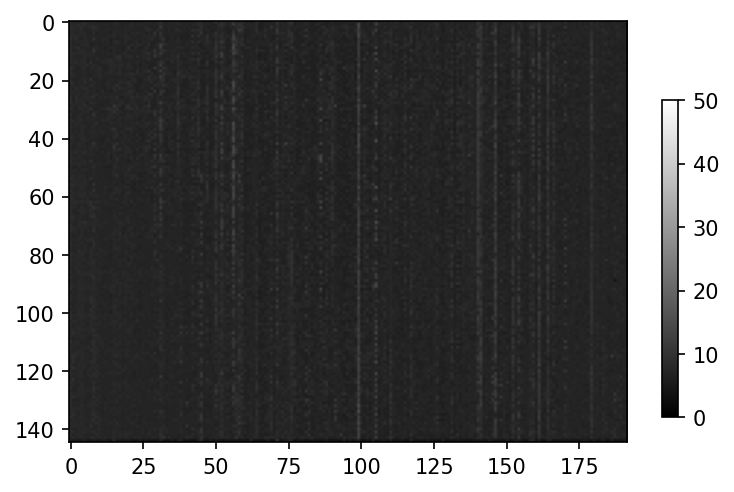

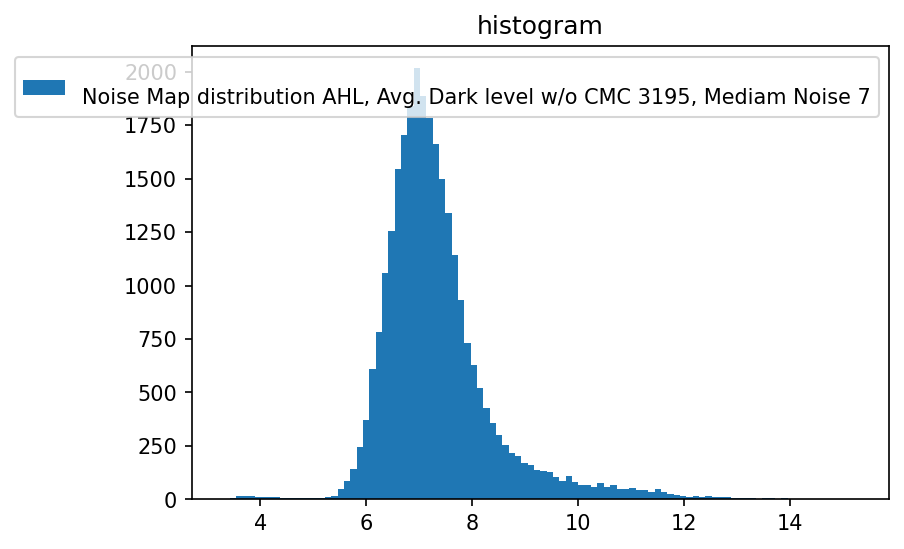

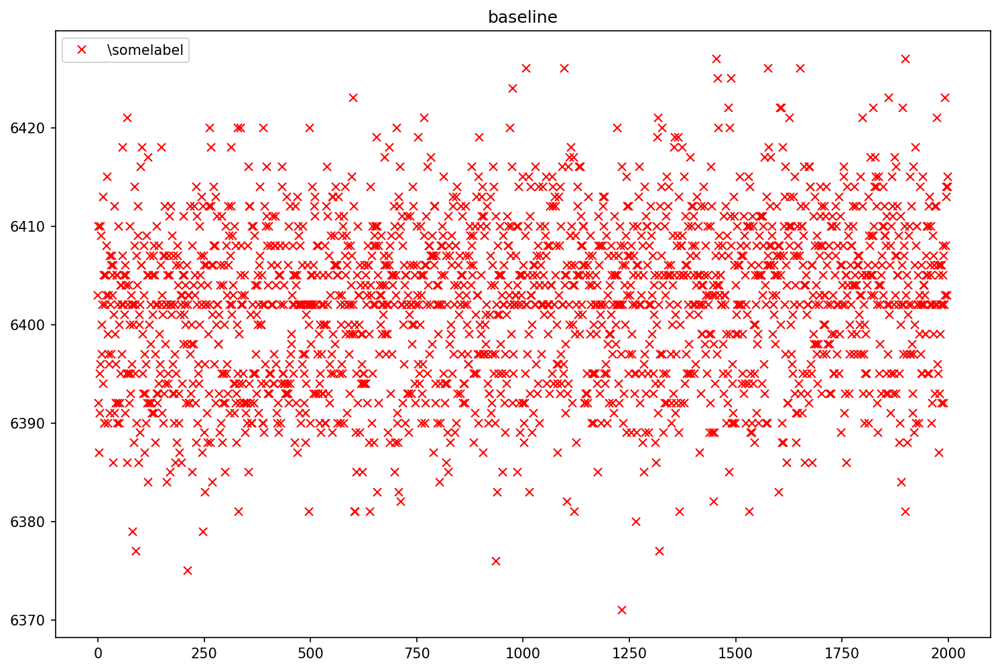

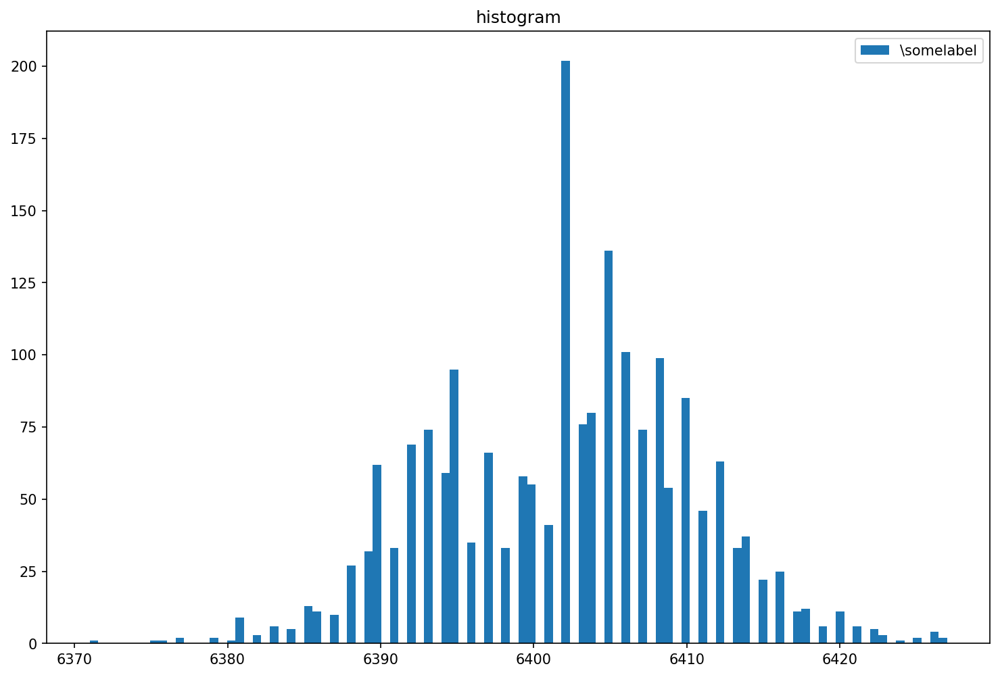

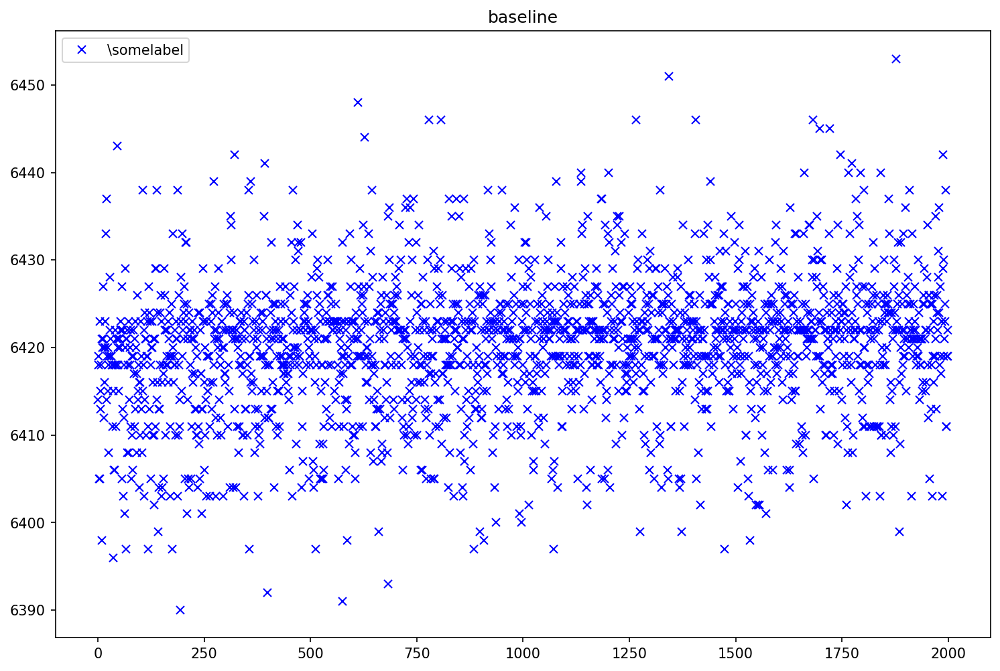

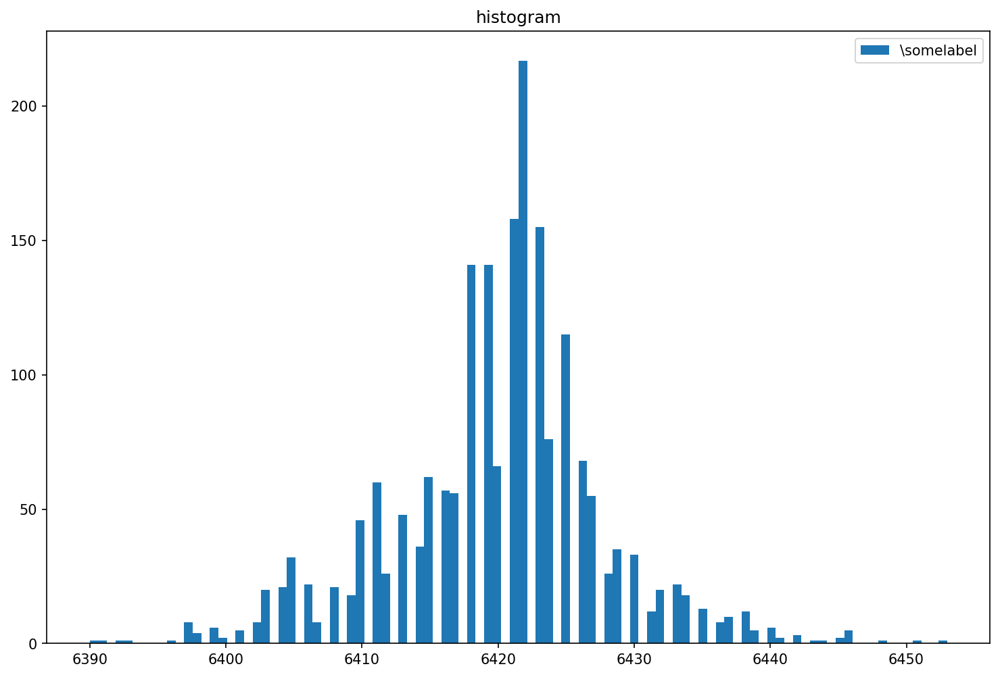

(145, 384)


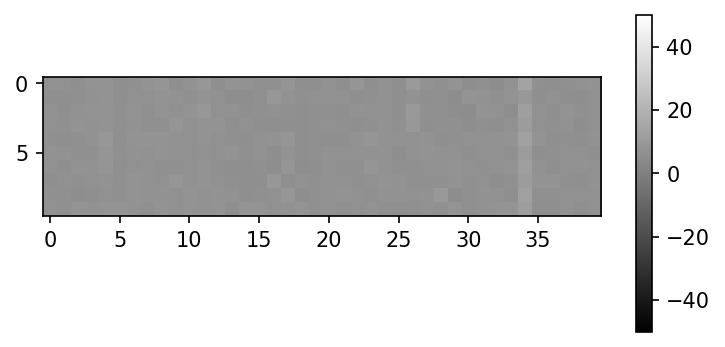

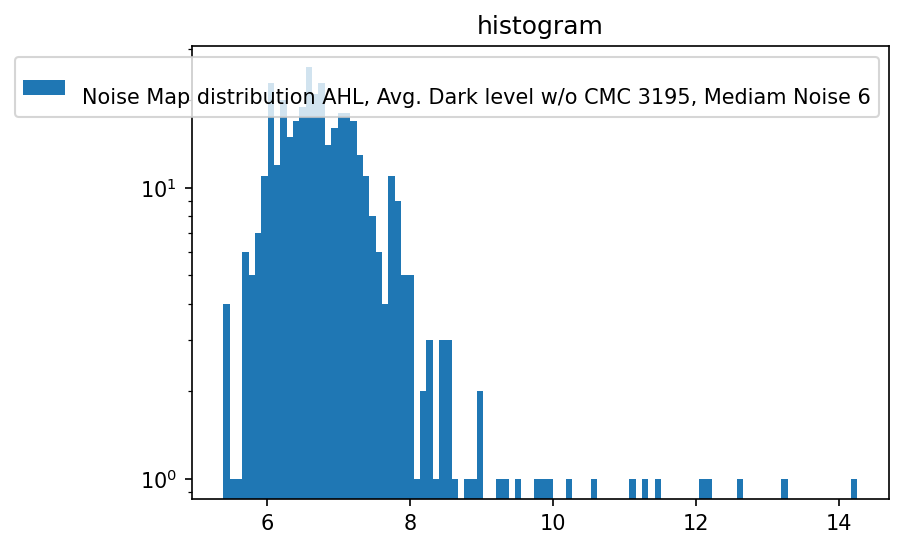


(145, 384)


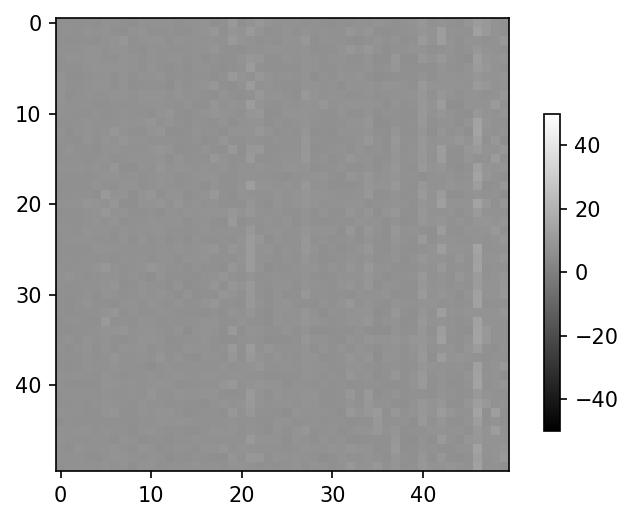

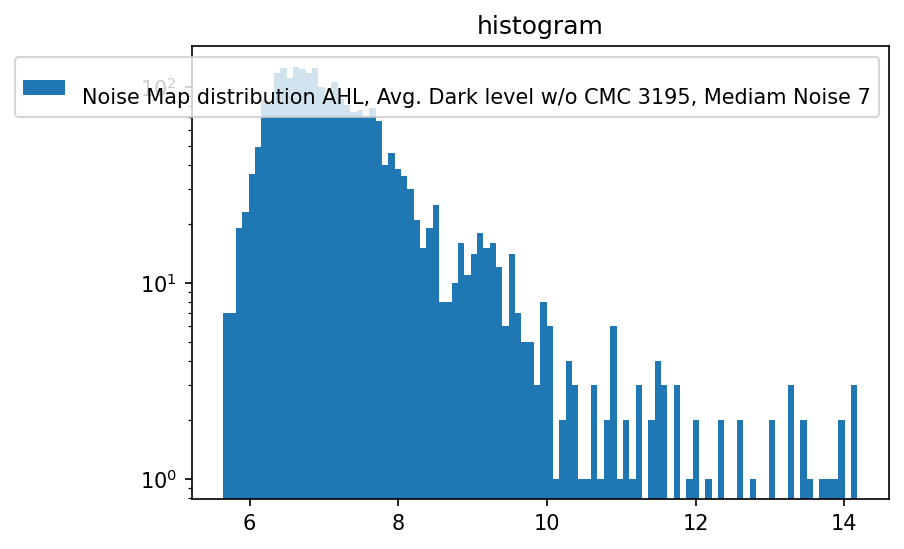


/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_5_Preamp_4_Vld1b_1_PixelCB_4_Filter_DAC_38_VRrefdac_53_DHg_1_RefGenB_2_RefGenC_3_peds_12_trbit_1_run1.dat
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 2
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 3
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 4
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 5
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 6
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get 

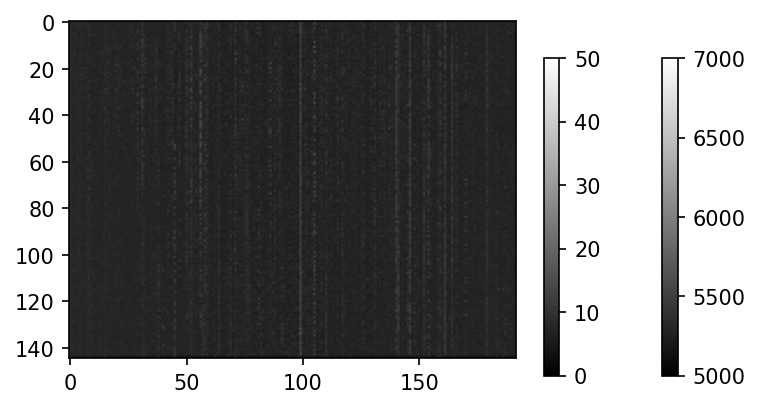

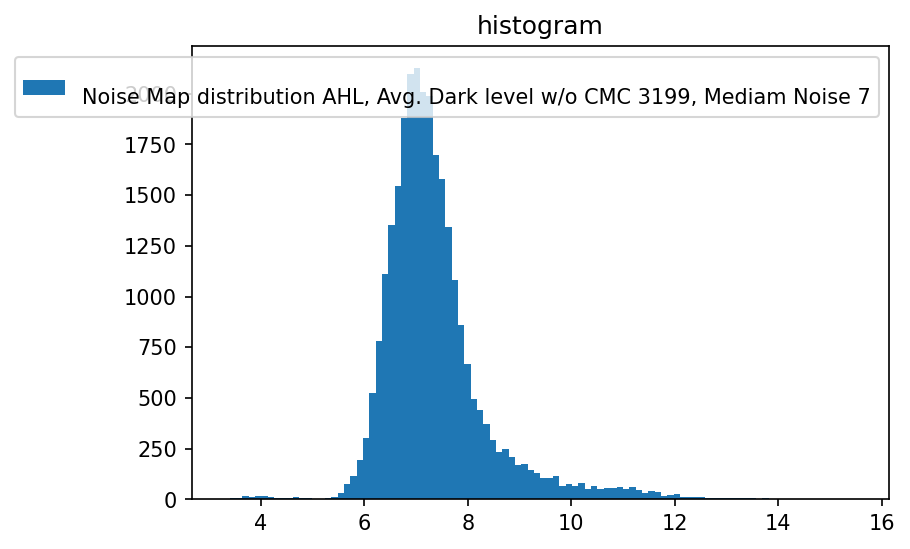

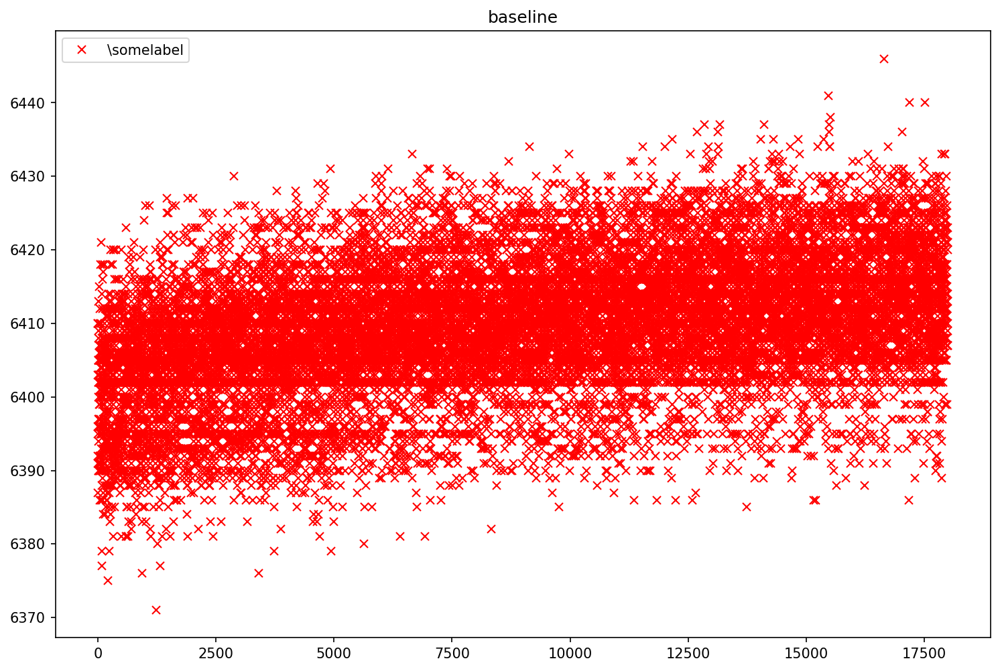

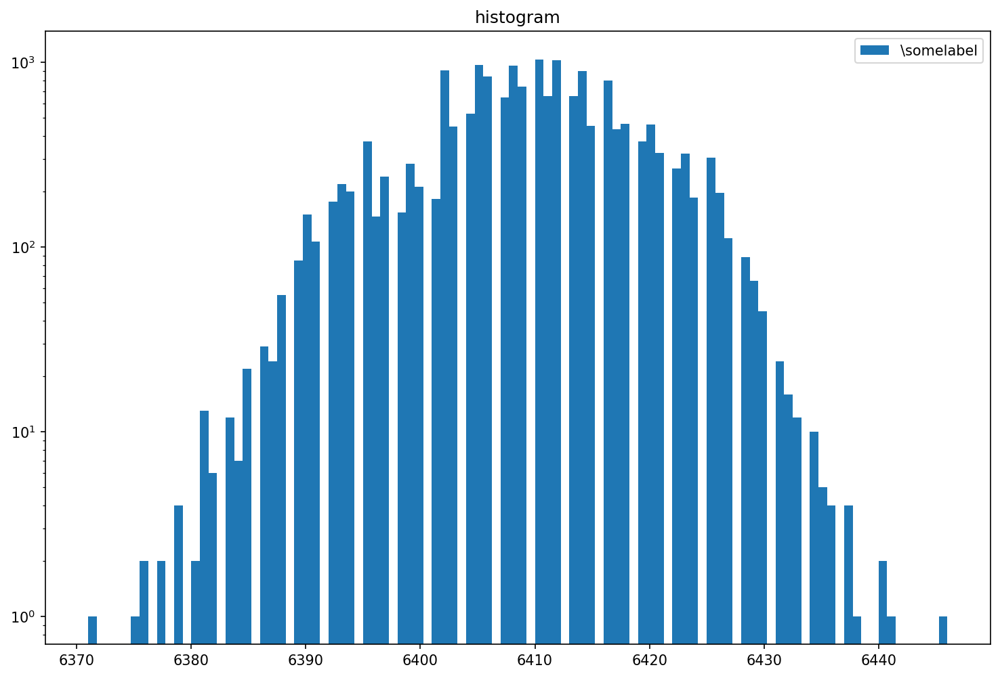

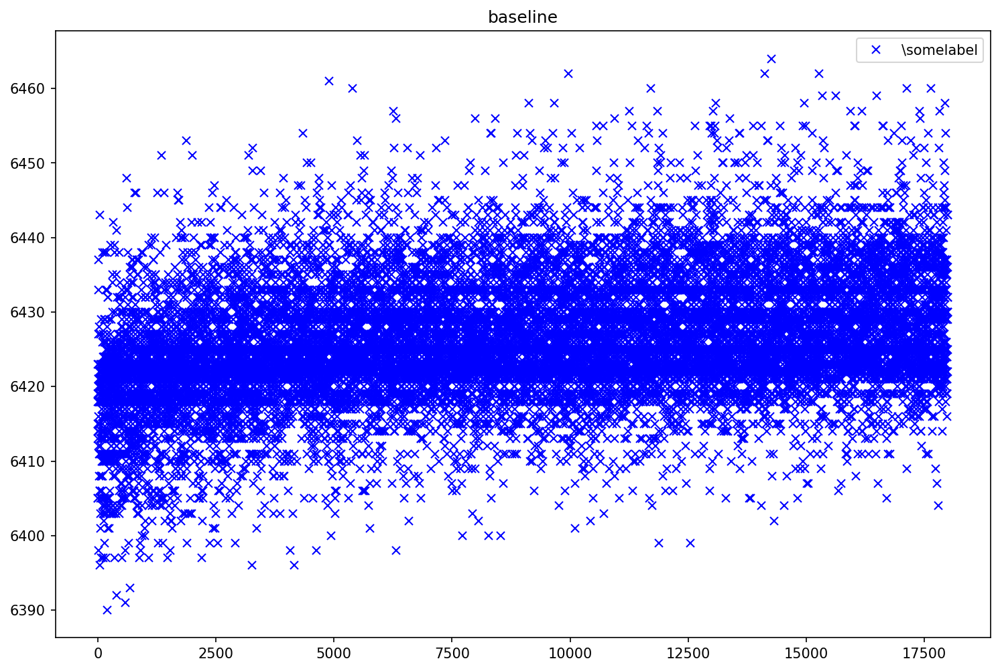

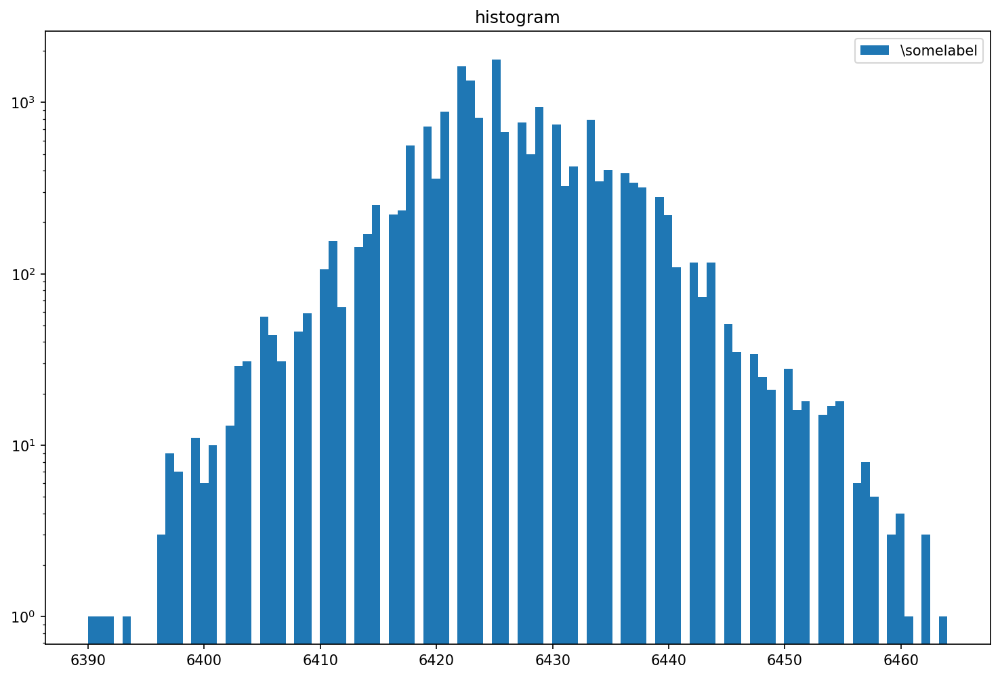

(145, 384)


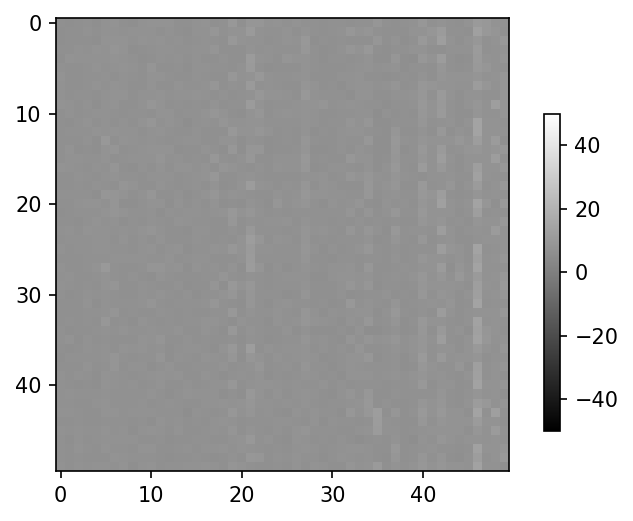

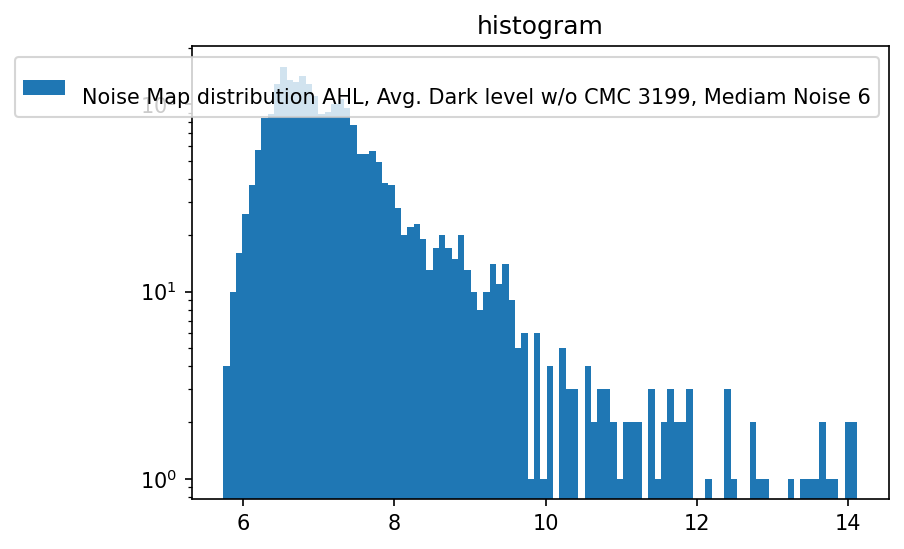


Camera  ePixHr10kTBatcher  selected.
Command executed :  <class 'pyrogue._Command.BaseCommand'> - ePixHr10kT.EpixHR.Hr10kTAsic2.ClearMatrix
The file does not exist
/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_5_Preamp_4_Vld1b_1_PixelCB_4_Filter_DAC_38_VRrefdac_53_DHg_1_RefGenB_2_RefGenC_3_peds_12_trbit_0_run1.dat
Aquisition Counter 1841343
DAQ Counter 1691201
Number of frames received: 50047
Number of frames received: 52050
Delta Aquisition Counter: 54052
Number of frames received: 54052
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 2
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56072)
(145, 384)


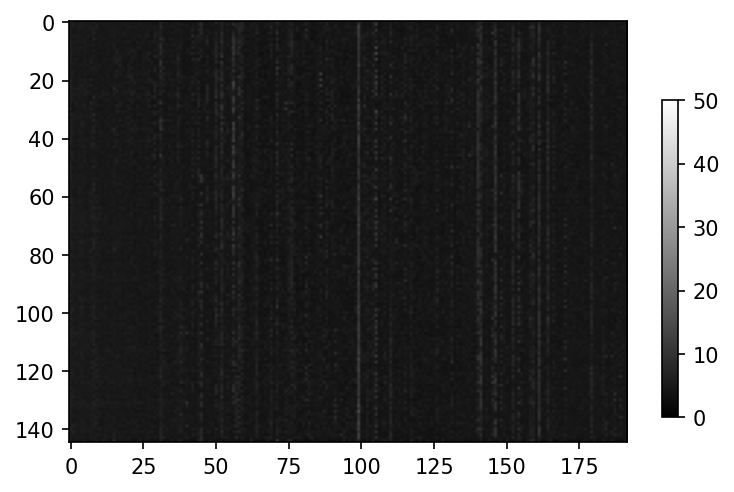

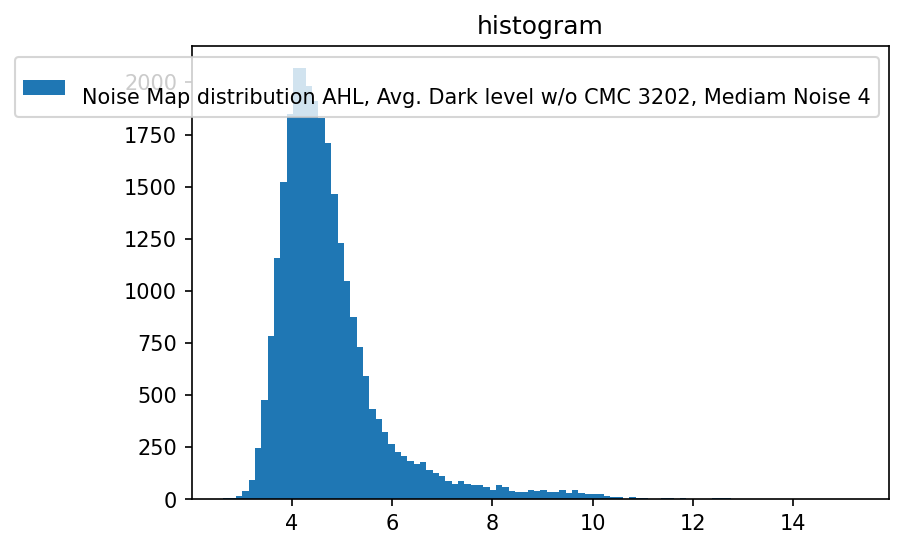

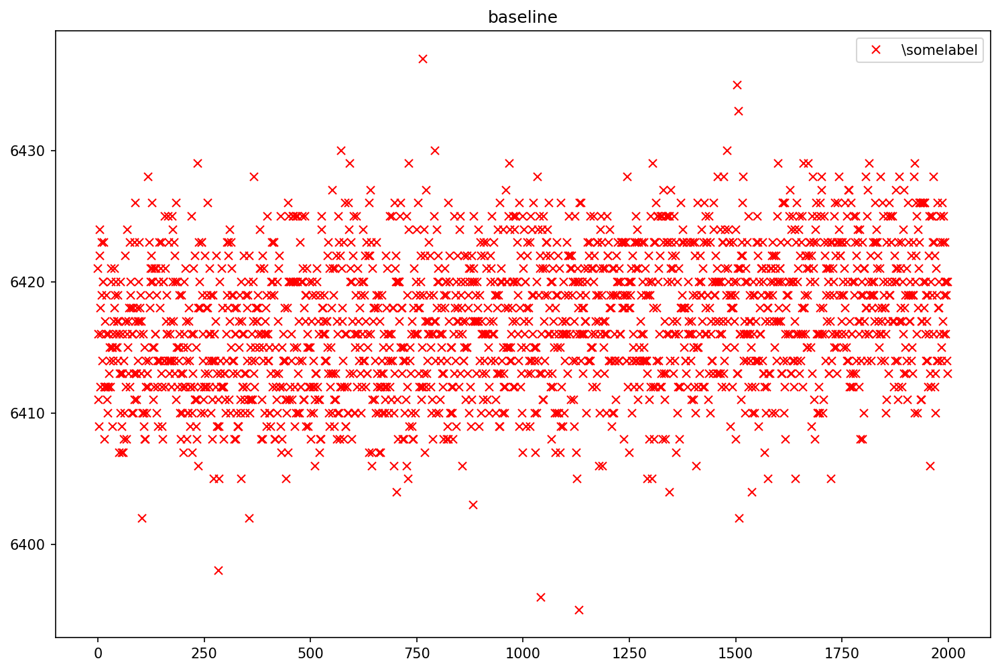

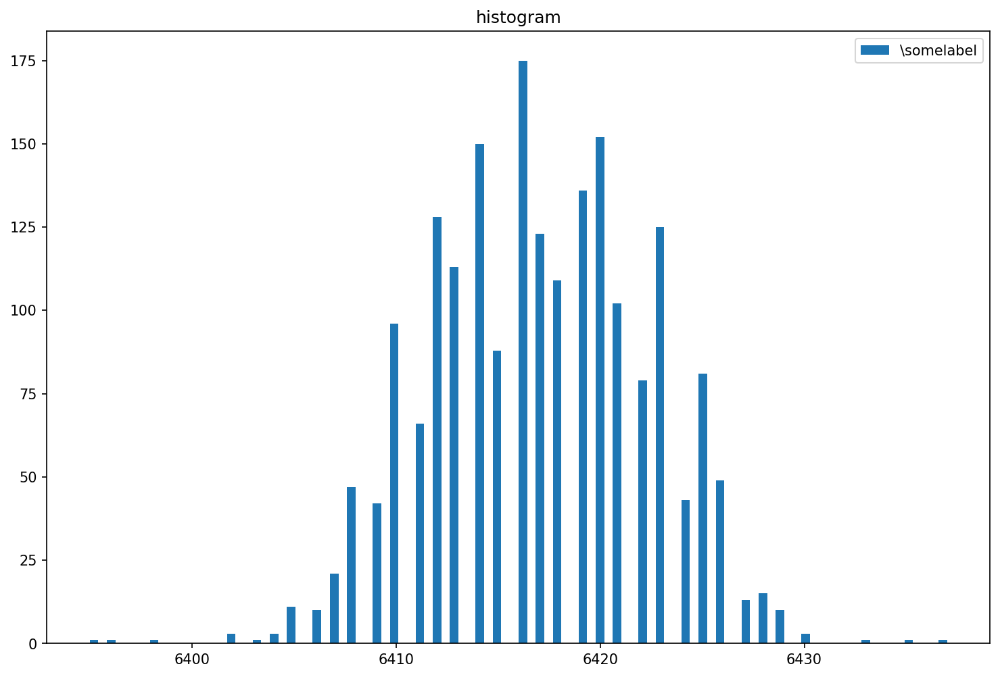

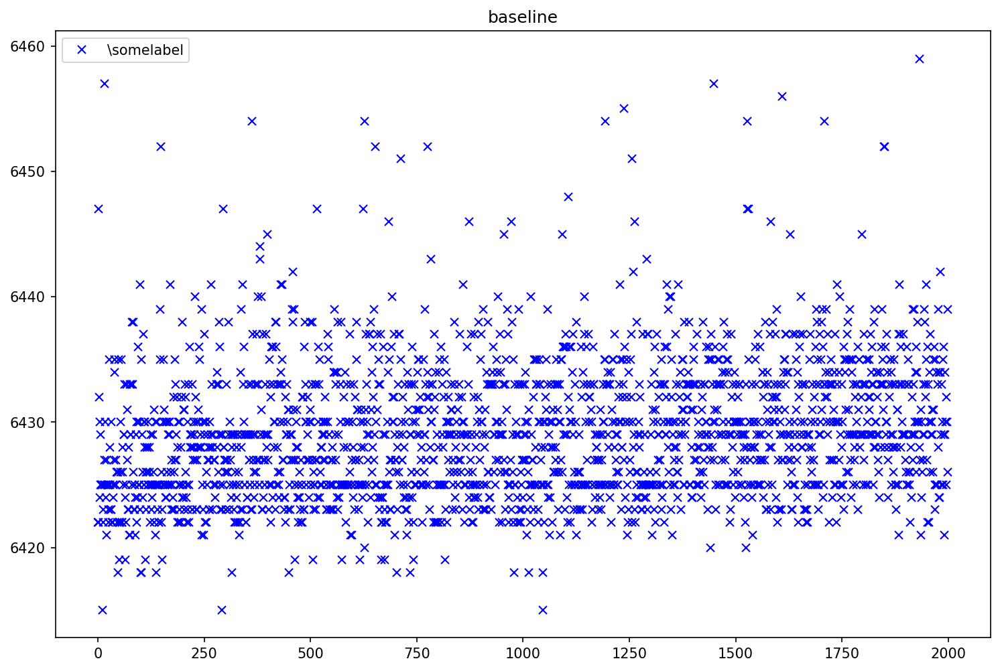

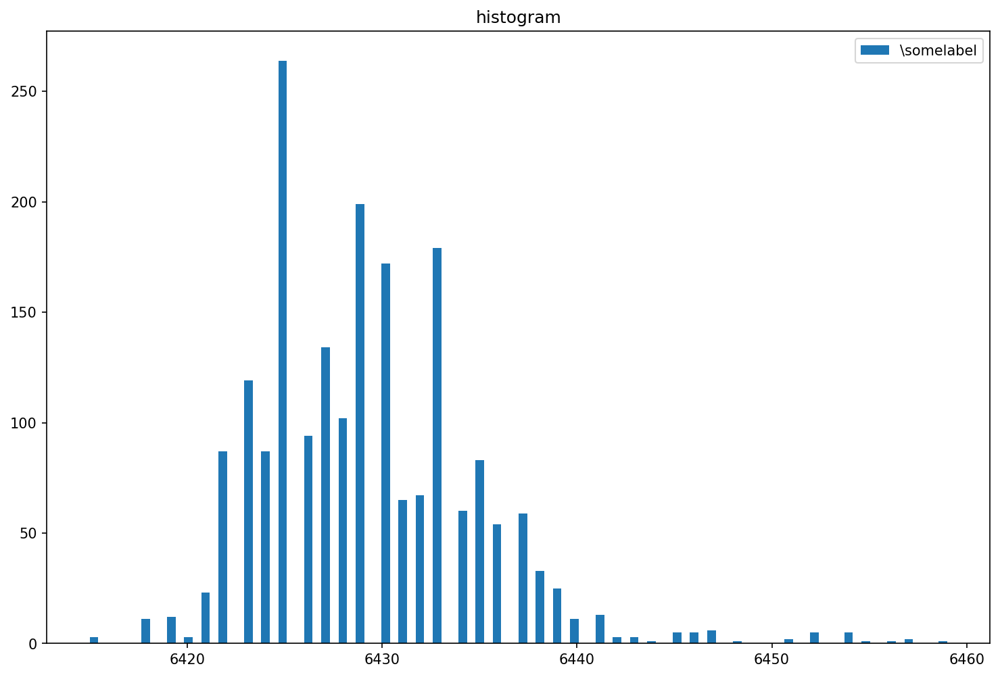

(145, 384)


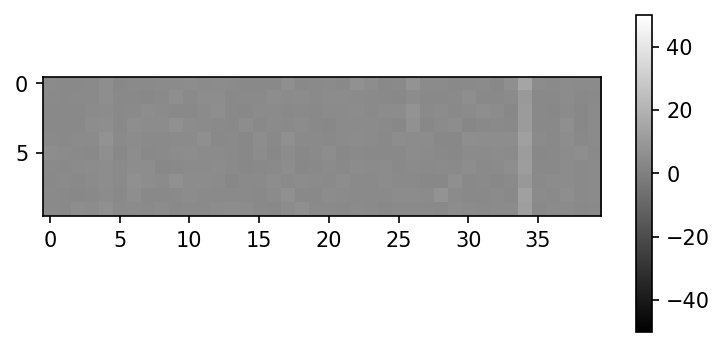

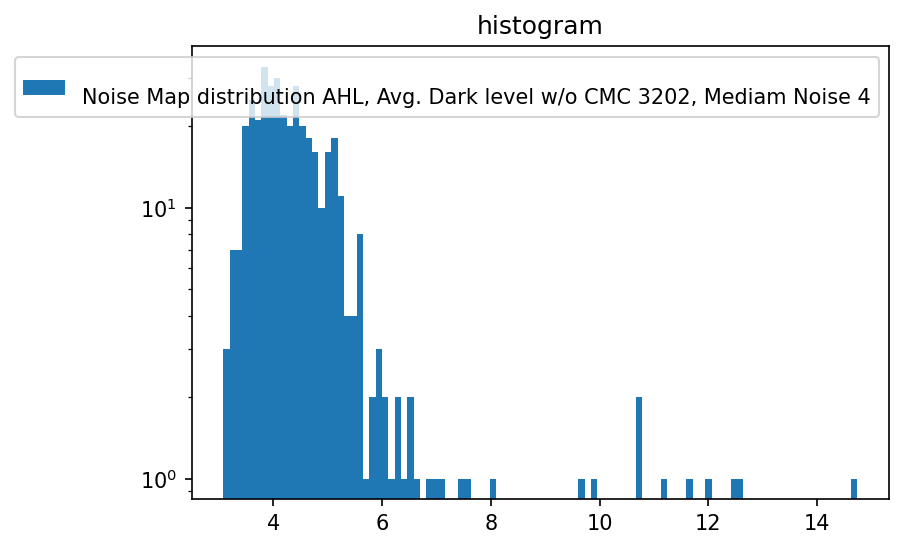


(145, 384)


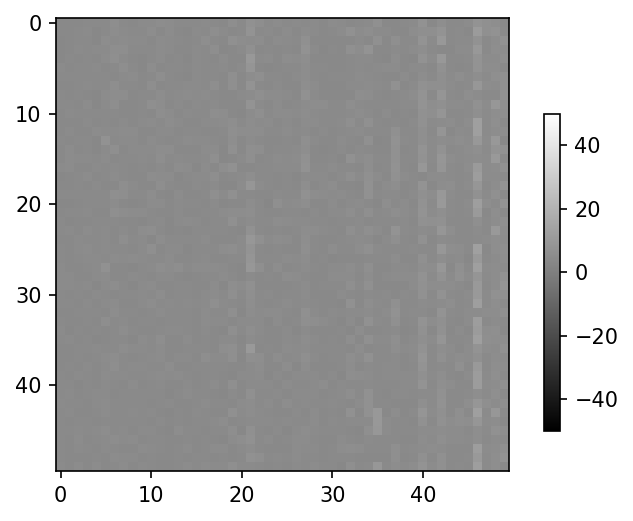

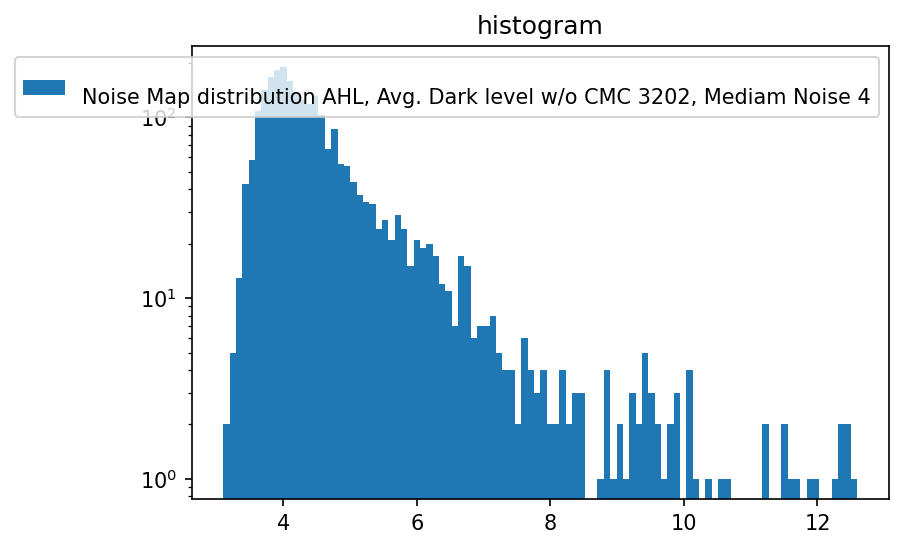


/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_5_Preamp_4_Vld1b_1_PixelCB_4_Filter_DAC_38_VRrefdac_53_DHg_1_RefGenB_2_RefGenC_3_peds_12_trbit_0_run1.dat
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 2
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 3
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 4
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 5
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 6
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get 

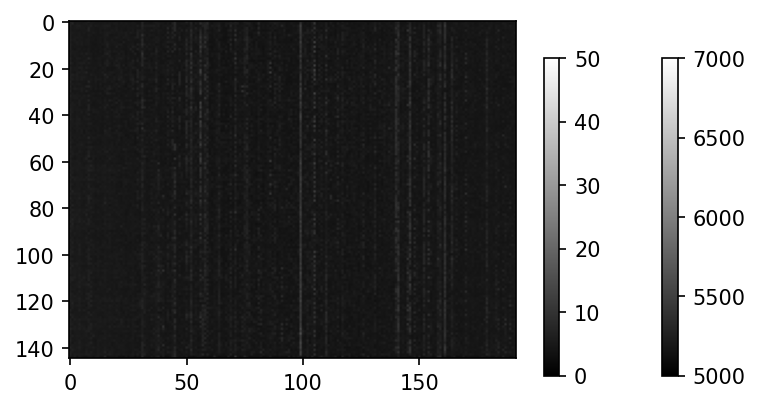

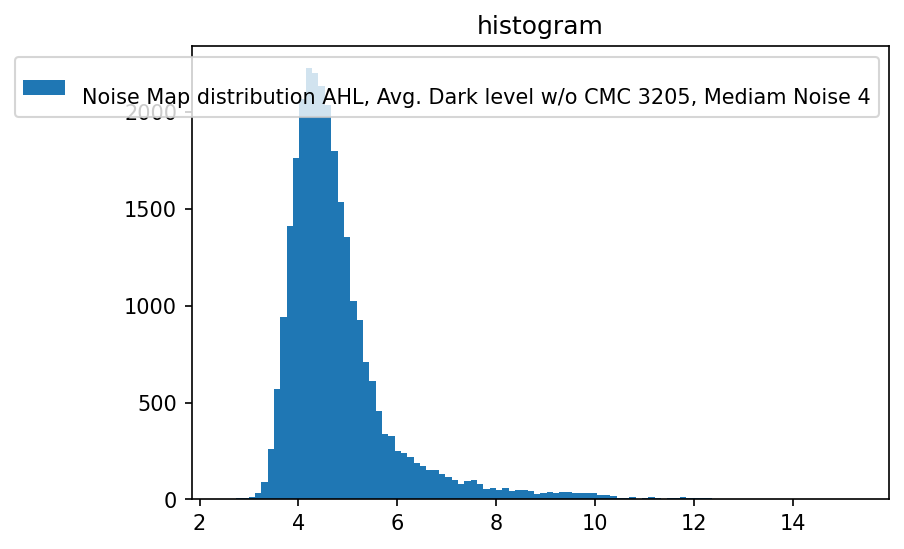

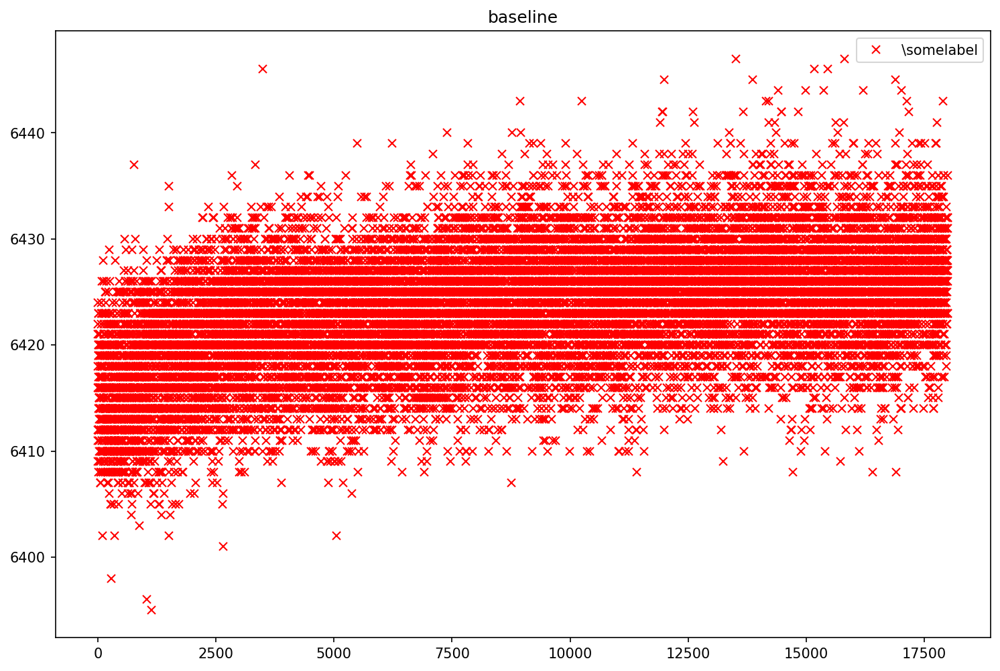

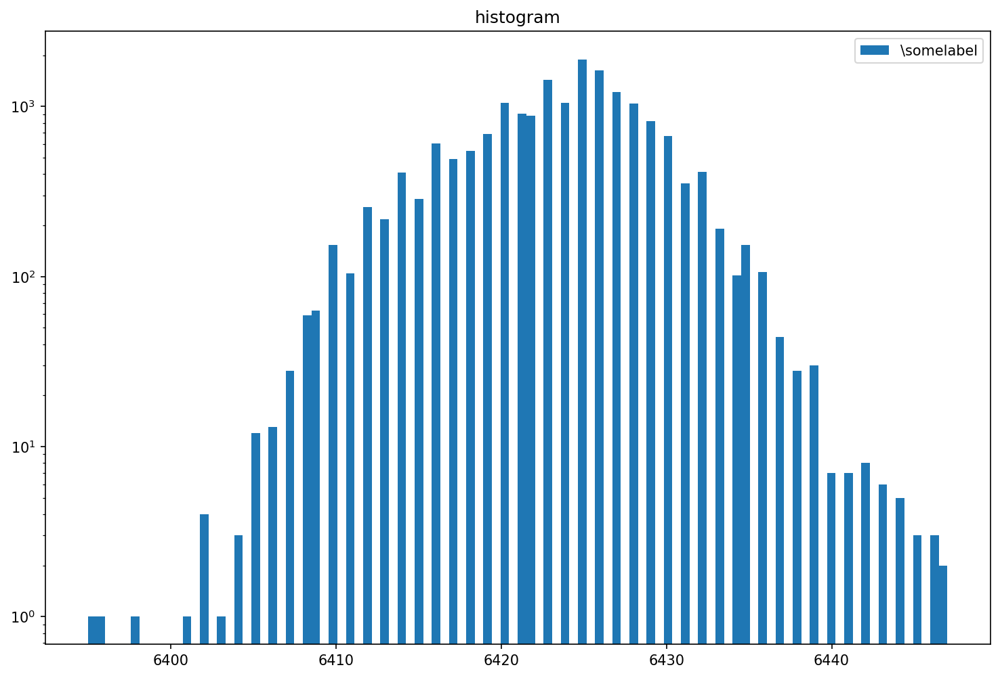

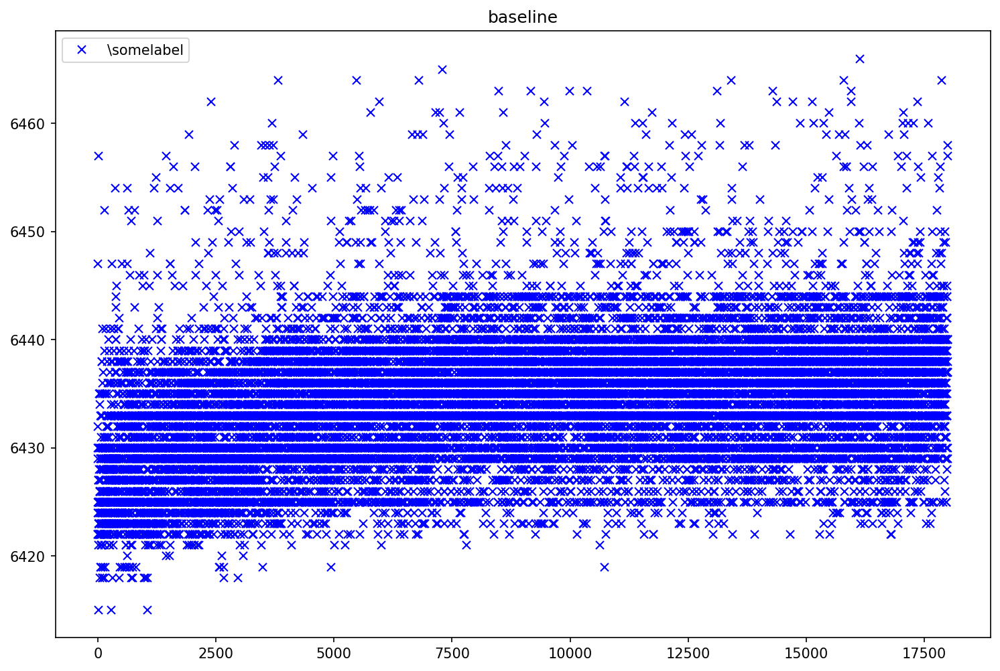

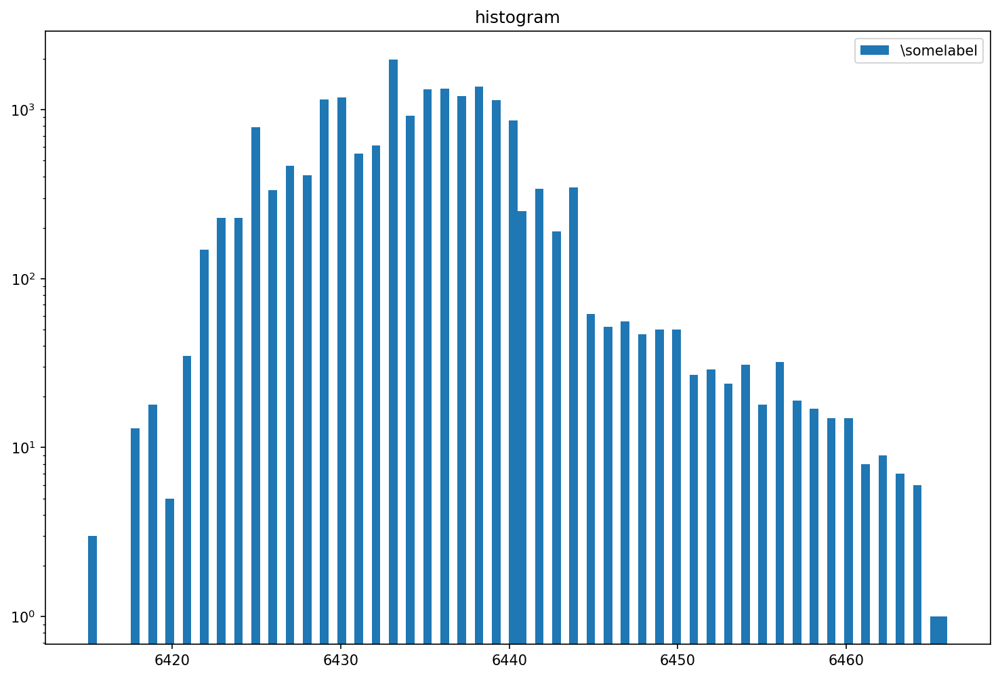

(145, 384)


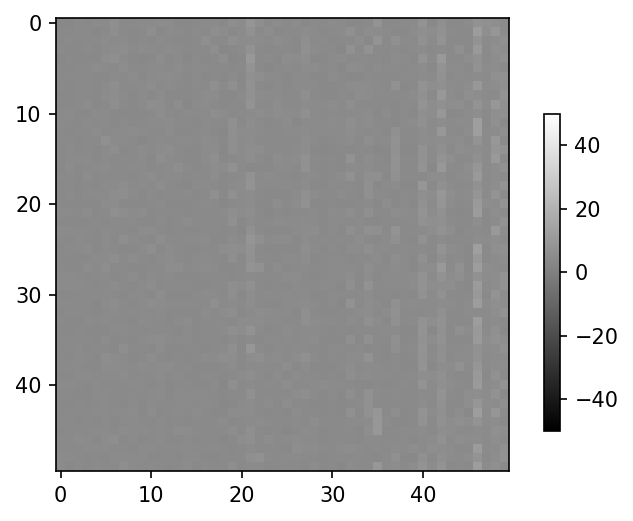

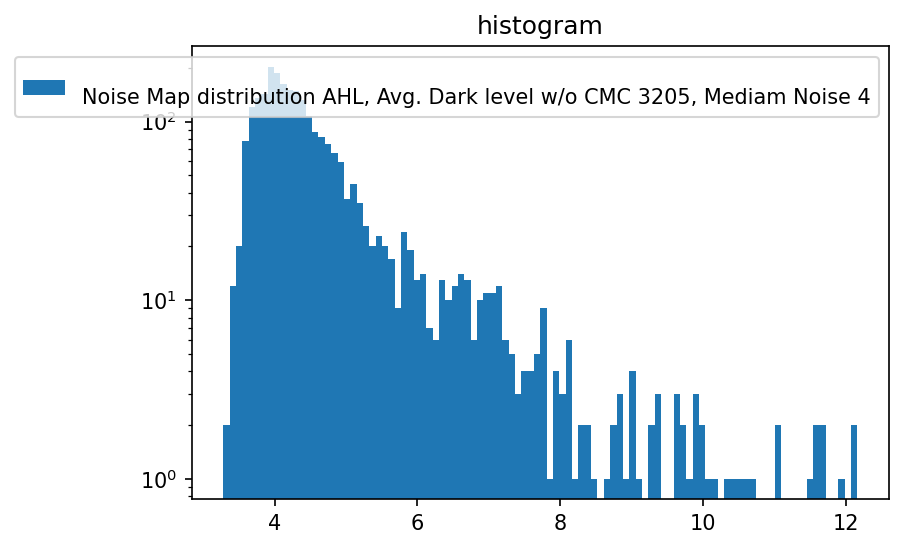


Camera  ePixHr10kTBatcher  selected.
Command executed :  <class 'pyrogue._Command.BaseCommand'> - ePixHr10kT.EpixHR.Hr10kTAsic2.ClearMatrix
The file does not exist
/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_5_Preamp_4_Vld1b_1_PixelCB_4_Filter_DAC_38_VRrefdac_53_DHg_1_RefGenB_2_RefGenC_3_peds_8_trbit_0_run1.dat
Aquisition Counter 1895395
DAQ Counter 1745253
Number of frames received: 50048
Number of frames received: 52050
Delta Aquisition Counter: 54053
Number of frames received: 54053
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 2
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56072)
(145, 384)


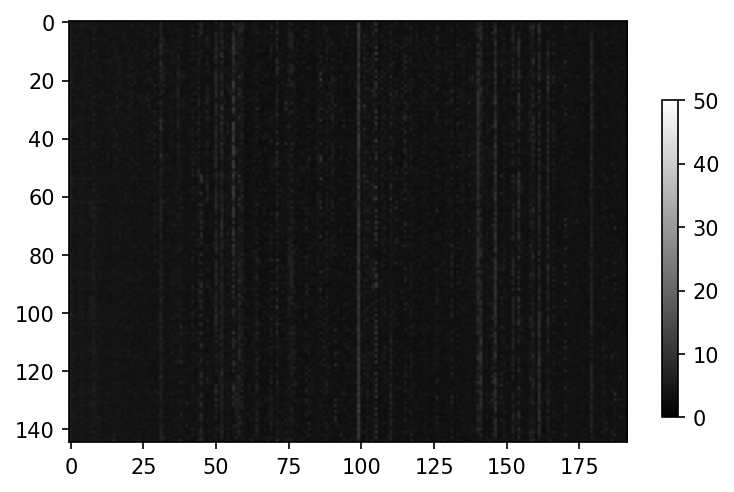

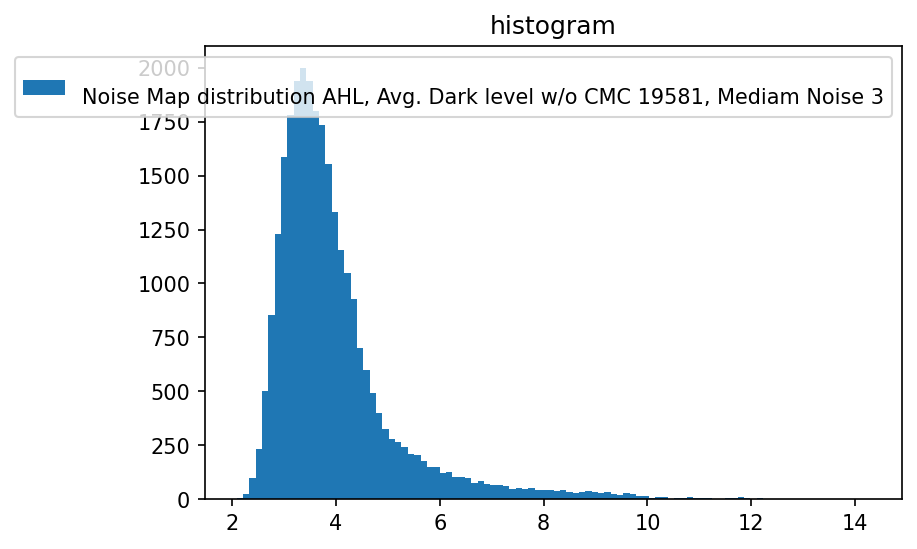

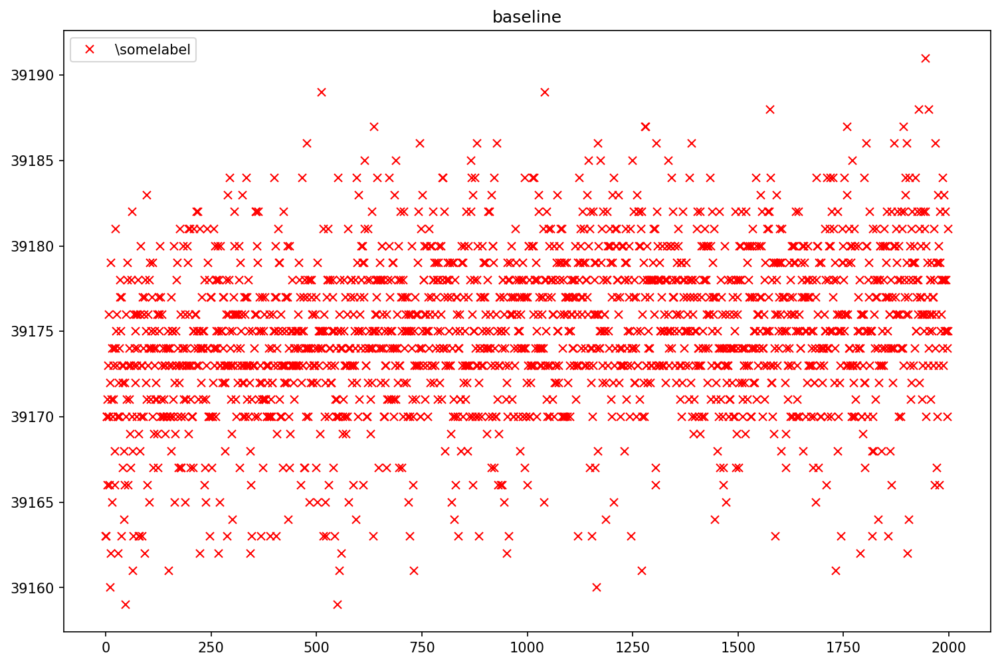

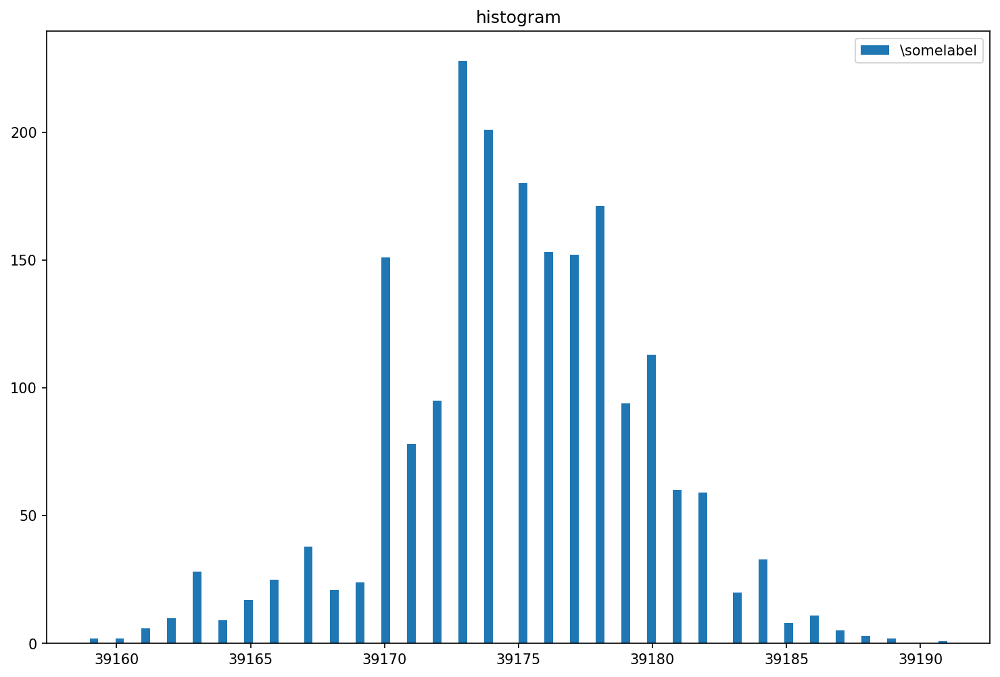

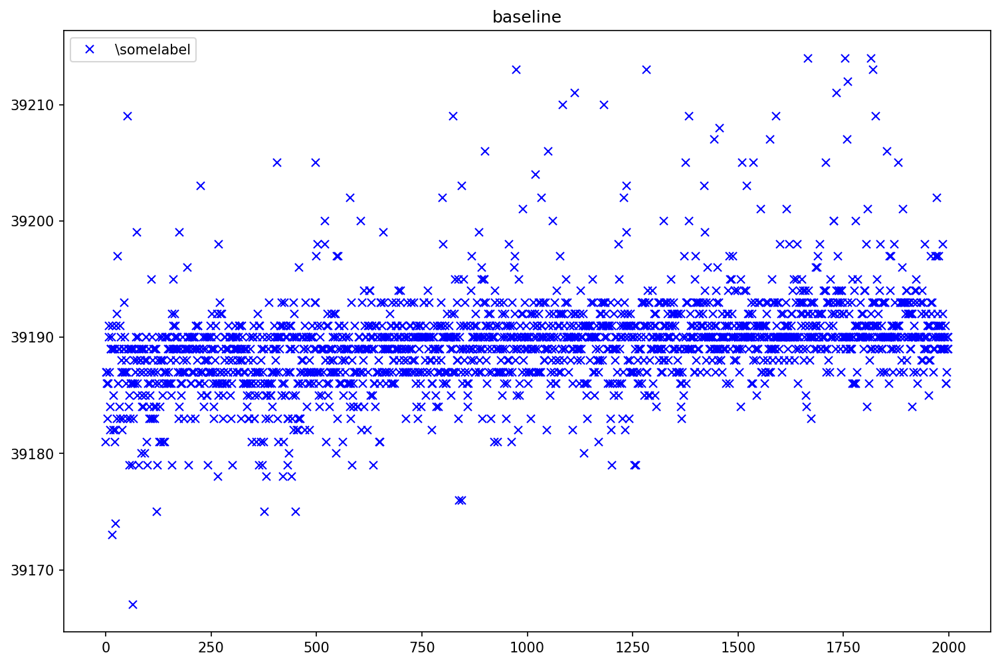

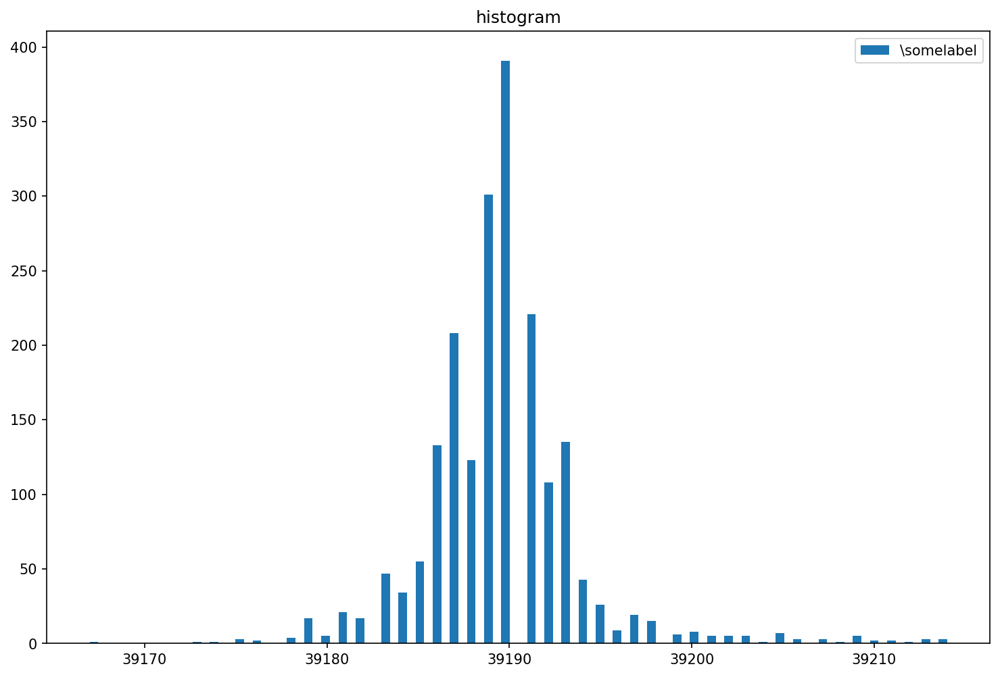

(145, 384)


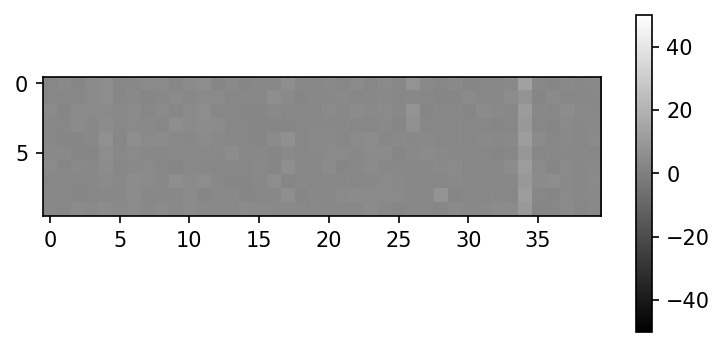

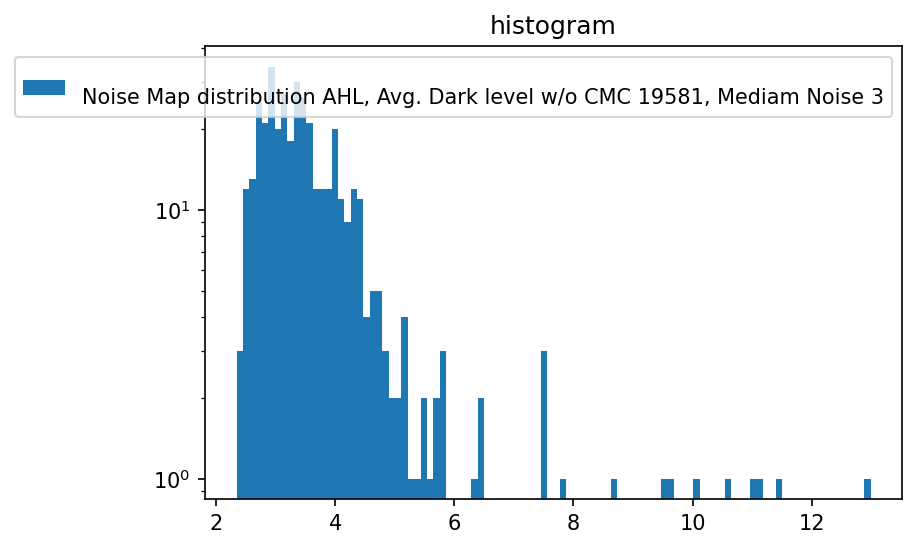


(145, 384)


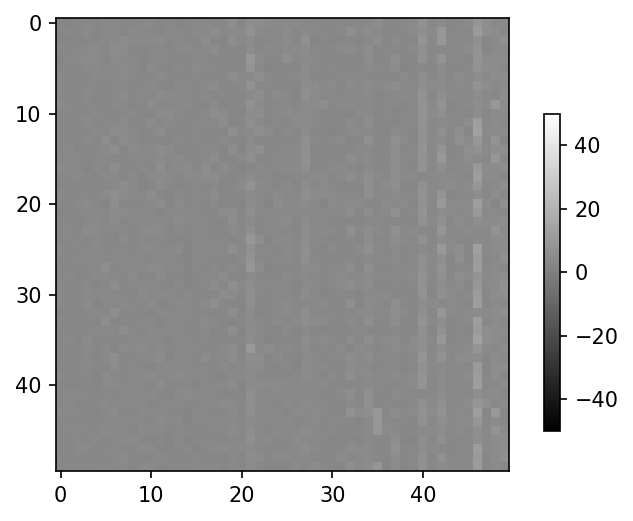

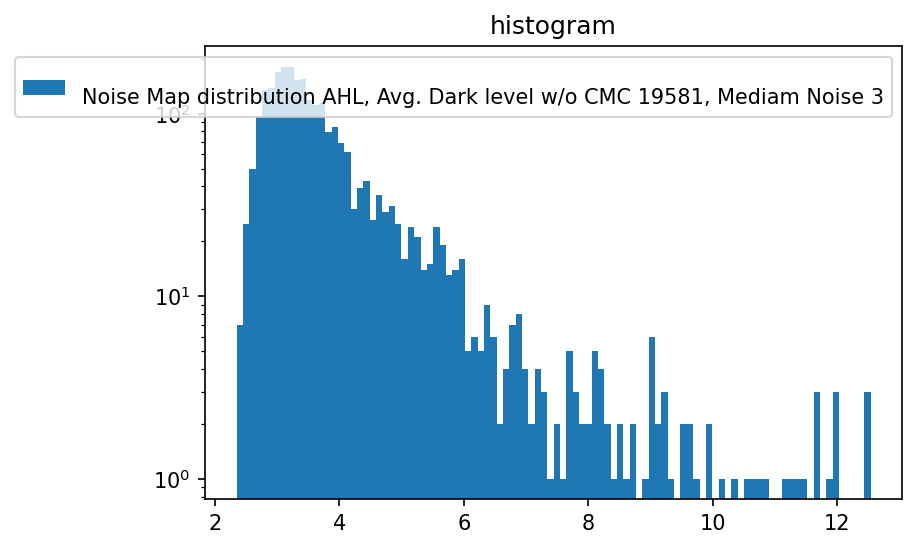


/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_5_Preamp_4_Vld1b_1_PixelCB_4_Filter_DAC_38_VRrefdac_53_DHg_1_RefGenB_2_RefGenC_3_peds_8_trbit_0_run1.dat
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 2
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 3
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 4
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 5
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 6
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get d

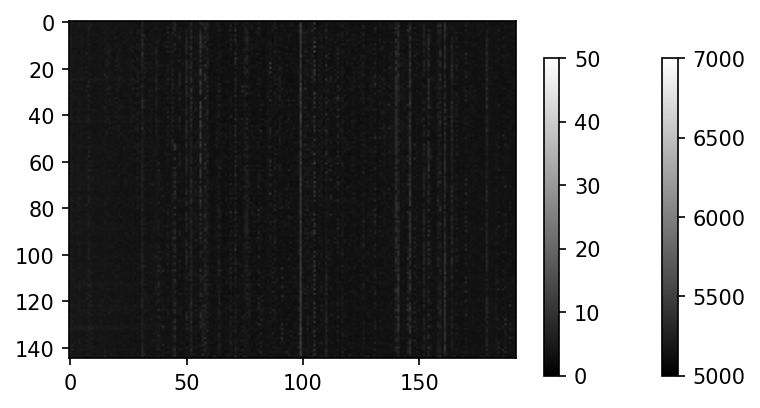

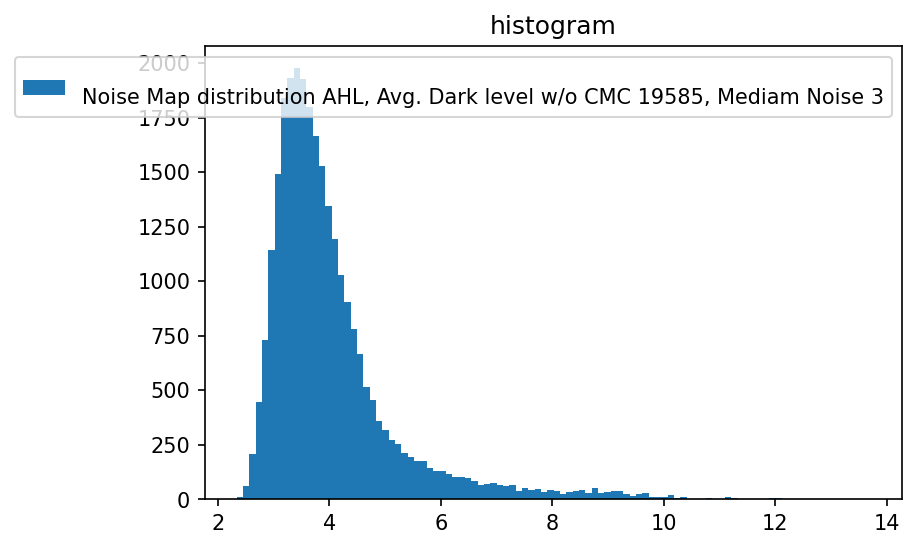

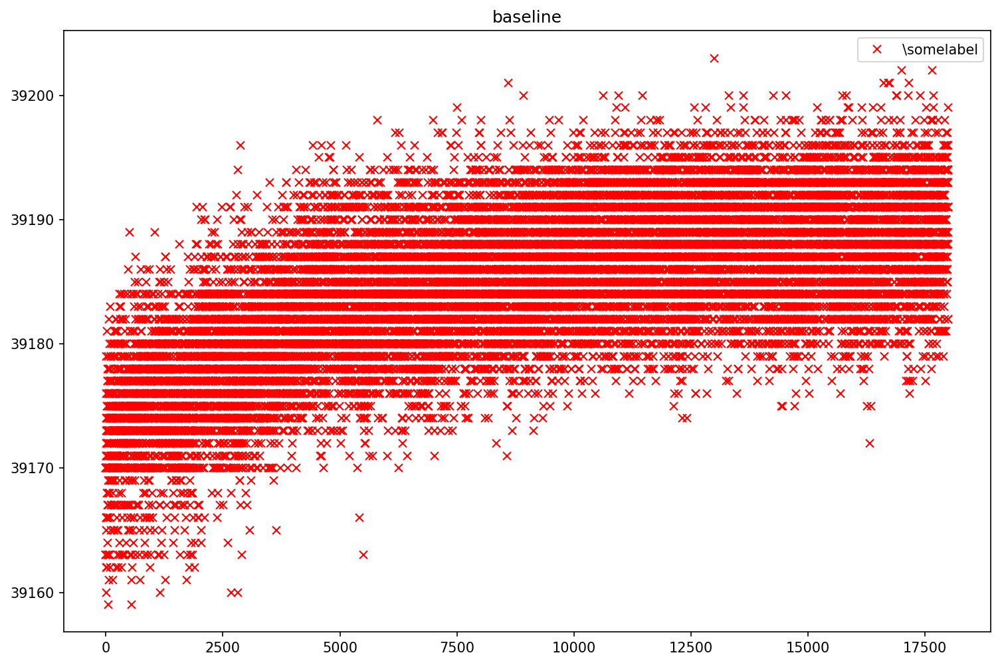

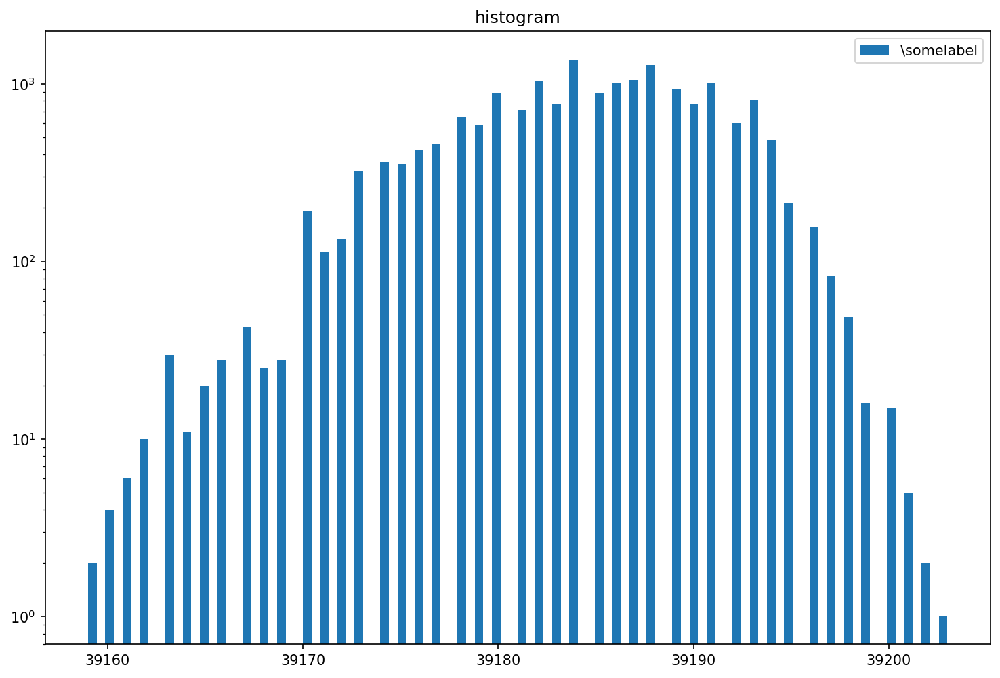

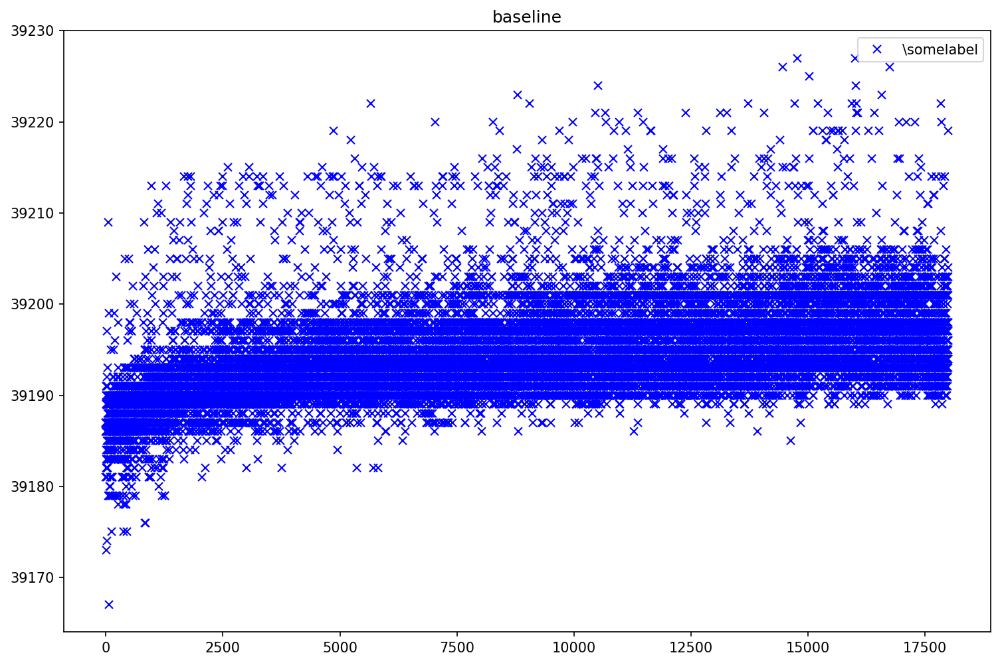

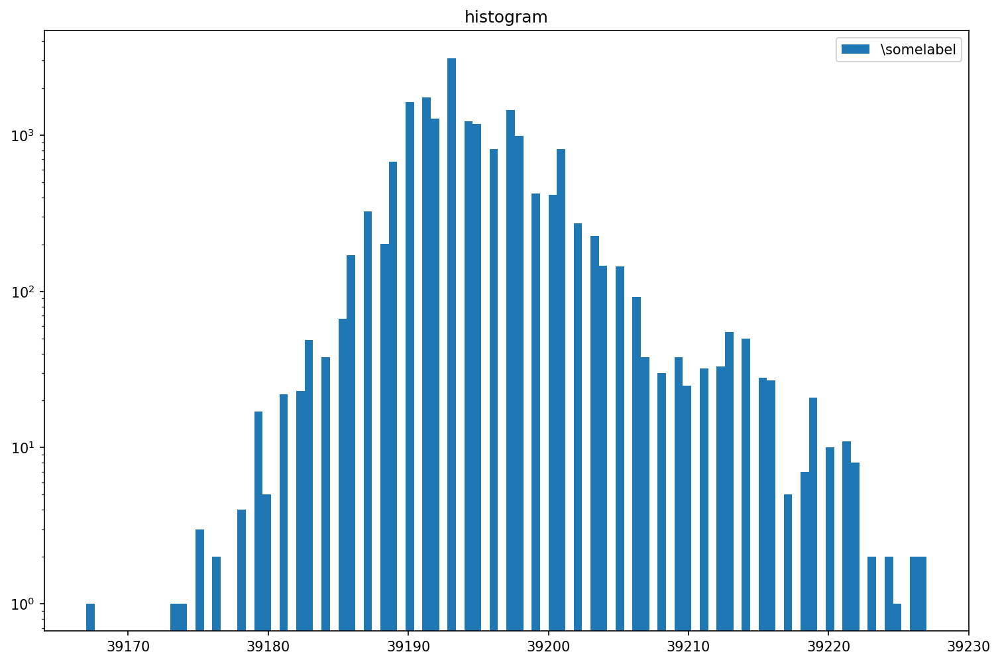

(145, 384)


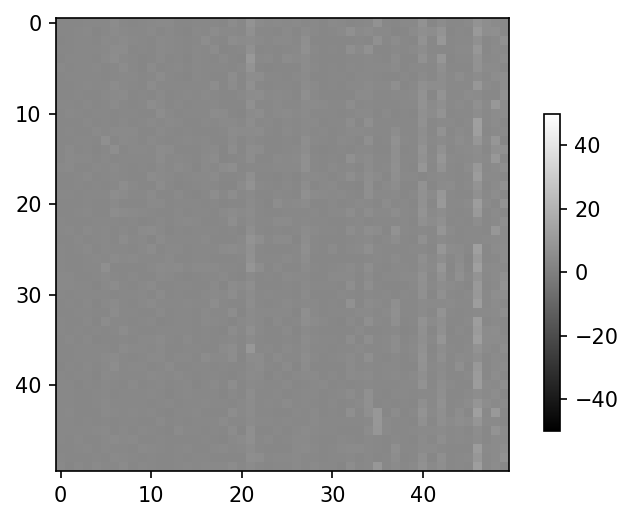

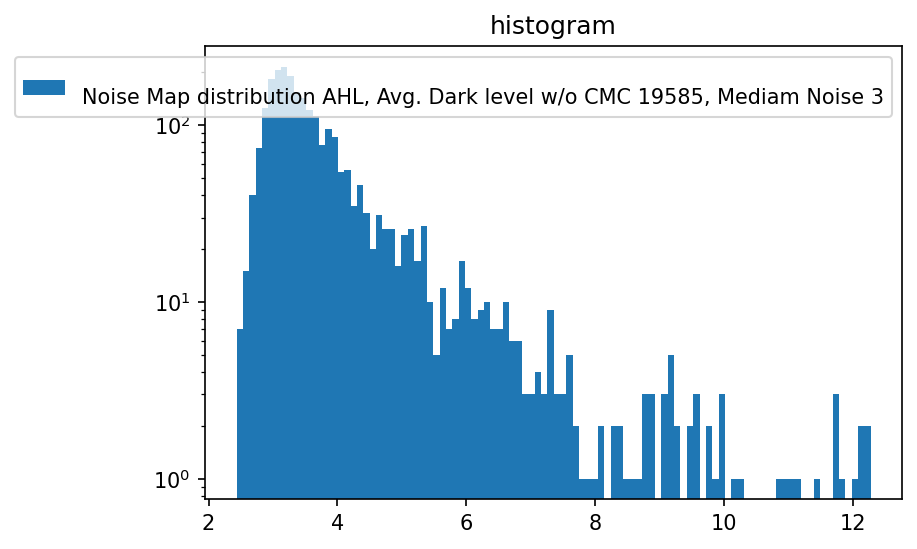


Camera  ePixHr10kTBatcher  selected.
Command executed :  <class 'pyrogue._Command.BaseCommand'> - ePixHr10kT.EpixHR.Hr10kTAsic2.ClearMatrix
The file does not exist
/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_5_Preamp_4_Vld1b_1_PixelCB_4_Filter_DAC_38_VRrefdac_53_DHg_1_RefGenB_2_RefGenC_3_peds_0_trbit_1_run1.dat
Aquisition Counter 1949448
DAQ Counter 1799306
Number of frames received: 50048
Number of frames received: 52050
Delta Aquisition Counter: 54052
Number of frames received: 54052
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 2
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56072)
(145, 384)


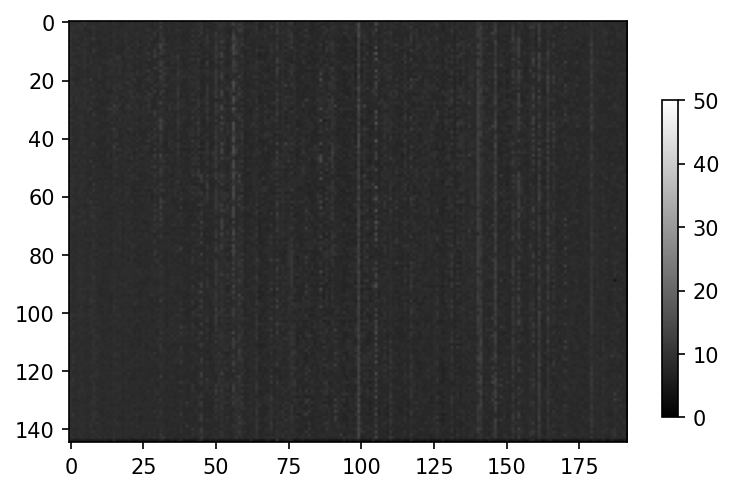

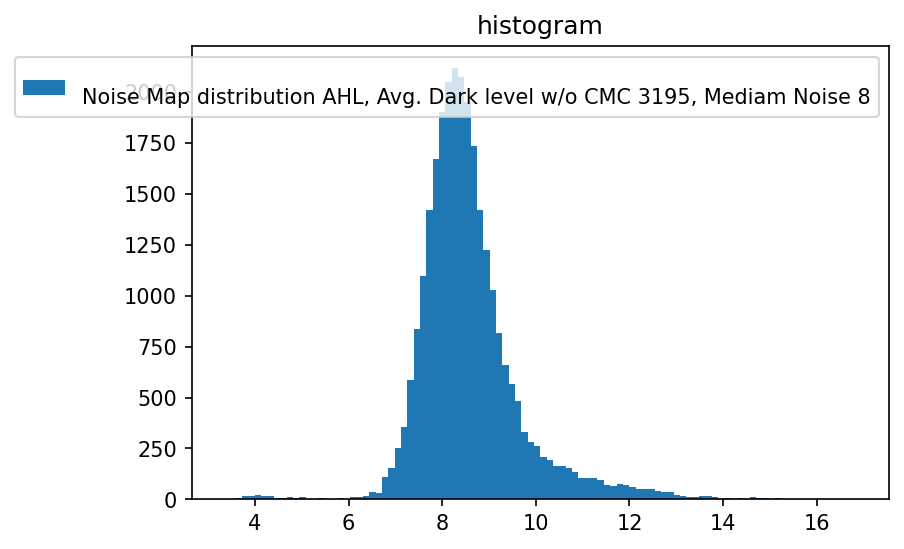

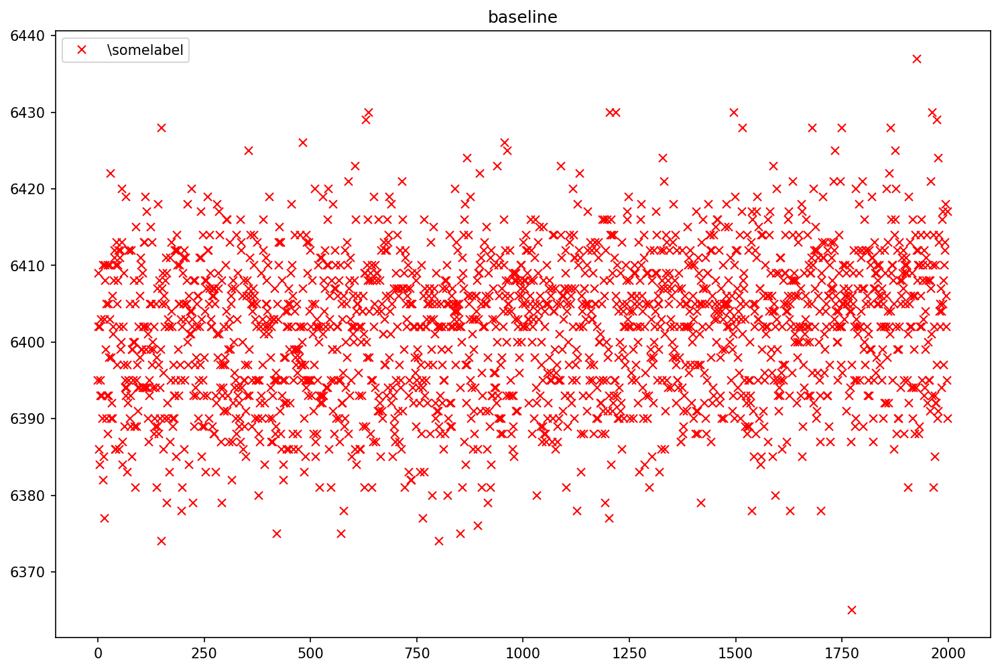

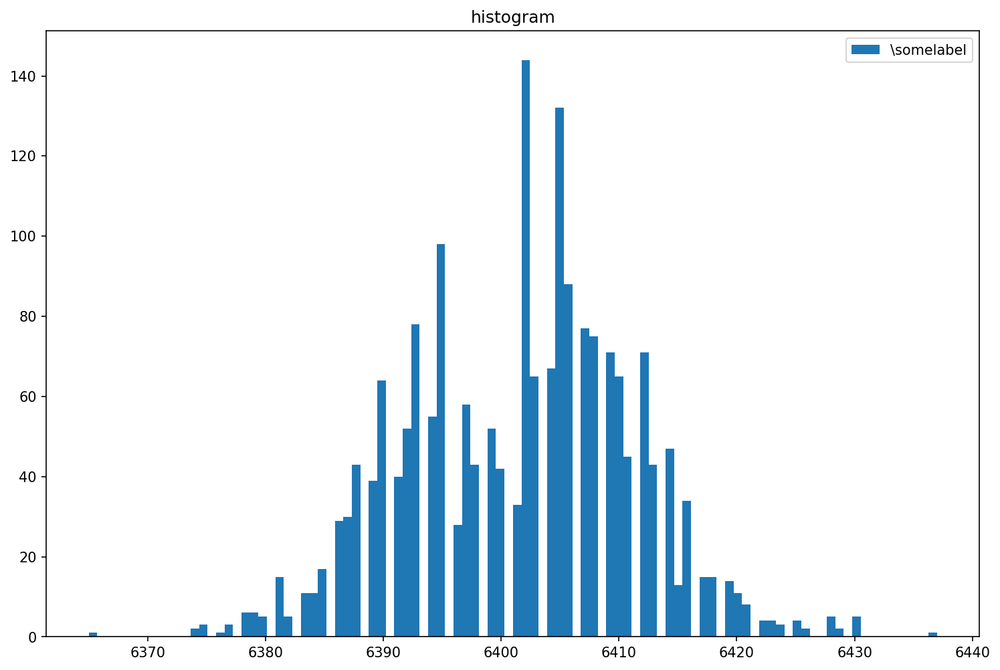

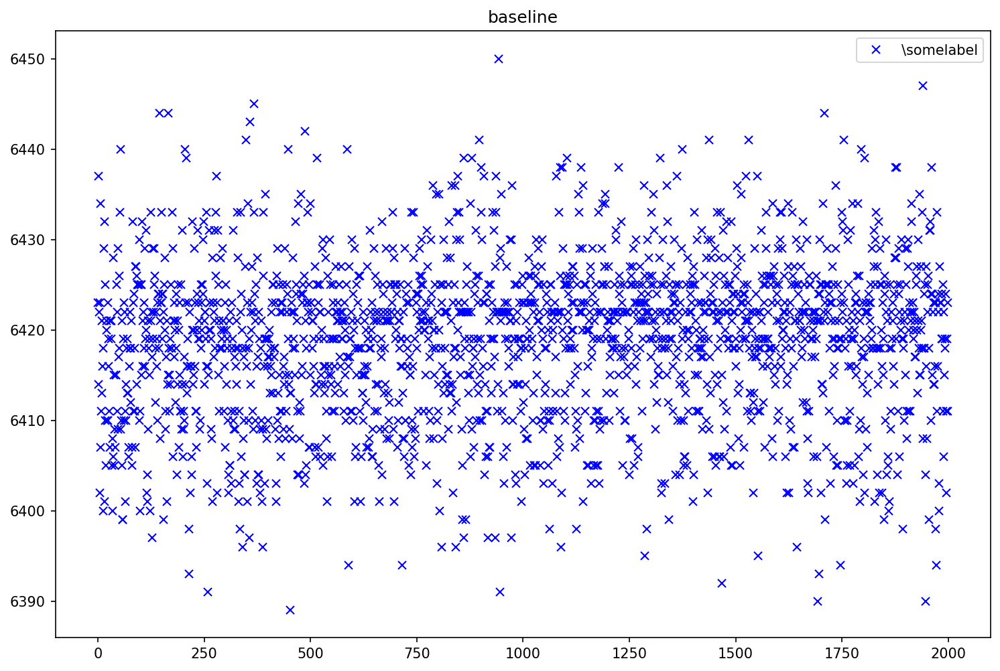

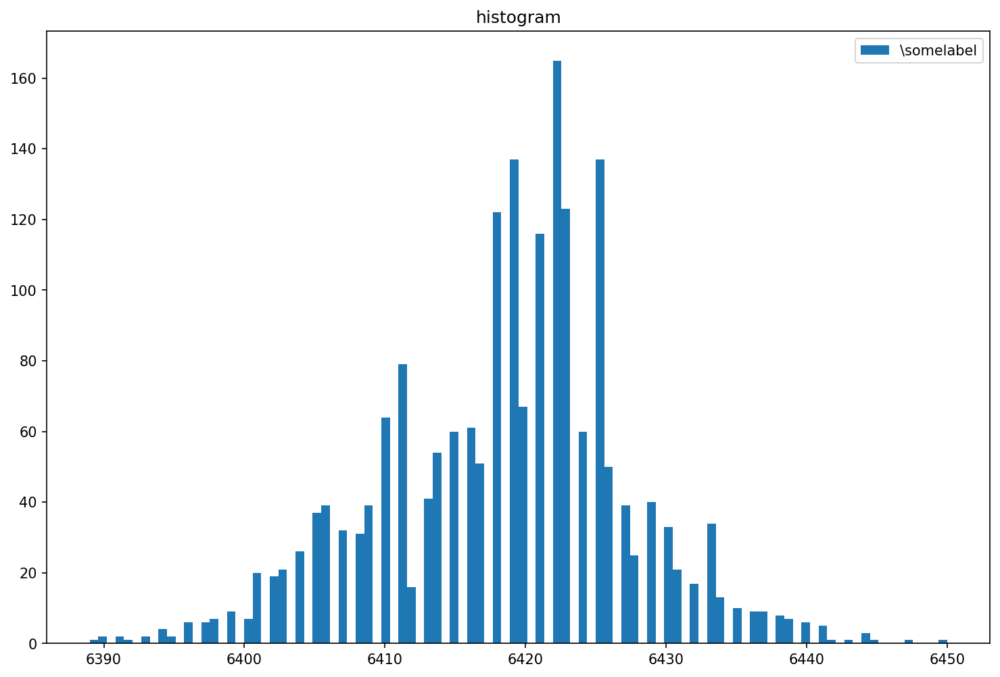

(145, 384)


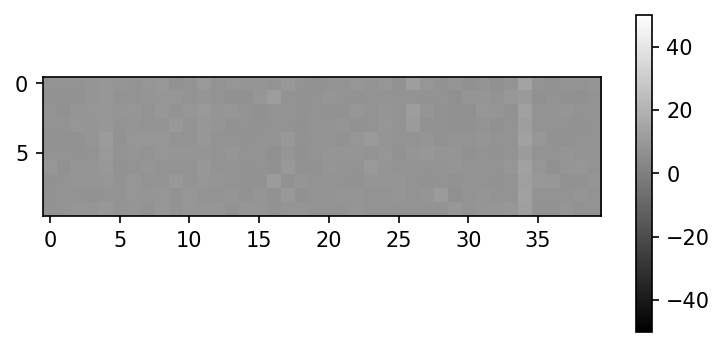

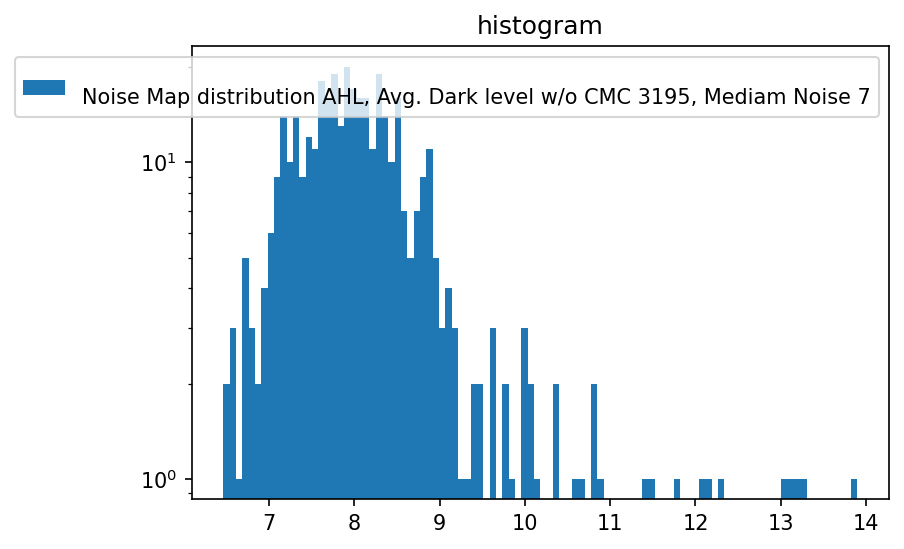


(145, 384)


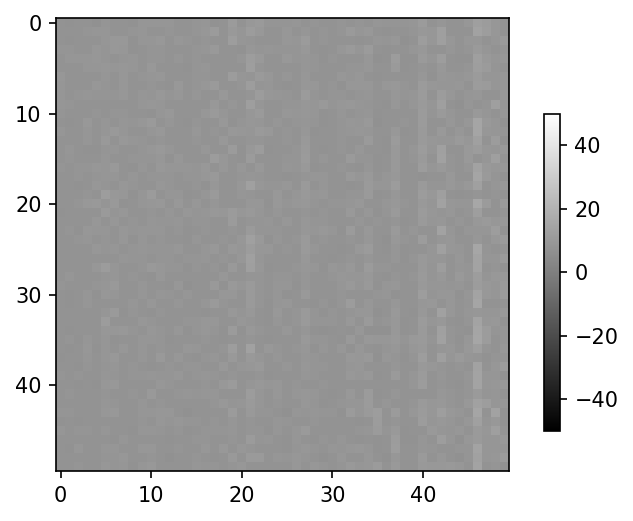

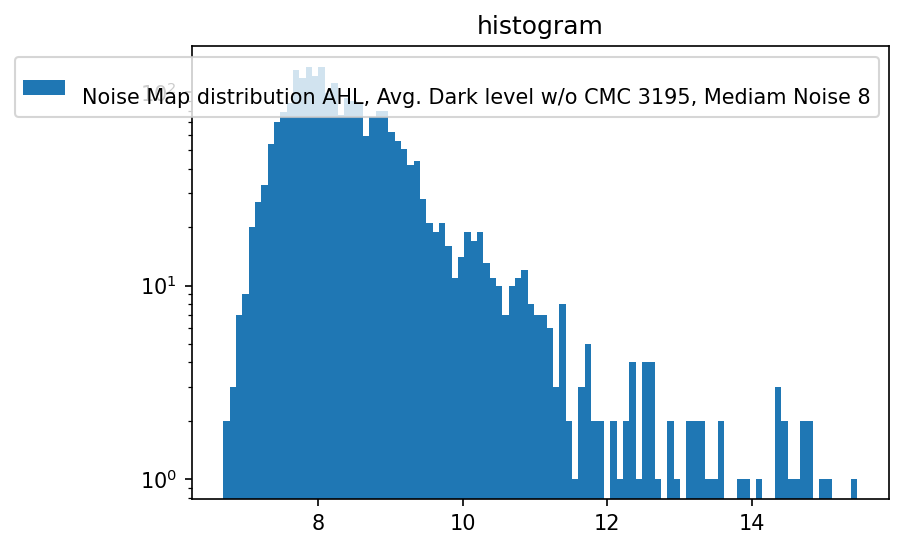


/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_5_Preamp_4_Vld1b_1_PixelCB_4_Filter_DAC_38_VRrefdac_53_DHg_1_RefGenB_2_RefGenC_3_peds_0_trbit_1_run1.dat
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 2
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 3
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 4
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 5
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 6
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get d

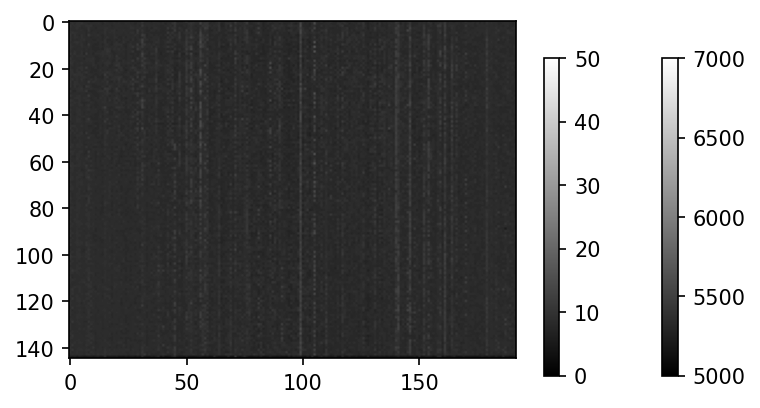

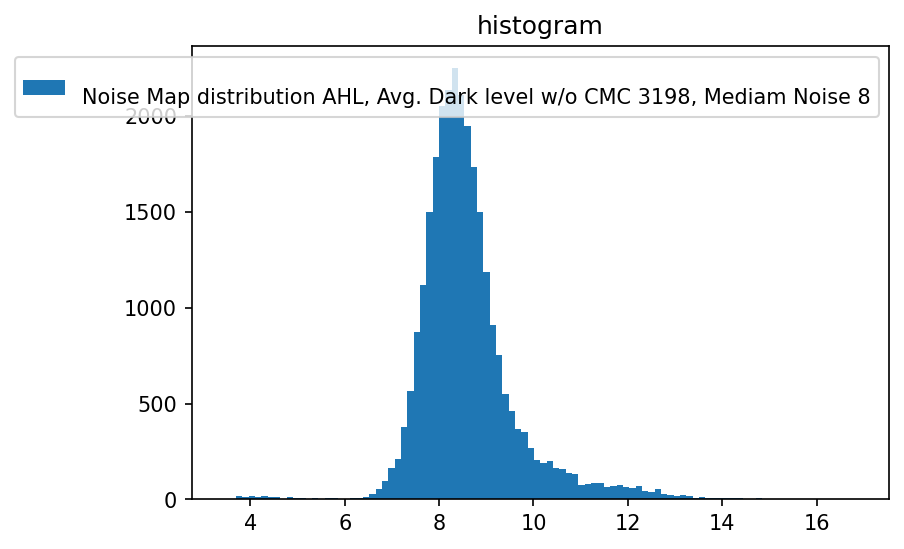

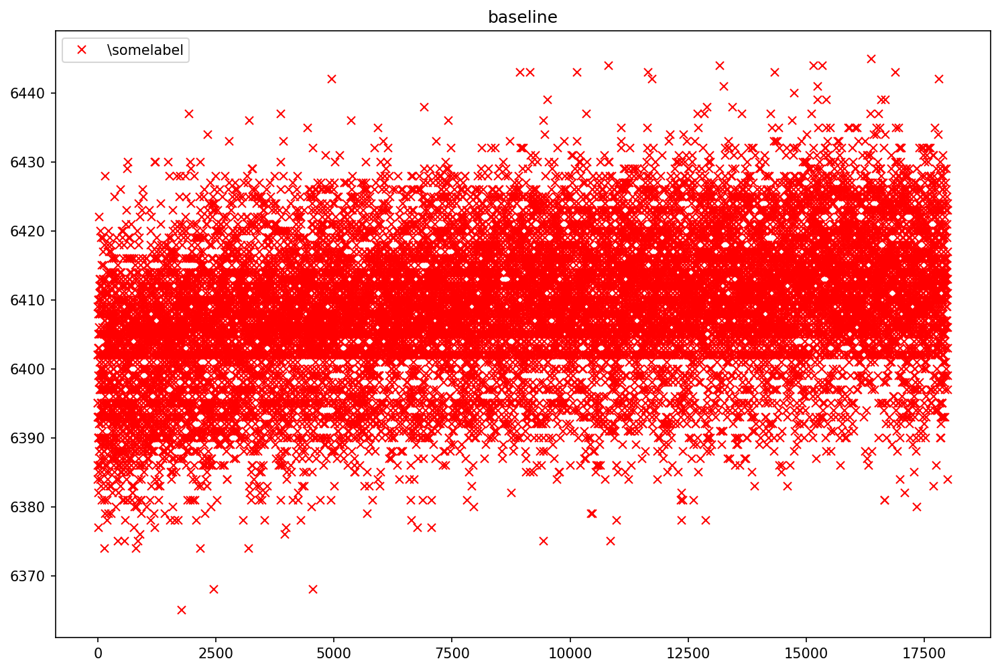

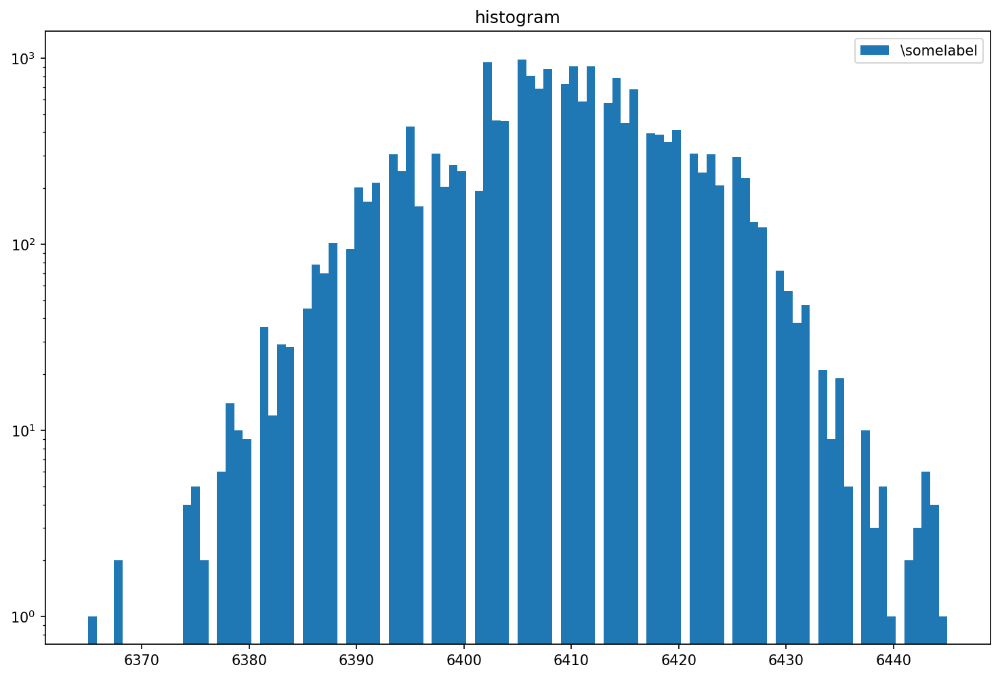

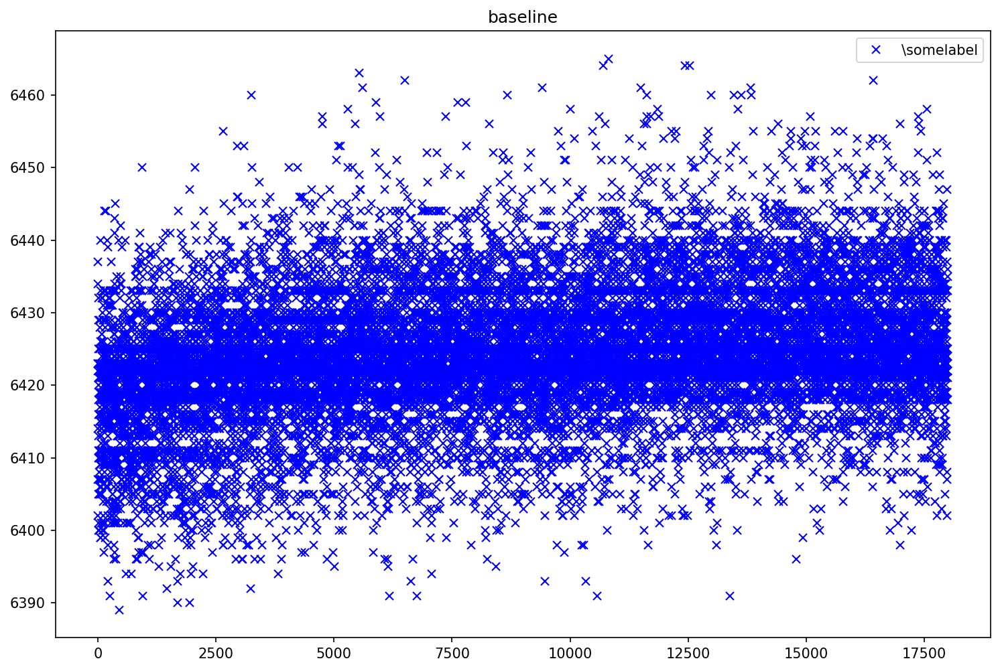

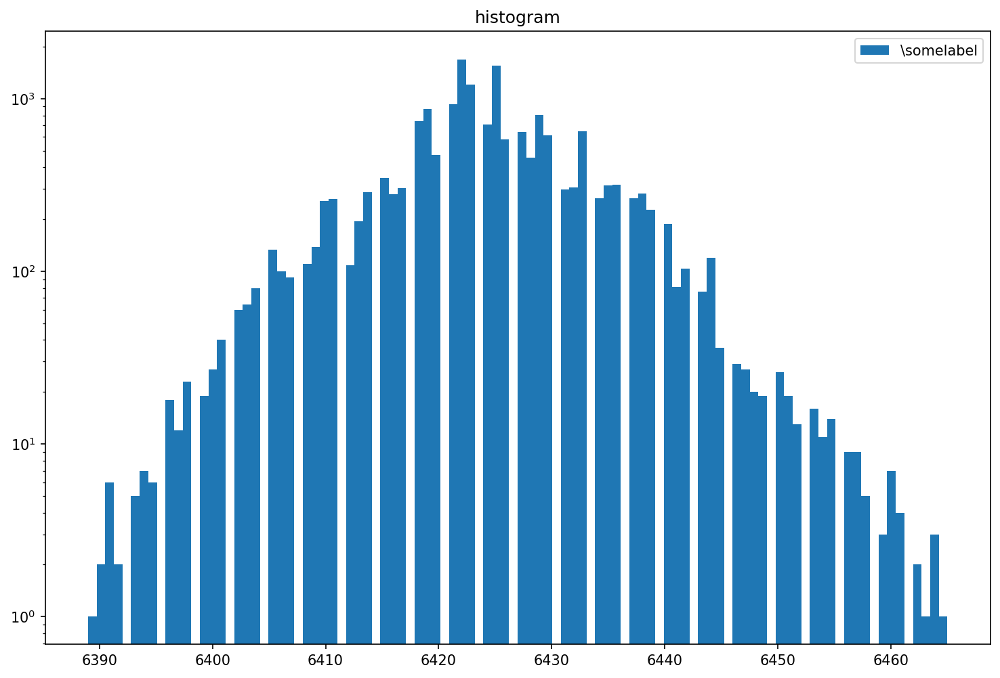

(145, 384)


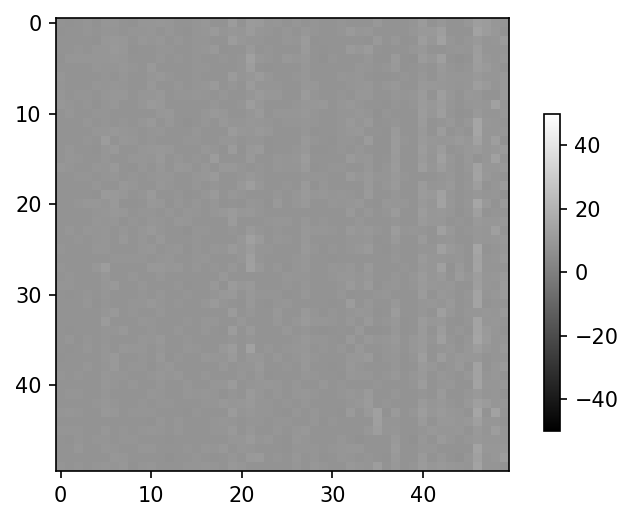

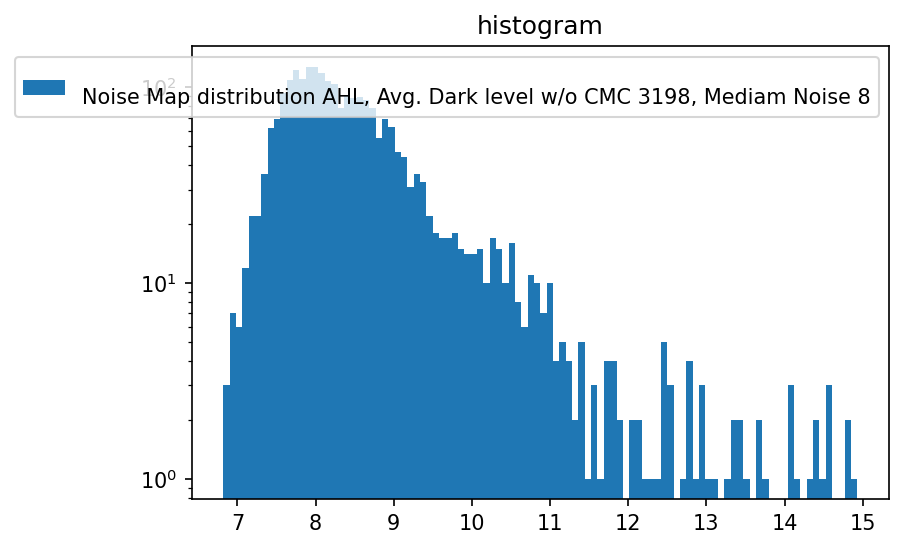


Camera  ePixHr10kTBatcher  selected.
Command executed :  <class 'pyrogue._Command.BaseCommand'> - ePixHr10kT.EpixHR.Hr10kTAsic2.ClearMatrix
The file does not exist
/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_5_Preamp_4_Vld1b_1_PixelCB_4_Filter_DAC_38_VRrefdac_53_DHg_1_RefGenB_2_RefGenC_3_peds_0_trbit_0_run1.dat
Aquisition Counter 2003500
DAQ Counter 1853358
Number of frames received: 50048
Number of frames received: 52050
Delta Aquisition Counter: 54053
Number of frames received: 54053
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 2
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56072)
(145, 384)


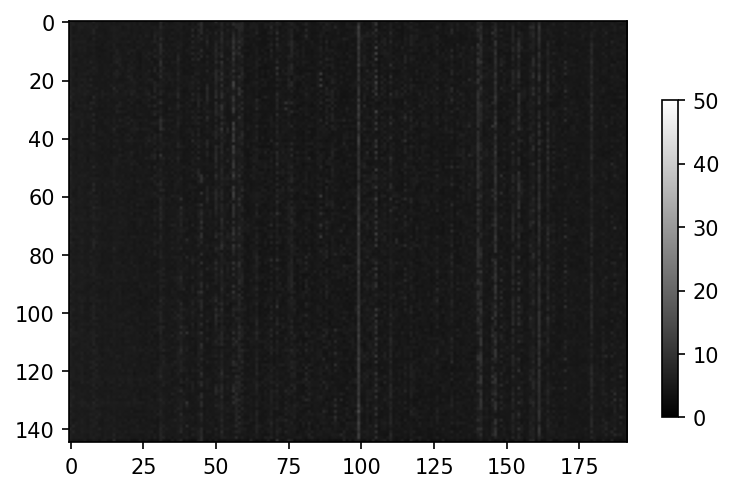

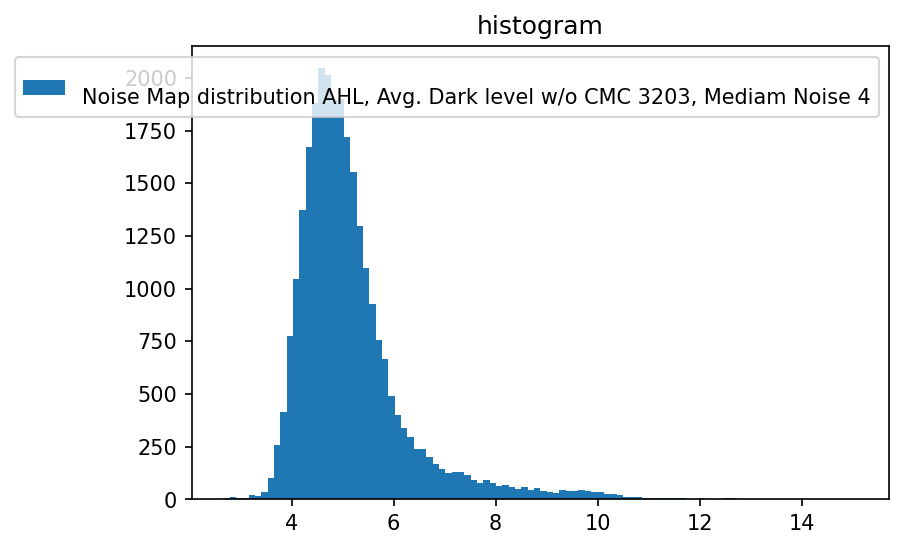

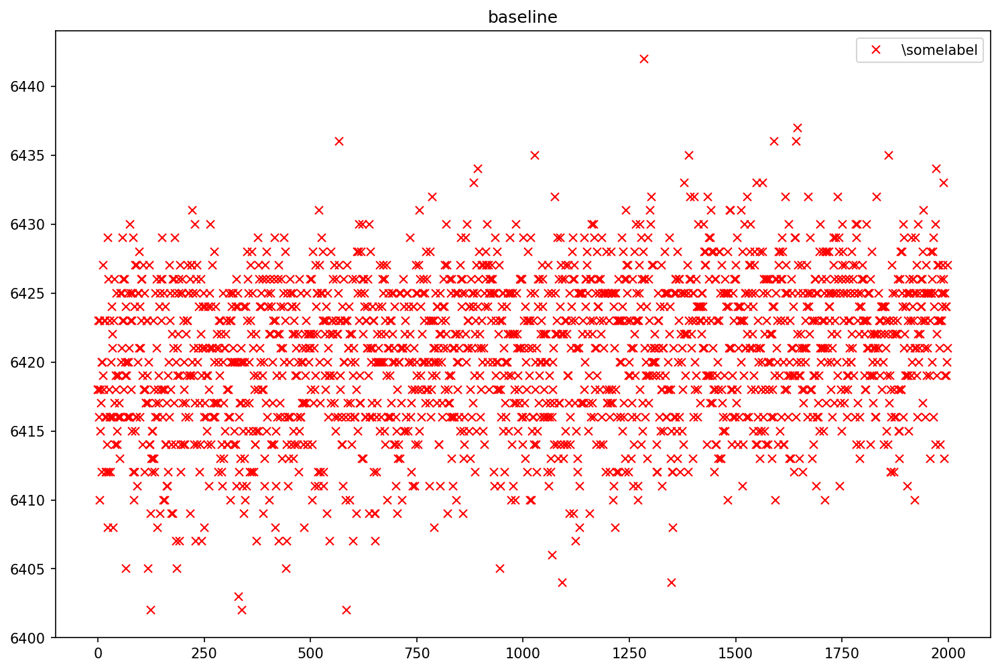

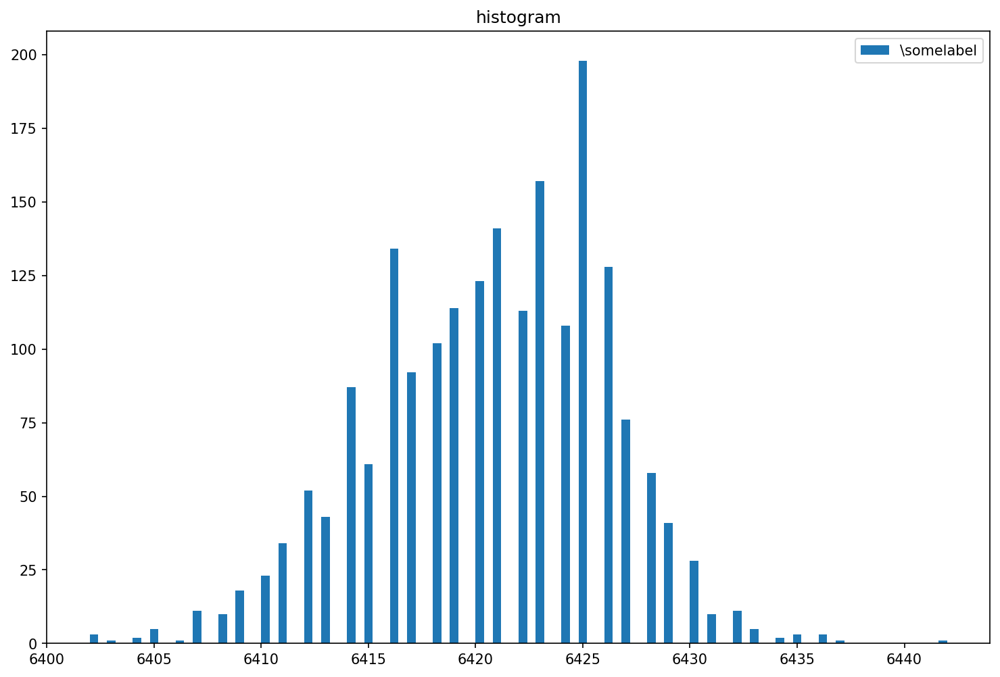

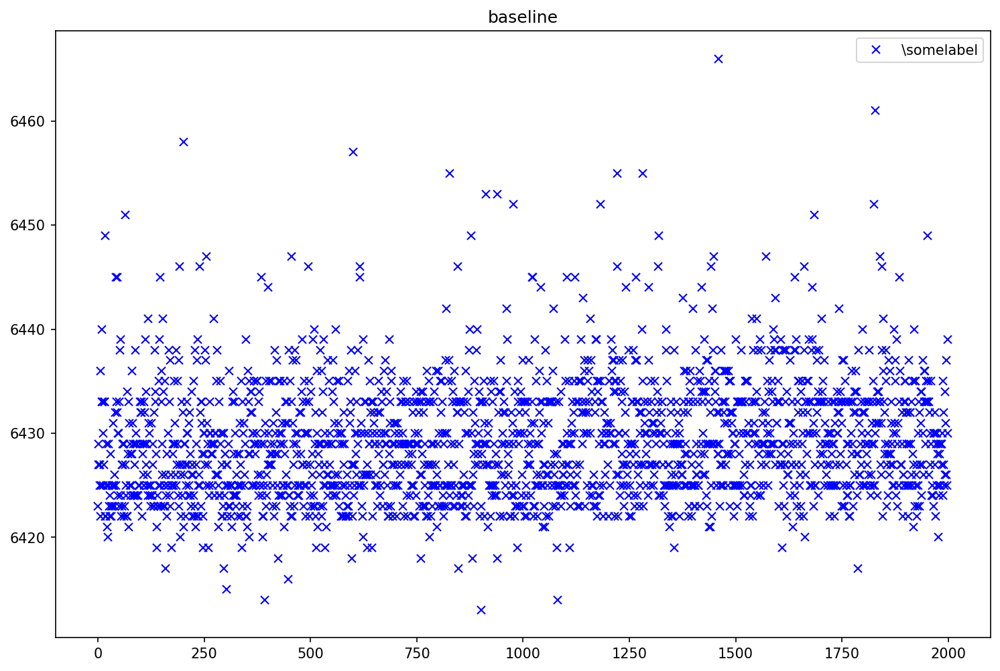

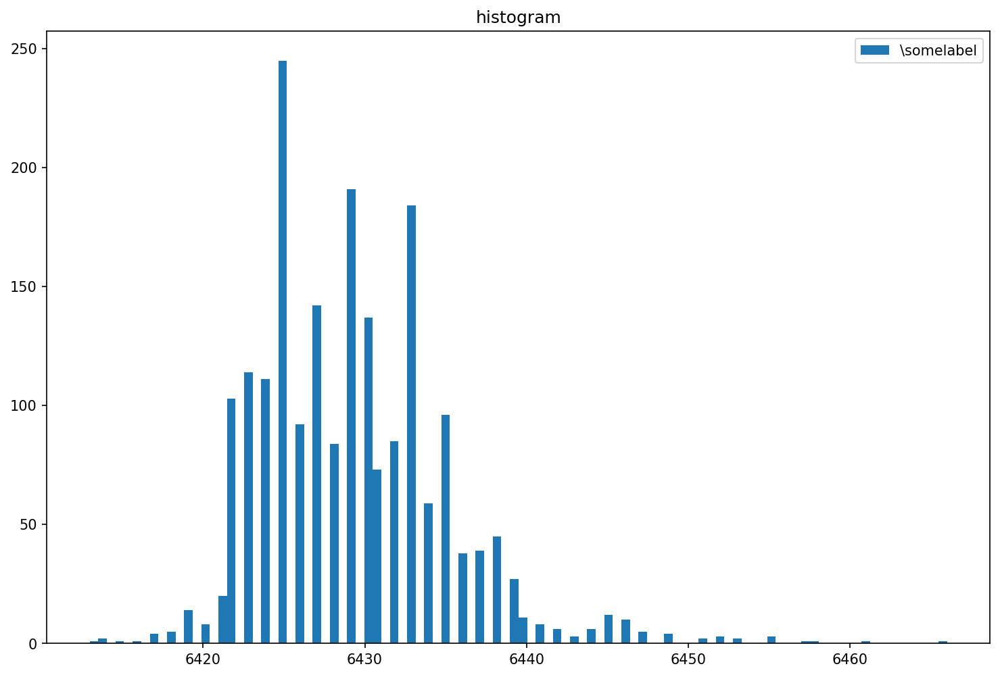

(145, 384)


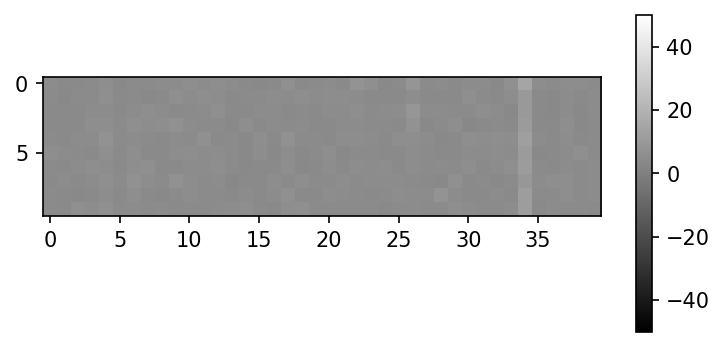

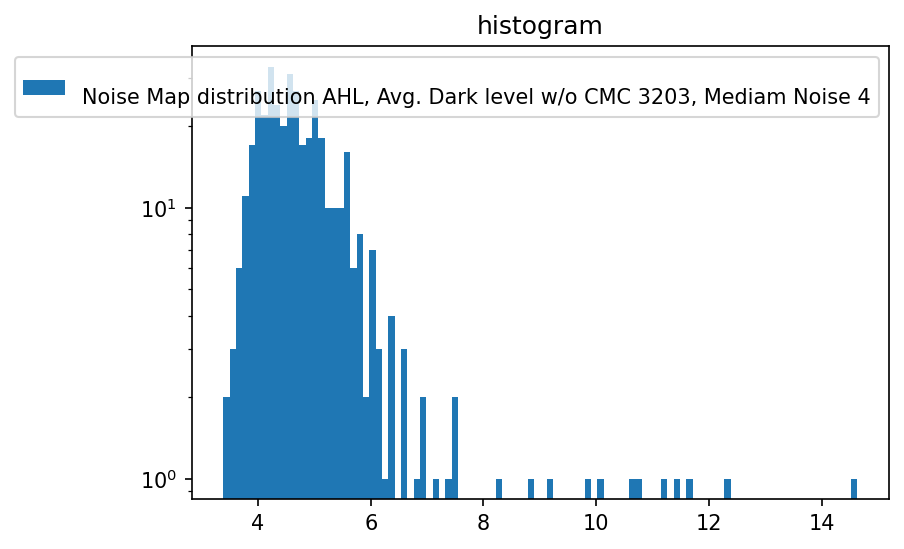


(145, 384)


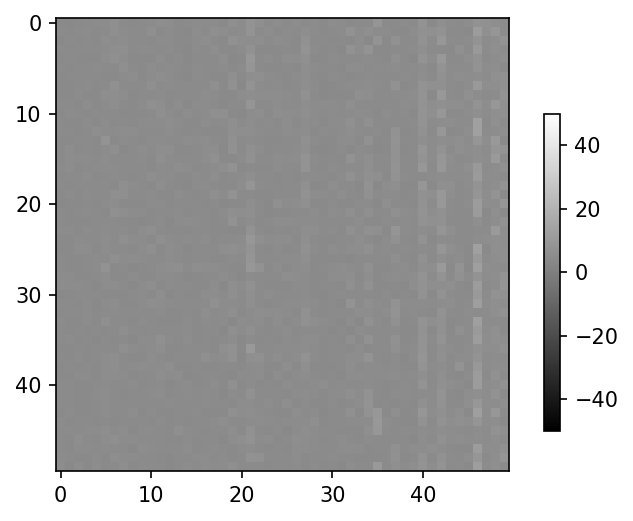

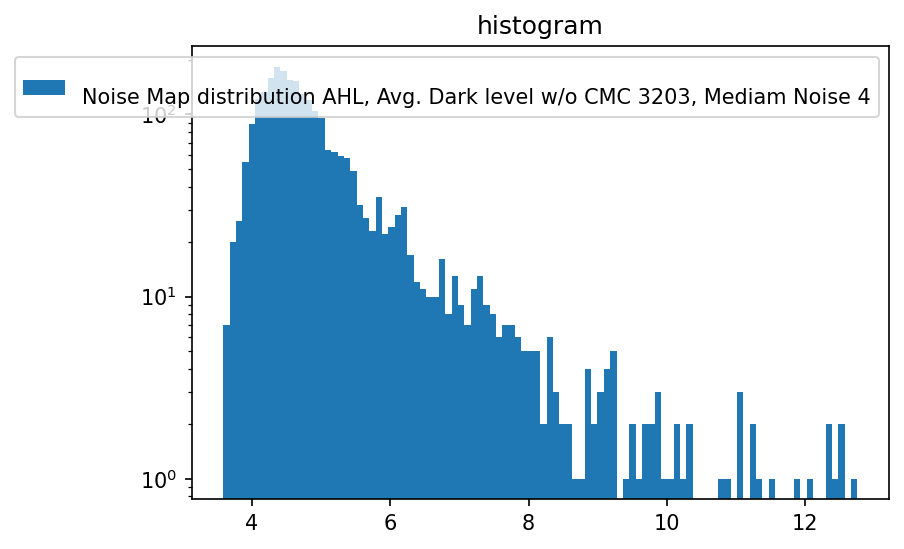


/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_5_Preamp_4_Vld1b_1_PixelCB_4_Filter_DAC_38_VRrefdac_53_DHg_1_RefGenB_2_RefGenC_3_peds_0_trbit_0_run1.dat
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 2
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 3
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 4
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 5
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 6
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get d

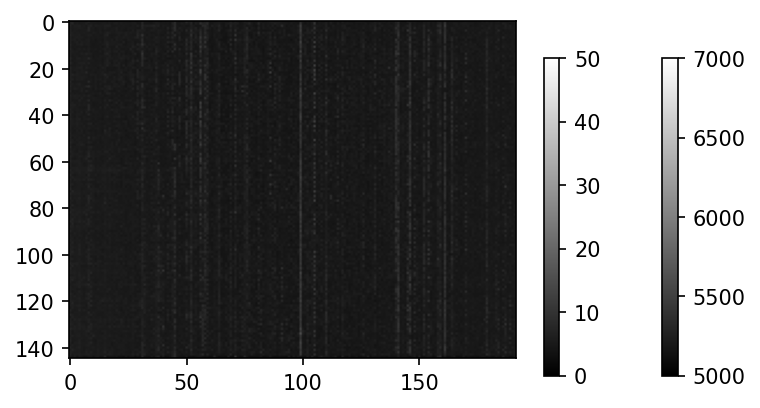

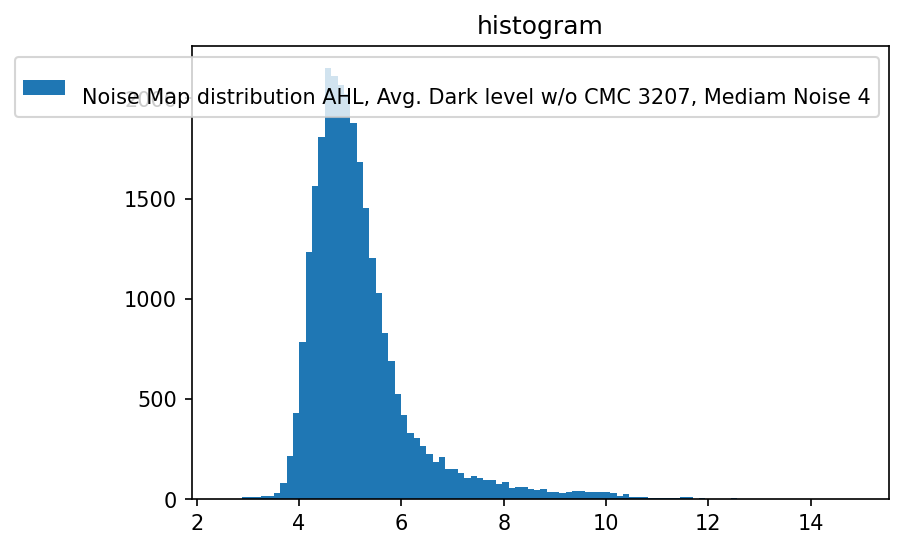

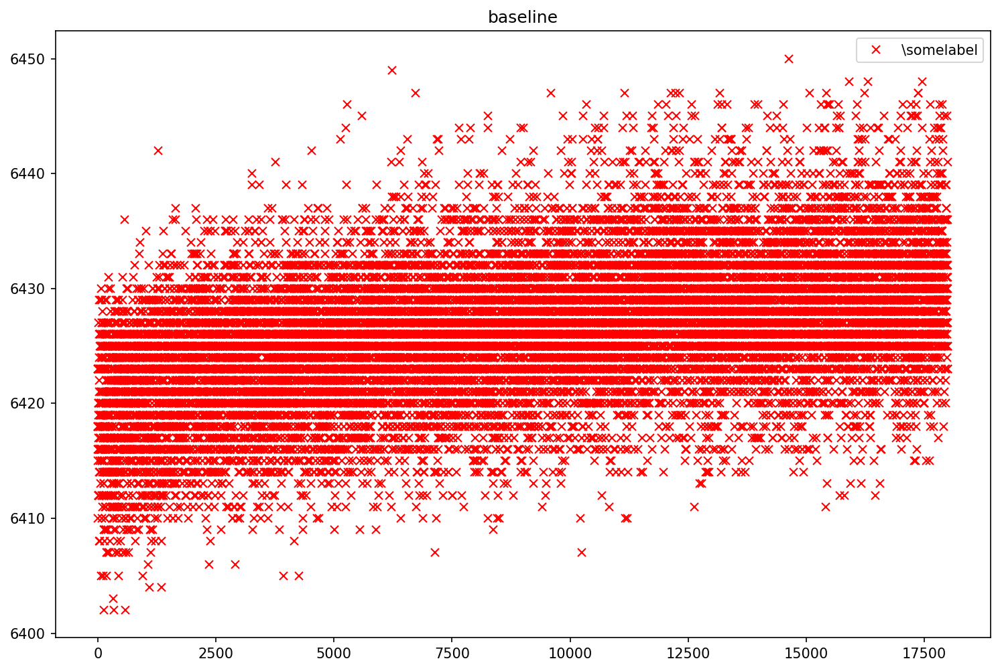

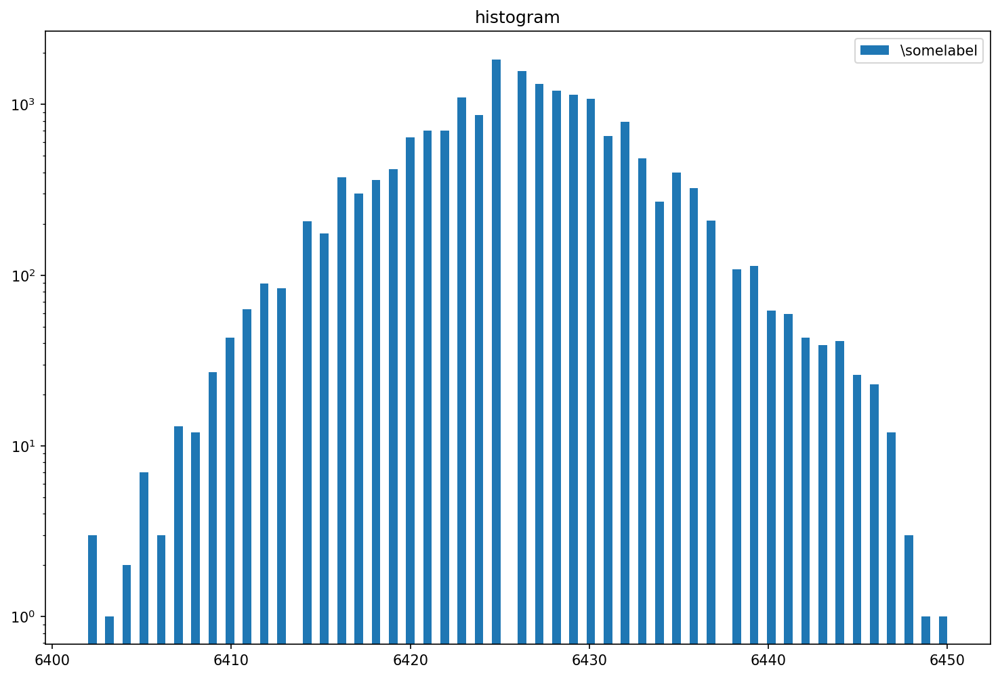

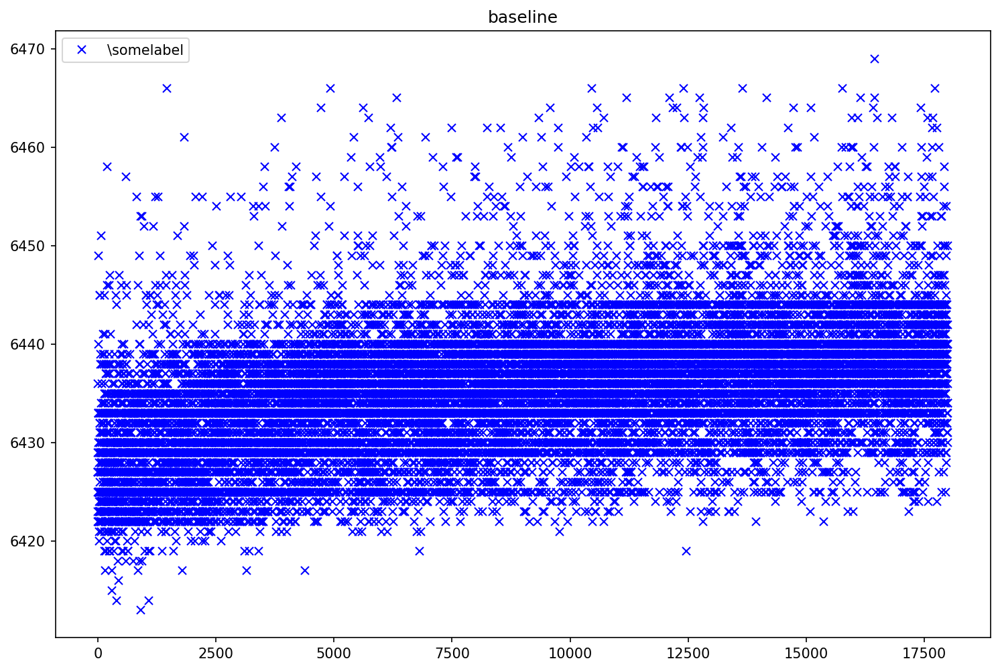

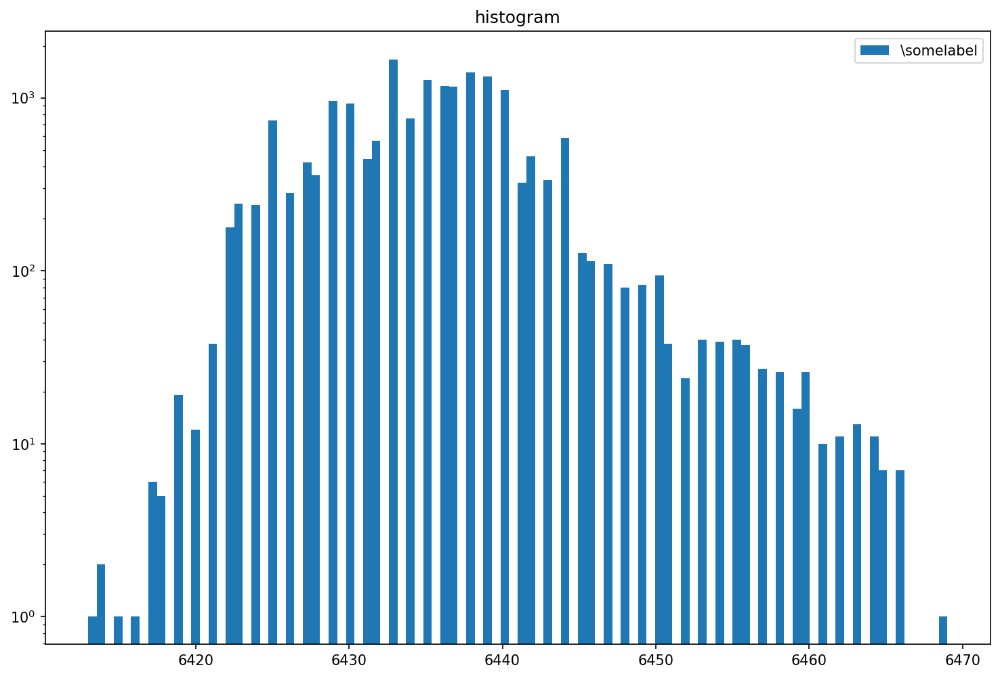

(145, 384)


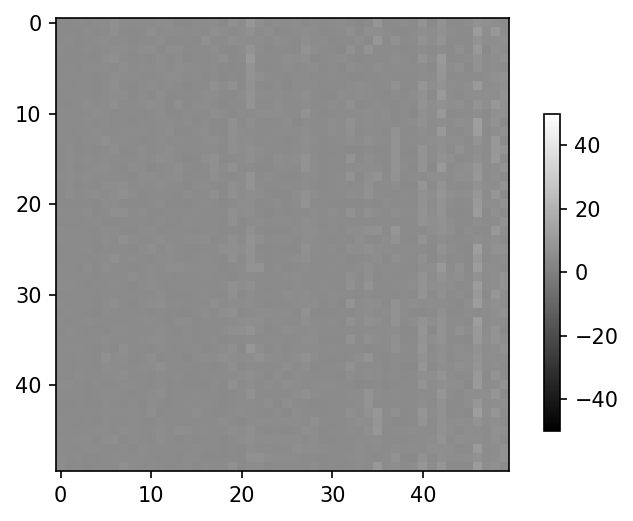

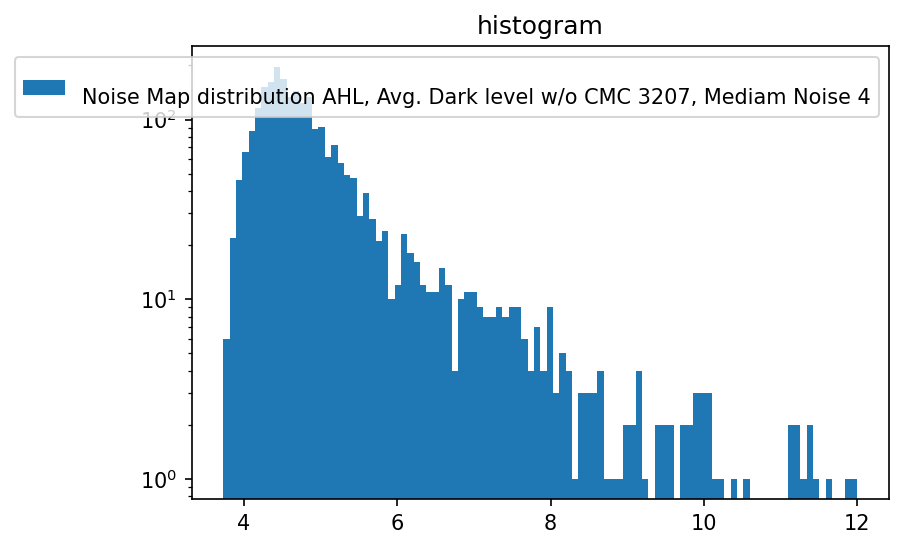


Camera  ePixHr10kTBatcher  selected.


In [14]:
#Makes sure triggers are off
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.2)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(True)
time.sleep(0.2)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.2)

Preamp = 4 #4
Vld1_b = 1 #1
Pixel_CB= 4 #4
Filter_DAC= 38 #33
VRef_DAC = 53 #22

setPixel (Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC)

pedsList = [12,12,8,0,0]
trbitList = [True,0,0,True,0]

#########
index = 0
trbit = trbitList[index]
ASIC.trbit.set(trbit)
peds = pedsList[index]
ASIC.ClearMatrix(peds)
######################################################################################################################
# Remove previous dataset
filename = (f'/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_%d_Preamp_%d_Vld1b_%d_PixelCB_%d_Filter_DAC_%d_VRrefdac_%d_DHg_%d_RefGenB_%d_RefGenC_%d_peds_%d_trbit_%d_run1.dat' % (initSequence, Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC,DHg,RefGenB,RefGenC,peds,trbit))
######################################################################################################################
FH = complete_test(filename)
MAX_NUMBER_OF_FRAMES_PER_BATCH  = 1000
cameraType            = 'ePixHr10kTBatcher'
bitMask               = 0xffff
currentCam = cameras.Camera(cameraType = cameraType)
currentCam.bitMask = bitMask
#########

#########
index = 1
trbit = trbitList[index]
ASIC.trbit.set(trbit)
peds = pedsList[index]
ASIC.ClearMatrix(peds)
######################################################################################################################
# Remove previous dataset
filename = (f'/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_%d_Preamp_%d_Vld1b_%d_PixelCB_%d_Filter_DAC_%d_VRrefdac_%d_DHg_%d_RefGenB_%d_RefGenC_%d_peds_%d_trbit_%d_run1.dat' % (initSequence, Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC,DHg,RefGenB,RefGenC,peds,trbit))
######################################################################################################################
FM = complete_test(filename)
MAX_NUMBER_OF_FRAMES_PER_BATCH  = 1000
cameraType            = 'ePixHr10kTBatcher'
bitMask               = 0xffff
currentCam = cameras.Camera(cameraType = cameraType)
currentCam.bitMask = bitMask
#########

#########
index = 2
trbit = trbitList[index]
ASIC.trbit.set(trbit)
peds = pedsList[index]
ASIC.ClearMatrix(peds)
######################################################################################################################
# Remove previous dataset
filename = (f'/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_%d_Preamp_%d_Vld1b_%d_PixelCB_%d_Filter_DAC_%d_VRrefdac_%d_DHg_%d_RefGenB_%d_RefGenC_%d_peds_%d_trbit_%d_run1.dat' % (initSequence, Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC,DHg,RefGenB,RefGenC,peds,trbit))
######################################################################################################################
FL = complete_test(filename)
MAX_NUMBER_OF_FRAMES_PER_BATCH  = 1000
cameraType            = 'ePixHr10kTBatcher'
bitMask               = 0xffff
currentCam = cameras.Camera(cameraType = cameraType)
currentCam.bitMask = bitMask
#########

#########
index = 3
trbit = trbitList[index]
ASIC.trbit.set(trbit)
peds = pedsList[index]
ASIC.ClearMatrix(peds)
######################################################################################################################
# Remove previous dataset
filename = (f'/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_%d_Preamp_%d_Vld1b_%d_PixelCB_%d_Filter_DAC_%d_VRrefdac_%d_DHg_%d_RefGenB_%d_RefGenC_%d_peds_%d_trbit_%d_run1.dat' % (initSequence, Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC,DHg,RefGenB,RefGenC,peds,trbit))
######################################################################################################################
AHL = complete_test(filename)
MAX_NUMBER_OF_FRAMES_PER_BATCH  = 1000
cameraType            = 'ePixHr10kTBatcher'
bitMask               = 0xffff
currentCam = cameras.Camera(cameraType = cameraType)
currentCam.bitMask = bitMask
#########

#########
index = 4
trbit = trbitList[index]
ASIC.trbit.set(trbit)
peds = pedsList[index]
ASIC.ClearMatrix(peds)
######################################################################################################################
# Remove previous dataset
filename = (f'/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_%d_Preamp_%d_Vld1b_%d_PixelCB_%d_Filter_DAC_%d_VRrefdac_%d_DHg_%d_RefGenB_%d_RefGenC_%d_peds_%d_trbit_%d_run1.dat' % (initSequence, Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC,DHg,RefGenB,RefGenC,peds,trbit))
######################################################################################################################
AML = complete_test(filename)
MAX_NUMBER_OF_FRAMES_PER_BATCH  = 1000
cameraType            = 'ePixHr10kTBatcher'
bitMask               = 0xffff
currentCam = cameras.Camera(cameraType = cameraType)
currentCam.bitMask = bitMask
#########







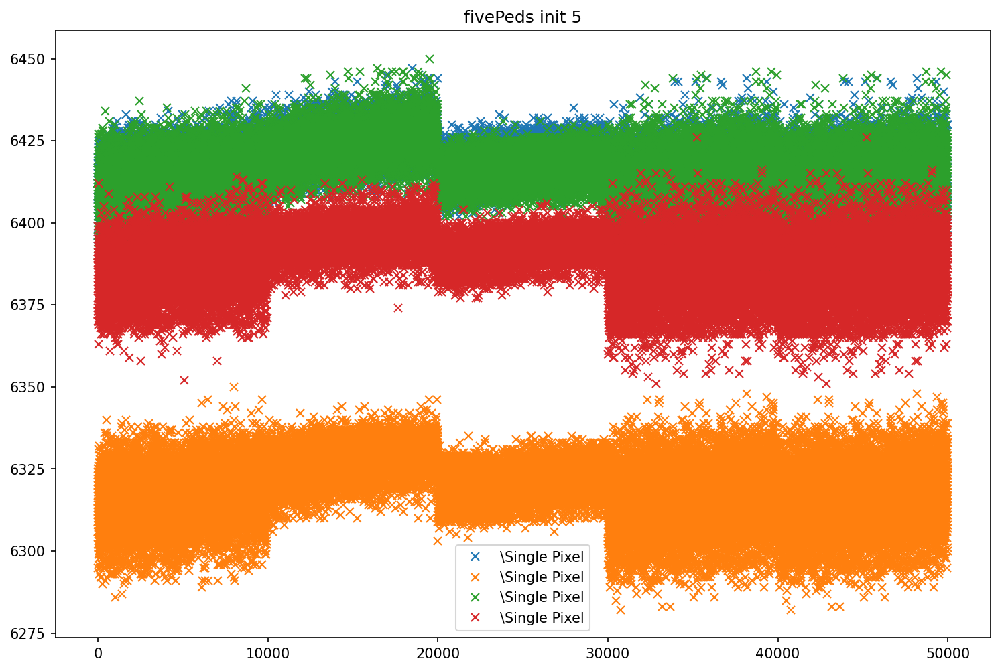

In [40]:
startIdx = 5000
stopIdx = 15000
mask = 0x3FFF
plt.figure(1,figsize=(12,8),dpi=150)
dataset = np.concatenate((FH[startIdx:stopIdx,10,10],FM[startIdx:stopIdx,10,10],np.bitwise_and(FL[startIdx:stopIdx,10,10], mask),AHL[startIdx:stopIdx,10,10],AHL[startIdx:stopIdx,10,10]),0)           
plt.plot(dataset, 'x', label=f'\Single Pixel') 
dataset = np.concatenate((FH[startIdx:stopIdx,10+32,10+32],FM[startIdx:stopIdx,10+32,10+32],np.bitwise_and(FL[startIdx:stopIdx,10+32,10+32], mask),AHL[startIdx:stopIdx,10+32,10+32],AHL[startIdx:stopIdx,10+32,10+32]),0) #
plt.plot(dataset, 'x', label=f'\Single Pixel') 
dataset = np.concatenate((FH[startIdx:stopIdx,10+32,10],FM[startIdx:stopIdx,10+32,10],np.bitwise_and(FL[startIdx:stopIdx,10+32,10], mask),AHL[startIdx:stopIdx,10+32,10],AHL[startIdx:stopIdx,10+32,10]),0) #
plt.plot(dataset, 'x', label=f'\Single Pixel') 
dataset = np.concatenate((FH[startIdx:stopIdx,10,10+32],FM[startIdx:stopIdx,10,10+32],np.bitwise_and(FL[startIdx:stopIdx,10,10+32], mask),AHL[startIdx:stopIdx,10,10+32],AHL[startIdx:stopIdx,10,10+32]),0) #
plt.plot(dataset, 'x', label=f'\Single Pixel') 

plt.title("fivePeds init %d" % (initSequence)) 
plt.legend()
plt.show()

# Baseline TEST all - 250MHz

In [4]:
MAX_NUMBER_OF_FRAMES_PER_BATCH  = 1000
cameraType            = 'ePixHr10kTBatcher'
bitMask               = 0xffff
currentCam = cameras.Camera(cameraType = cameraType)
currentCam.bitMask = bitMask

Camera  ePixHr10kTBatcher  selected.


In [41]:
#Initialze the camera
#[routine, asic0, asic1, asic2, asic3]'
initSequence = 21
root.EpixHR.InitASIC([initSequence,0,0,1,0])
#points to the ASIC device under test
ASIC = root.EpixHR.Hr10kTAsic2
root.EpixHR.BatcherEventBuilder0.Blowoff.set(True)
root.EpixHR.BatcherEventBuilder0.Bypass.set(1)
root.EpixHR.BatcherEventBuilder1.Blowoff.set(False)
root.EpixHR.BatcherEventBuilder1.Bypass.set(1)
root.EpixHR.BatcherEventBuilder2.Blowoff.set(True)

Rysync ASIC started
Init ASIC script started
Loading MMCM configuration
/u1/ddoering/localGit/epix-hr-single-10k/software/notebooks/ASIC_V4/baseline/../../../yml/ePixHr10kT_MMCM_248MHz.yml
Completed
Loading supply configuration
/u1/ddoering/localGit/epix-hr-single-10k/software/notebooks/ASIC_V4/baseline/../../..//yml/ePixHr10kT_PowerSupply_Enable.yml
Loading register control (waveforms) configuration
/u1/ddoering/localGit/epix-hr-single-10k/software/notebooks/ASIC_V4/baseline/../../..//yml/ePixHr10kT_RegisterControl_24us_248MHz.yml
Loading packet registers
Disabling packet lanes for ASIC 0
Disabling packet lanes for ASIC 1
Disabling packet lanes for ASIC 3
/u1/ddoering/localGit/epix-hr-single-10k/software/notebooks/ASIC_V4/baseline/../../..//yml/ePixHr10kT_PacketRegisters.yml
Taking asic off of reset
Loading ASIC and timing configuration
Loading  /u1/ddoering/localGit/epix-hr-single-10k/software/notebooks/ASIC_V4/baseline/../../..//yml/ePixHr10kT_PLLBypass_248MHz_ASIC_2.yml
Command exe

In [42]:
#Makes sure triggers are off
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.1)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(True)
time.sleep(10)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.1)


In [43]:
#use system with batcher and missing ASICs
root.EpixHR.SspLowSpeedDecoderReg.enable.set(True)
print ("Locked lanes: %x" % root.EpixHR.SspLowSpeedDecoderReg.Locked.get())
#Only ASIC 1 is available so disable the 6 lower lanes
root.EpixHR.PacketRegisters0.DisableLane.set(0x3FF)
root.EpixHR.PacketRegisters1.DisableLane.set(0xFC0)



Locked lanes: 3f000


In [44]:
print(ASIC.Preamp.get())
print(ASIC.Vld1_b.get())
print(ASIC.Pixel_CB.get())
print(ASIC.Filter_DAC.get())
print(ASIC.VRef_DAC.get())

4
1
4
38
53


In [45]:
print('DHG', ASIC.DHg.get())
print('RefGenB', ASIC.RefGenB.get())
print('RefGenC', ASIC.RefGenC.get())
print('S2D_1_b', ASIC.S2D_1_b.get())
print('shvc_DAC', ASIC.shvc_DAC.get())
print('S2dDacBias', ASIC.S2dDacBias.get())
DHg = True
RefGenB = 2
RefGenC = 3
S2D_1_b = 0
shvc_DAC = 23
S2dDacBias = 3
print("")
ASIC.DHg.set(DHg)  
ASIC.RefGenB.set(RefGenB)
ASIC.RefGenC.set(RefGenC)
ASIC.S2D_1_b.set(S2D_1_b)
ASIC.shvc_DAC.set(shvc_DAC)
ASIC.S2dDacBias.set(S2dDacBias)
print('DHG', ASIC.DHg.get())
print('RefGenB', ASIC.RefGenB.get())
print('RefGenC', ASIC.RefGenC.get())
print('S2D_1_b', ASIC.S2D_1_b.get())
print('shvc_DAC', ASIC.shvc_DAC.get())
print('S2dDacBias', ASIC.S2dDacBias.get())

DHG True
RefGenB 3
RefGenC 2
S2D_1_b 0
shvc_DAC 23
S2dDacBias 3

DHG True
RefGenB 2
RefGenC 3
S2D_1_b 0
shvc_DAC 23
S2dDacBias 3


Preamp 4
Vld1_b 1
Pixel_CB 4
Filter_DAC 38
VRef_DAC 53
Command executed :  <class 'pyrogue._Command.BaseCommand'> - ePixHr10kT.EpixHR.Hr10kTAsic2.ClearMatrix
The file /u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_21_Preamp_4_Vld1b_1_PixelCB_4_Filter_DAC_38_VRrefdac_53_DHg_1_RefGenB_2_RefGenC_3_peds_12_trbit_1_run1.dat was removed
/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_21_Preamp_4_Vld1b_1_PixelCB_4_Filter_DAC_38_VRrefdac_53_DHg_1_RefGenB_2_RefGenC_3_peds_12_trbit_1_run1.dat
Aquisition Counter 2112005
DAQ Counter 1911815
Number of frames received: 50018
Number of frames received: 52021
Delta Aquisition Counter: 54022
Number of frames received: 54022
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Startin

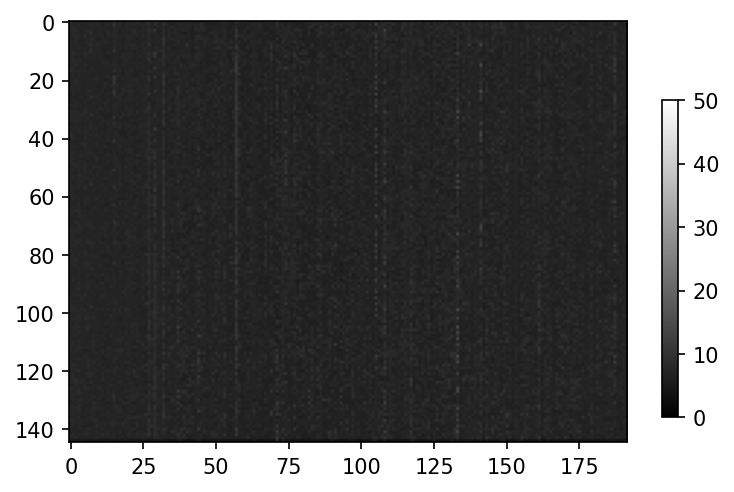

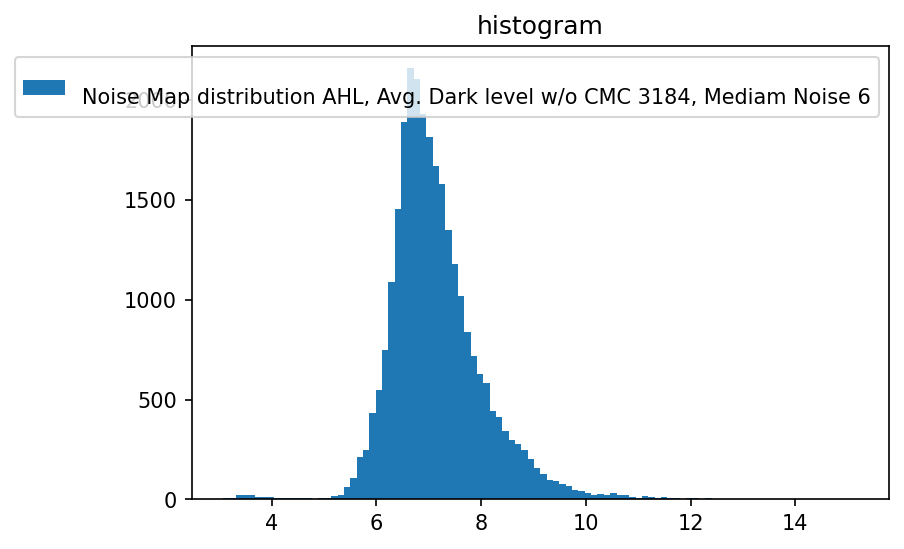

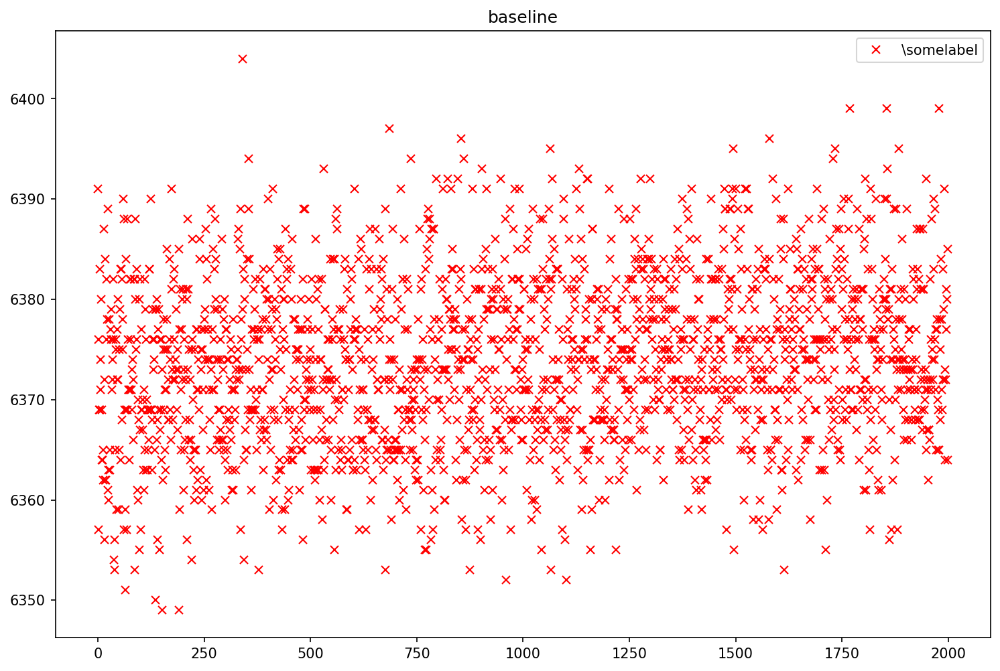

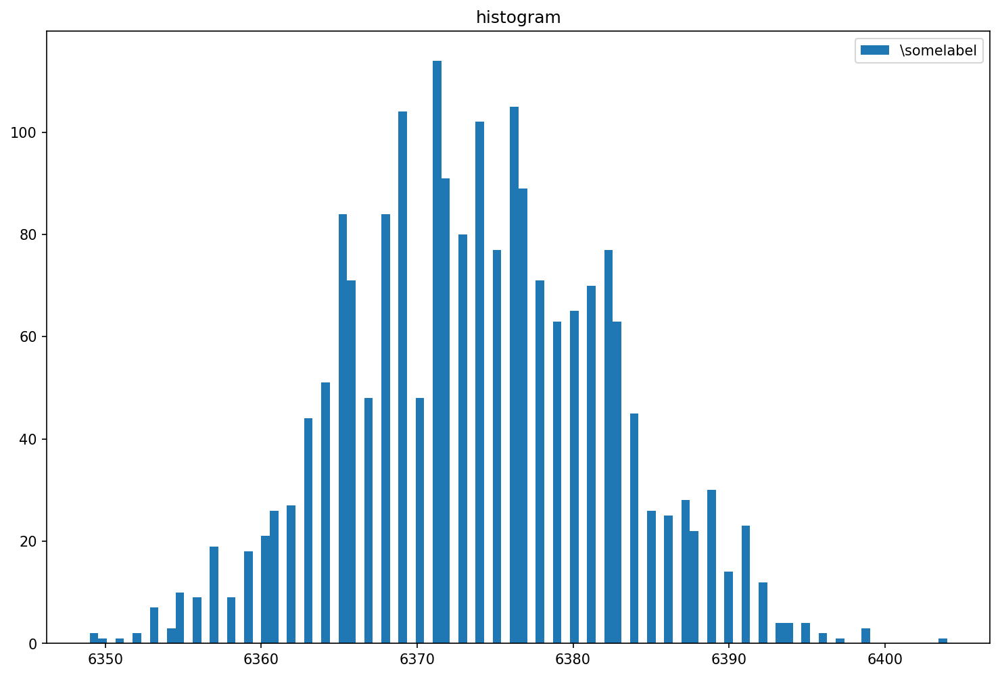

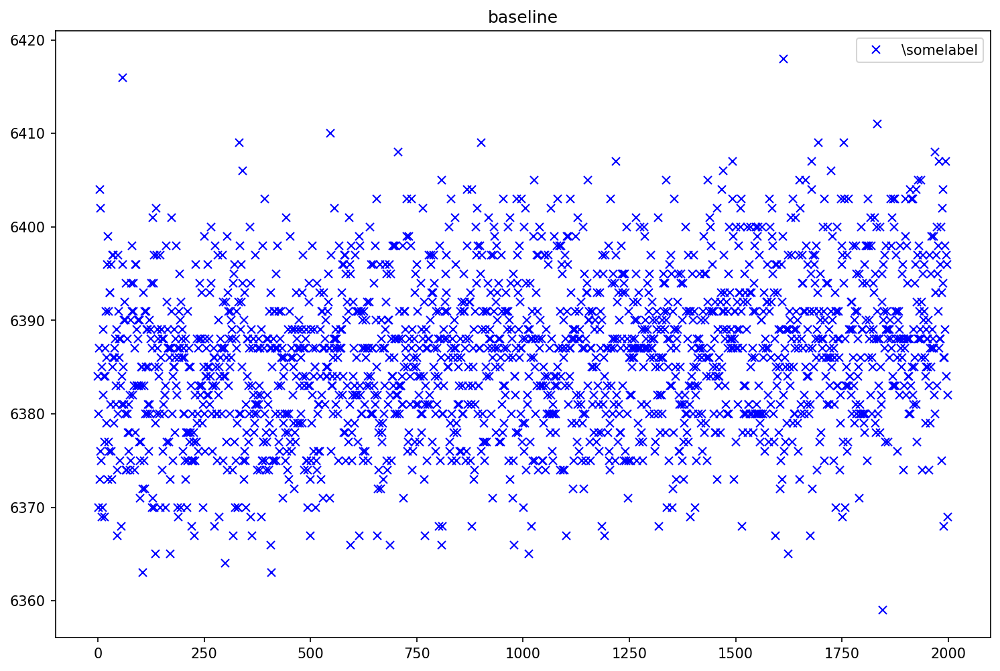

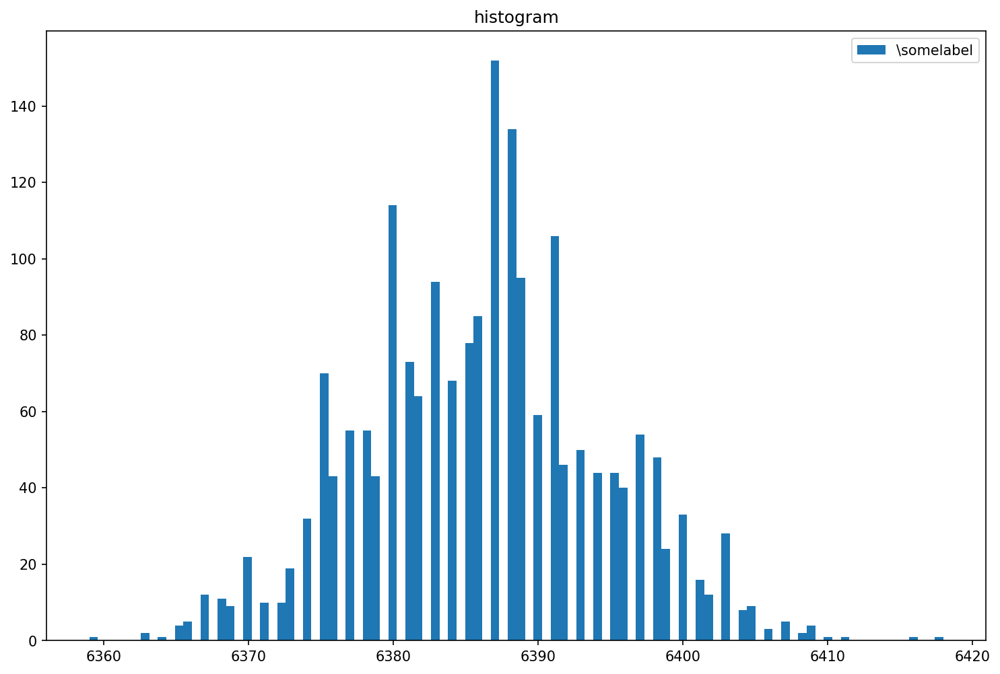

(145, 384)


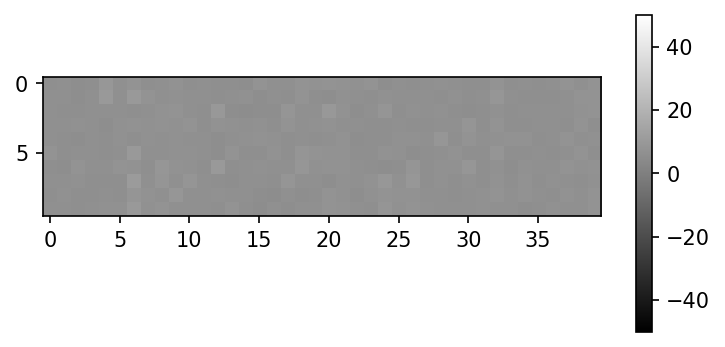

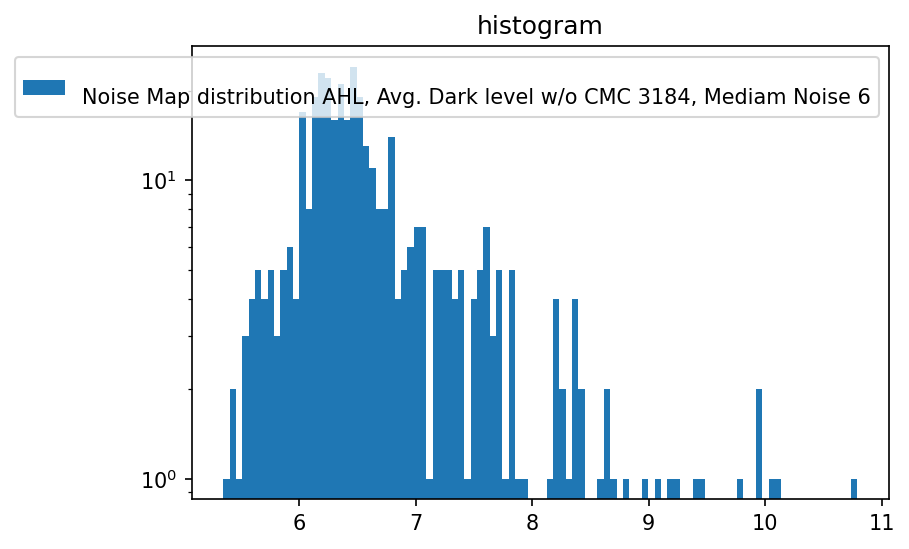


(145, 384)


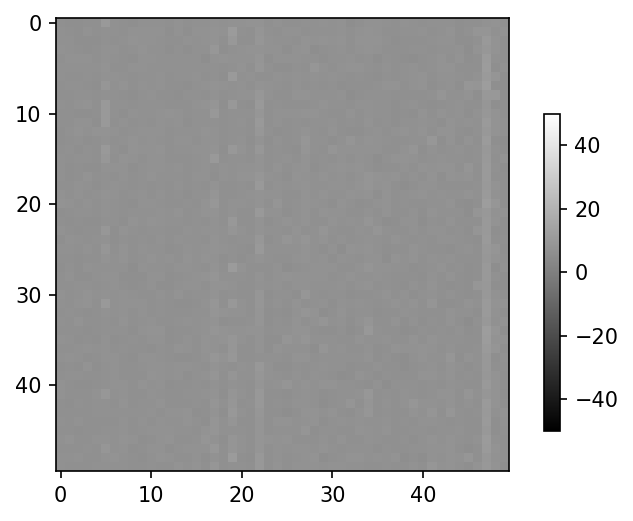

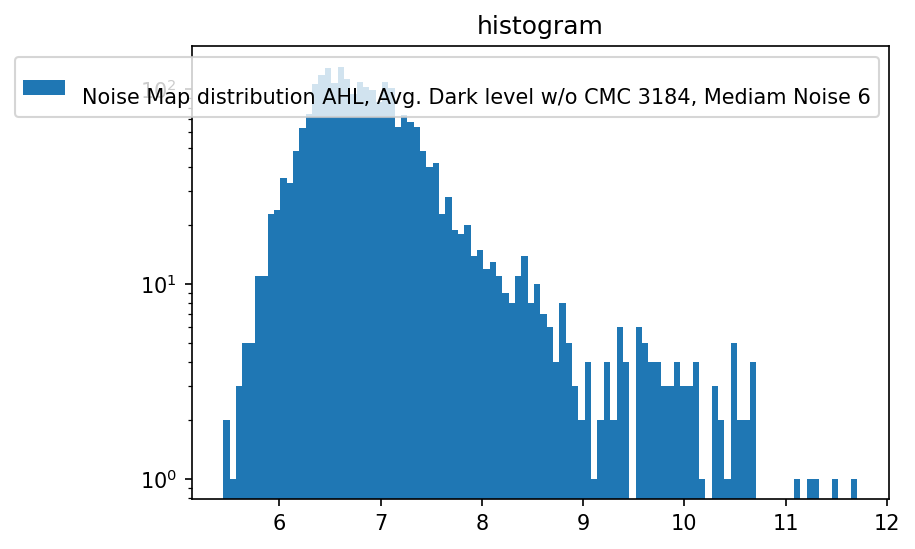


/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_21_Preamp_4_Vld1b_1_PixelCB_4_Filter_DAC_38_VRrefdac_53_DHg_1_RefGenB_2_RefGenC_3_peds_12_trbit_1_run1.dat
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 2
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 3
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 4
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 5
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 6
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get

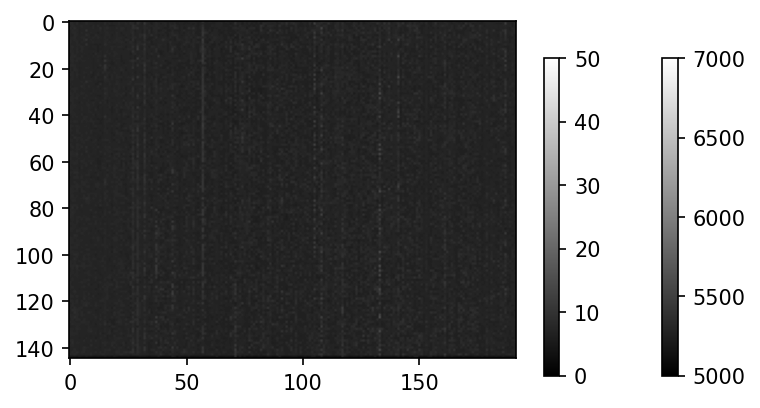

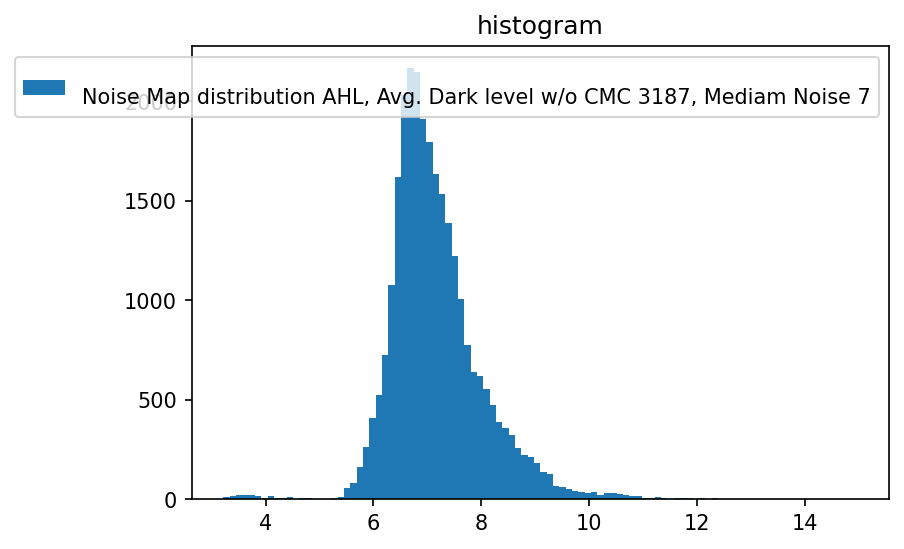

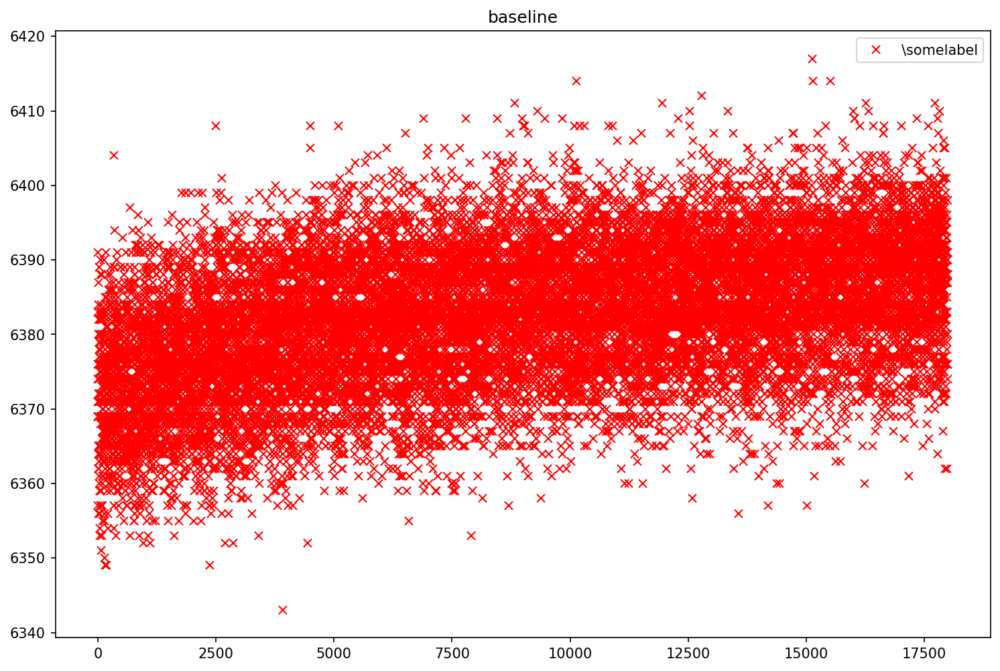

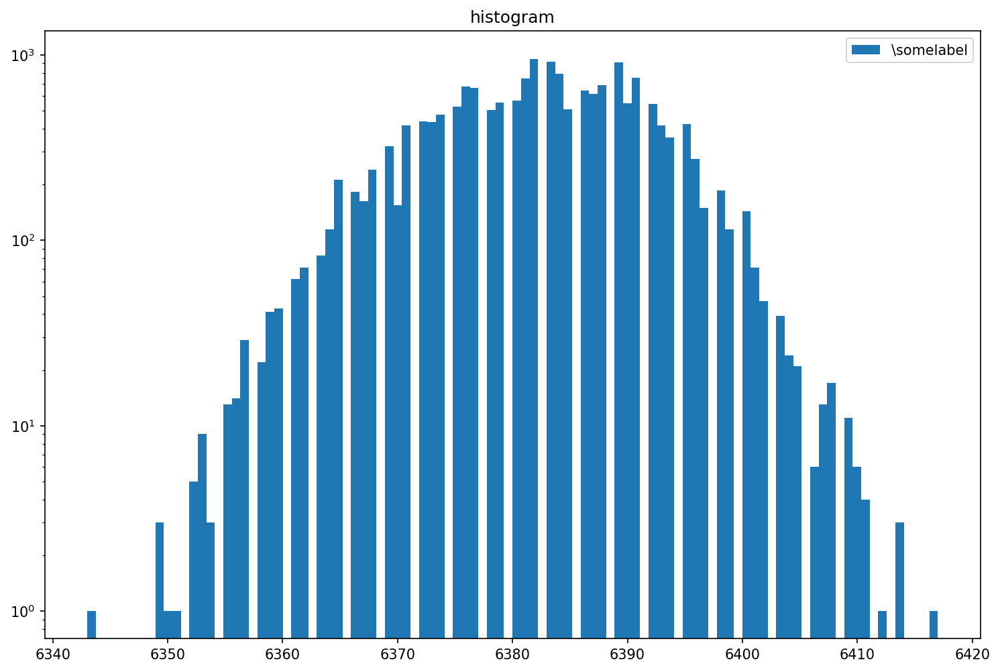

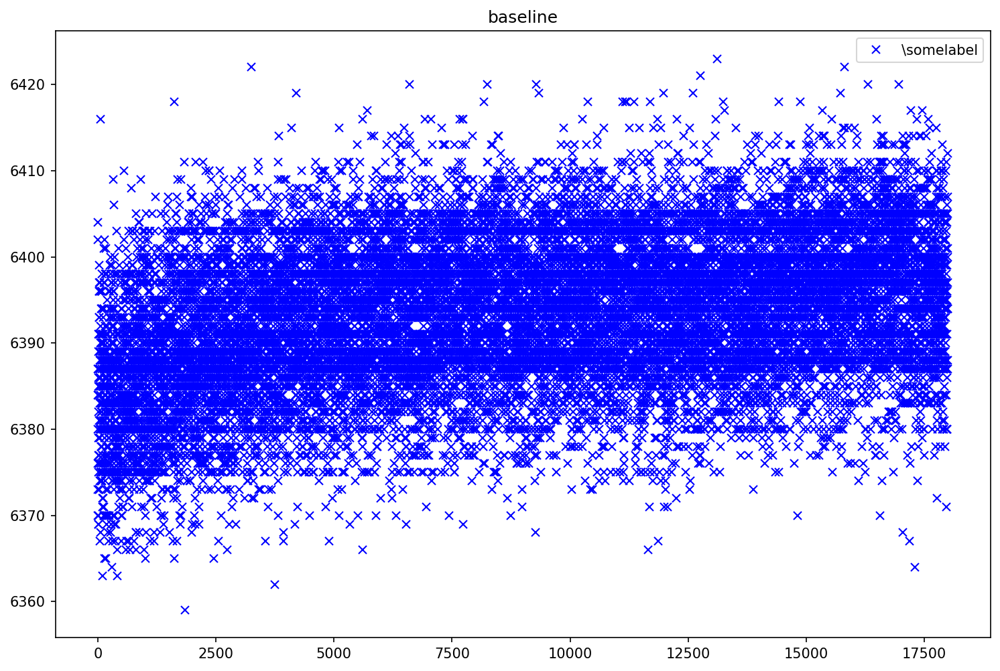

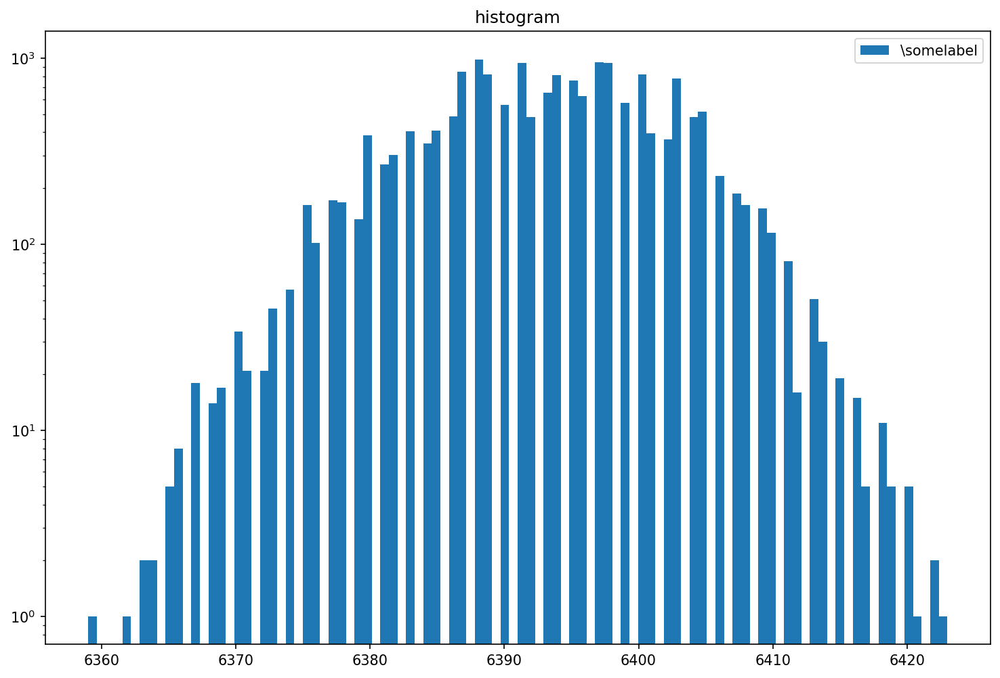

(145, 384)


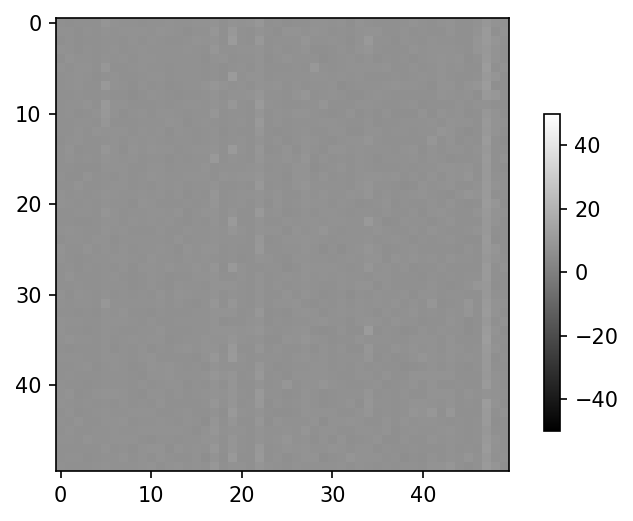

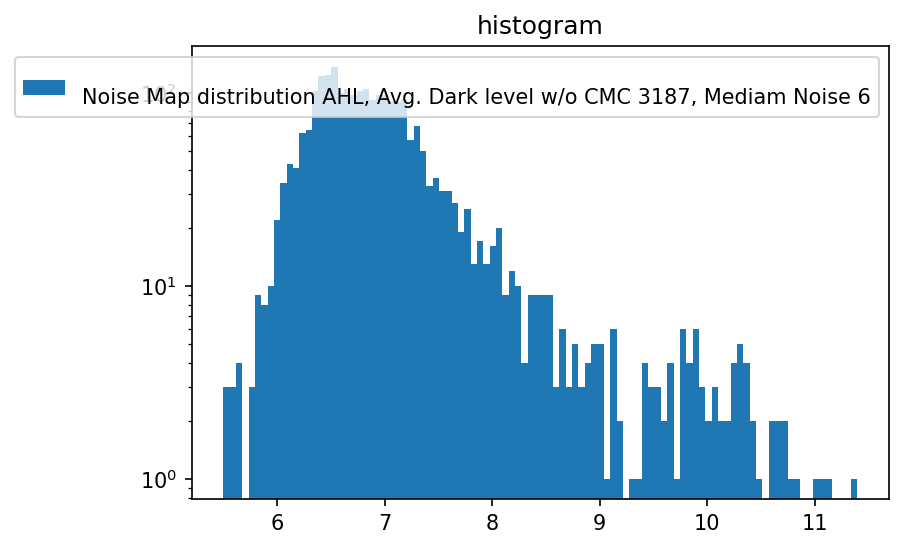


Camera  ePixHr10kTBatcher  selected.
Command executed :  <class 'pyrogue._Command.BaseCommand'> - ePixHr10kT.EpixHR.Hr10kTAsic2.ClearMatrix
The file does not exist
/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_21_Preamp_4_Vld1b_1_PixelCB_4_Filter_DAC_38_VRrefdac_53_DHg_1_RefGenB_2_RefGenC_3_peds_12_trbit_0_run1.dat
Aquisition Counter 2166027
DAQ Counter 1965837
Number of frames received: 50048
Number of frames received: 52050
Delta Aquisition Counter: 54053
Number of frames received: 54053
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 2
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56072)
(145, 384)


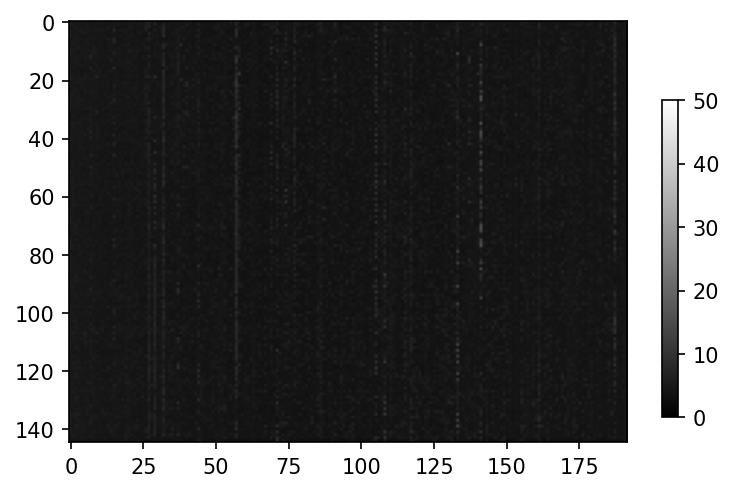

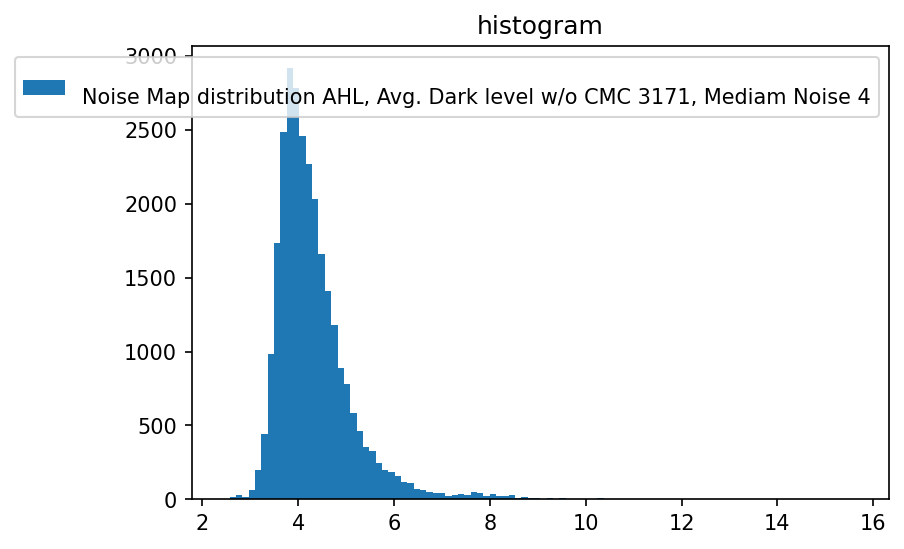

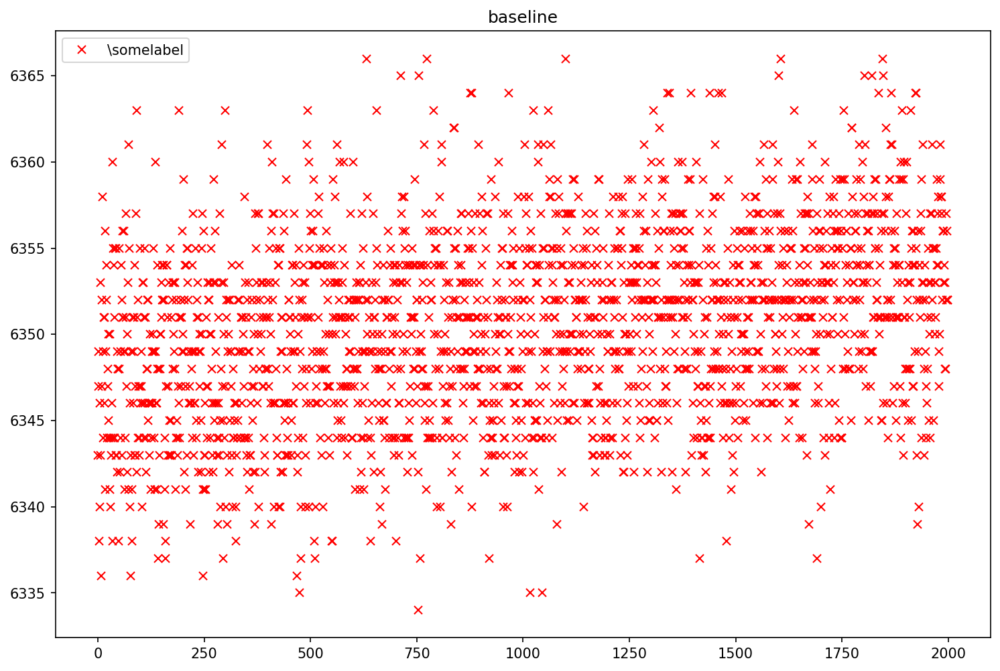

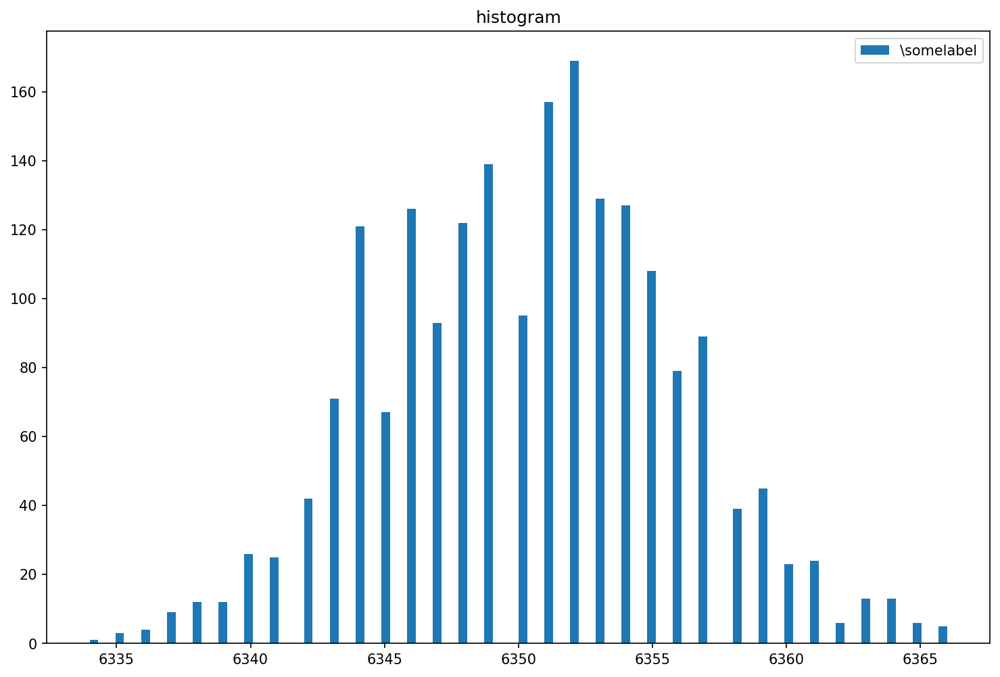

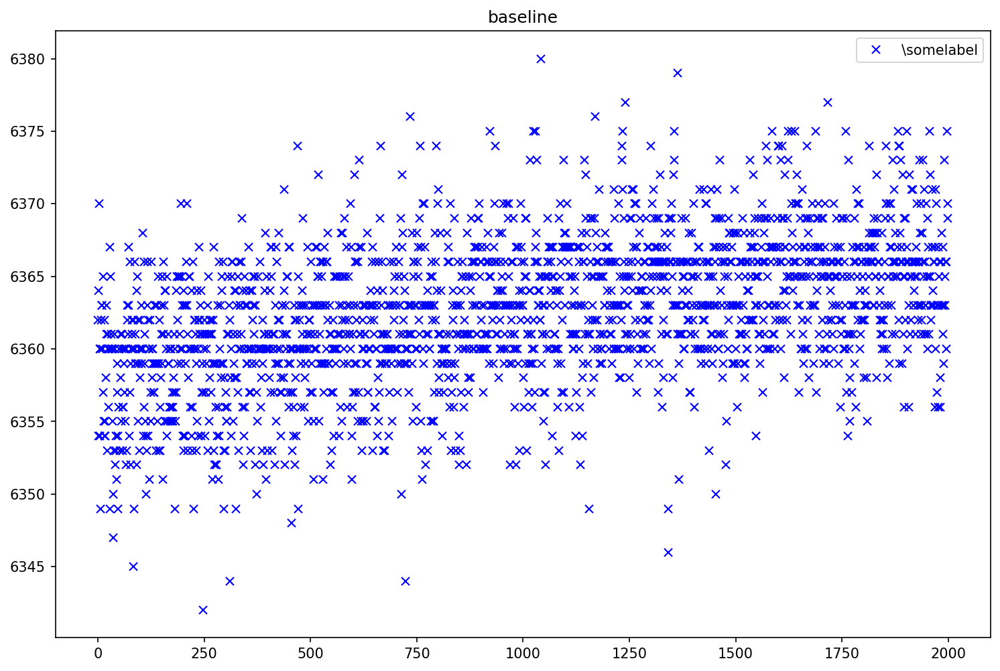

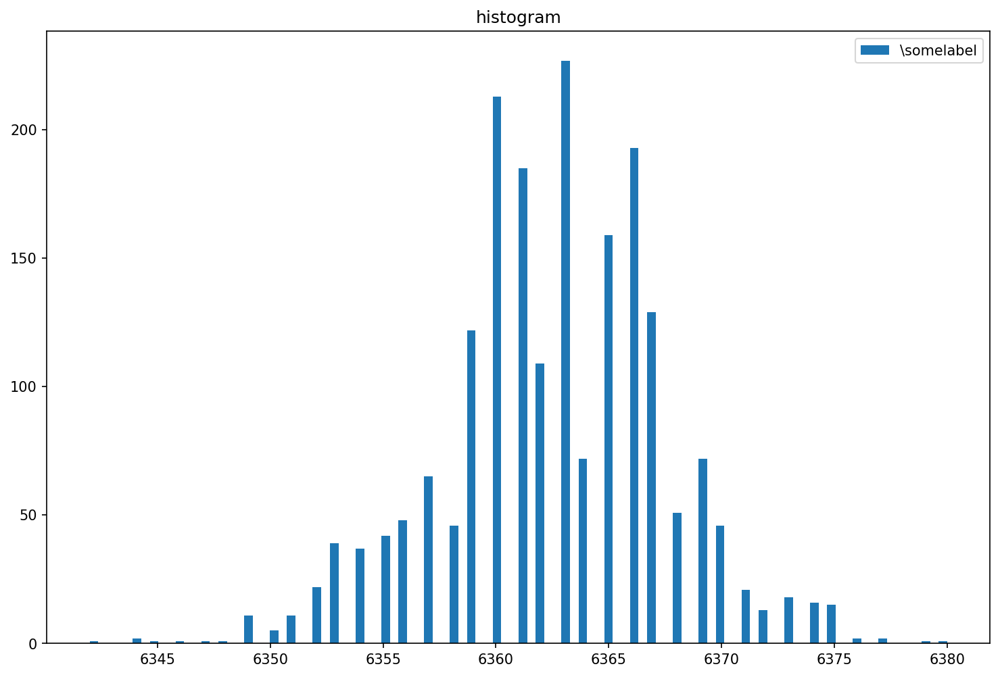

(145, 384)


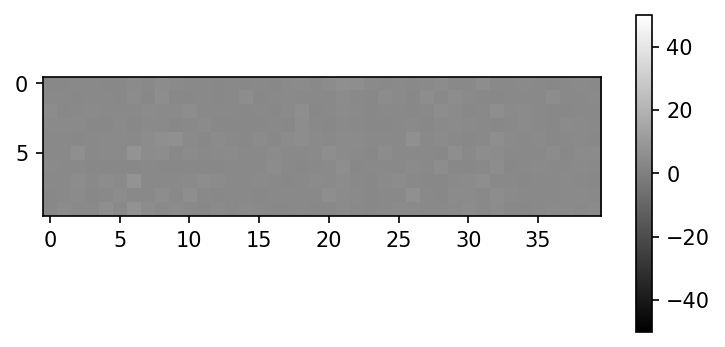

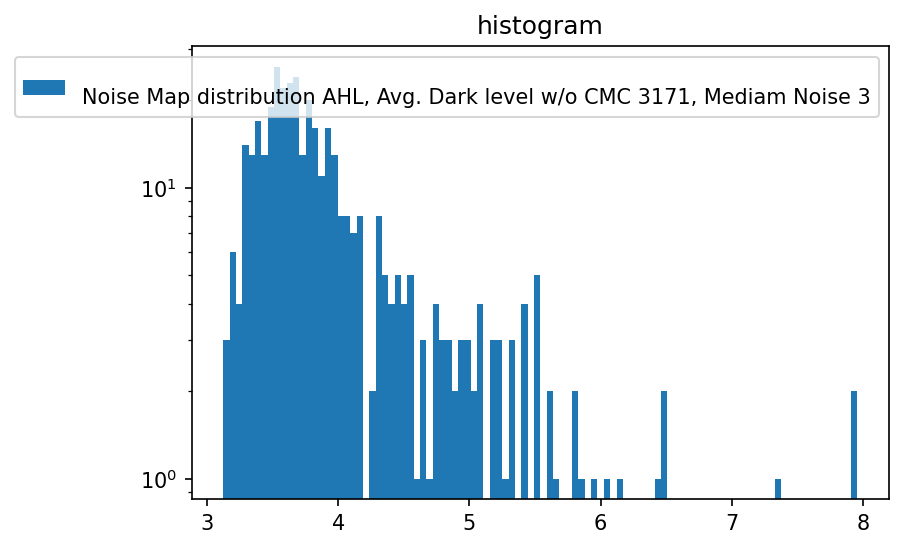


(145, 384)


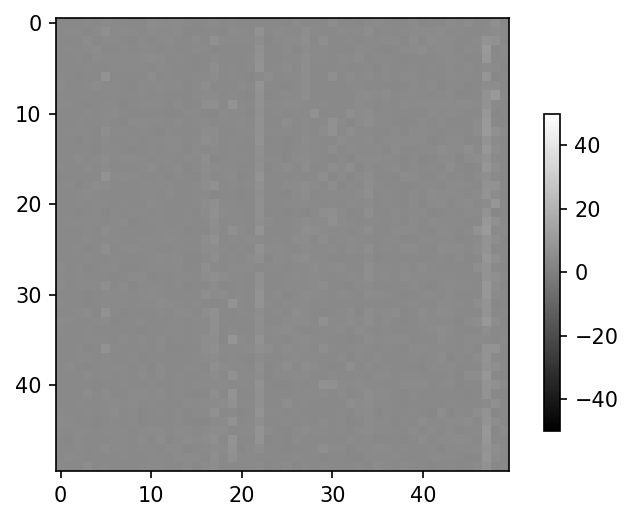

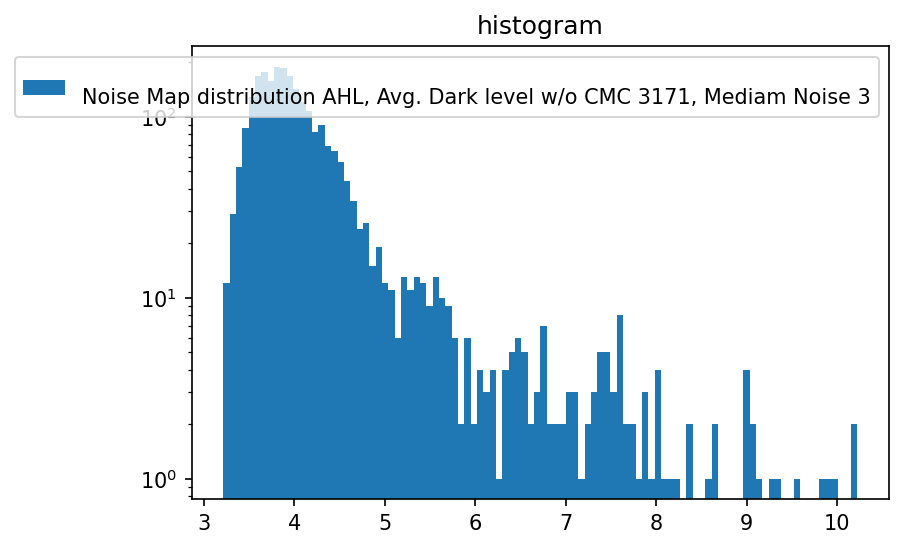


/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_21_Preamp_4_Vld1b_1_PixelCB_4_Filter_DAC_38_VRrefdac_53_DHg_1_RefGenB_2_RefGenC_3_peds_12_trbit_0_run1.dat
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 2
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 3
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 4
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 5
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 6
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get

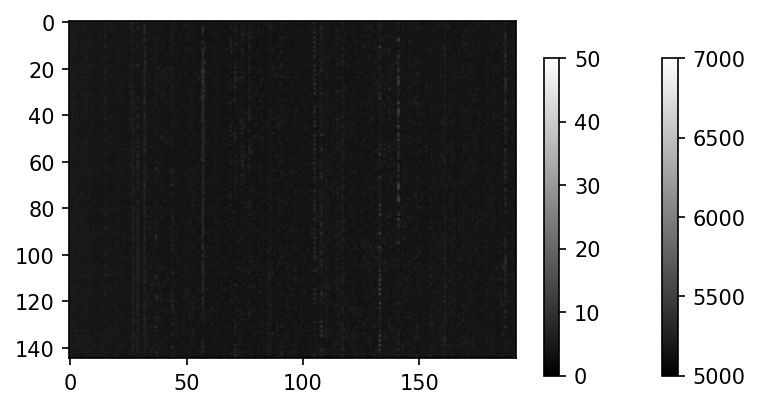

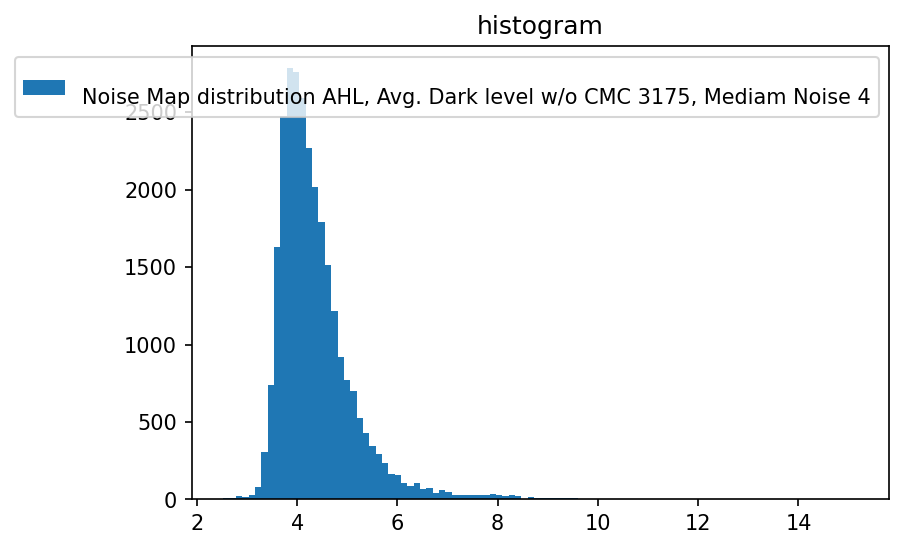

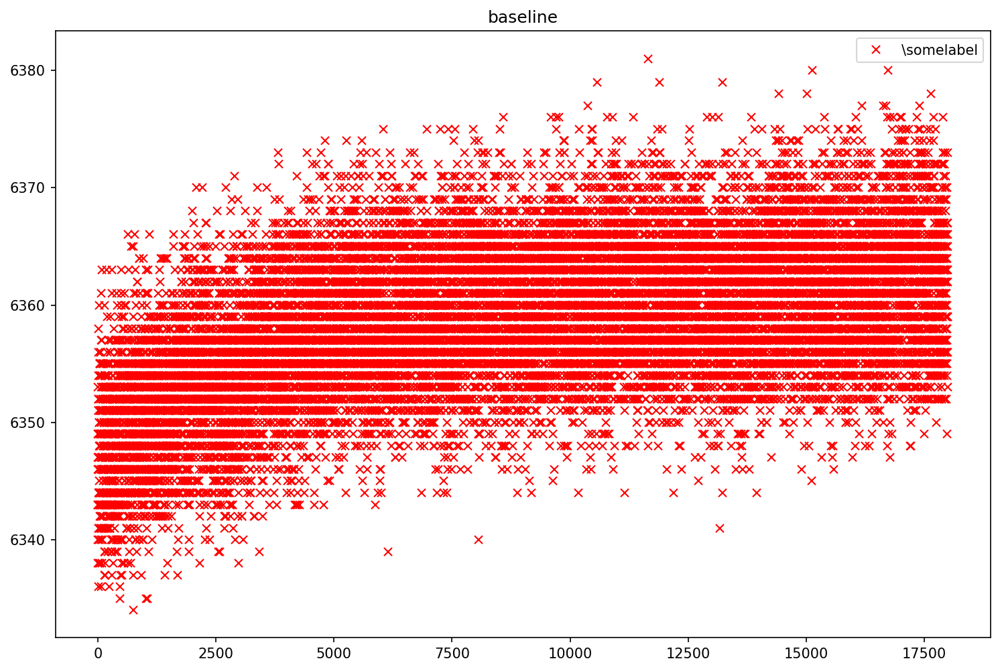

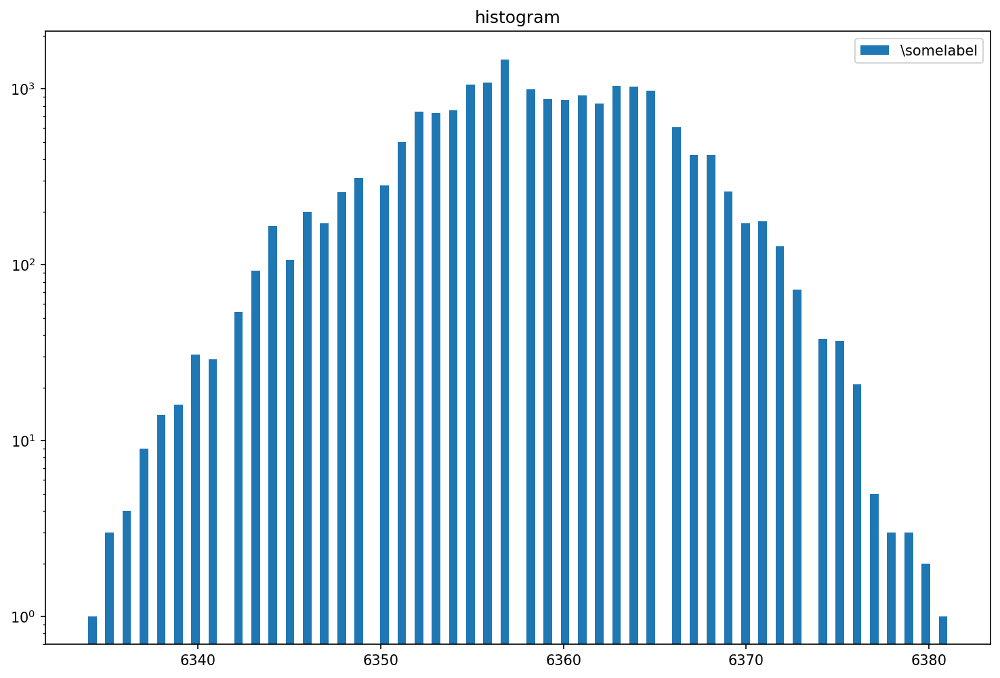

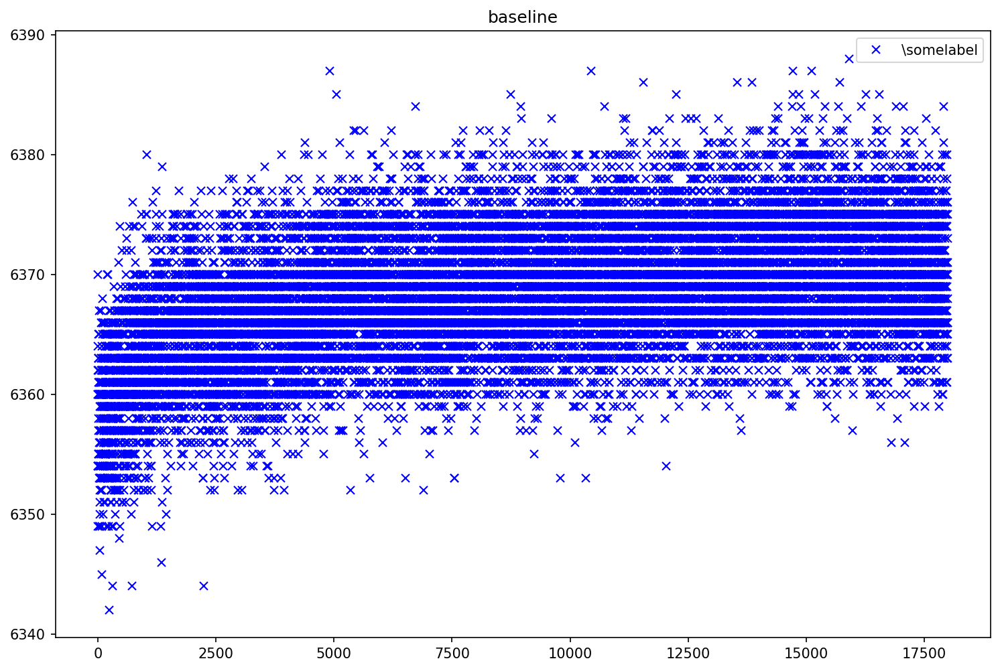

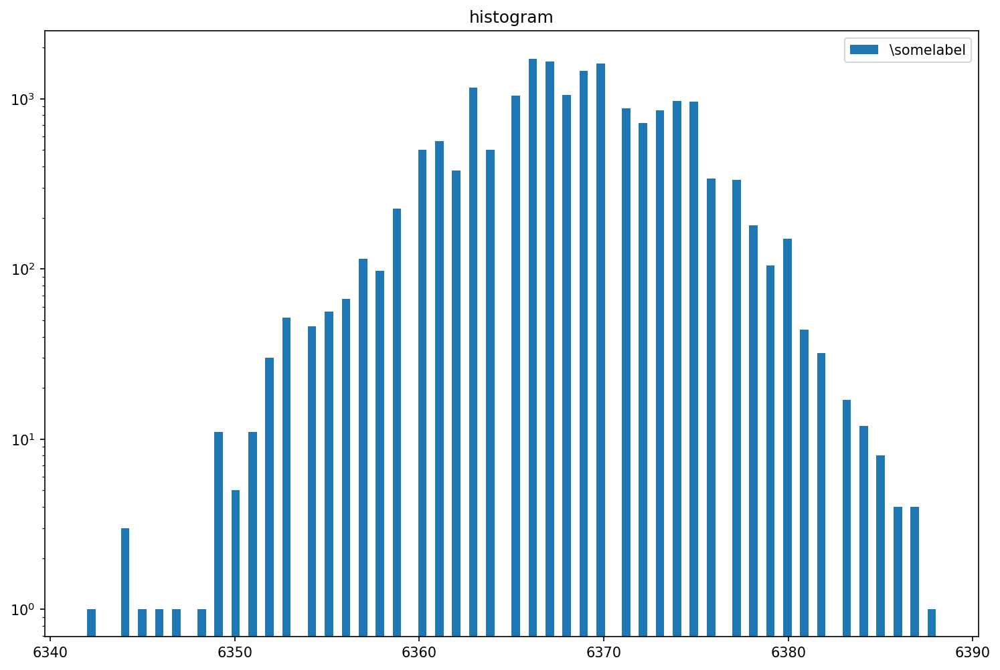

(145, 384)


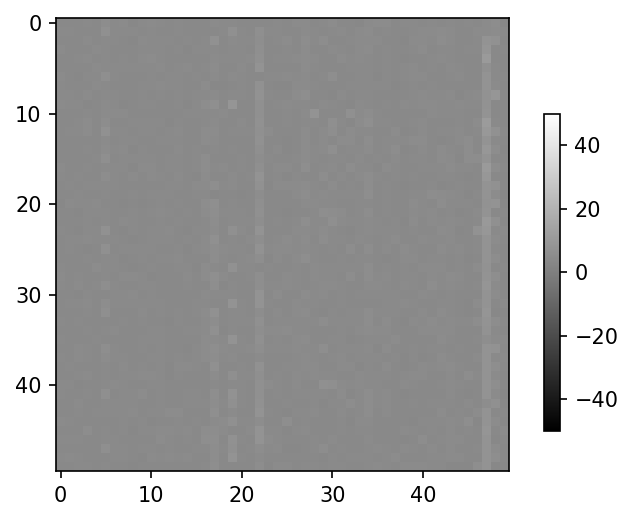

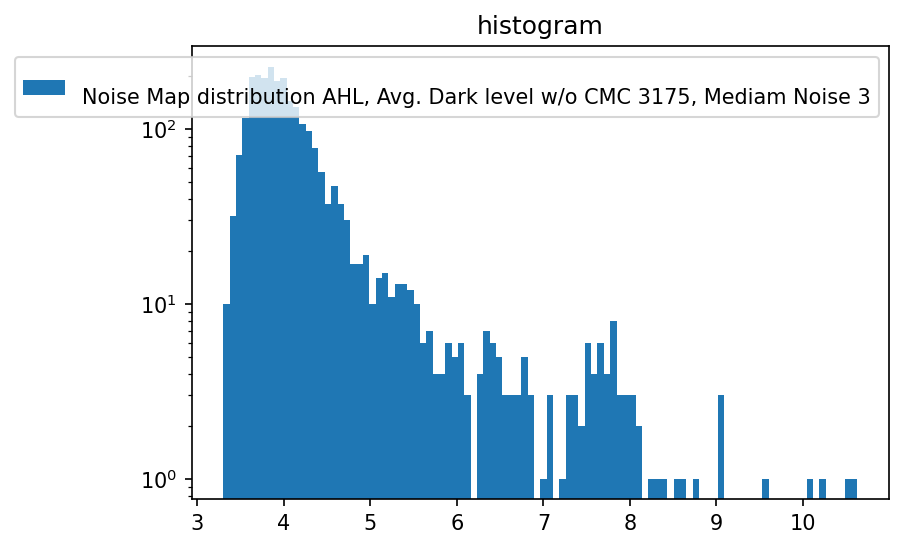


Camera  ePixHr10kTBatcher  selected.
Command executed :  <class 'pyrogue._Command.BaseCommand'> - ePixHr10kT.EpixHR.Hr10kTAsic2.ClearMatrix
The file does not exist
/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_21_Preamp_4_Vld1b_1_PixelCB_4_Filter_DAC_38_VRrefdac_53_DHg_1_RefGenB_2_RefGenC_3_peds_8_trbit_0_run1.dat
Aquisition Counter 2220080
DAQ Counter 2019890
Number of frames received: 50044
Number of frames received: 52046
Delta Aquisition Counter: 54049
Number of frames received: 54049
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 2
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56072)
(145, 384)


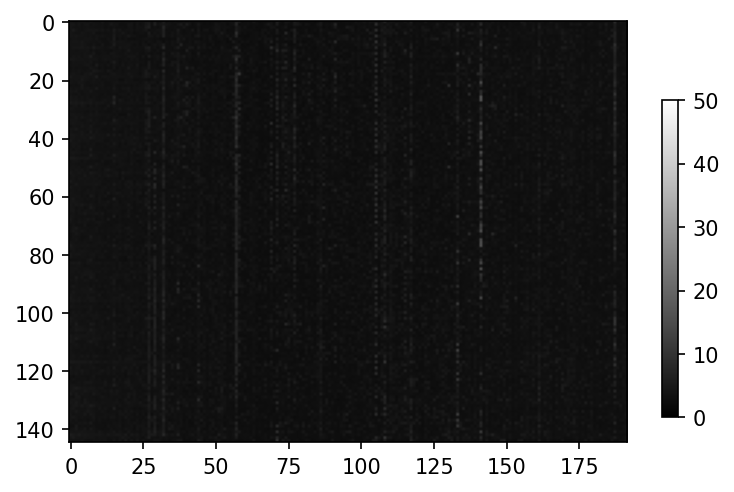

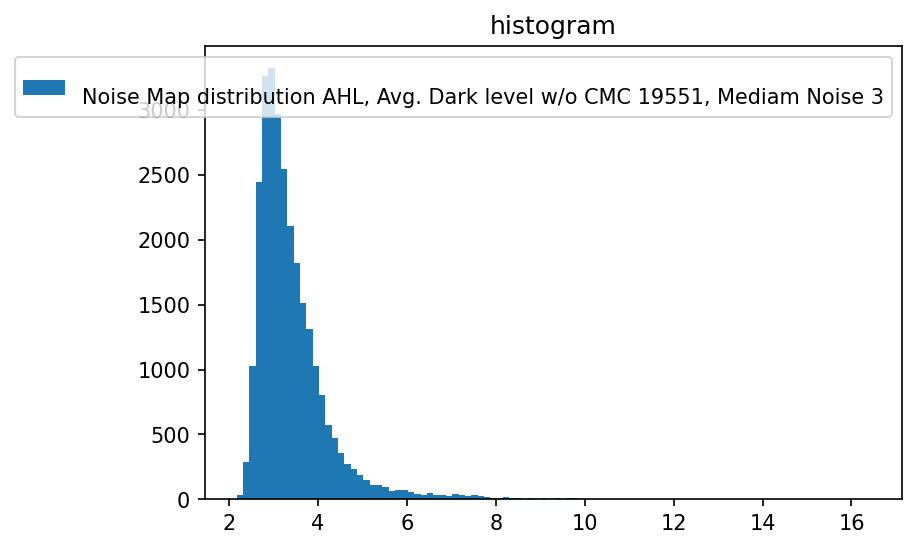

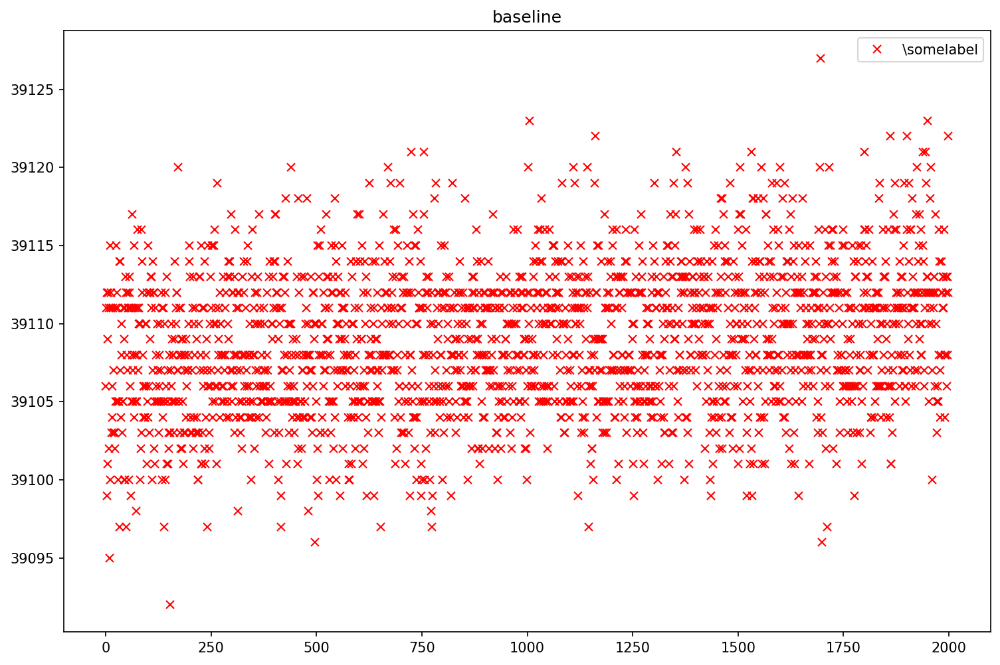

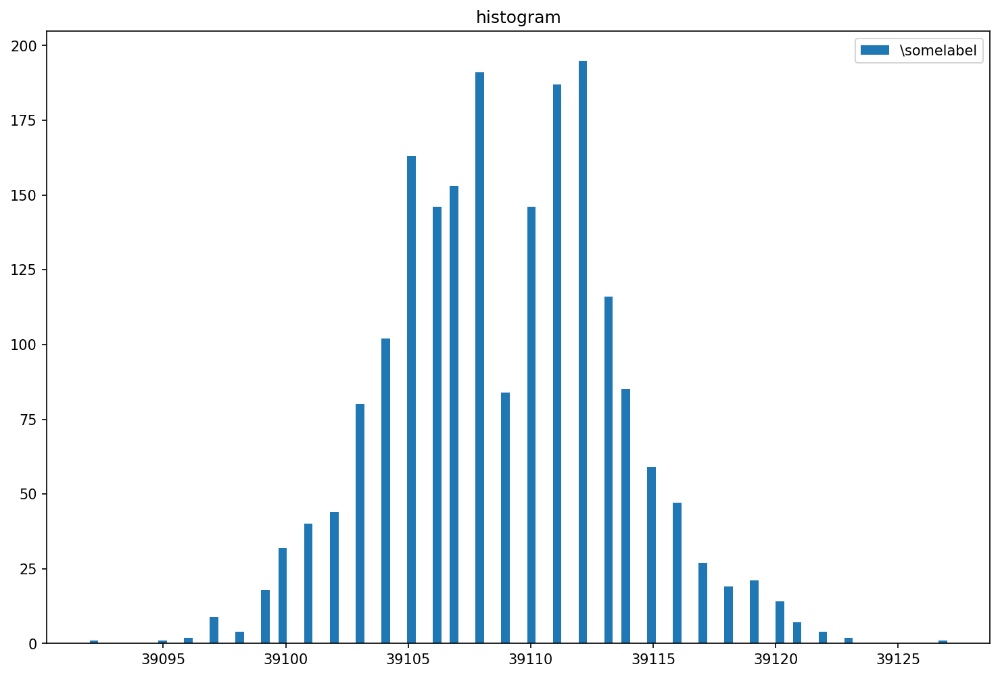

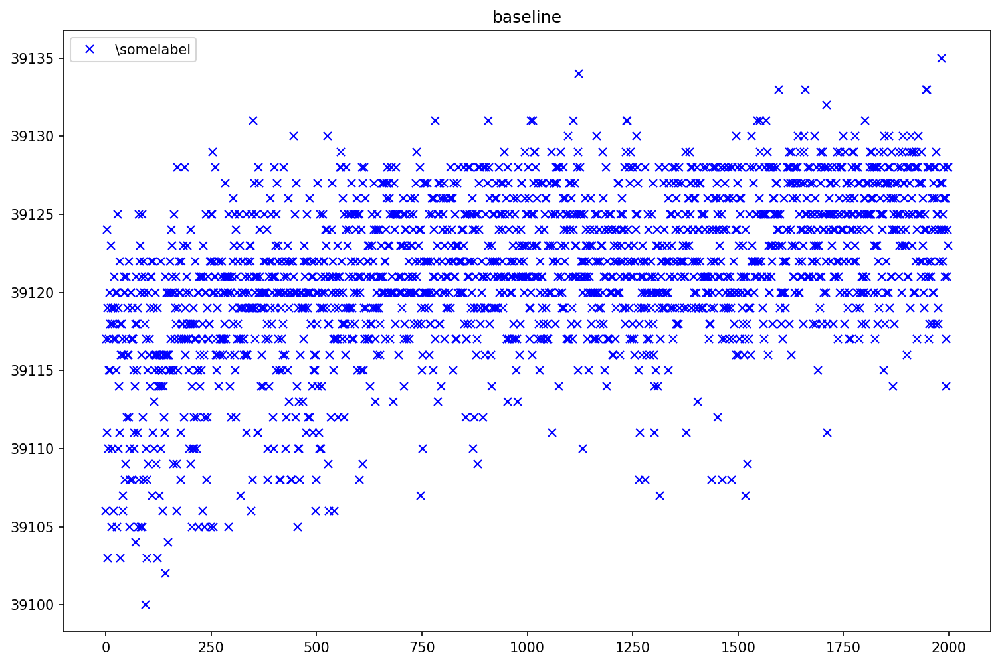

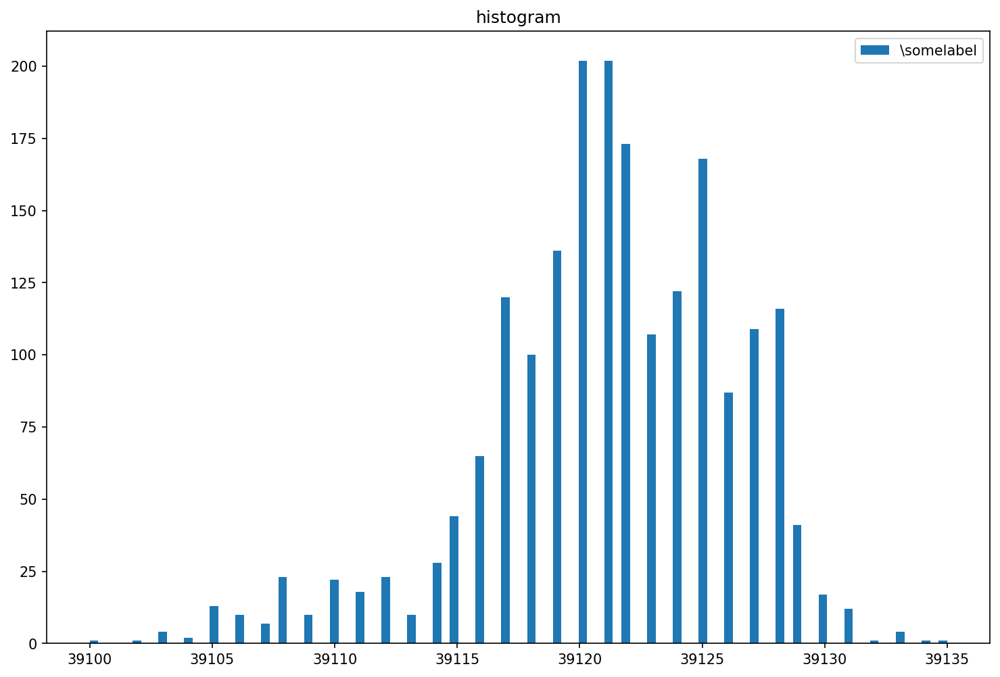

(145, 384)


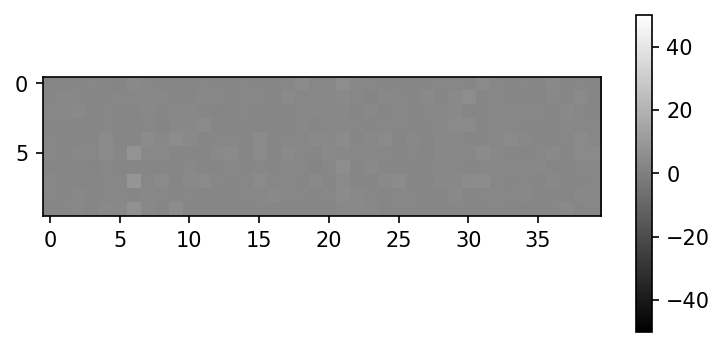

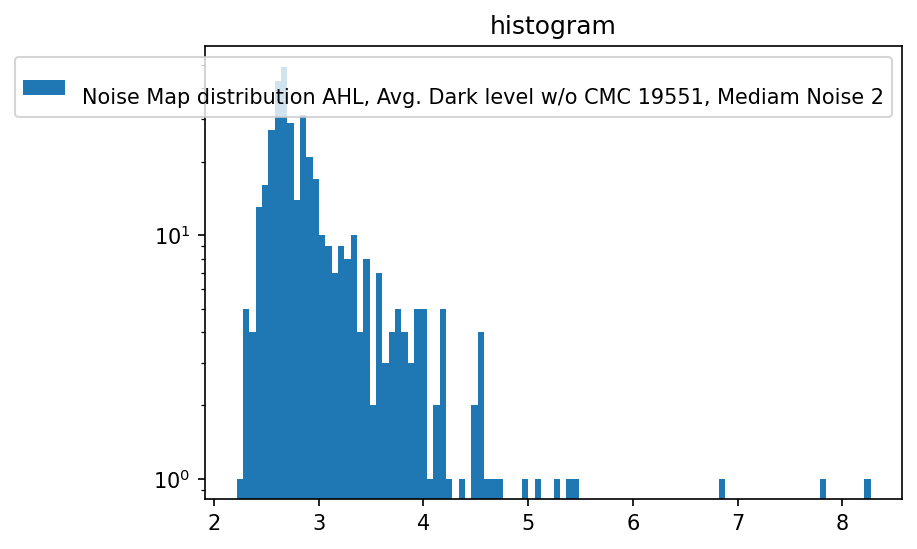


(145, 384)


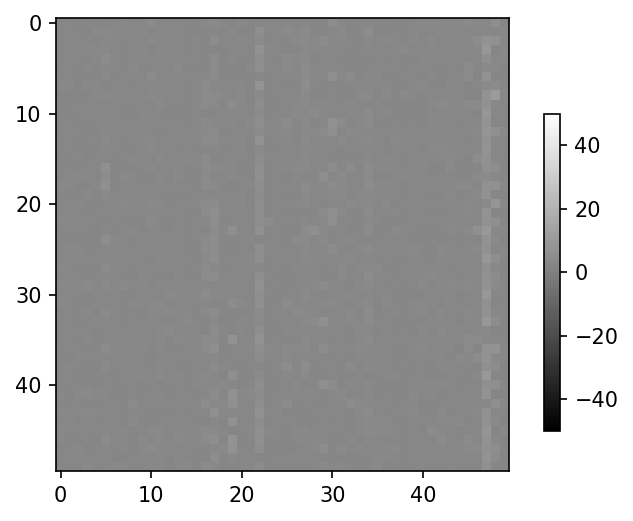

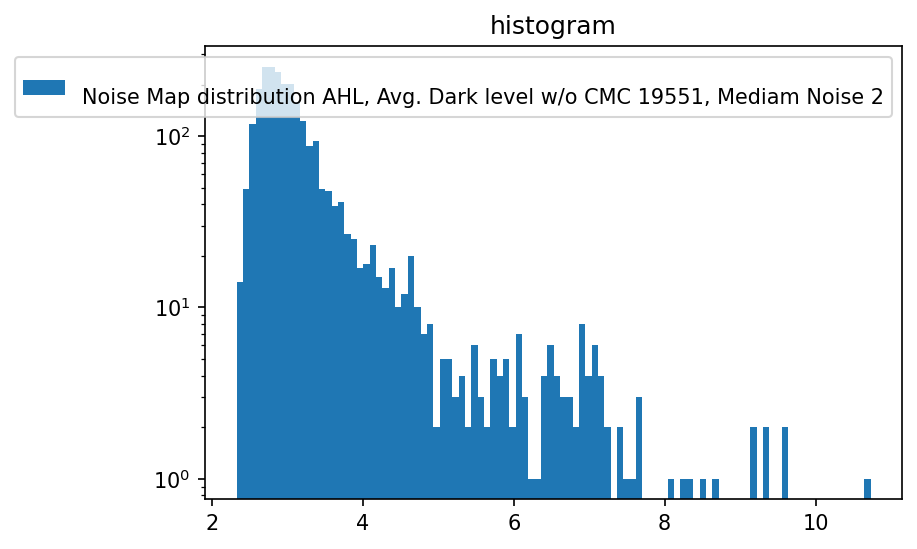


/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_21_Preamp_4_Vld1b_1_PixelCB_4_Filter_DAC_38_VRrefdac_53_DHg_1_RefGenB_2_RefGenC_3_peds_8_trbit_0_run1.dat
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 2
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 3
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 4
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 5
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 6
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get 

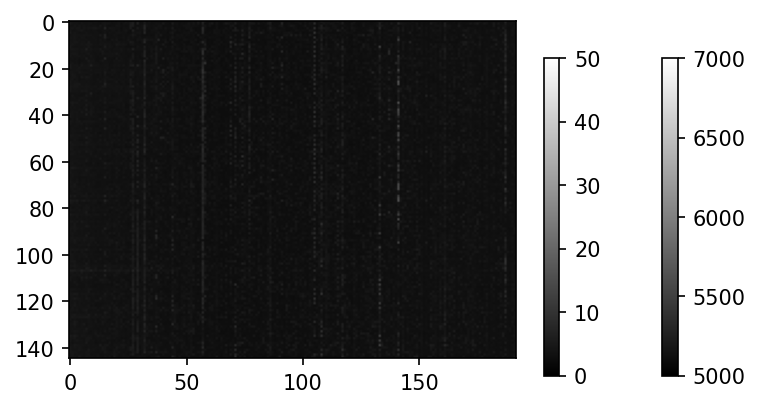

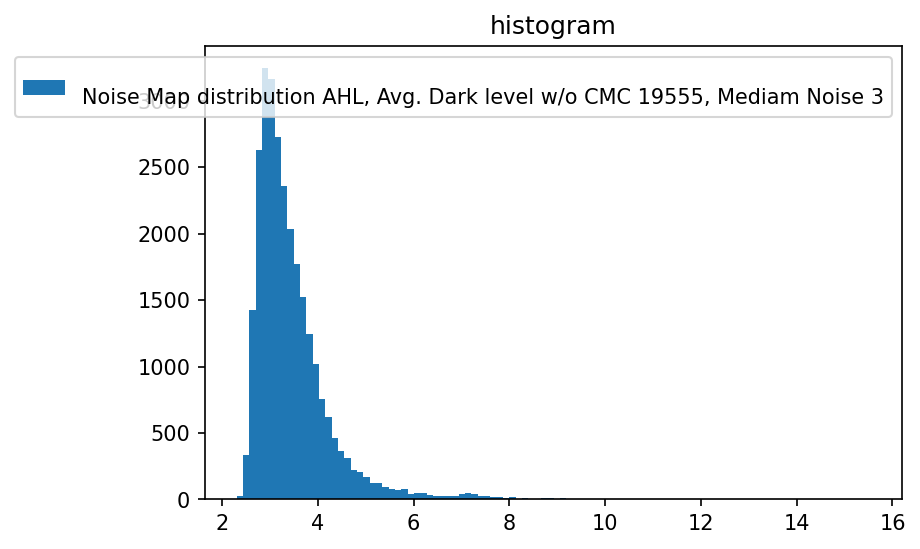

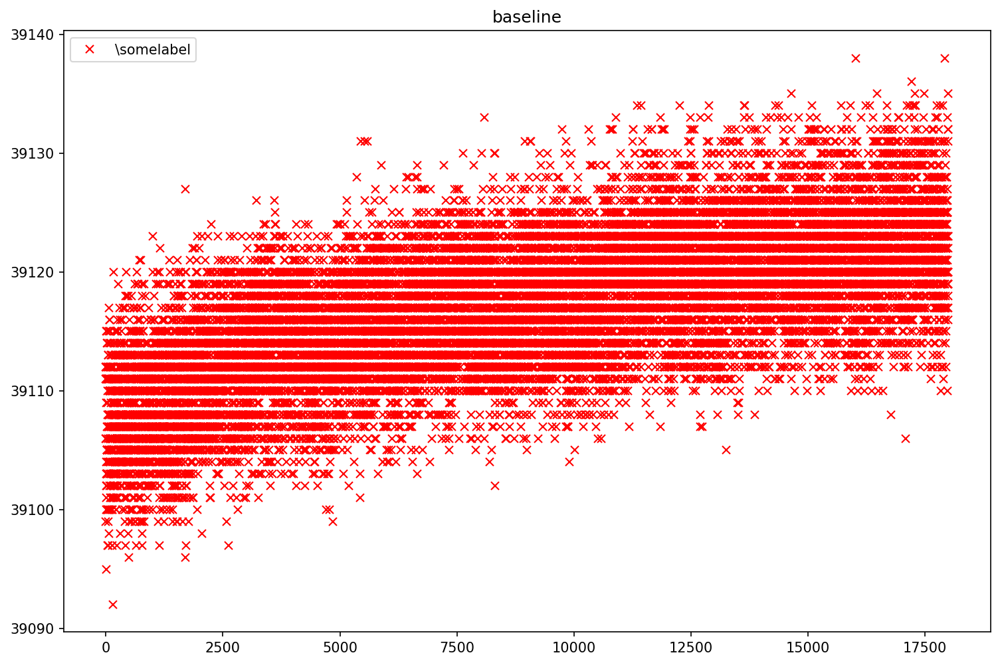

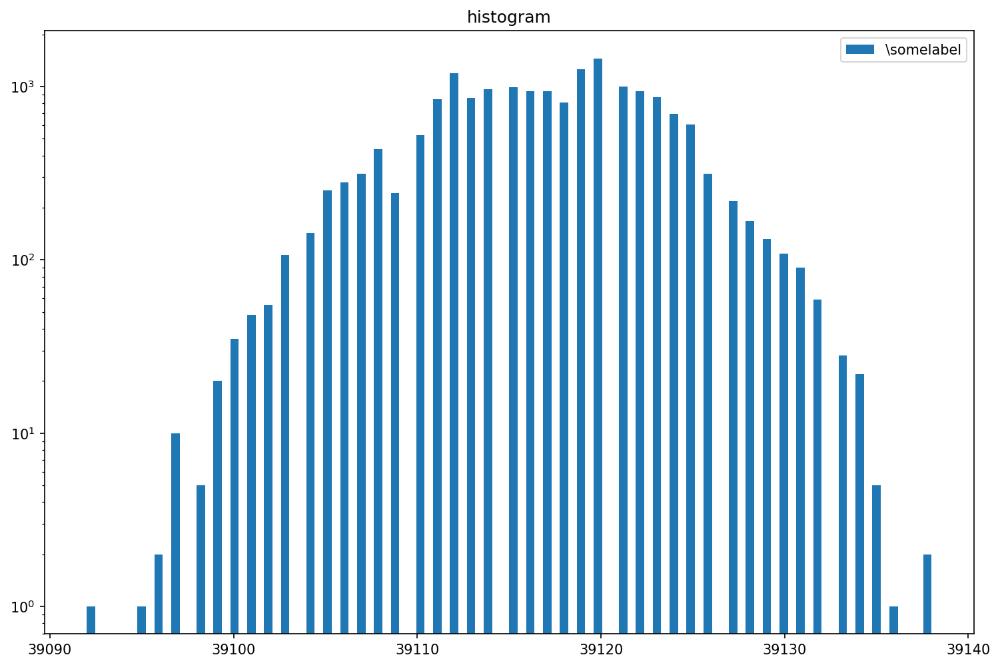

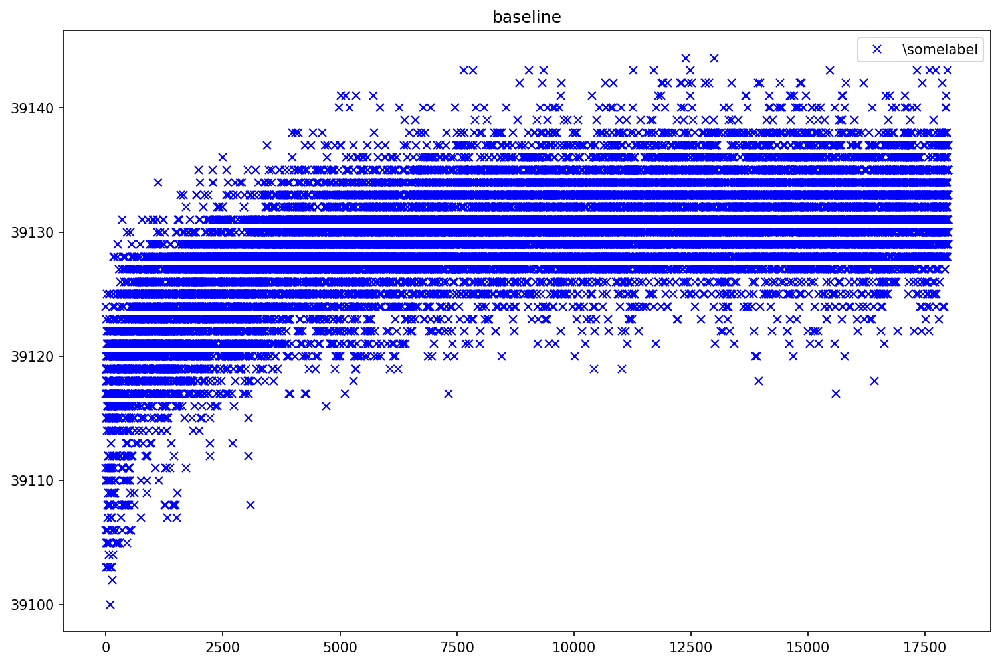

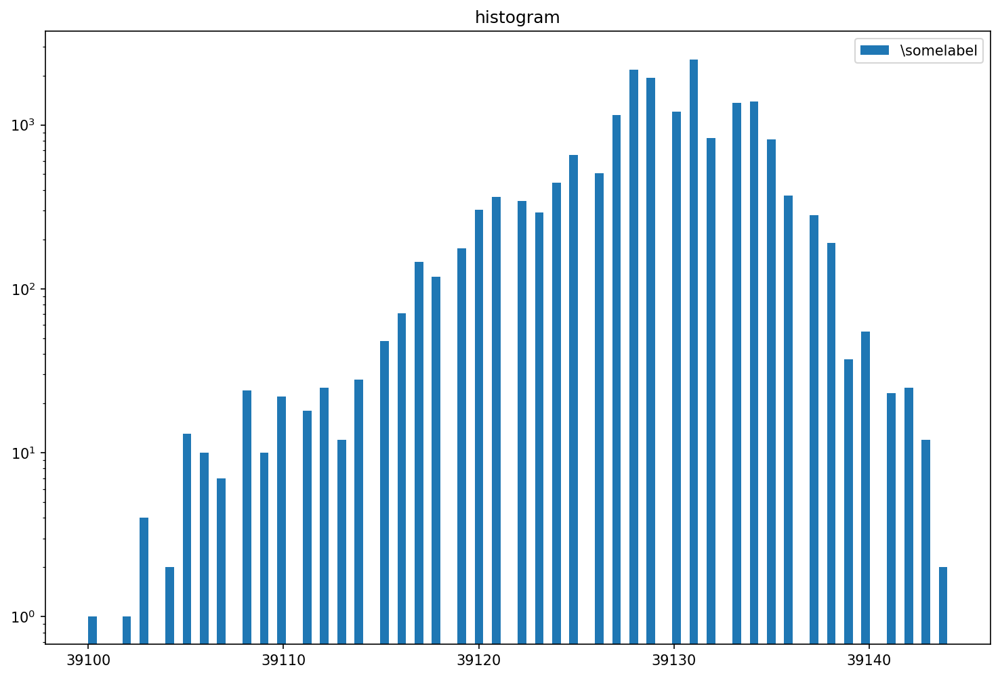

(145, 384)


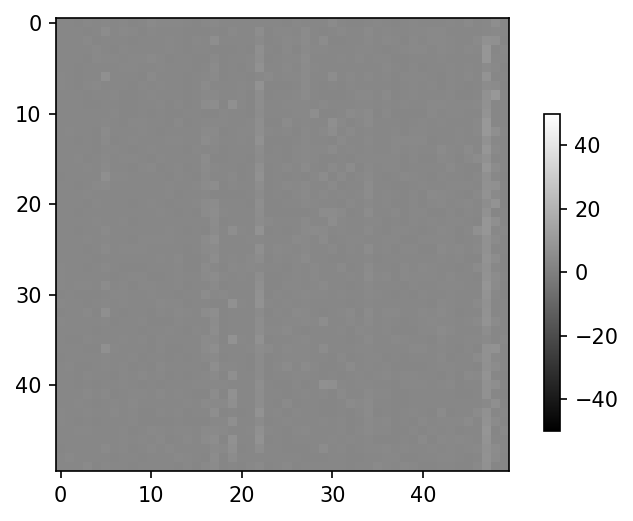

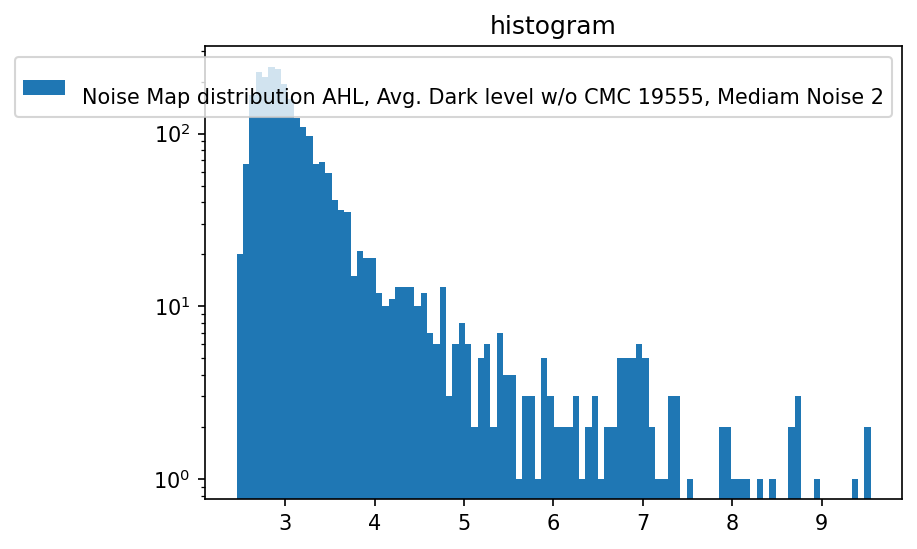


Camera  ePixHr10kTBatcher  selected.
Command executed :  <class 'pyrogue._Command.BaseCommand'> - ePixHr10kT.EpixHR.Hr10kTAsic2.ClearMatrix
The file does not exist
/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_21_Preamp_4_Vld1b_1_PixelCB_4_Filter_DAC_38_VRrefdac_53_DHg_1_RefGenB_2_RefGenC_3_peds_0_trbit_1_run1.dat
Aquisition Counter 2274129
DAQ Counter 2073939
Number of frames received: 50017
Number of frames received: 52018
Delta Aquisition Counter: 54019
Number of frames received: 54019
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 2
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56072)
(145, 384)


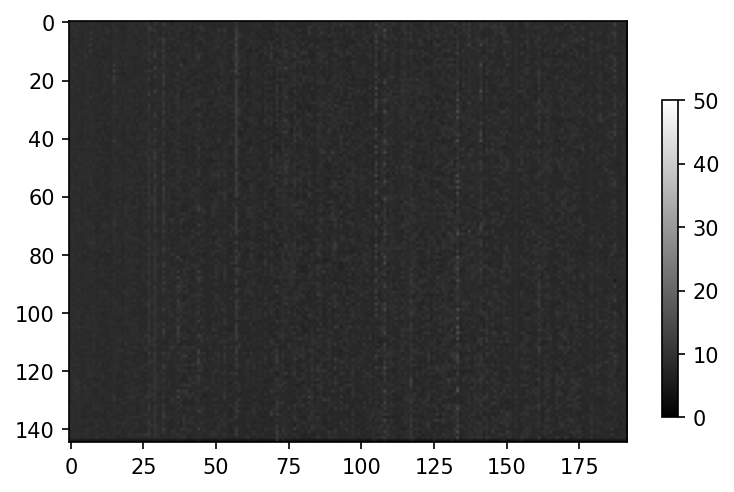

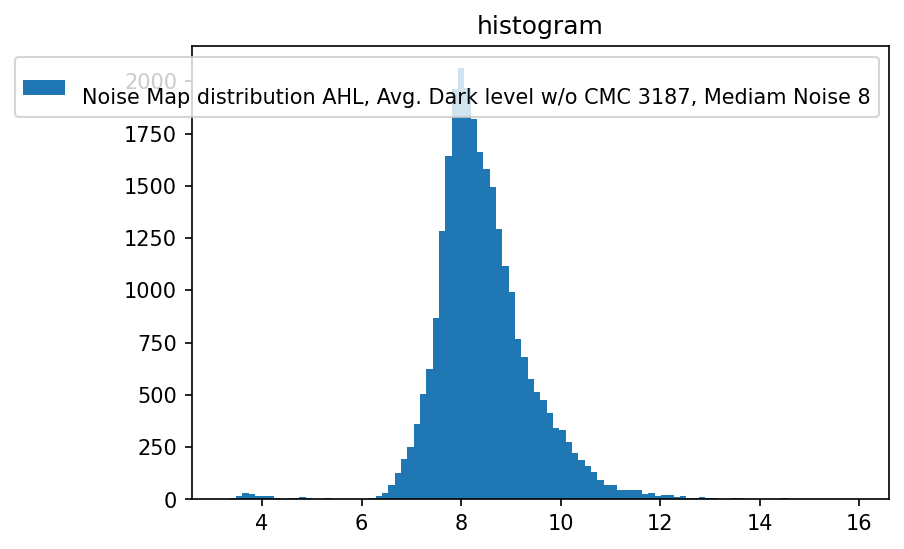

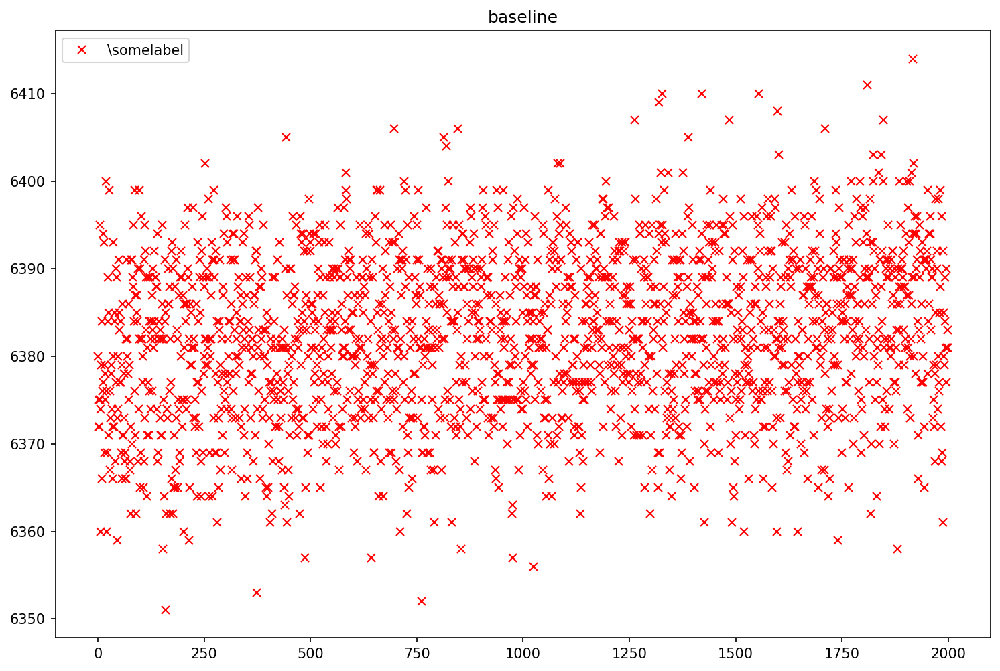

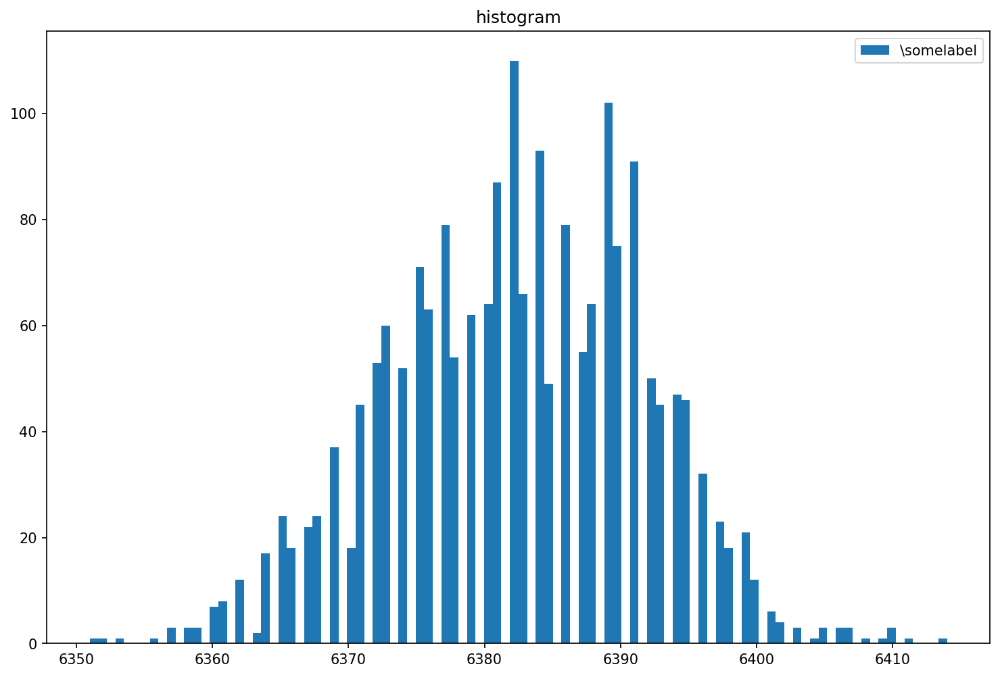

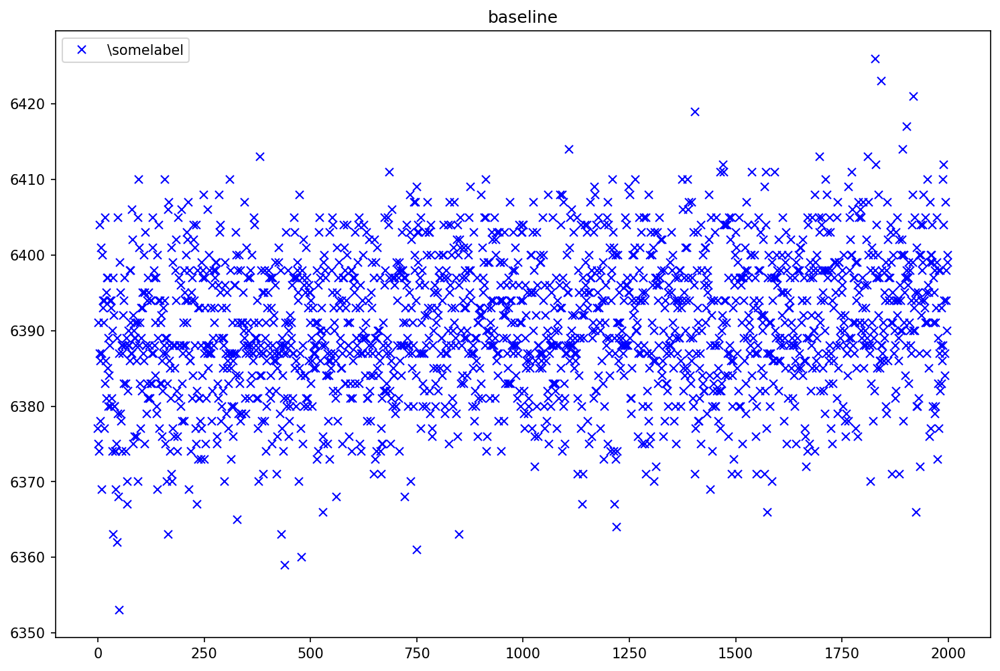

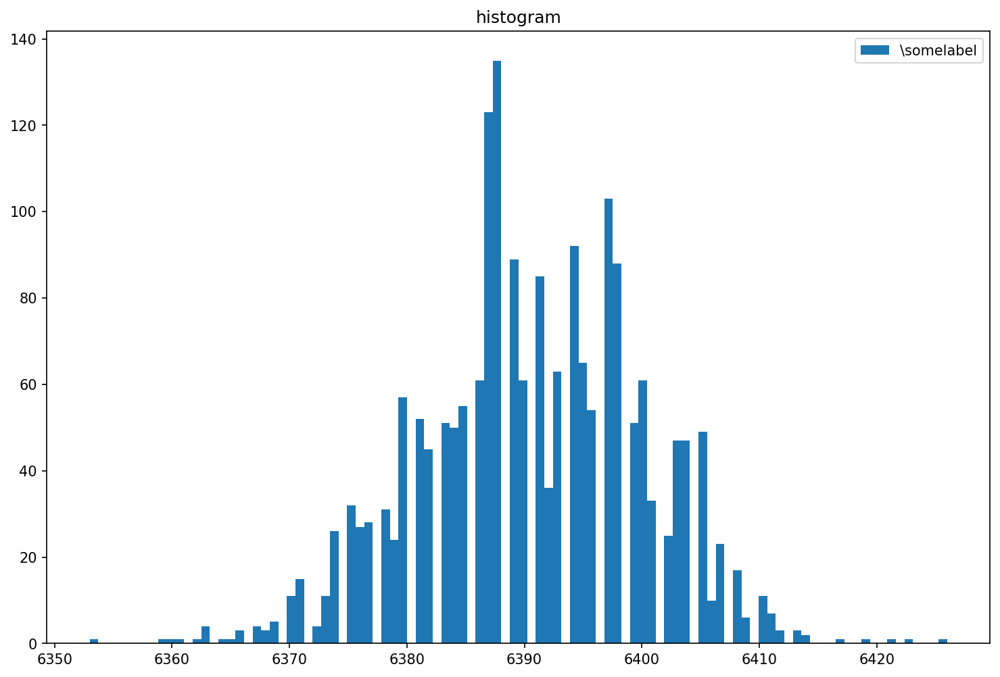

(145, 384)


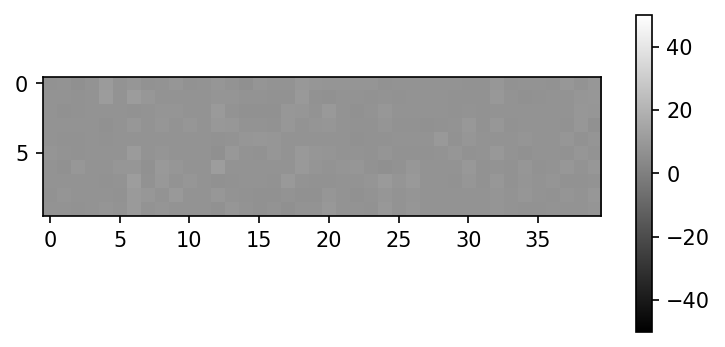

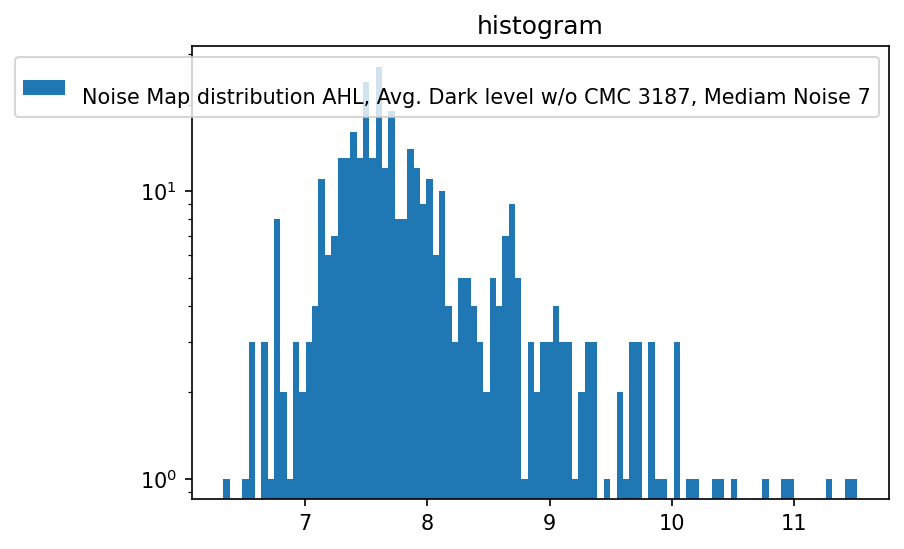


(145, 384)


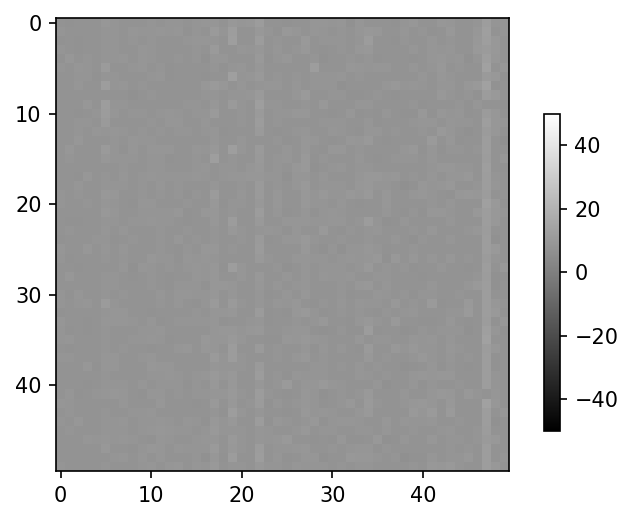

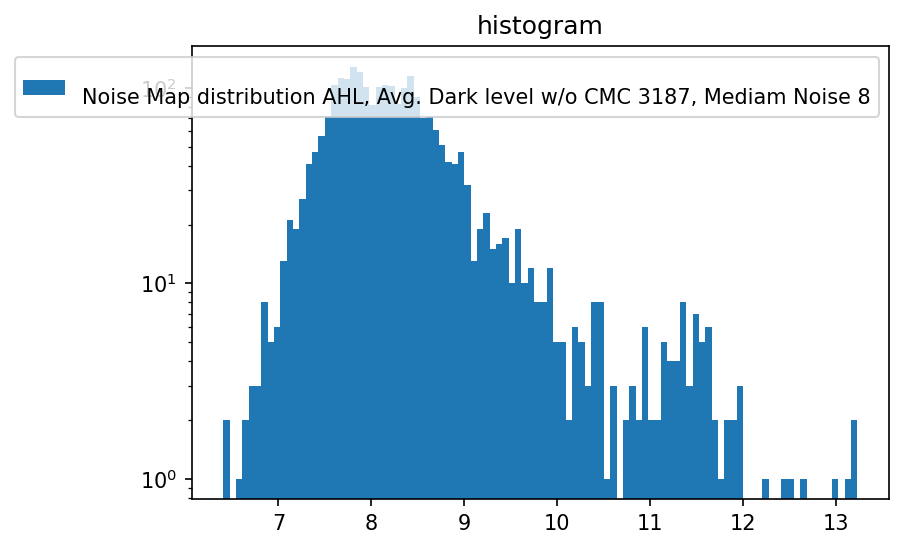


/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_21_Preamp_4_Vld1b_1_PixelCB_4_Filter_DAC_38_VRrefdac_53_DHg_1_RefGenB_2_RefGenC_3_peds_0_trbit_1_run1.dat
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 2
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 3
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 4
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 5
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 6
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get 

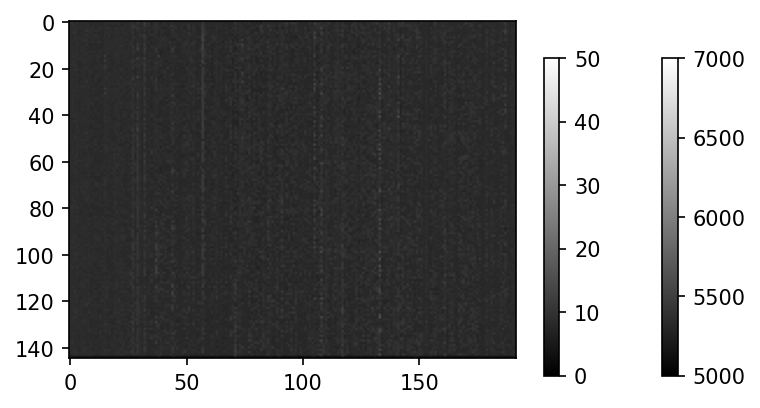

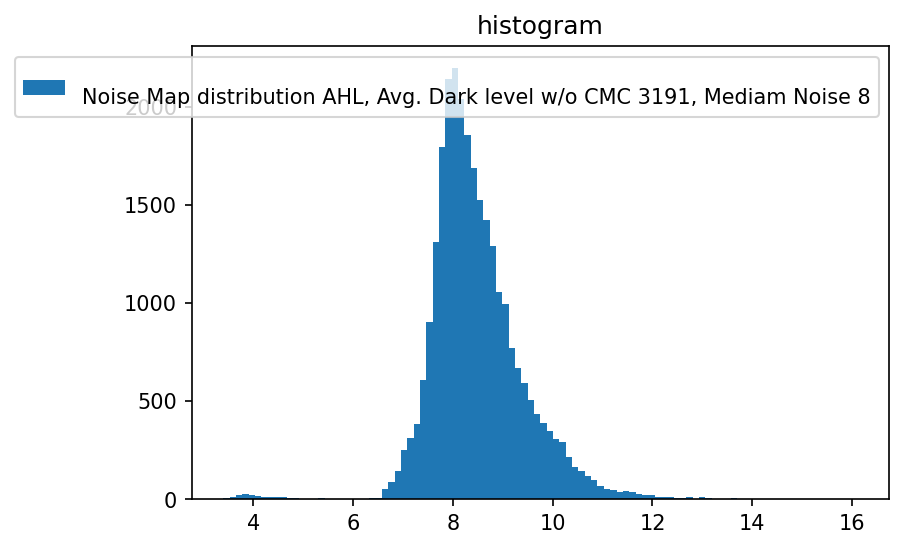

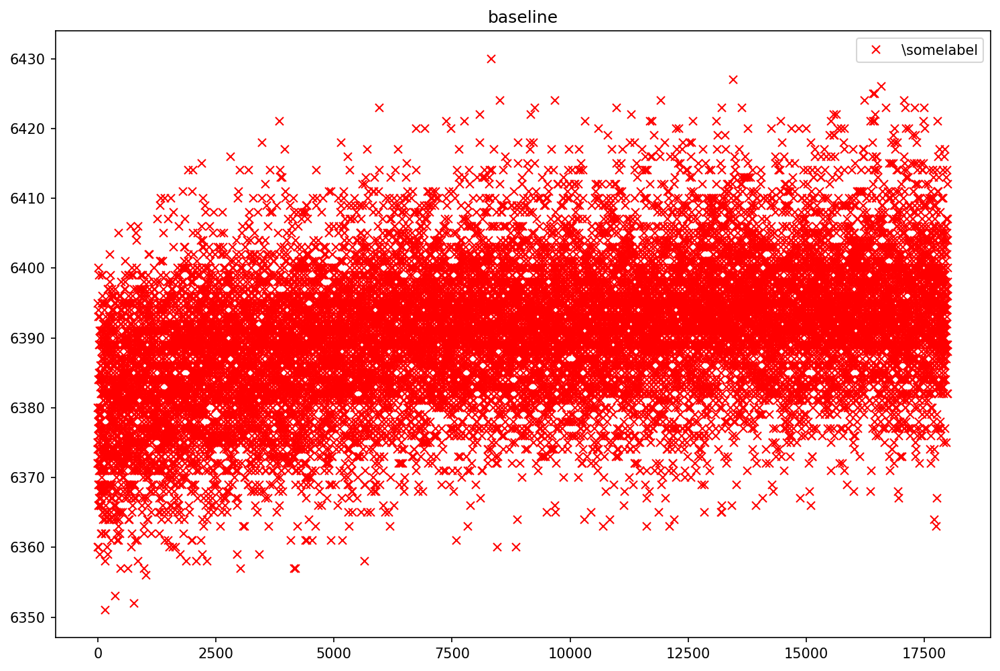

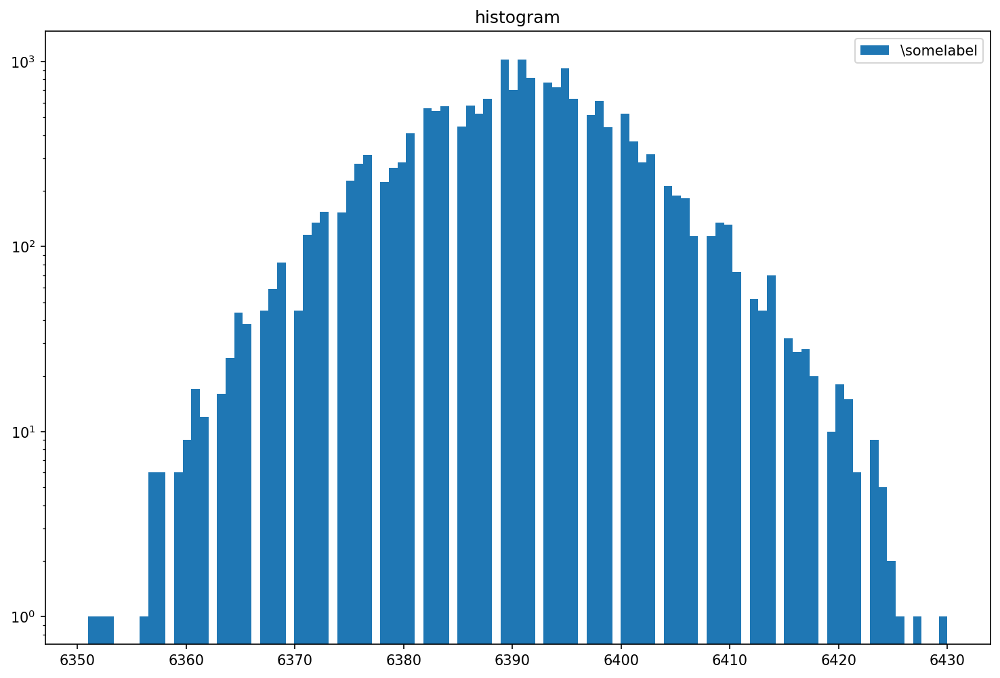

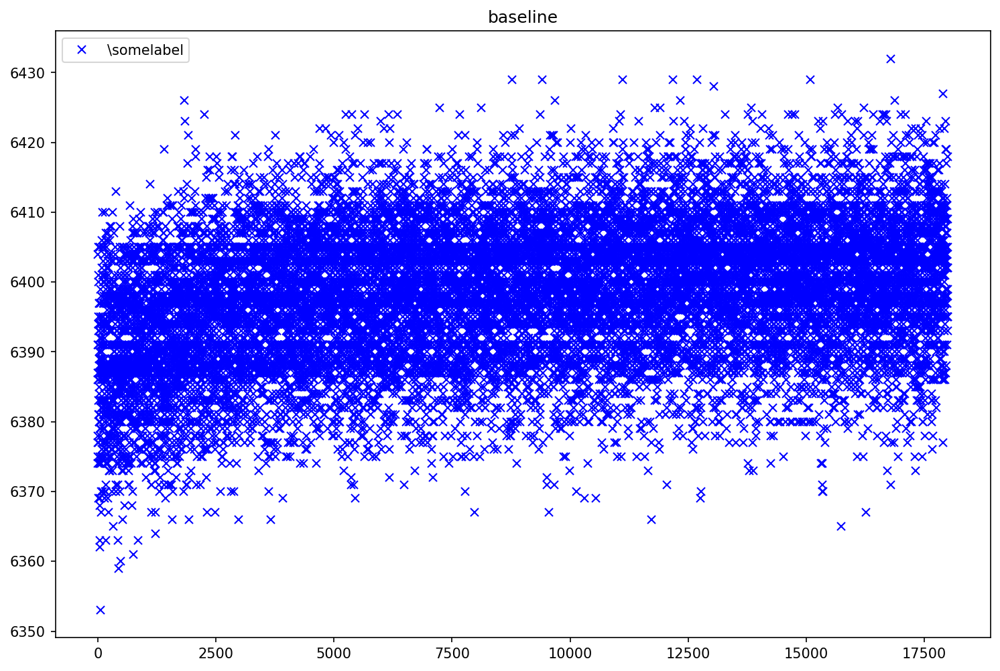

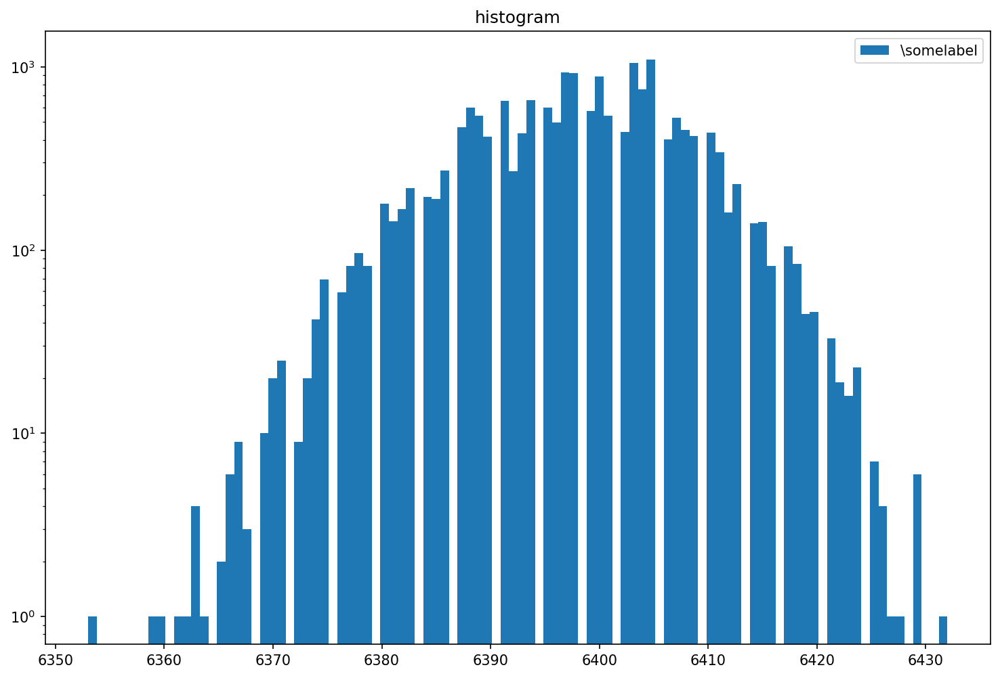

(145, 384)


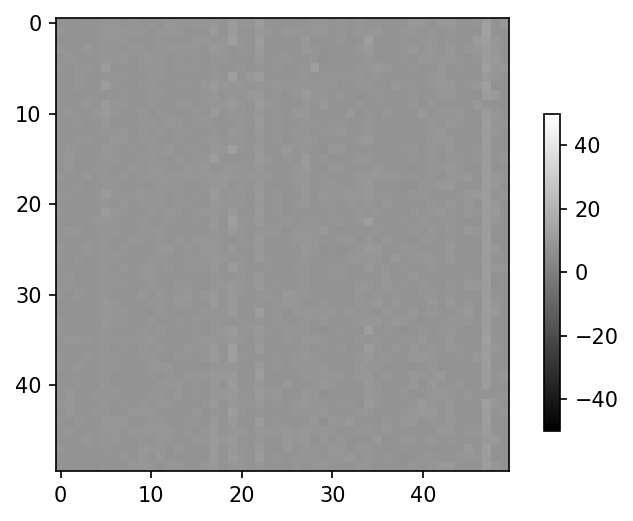

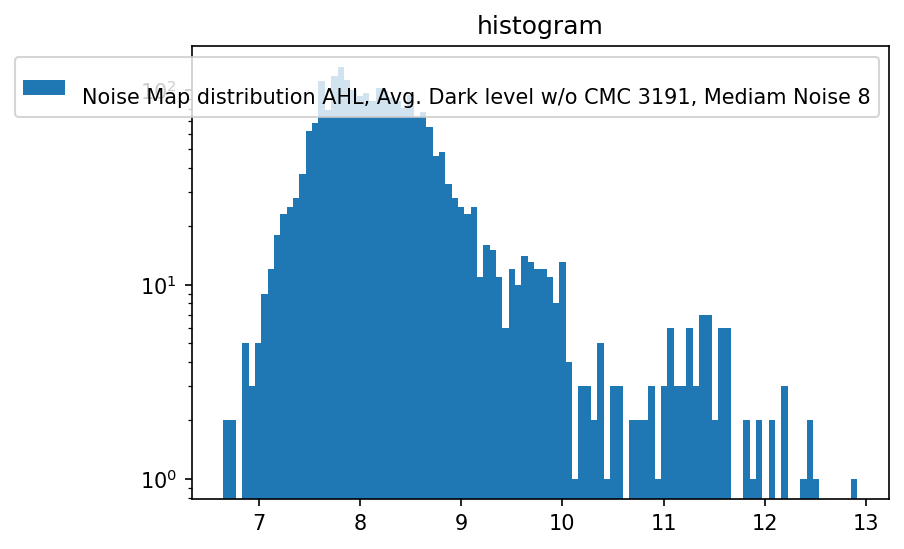


Camera  ePixHr10kTBatcher  selected.
Command executed :  <class 'pyrogue._Command.BaseCommand'> - ePixHr10kT.EpixHR.Hr10kTAsic2.ClearMatrix
The file does not exist
/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_21_Preamp_4_Vld1b_1_PixelCB_4_Filter_DAC_38_VRrefdac_53_DHg_1_RefGenB_2_RefGenC_3_peds_0_trbit_0_run1.dat
Aquisition Counter 2328148
DAQ Counter 2127958
Number of frames received: 50048
Number of frames received: 52050
Delta Aquisition Counter: 54053
Number of frames received: 54053
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 2
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56072)
(145, 384)


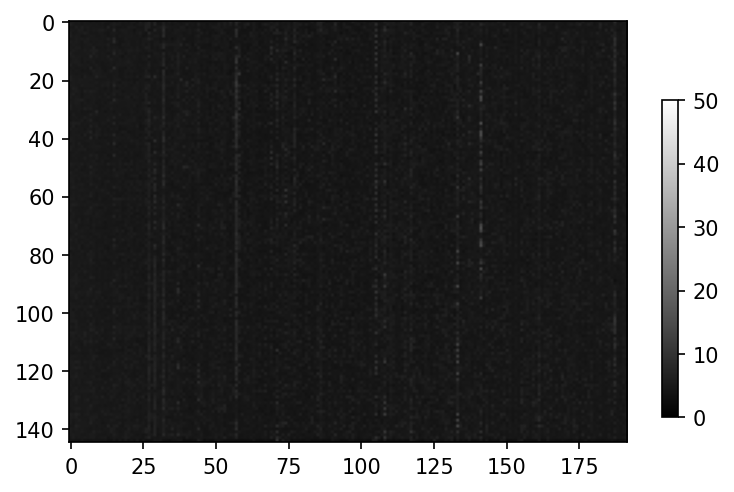

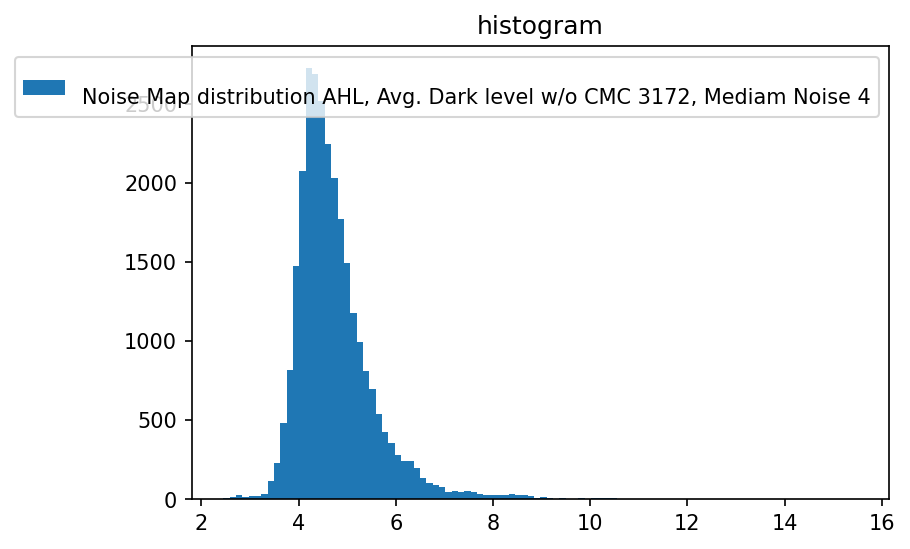

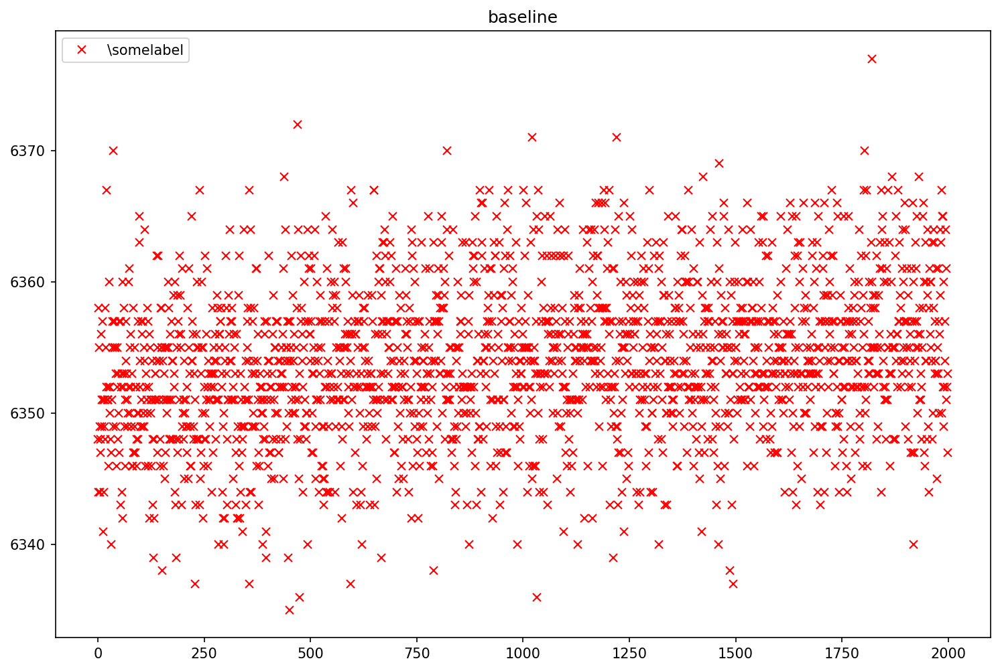

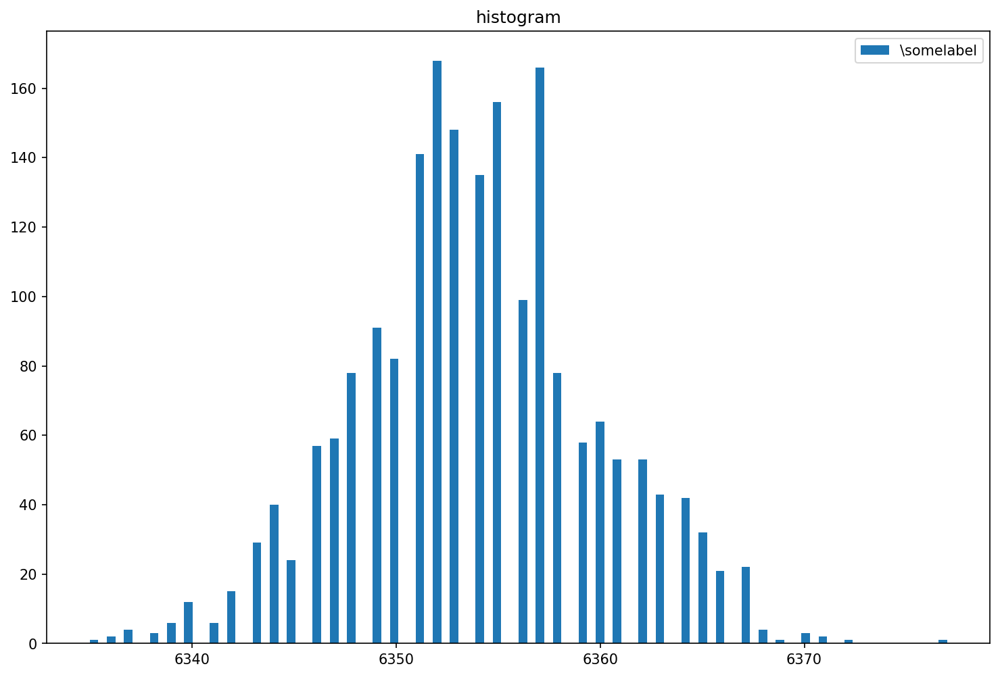

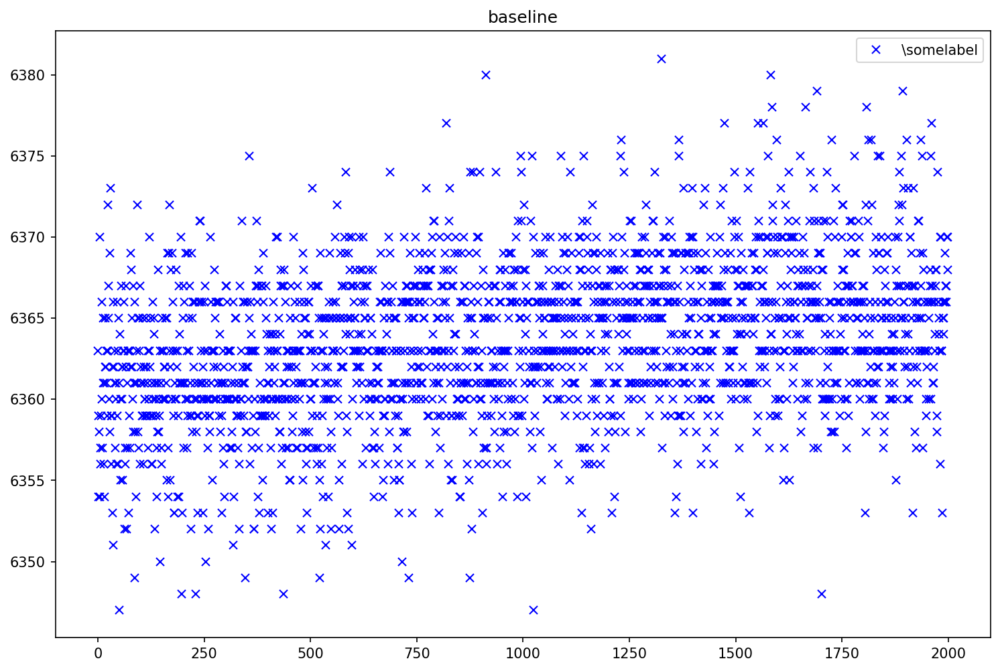

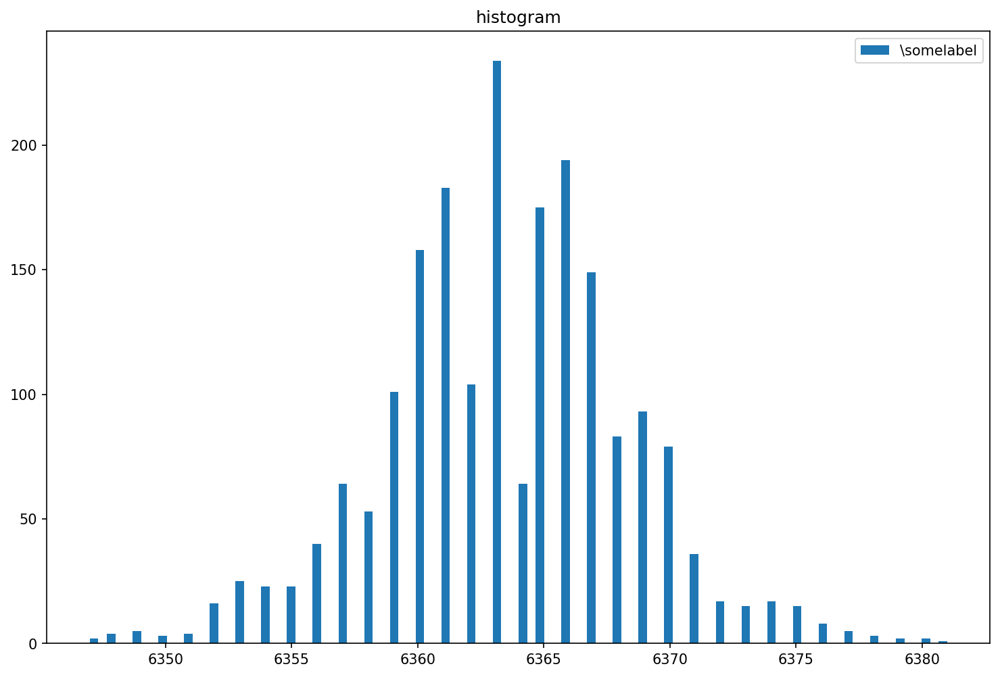

(145, 384)


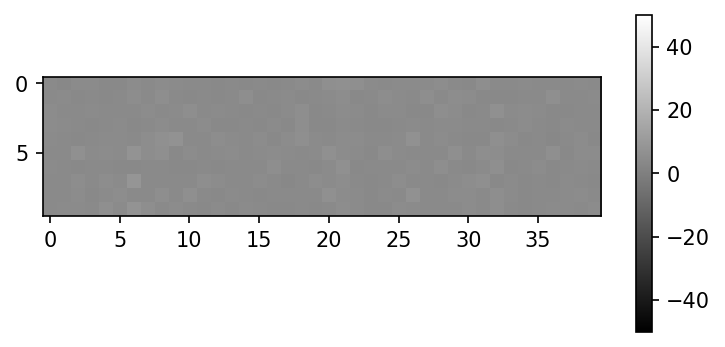

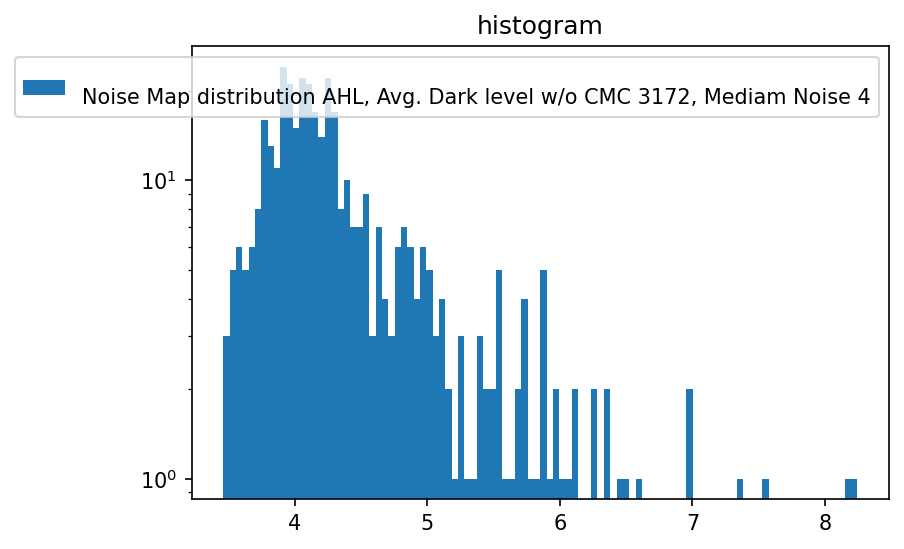


(145, 384)


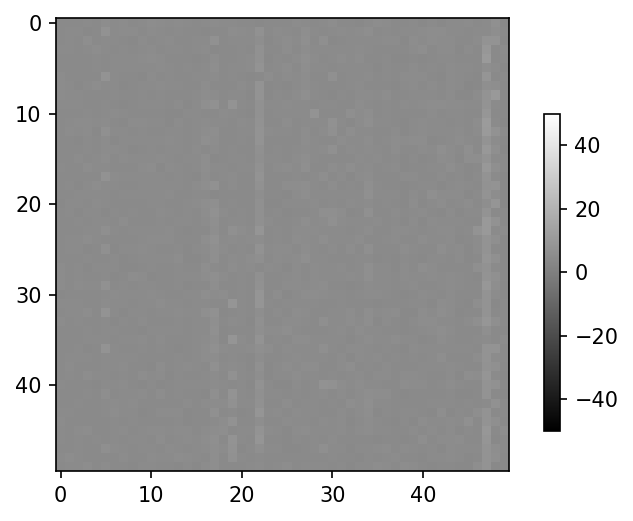

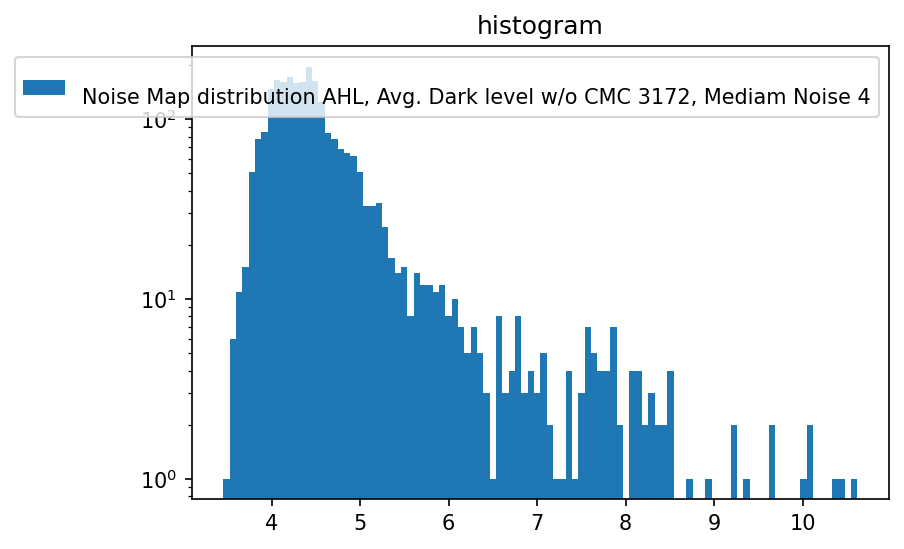


/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_21_Preamp_4_Vld1b_1_PixelCB_4_Filter_DAC_38_VRrefdac_53_DHg_1_RefGenB_2_RefGenC_3_peds_0_trbit_0_run1.dat
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 2
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 3
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 4
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 5
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 6
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get 

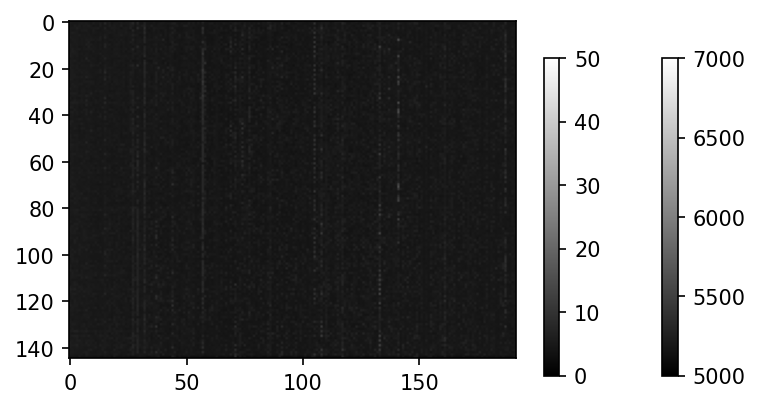

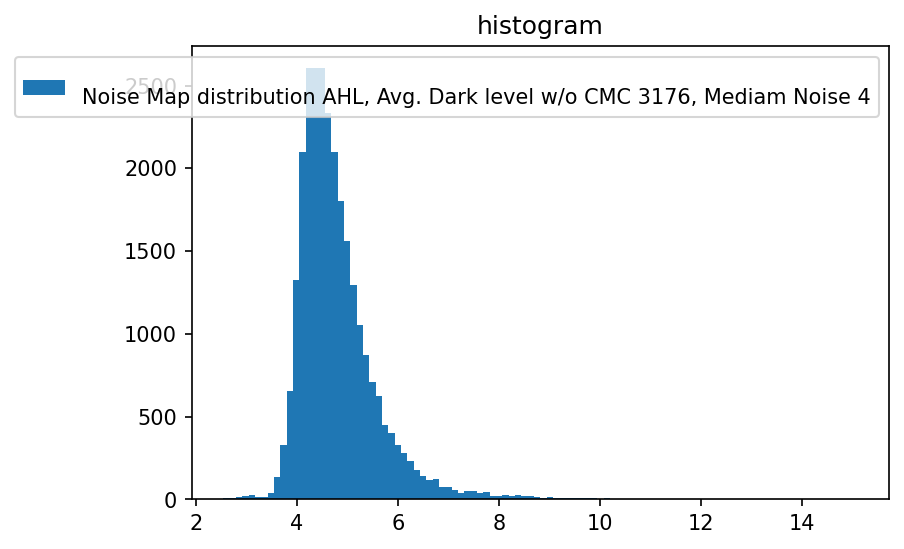

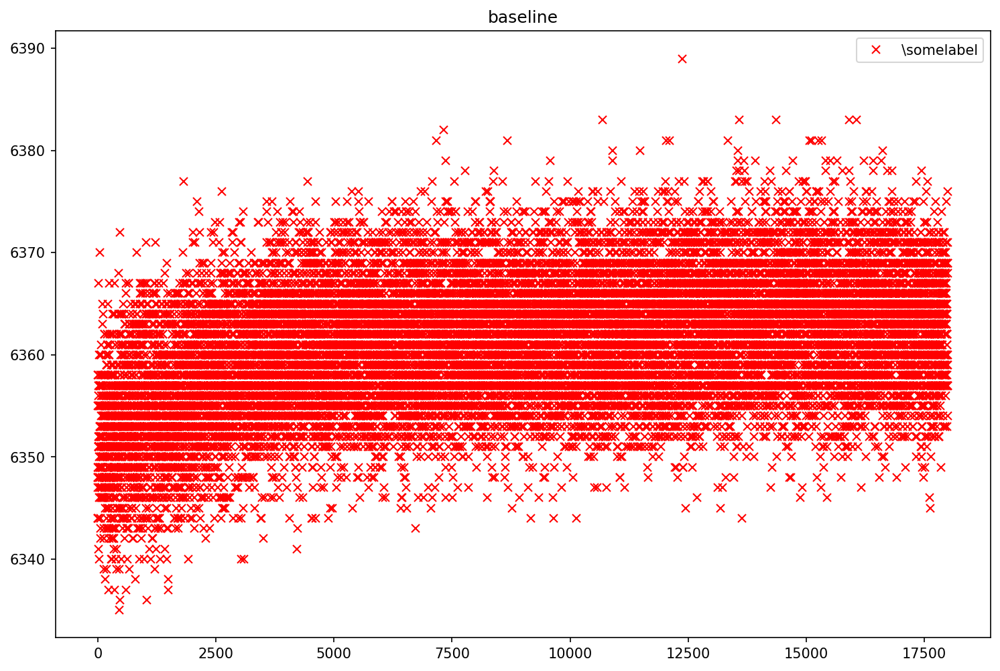

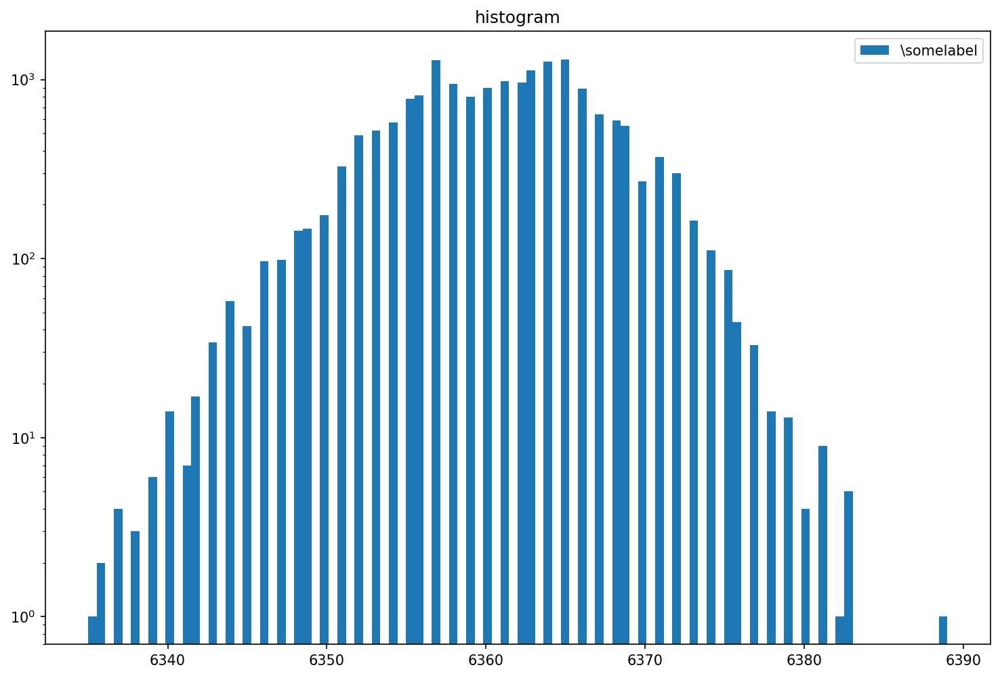

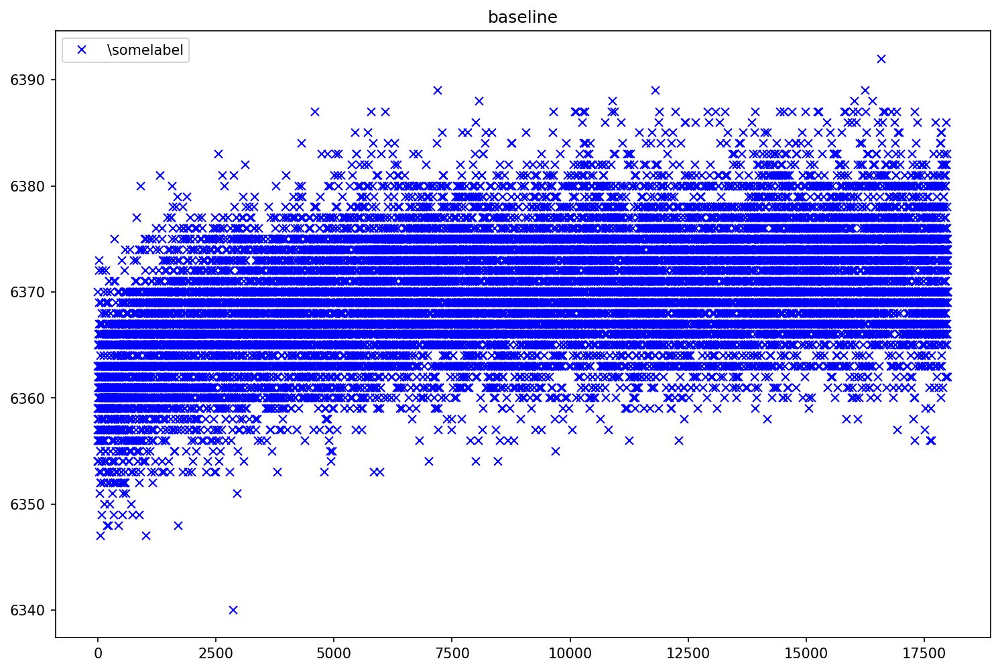

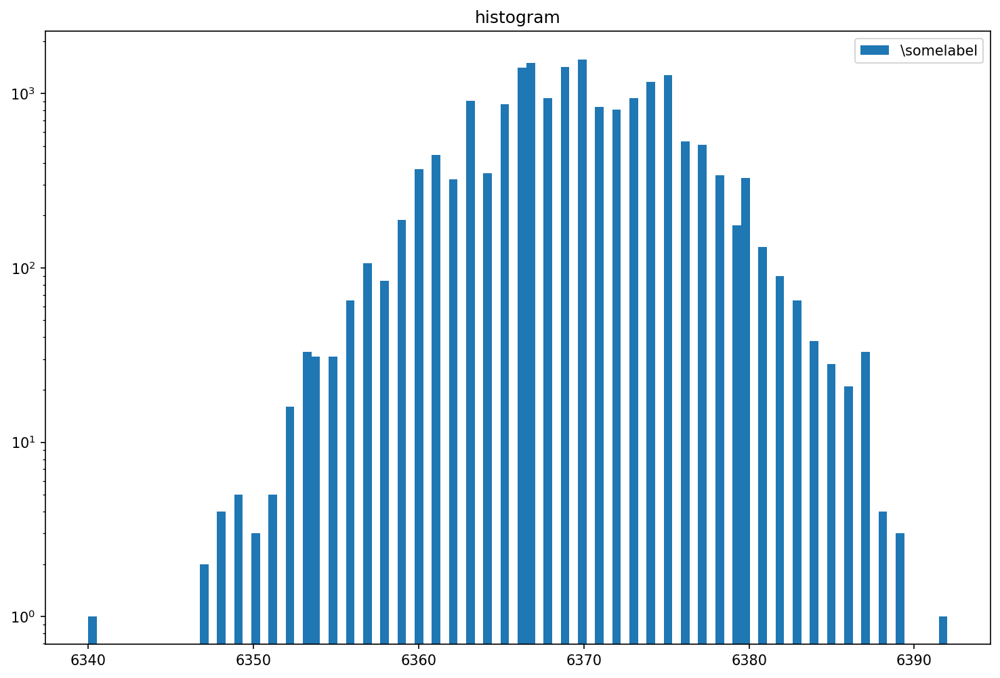

(145, 384)


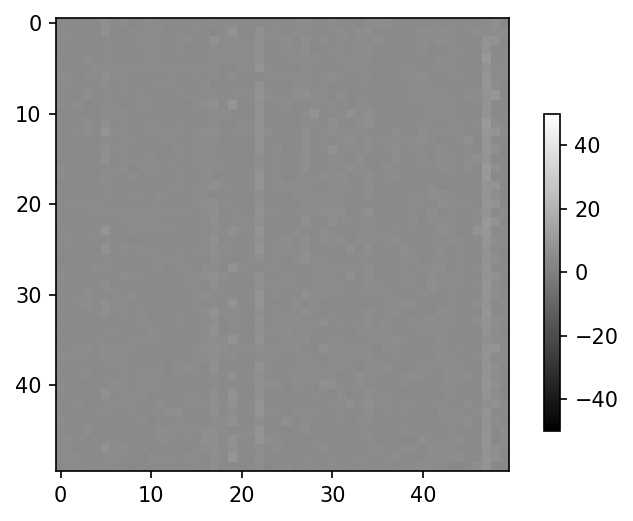

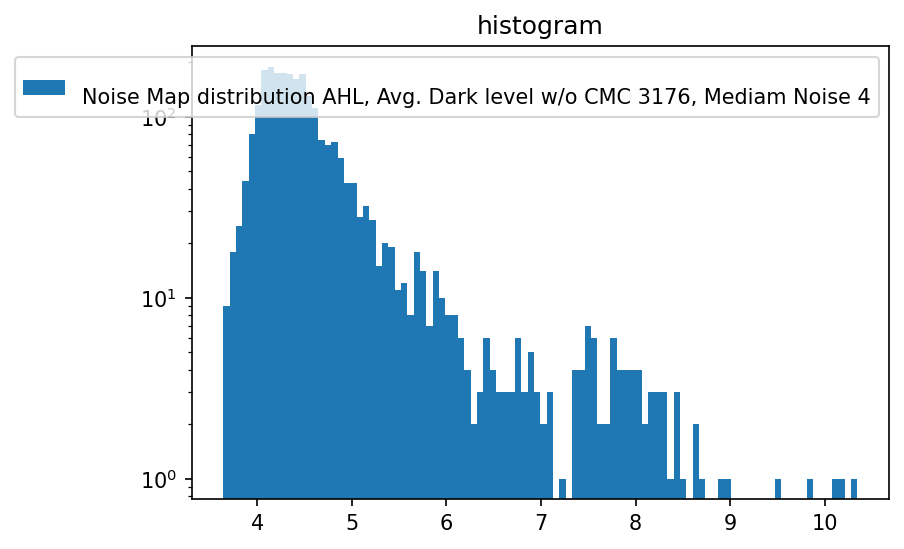


Camera  ePixHr10kTBatcher  selected.


In [47]:
#Makes sure triggers are off
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.2)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(True)
time.sleep(0.2)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.2)

Preamp = 4 #4
Vld1_b = 1 #1
Pixel_CB= 4 #4
Filter_DAC= 38 #33
VRef_DAC = 53 #22

setPixel (Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC)

pedsList = [12,12,8,0,0]
trbitList = [True,0,0,True,0]

#########
index = 0
trbit = trbitList[index]
ASIC.trbit.set(trbit)
peds = pedsList[index]
ASIC.ClearMatrix(peds)
######################################################################################################################
# Remove previous dataset
filename = (f'/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_%d_Preamp_%d_Vld1b_%d_PixelCB_%d_Filter_DAC_%d_VRrefdac_%d_DHg_%d_RefGenB_%d_RefGenC_%d_peds_%d_trbit_%d_run1.dat' % (initSequence, Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC,DHg,RefGenB,RefGenC,peds,trbit))
######################################################################################################################
FH = complete_test(filename)
MAX_NUMBER_OF_FRAMES_PER_BATCH  = 1000
cameraType            = 'ePixHr10kTBatcher'
bitMask               = 0xffff
currentCam = cameras.Camera(cameraType = cameraType)
currentCam.bitMask = bitMask
#########

#########
index = 1
trbit = trbitList[index]
ASIC.trbit.set(trbit)
peds = pedsList[index]
ASIC.ClearMatrix(peds)
######################################################################################################################
# Remove previous dataset
filename = (f'/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_%d_Preamp_%d_Vld1b_%d_PixelCB_%d_Filter_DAC_%d_VRrefdac_%d_DHg_%d_RefGenB_%d_RefGenC_%d_peds_%d_trbit_%d_run1.dat' % (initSequence, Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC,DHg,RefGenB,RefGenC,peds,trbit))
######################################################################################################################
FM = complete_test(filename)
MAX_NUMBER_OF_FRAMES_PER_BATCH  = 1000
cameraType            = 'ePixHr10kTBatcher'
bitMask               = 0xffff
currentCam = cameras.Camera(cameraType = cameraType)
currentCam.bitMask = bitMask
#########

#########
index = 2
trbit = trbitList[index]
ASIC.trbit.set(trbit)
peds = pedsList[index]
ASIC.ClearMatrix(peds)
######################################################################################################################
# Remove previous dataset
filename = (f'/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_%d_Preamp_%d_Vld1b_%d_PixelCB_%d_Filter_DAC_%d_VRrefdac_%d_DHg_%d_RefGenB_%d_RefGenC_%d_peds_%d_trbit_%d_run1.dat' % (initSequence, Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC,DHg,RefGenB,RefGenC,peds,trbit))
######################################################################################################################
FL = complete_test(filename)
MAX_NUMBER_OF_FRAMES_PER_BATCH  = 1000
cameraType            = 'ePixHr10kTBatcher'
bitMask               = 0xffff
currentCam = cameras.Camera(cameraType = cameraType)
currentCam.bitMask = bitMask
#########

#########
index = 3
trbit = trbitList[index]
ASIC.trbit.set(trbit)
peds = pedsList[index]
ASIC.ClearMatrix(peds)
######################################################################################################################
# Remove previous dataset
filename = (f'/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_%d_Preamp_%d_Vld1b_%d_PixelCB_%d_Filter_DAC_%d_VRrefdac_%d_DHg_%d_RefGenB_%d_RefGenC_%d_peds_%d_trbit_%d_run1.dat' % (initSequence, Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC,DHg,RefGenB,RefGenC,peds,trbit))
######################################################################################################################
AHL = complete_test(filename)
MAX_NUMBER_OF_FRAMES_PER_BATCH  = 1000
cameraType            = 'ePixHr10kTBatcher'
bitMask               = 0xffff
currentCam = cameras.Camera(cameraType = cameraType)
currentCam.bitMask = bitMask
#########

#########
index = 4
trbit = trbitList[index]
ASIC.trbit.set(trbit)
peds = pedsList[index]
ASIC.ClearMatrix(peds)
######################################################################################################################
# Remove previous dataset
filename = (f'/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_%d_Preamp_%d_Vld1b_%d_PixelCB_%d_Filter_DAC_%d_VRrefdac_%d_DHg_%d_RefGenB_%d_RefGenC_%d_peds_%d_trbit_%d_run1.dat' % (initSequence, Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC,DHg,RefGenB,RefGenC,peds,trbit))
######################################################################################################################
AML = complete_test(filename)
MAX_NUMBER_OF_FRAMES_PER_BATCH  = 1000
cameraType            = 'ePixHr10kTBatcher'
bitMask               = 0xffff
currentCam = cameras.Camera(cameraType = cameraType)
currentCam.bitMask = bitMask
#########







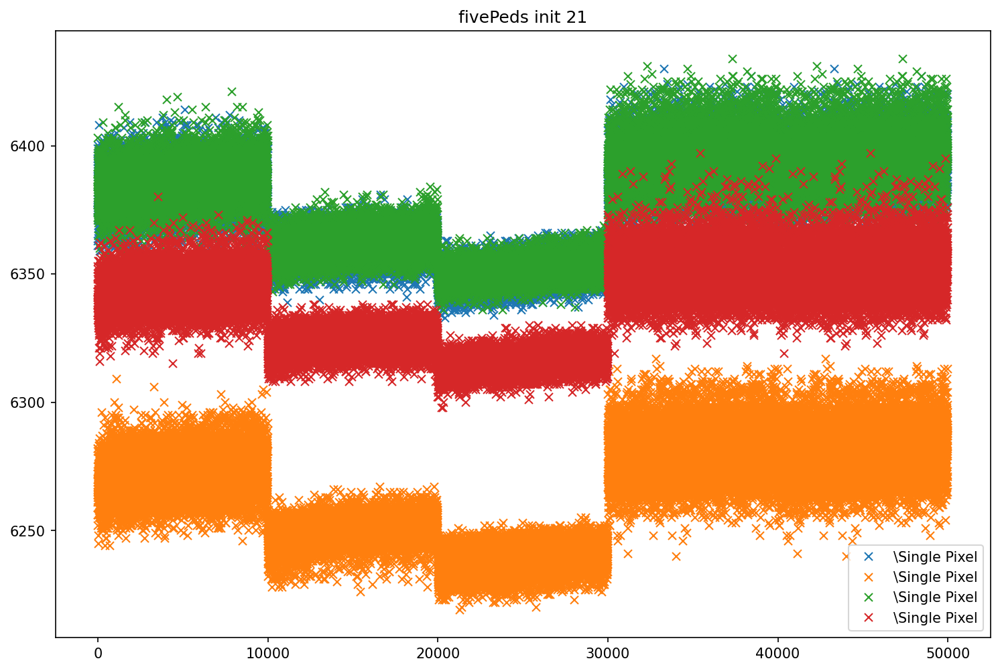

In [50]:
startIdx = 5000
stopIdx = 15000
mask = 0x3FFF
plt.figure(1,figsize=(12,8),dpi=150)
dataset = np.concatenate((FH[startIdx:stopIdx,10,10],FM[startIdx:stopIdx,10,10],np.bitwise_and(FL[startIdx:stopIdx,10,10], mask),AHL[startIdx:stopIdx,10,10],AHL[startIdx:stopIdx,10,10]),0)           
plt.plot(dataset, 'x', label=f'\Single Pixel') 
dataset = np.concatenate((FH[startIdx:stopIdx,10+32,10+32],FM[startIdx:stopIdx,10+32,10+32],np.bitwise_and(FL[startIdx:stopIdx,10+32,10+32], mask),AHL[startIdx:stopIdx,10+32,10+32],AHL[startIdx:stopIdx,10+32,10+32]),0) #
plt.plot(dataset, 'x', label=f'\Single Pixel') 
dataset = np.concatenate((FH[startIdx:stopIdx,10+32,10],FM[startIdx:stopIdx,10+32,10],np.bitwise_and(FL[startIdx:stopIdx,10+32,10], mask),AHL[startIdx:stopIdx,10+32,10],AHL[startIdx:stopIdx,10+32,10]),0) #
plt.plot(dataset, 'x', label=f'\Single Pixel') 
dataset = np.concatenate((FH[startIdx:stopIdx,10,10+32],FM[startIdx:stopIdx,10,10+32],np.bitwise_and(FL[startIdx:stopIdx,10,10+32], mask),AHL[startIdx:stopIdx,10,10+32],AHL[startIdx:stopIdx,10,10+32]),0) #
plt.plot(dataset, 'x', label=f'\Single Pixel') 

plt.title("fivePeds init %d" % (initSequence)) 
plt.legend()
plt.show()

# Baseline TEST all - Default

In [13]:
MAX_NUMBER_OF_FRAMES_PER_BATCH  = 1000
cameraType            = 'ePixHr10kTBatcher'
bitMask               = 0xffff
currentCam = cameras.Camera(cameraType = cameraType)
currentCam.bitMask = bitMask

Camera  ePixHr10kTBatcher  selected.


In [14]:
#Initialze the camera
#[routine, asic0, asic1, asic2, asic3]'
initSequence = 5
root.EpixHR.InitASIC([initSequence,0,0,1,0])
#points to the ASIC device under test
ASIC = root.EpixHR.Hr10kTAsic2
root.EpixHR.BatcherEventBuilder0.Blowoff.set(True)
root.EpixHR.BatcherEventBuilder0.Bypass.set(1)
root.EpixHR.BatcherEventBuilder1.Blowoff.set(False)
root.EpixHR.BatcherEventBuilder1.Bypass.set(1)
root.EpixHR.BatcherEventBuilder2.Blowoff.set(True)

Rysync ASIC started
Init ASIC script started
Loading MMCM configuration
/u1/ddoering/localGit/epix-hr-single-10k/software/notebooks/ASIC_V4/baseline/../../..//yml/ePixHr10kT_MMCM_320MHz.yml
Completed
Loading supply configuration
/u1/ddoering/localGit/epix-hr-single-10k/software/notebooks/ASIC_V4/baseline/../../..//yml/ePixHr10kT_PowerSupply_Enable.yml
Loading register control (waveforms) configuration
/u1/ddoering/localGit/epix-hr-single-10k/software/notebooks/ASIC_V4/baseline/../../..//yml/ePixHr10kT_RegisterControl_R0Width12us_AcqWidth24us_320MHz.yml
Loading packet registers
Disabling packet lanes for ASIC 0
Disabling packet lanes for ASIC 1
Disabling packet lanes for ASIC 3
/u1/ddoering/localGit/epix-hr-single-10k/software/notebooks/ASIC_V4/baseline/../../..//yml/ePixHr10kT_PacketRegisters.yml
Taking asic off of reset
Loading ASIC and timing configuration
Loading  /u1/ddoering/localGit/epix-hr-single-10k/software/notebooks/ASIC_V4/baseline/../../..//yml/ePixHr10kT_PLLBypass_248MHz_A

In [15]:
#Makes sure triggers are off
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.1)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(True)
time.sleep(10)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.1)


In [16]:
#use system with batcher and missing ASICs
root.EpixHR.SspLowSpeedDecoderReg.enable.set(True)
print ("Locked lanes: %x" % root.EpixHR.SspLowSpeedDecoderReg.Locked.get())
#Only ASIC 1 is available so disable the 6 lower lanes
root.EpixHR.PacketRegisters0.DisableLane.set(0x3FF)
root.EpixHR.PacketRegisters1.DisableLane.set(0xFC0)



Locked lanes: 3f000


In [17]:
print(ASIC.Preamp.get())
print(ASIC.Vld1_b.get())
print(ASIC.Pixel_CB.get())
print(ASIC.Filter_DAC.get())
print(ASIC.VRef_DAC.get())

4
1
4
38
53


In [22]:
print('DHG', ASIC.DHg.get())
print('RefGenB', ASIC.RefGenB.get())
print('RefGenC', ASIC.RefGenC.get())
print('S2D_1_b', ASIC.S2D_1_b.get())
print('shvc_DAC', ASIC.shvc_DAC.get())
print('S2dDacBias', ASIC.S2dDacBias.get())
DHg = True
RefGenB = 2 #3
RefGenC = 3 #2
S2D_1_b = 0
shvc_DAC = 23
S2dDacBias = 3
print("")
ASIC.DHg.set(DHg)  
ASIC.RefGenB.set(RefGenB)
ASIC.RefGenC.set(RefGenC)
ASIC.S2D_1_b.set(S2D_1_b)
ASIC.shvc_DAC.set(shvc_DAC)
ASIC.S2dDacBias.set(S2dDacBias)
print('DHG', ASIC.DHg.get())
print('RefGenB', ASIC.RefGenB.get())
print('RefGenC', ASIC.RefGenC.get())
print('S2D_1_b', ASIC.S2D_1_b.get())
print('shvc_DAC', ASIC.shvc_DAC.get())
print('S2dDacBias', ASIC.S2dDacBias.get())

DHG True
RefGenB 3
RefGenC 2
S2D_1_b 0
shvc_DAC 23
S2dDacBias 3

DHG True
RefGenB 2
RefGenC 3
S2D_1_b 0
shvc_DAC 23
S2dDacBias 3


Preamp 7
Vld1_b 0
Pixel_CB 7
Filter_DAC 17
VRef_DAC 58
Command executed :  <class 'pyrogue._Command.BaseCommand'> - ePixHr10kT.EpixHR.Hr10kTAsic2.ClearMatrix
The file does not exist
/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_5_Preamp_7_Vld1b_0_PixelCB_7_Filter_DAC_17_VRrefdac_58_DHg_1_RefGenB_2_RefGenC_3_peds_12_trbit_1_run1.dat
Aquisition Counter 4679180
DAQ Counter 4208800
Number of frames received: 50047
Number of frames received: 52049
Delta Aquisition Counter: 54052
Number of frames received: 54052
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 2
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56072)
(145, 384)


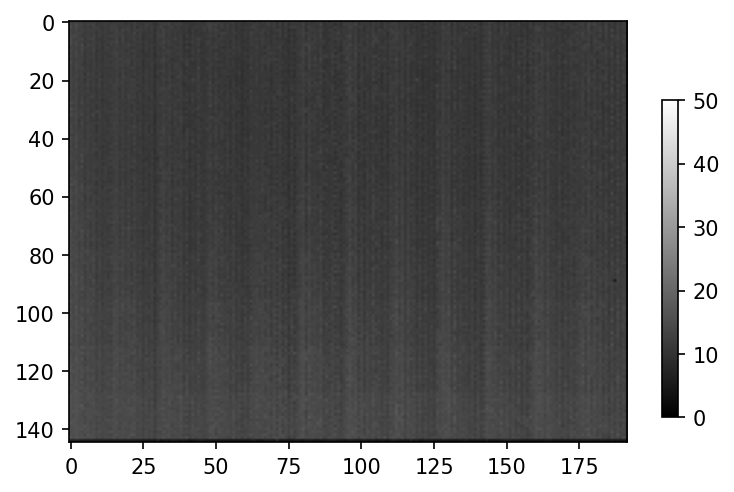

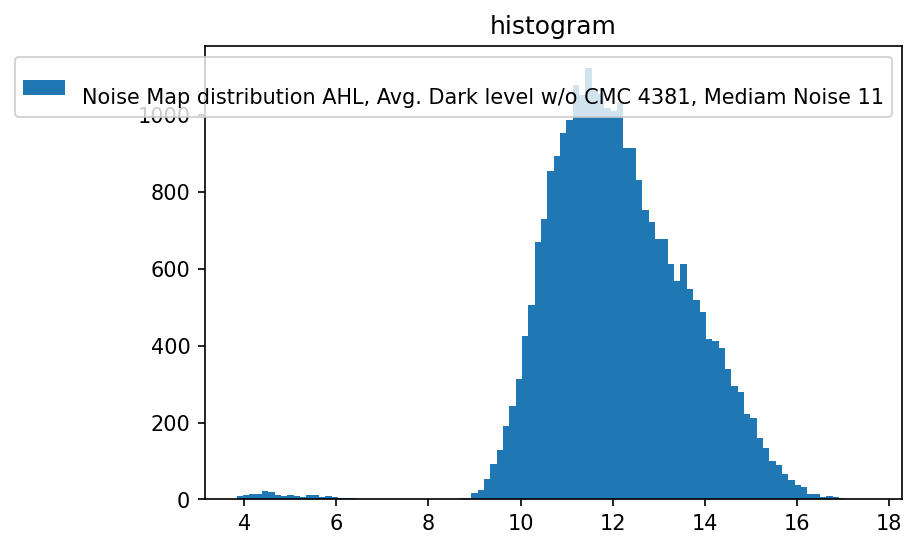

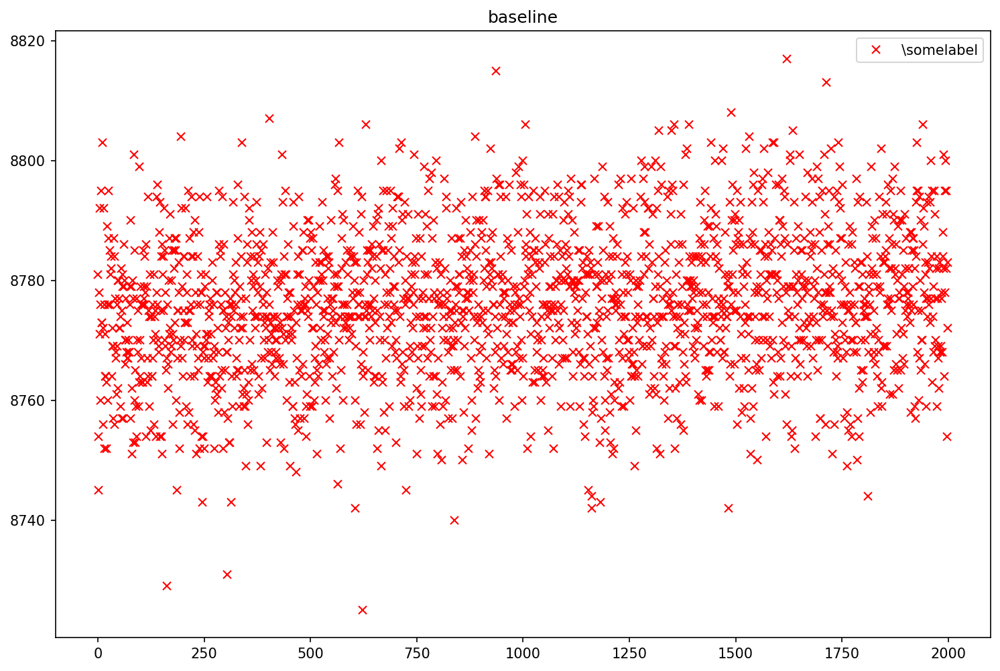

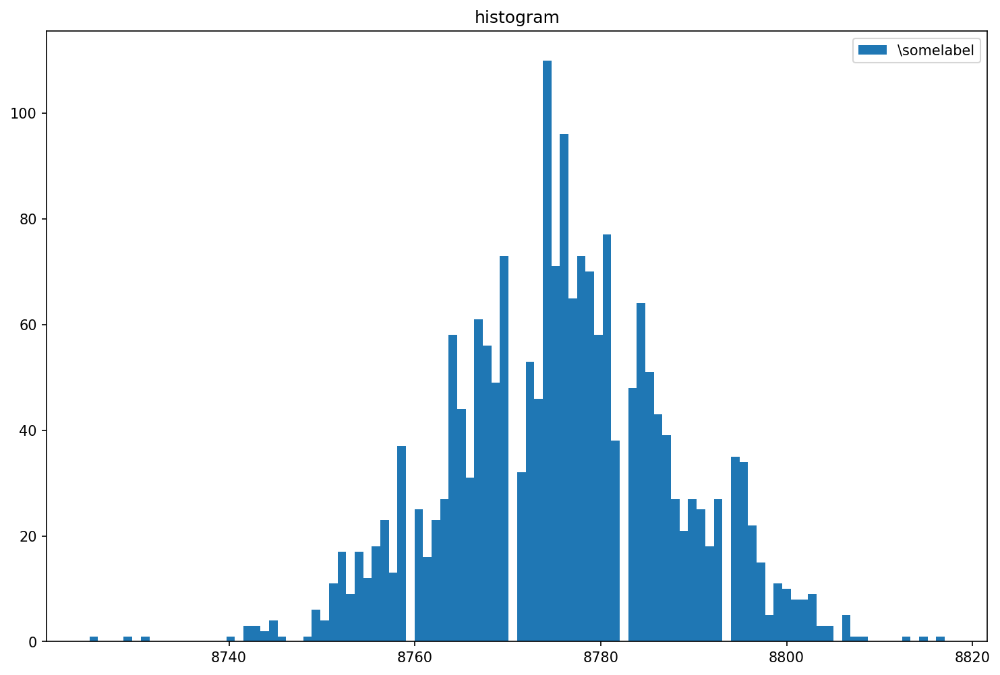

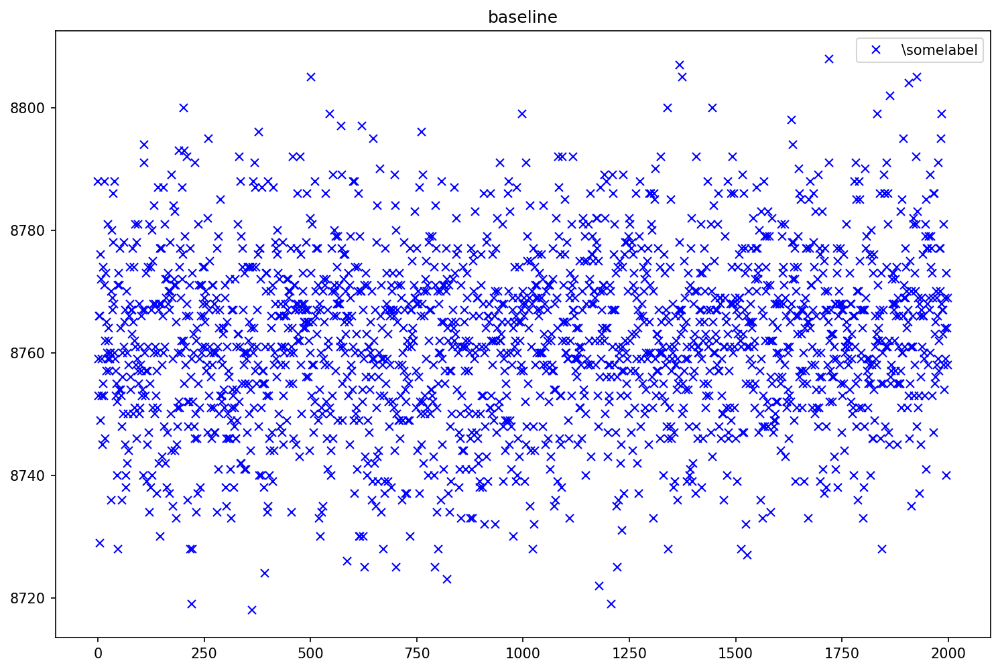

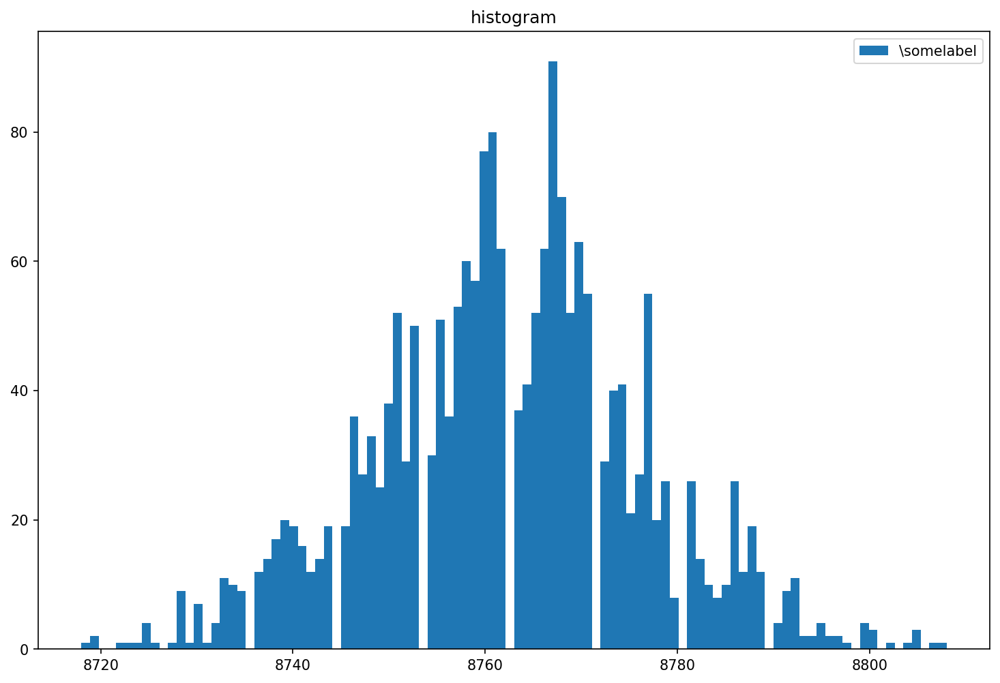

(145, 384)


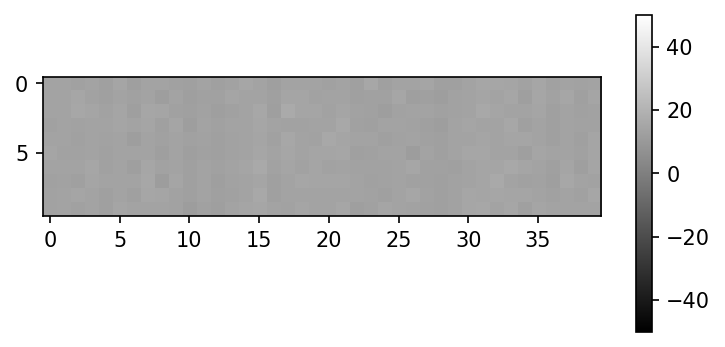

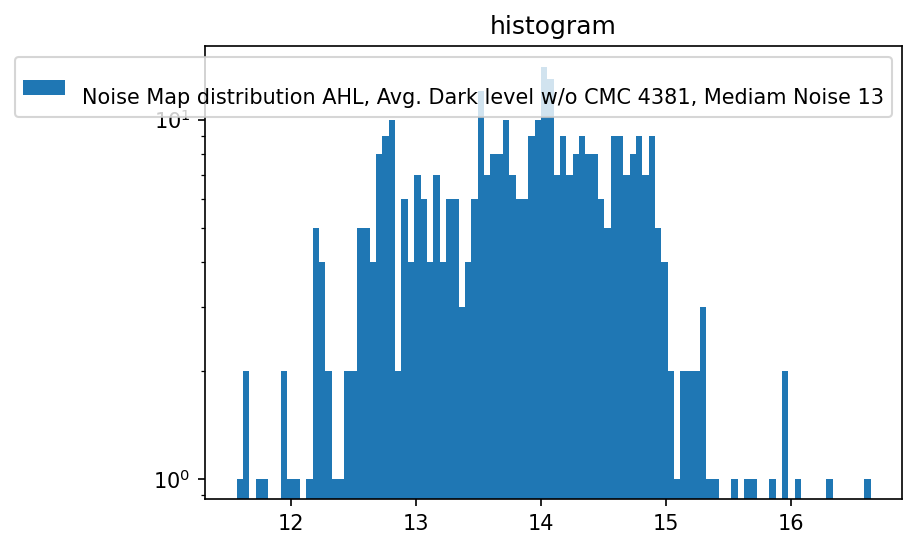


(145, 384)


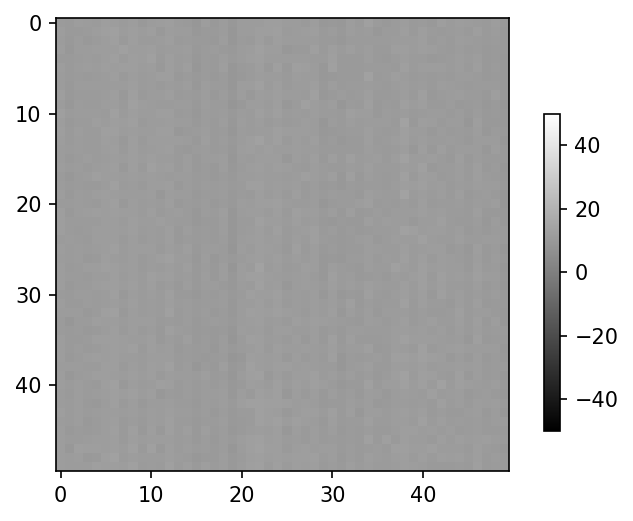

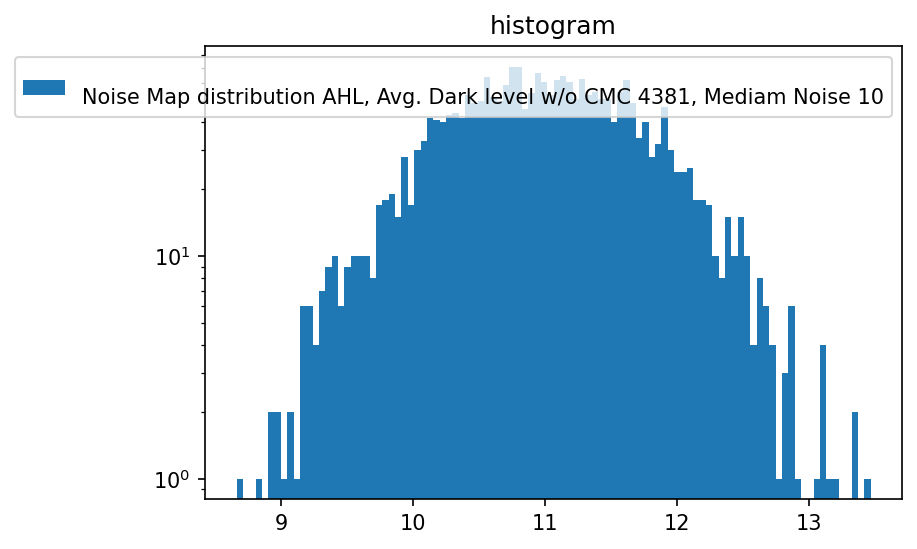


/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_5_Preamp_7_Vld1b_0_PixelCB_7_Filter_DAC_17_VRrefdac_58_DHg_1_RefGenB_2_RefGenC_3_peds_12_trbit_1_run1.dat
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 2
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 3
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 4
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 5
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 6
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get 

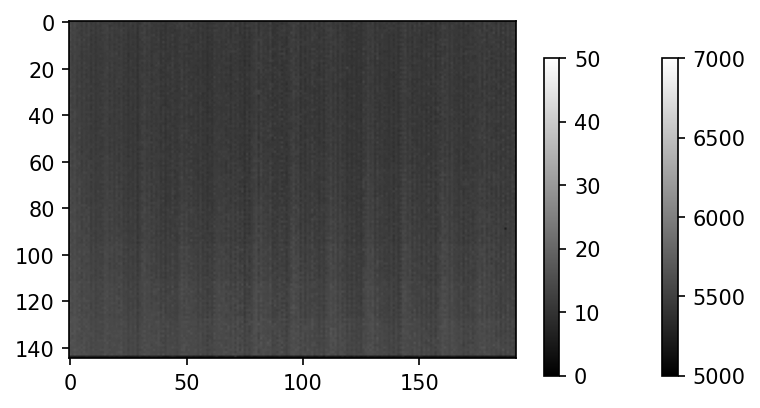

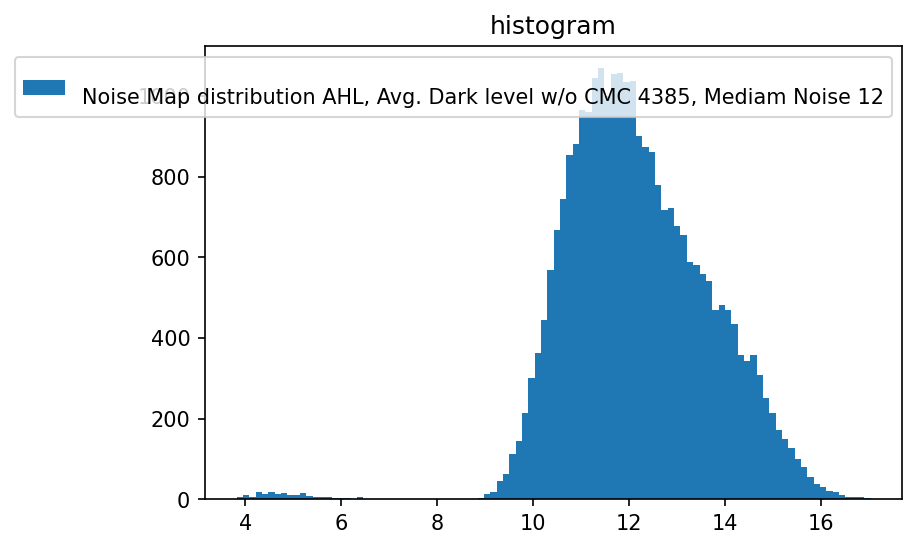

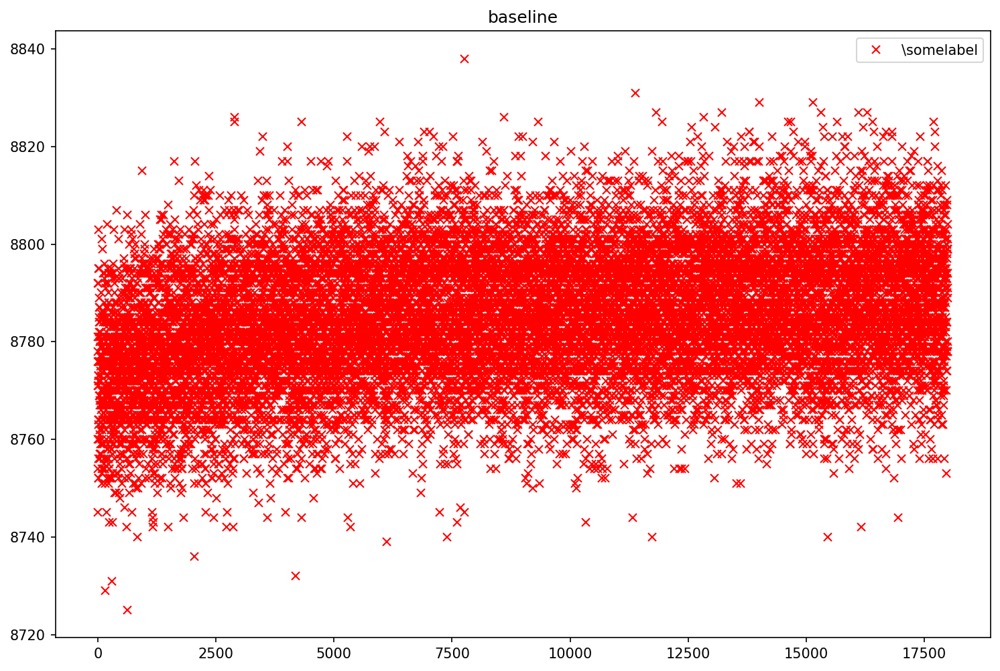

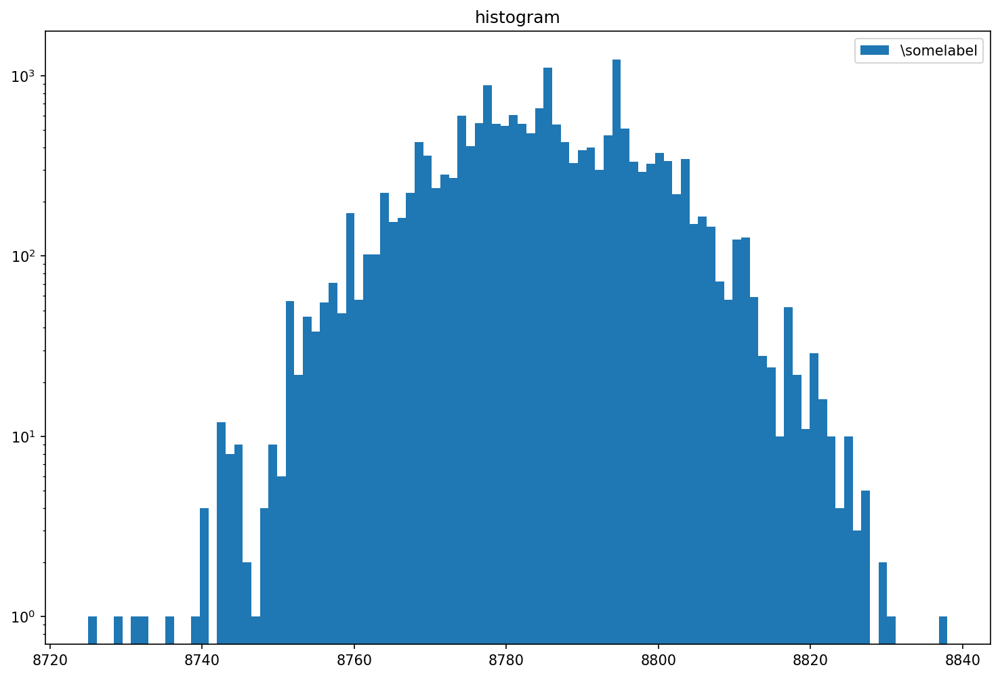

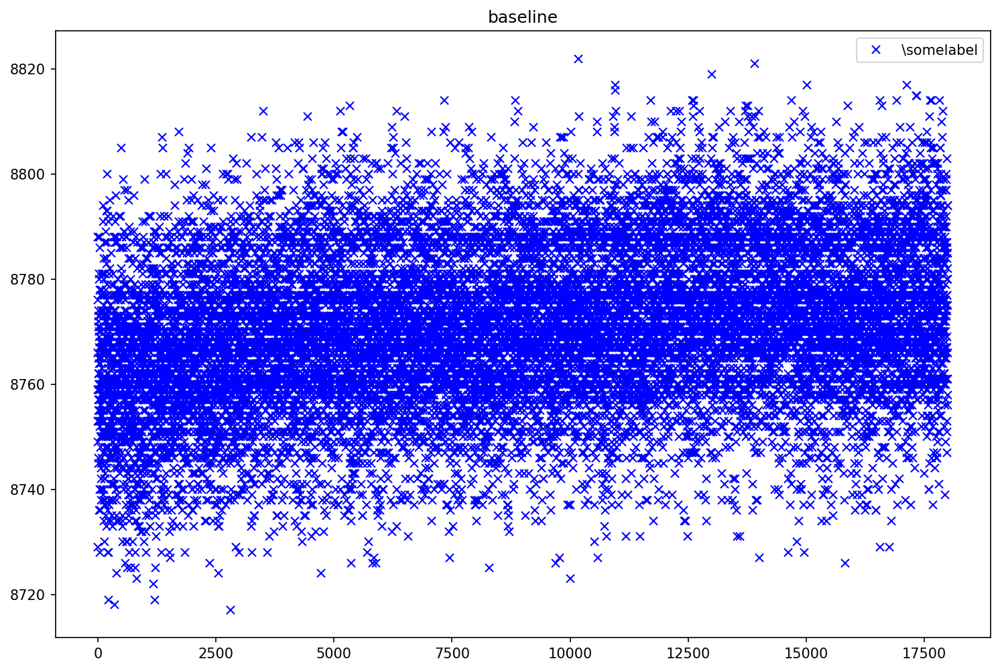

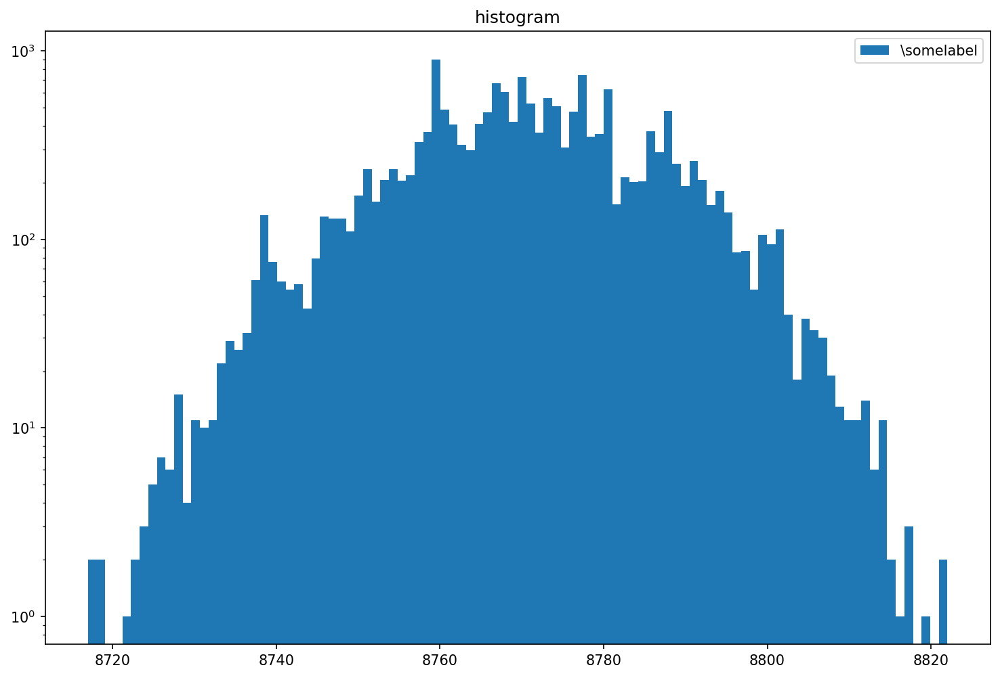

(145, 384)


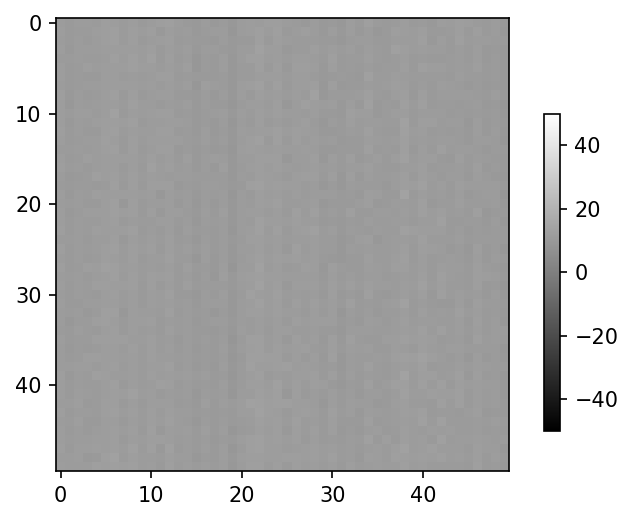

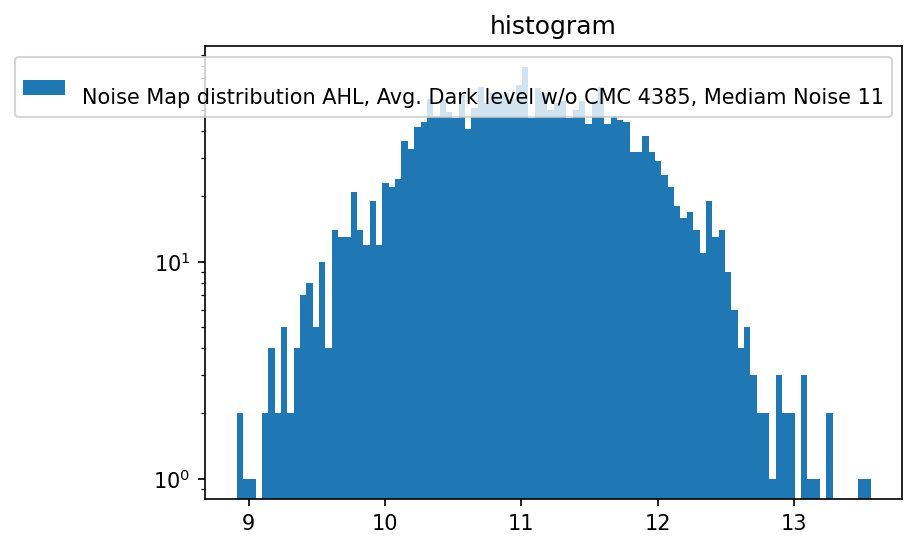


Camera  ePixHr10kTBatcher  selected.
Command executed :  <class 'pyrogue._Command.BaseCommand'> - ePixHr10kT.EpixHR.Hr10kTAsic2.ClearMatrix
The file does not exist
/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_5_Preamp_7_Vld1b_0_PixelCB_7_Filter_DAC_17_VRrefdac_58_DHg_1_RefGenB_2_RefGenC_3_peds_12_trbit_0_run1.dat
Aquisition Counter 4733232
DAQ Counter 4262852
Number of frames received: 50033
Number of frames received: 52033
Delta Aquisition Counter: 54036
Number of frames received: 54036
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 2
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56072)
(145, 384)


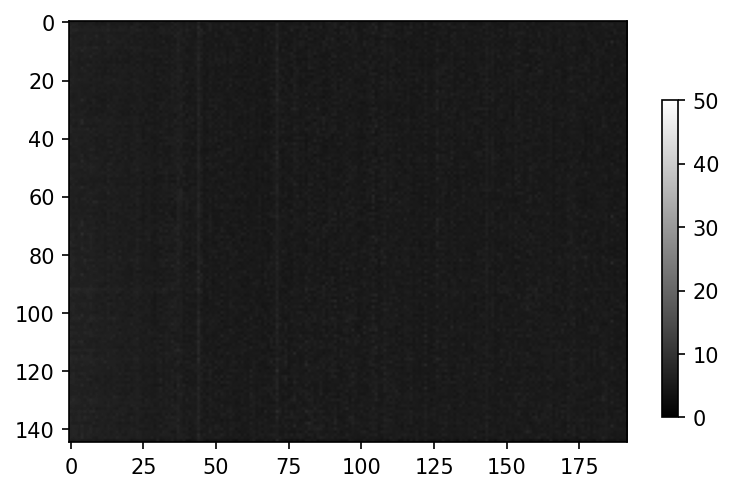

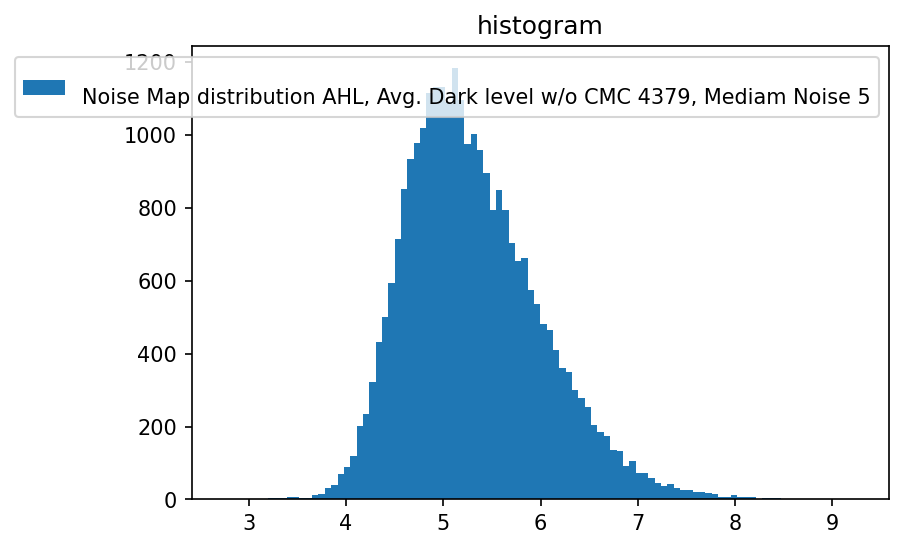

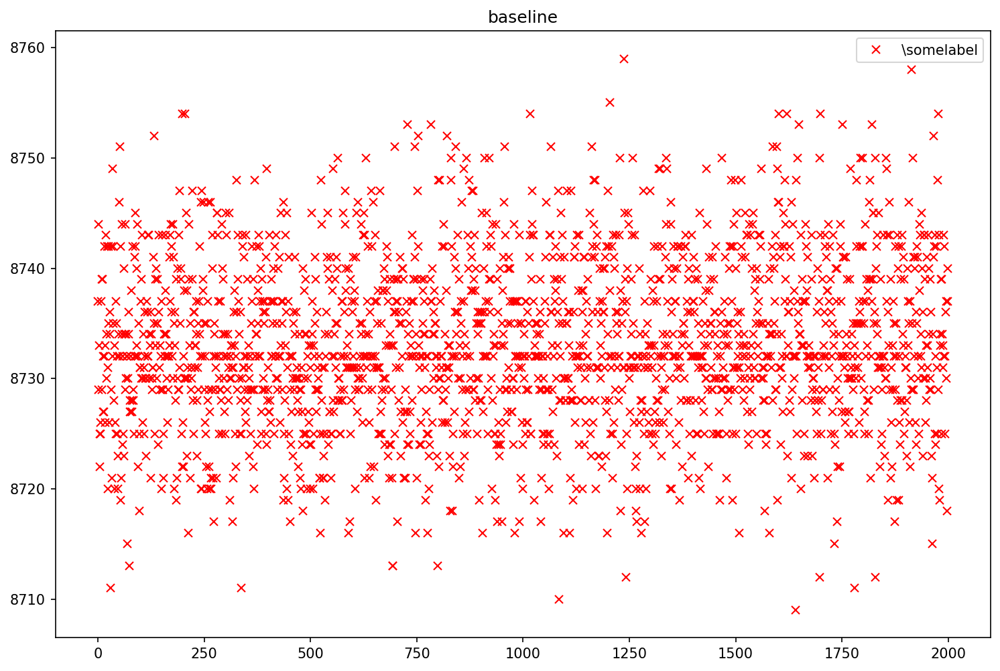

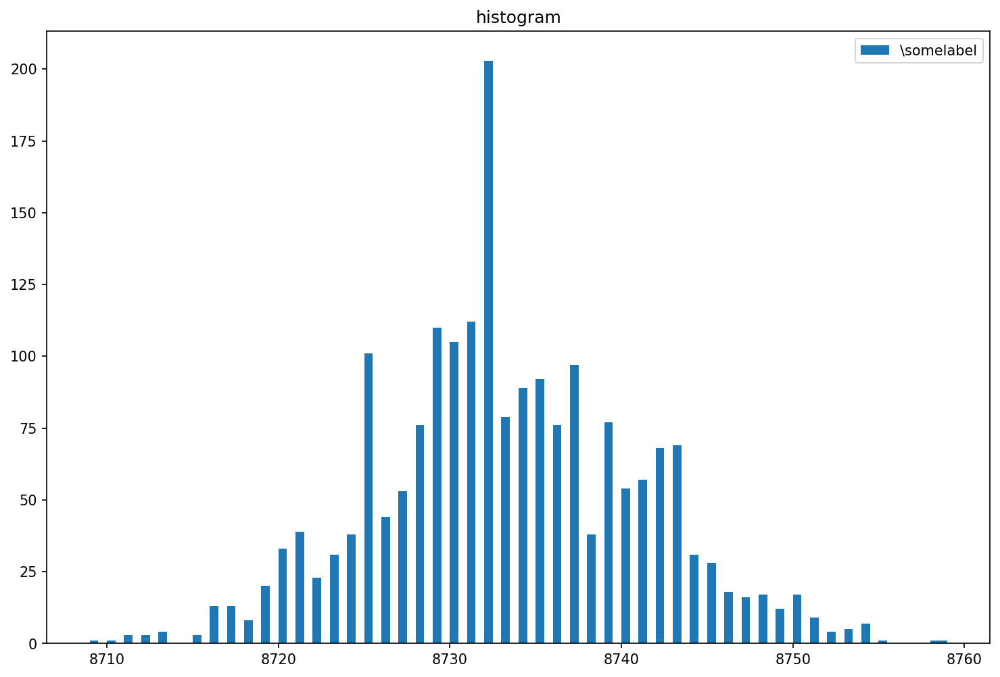

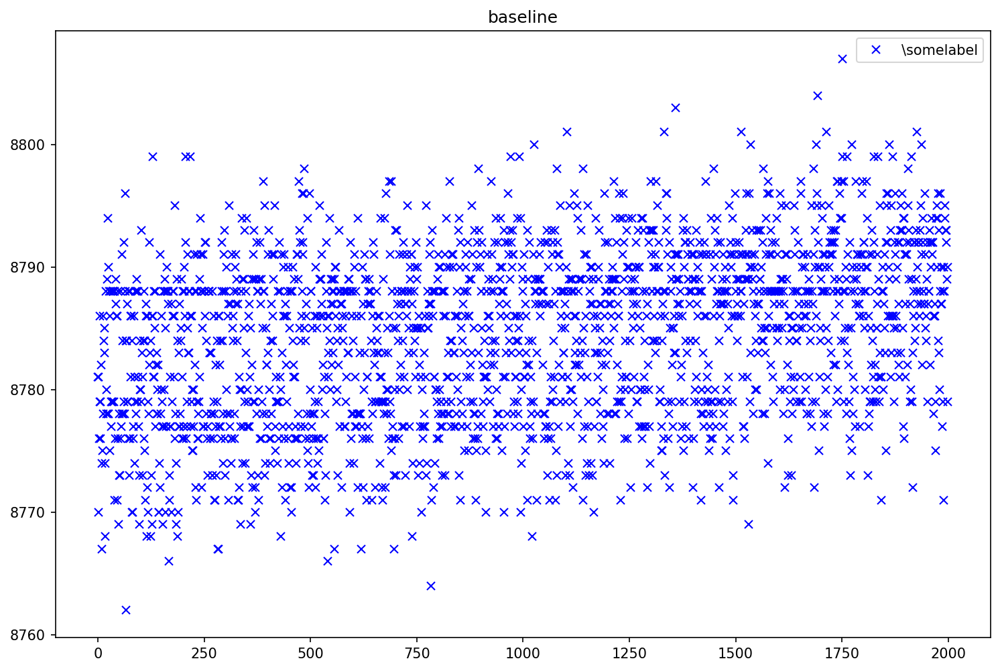

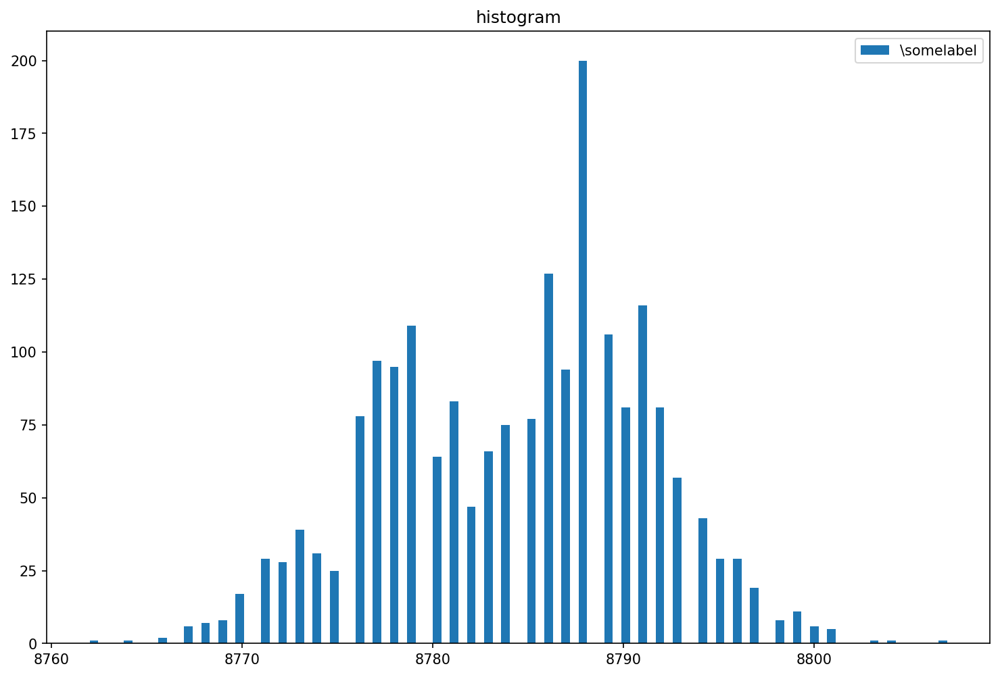

(145, 384)


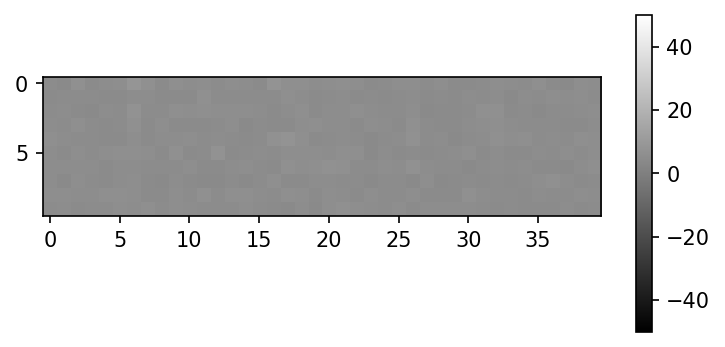

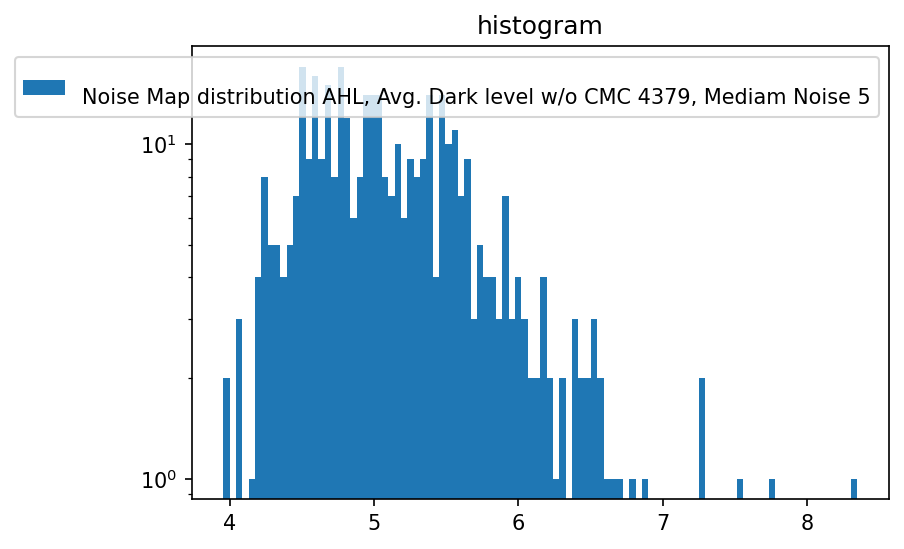


(145, 384)


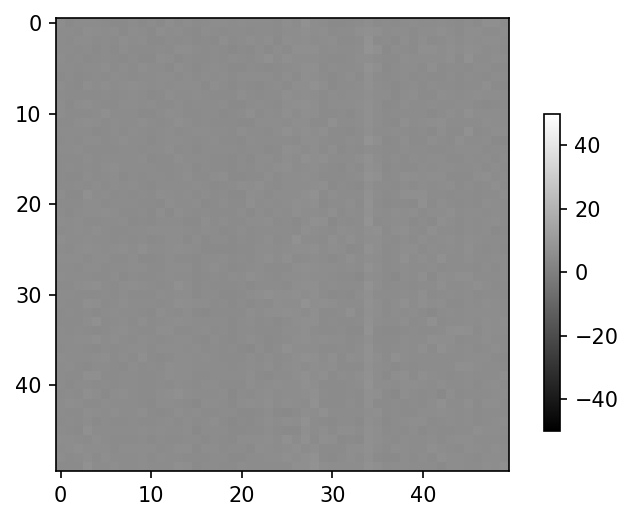

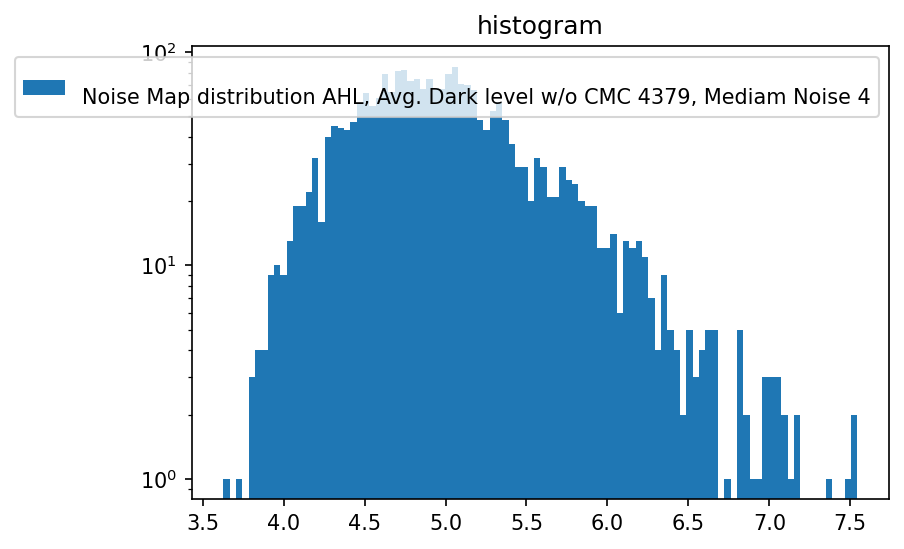


/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_5_Preamp_7_Vld1b_0_PixelCB_7_Filter_DAC_17_VRrefdac_58_DHg_1_RefGenB_2_RefGenC_3_peds_12_trbit_0_run1.dat
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 2
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 3
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 4
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 5
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 6
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get 

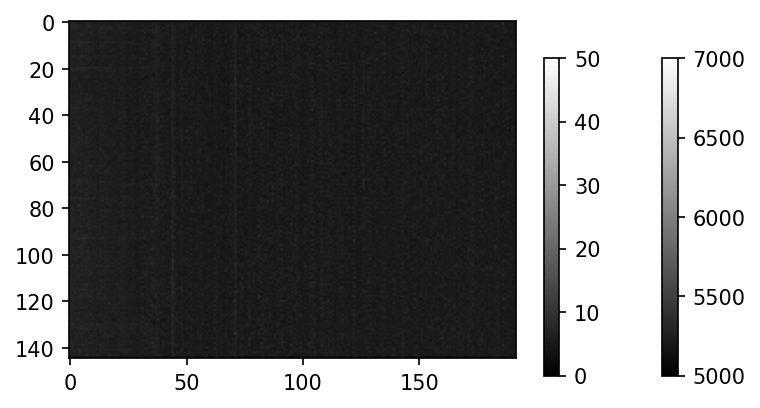

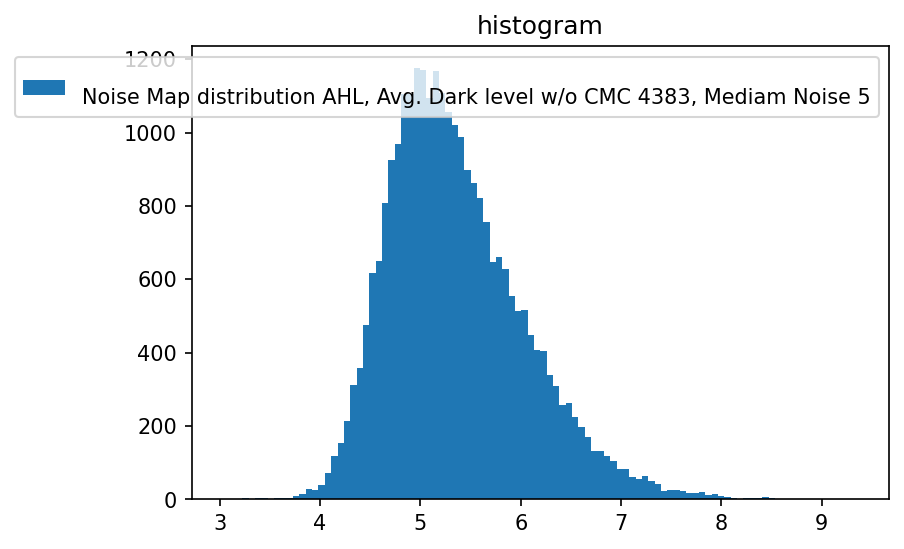

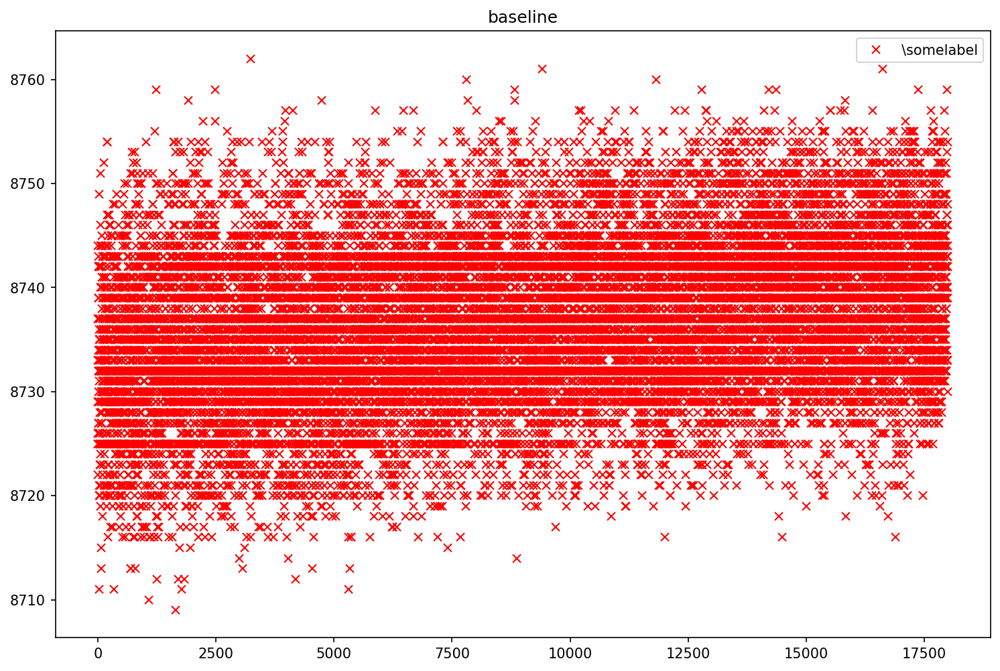

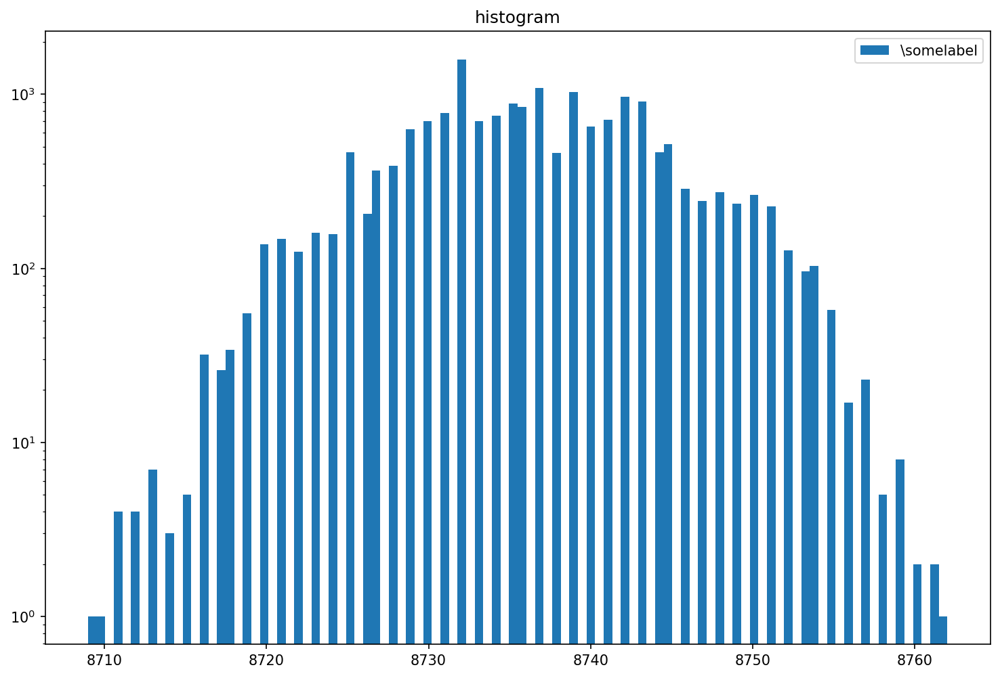

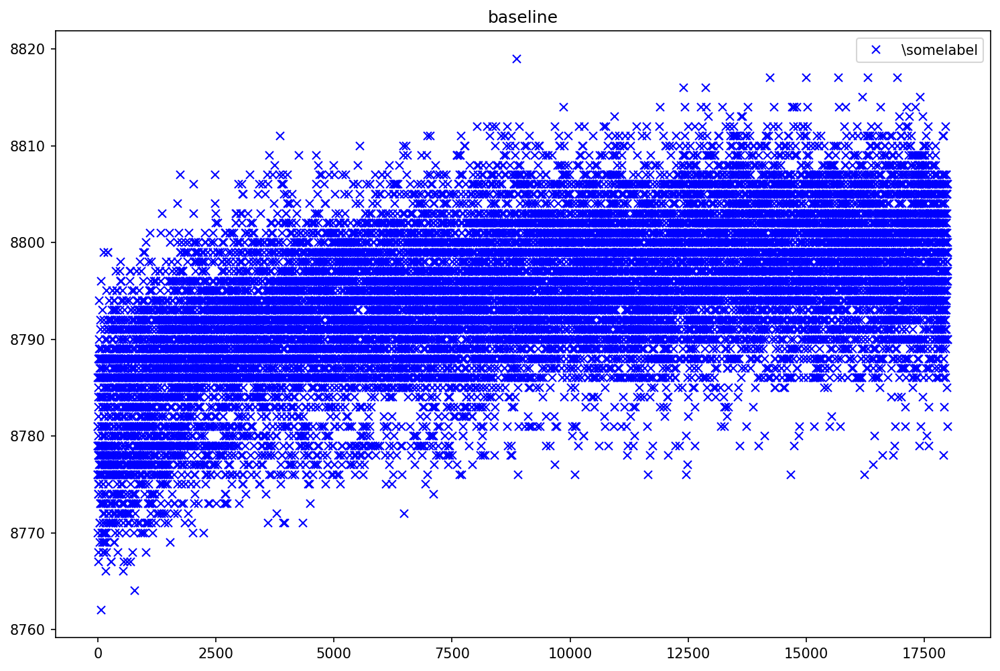

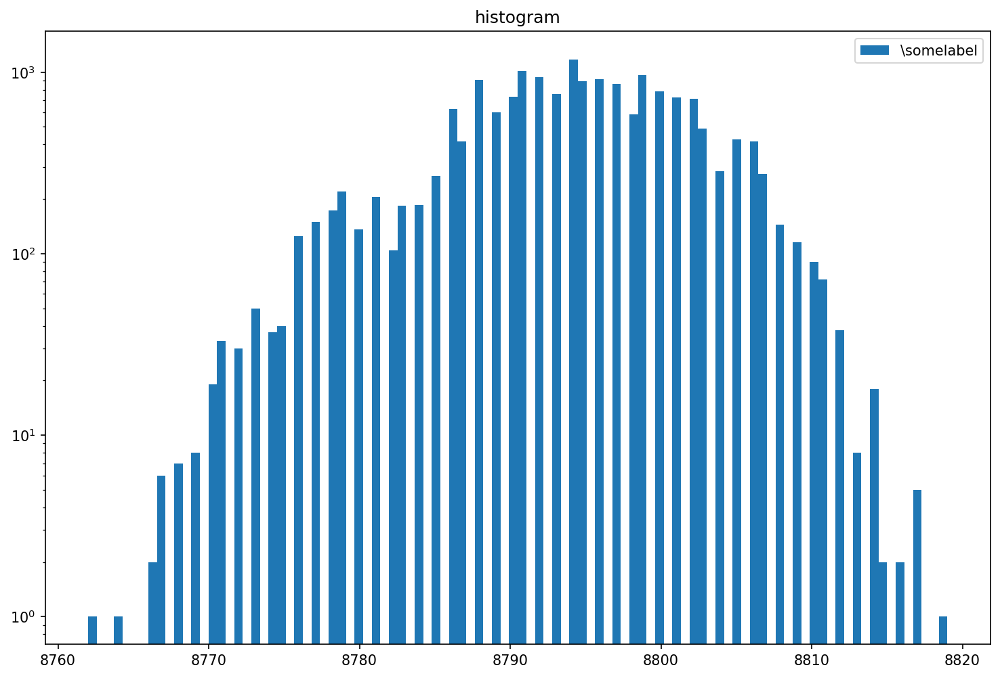

(145, 384)


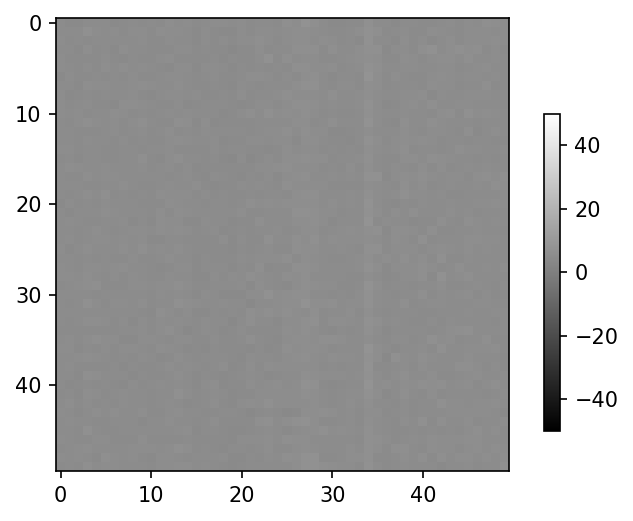

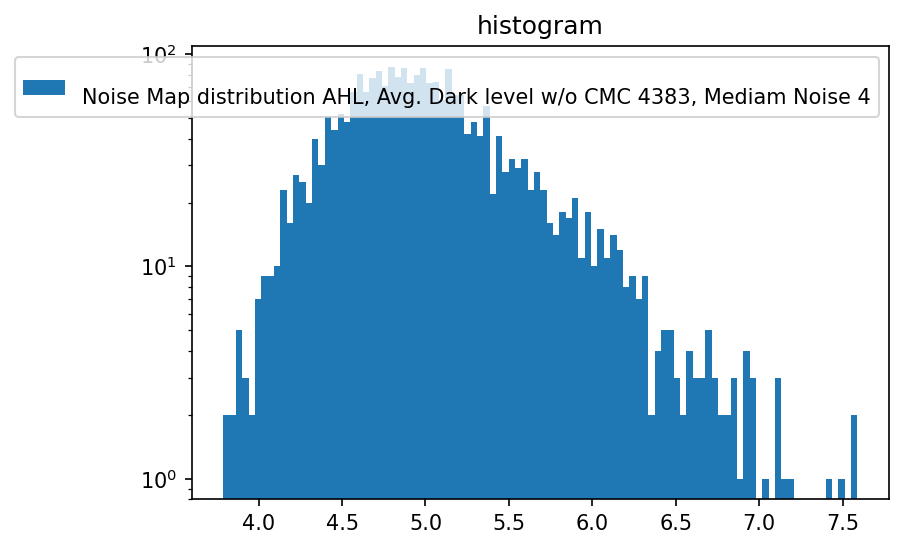


Camera  ePixHr10kTBatcher  selected.
Command executed :  <class 'pyrogue._Command.BaseCommand'> - ePixHr10kT.EpixHR.Hr10kTAsic2.ClearMatrix
The file does not exist
/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_5_Preamp_7_Vld1b_0_PixelCB_7_Filter_DAC_17_VRrefdac_58_DHg_1_RefGenB_2_RefGenC_3_peds_8_trbit_0_run1.dat
Aquisition Counter 4787268
DAQ Counter 4316888
Number of frames received: 50042
Number of frames received: 52045
Delta Aquisition Counter: 54048
Number of frames received: 54048
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 2
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56072)
(145, 384)


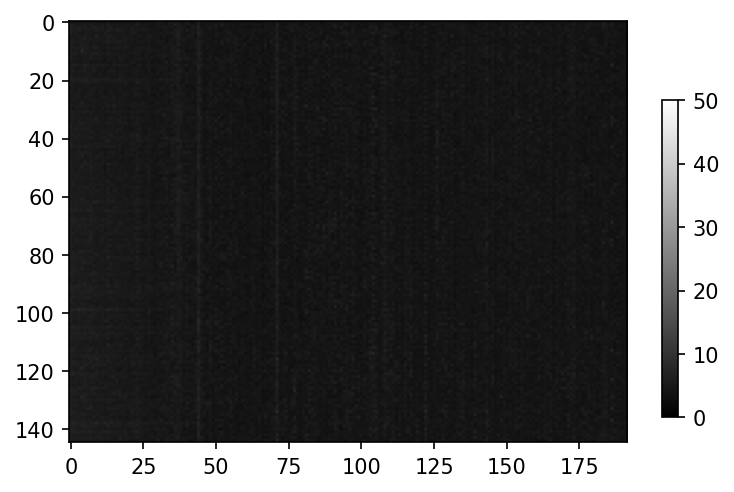

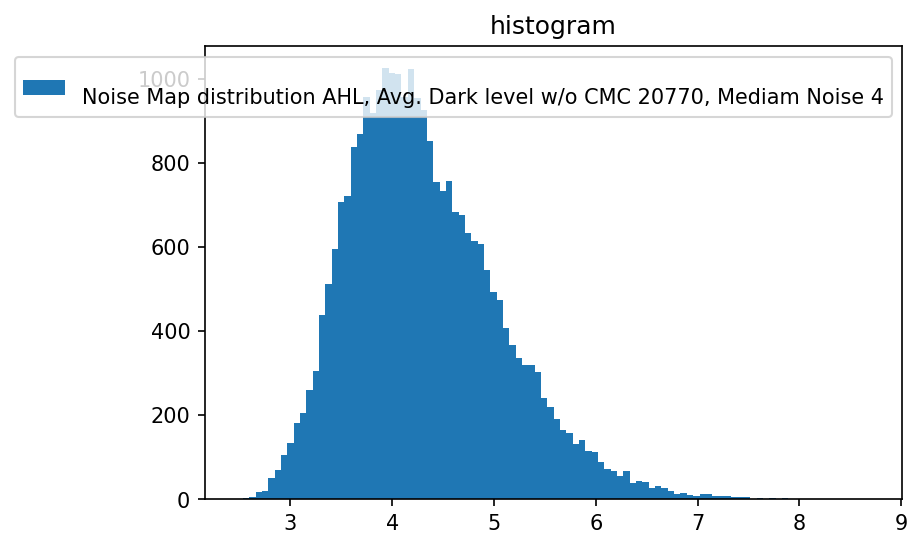

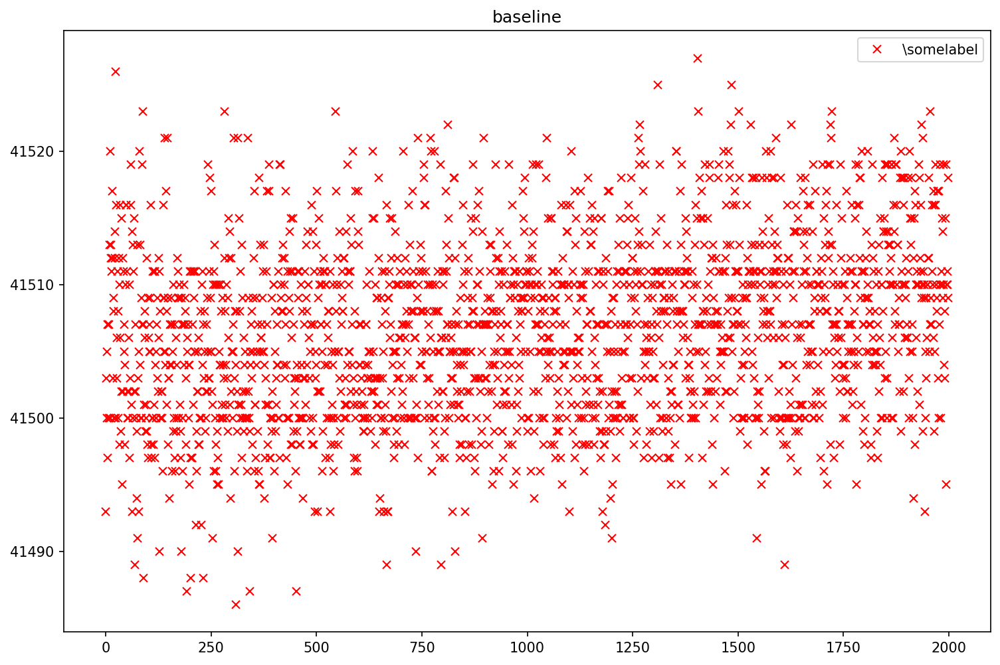

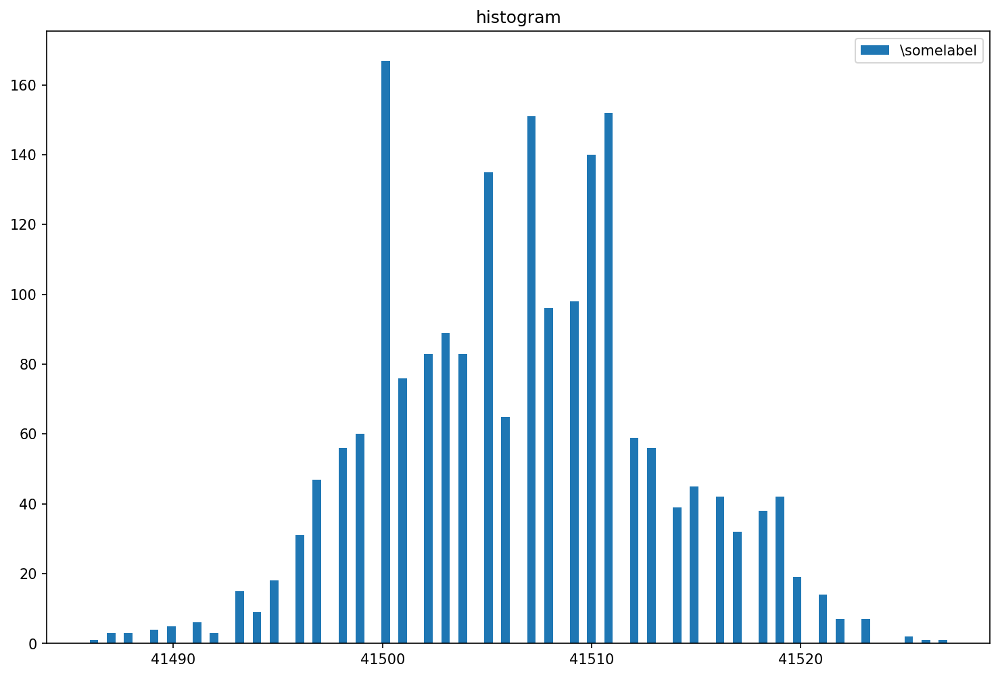

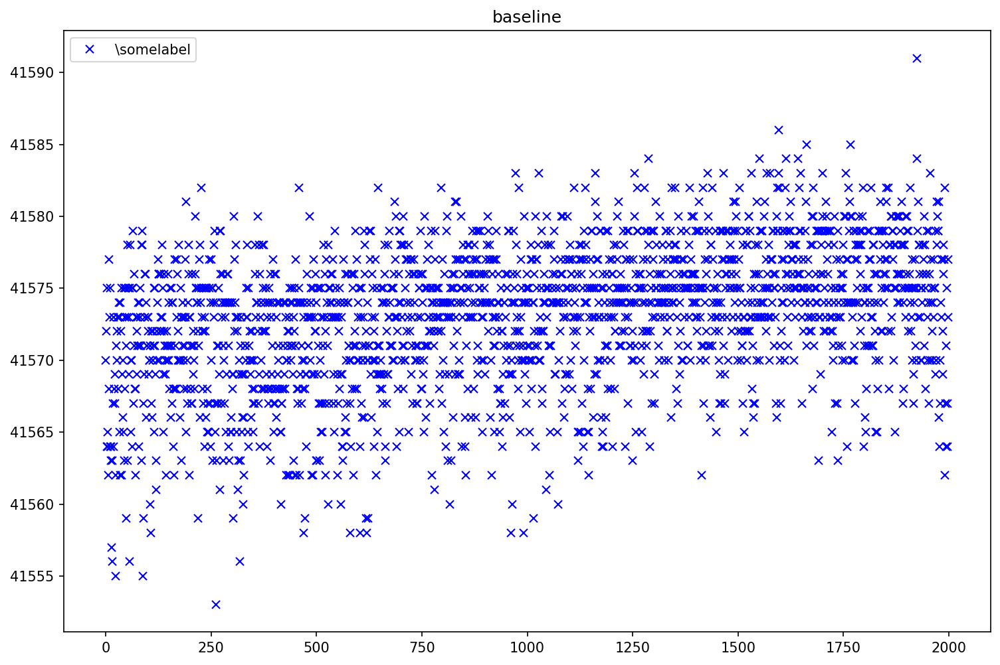

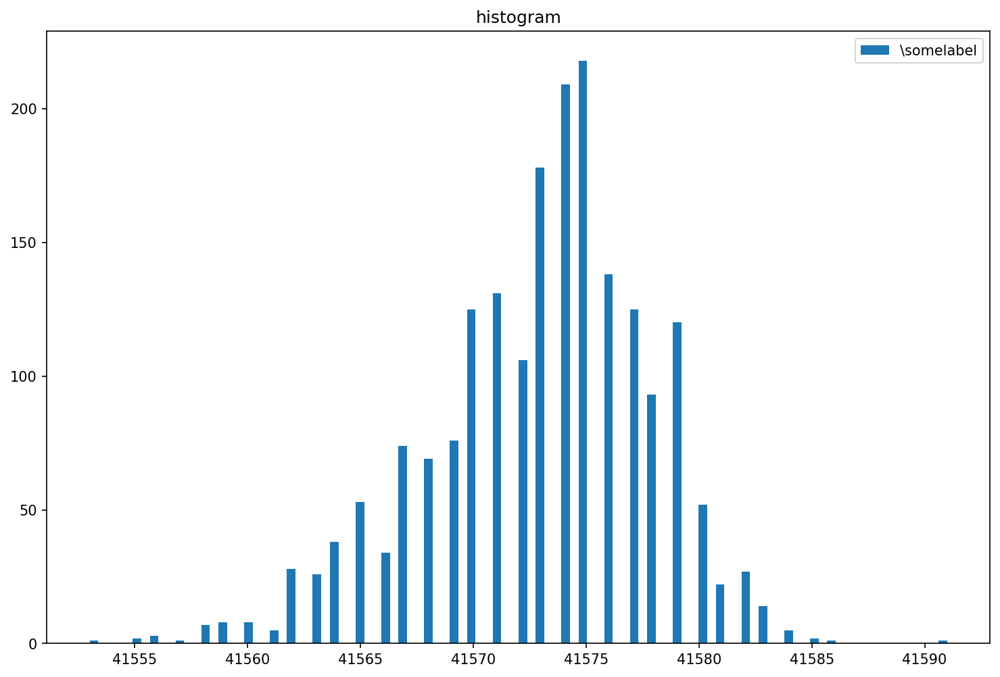

(145, 384)


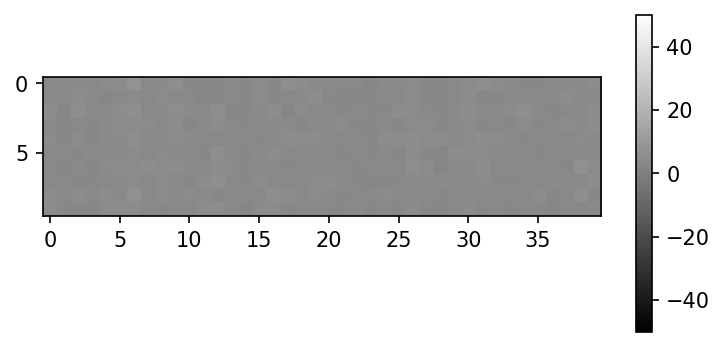

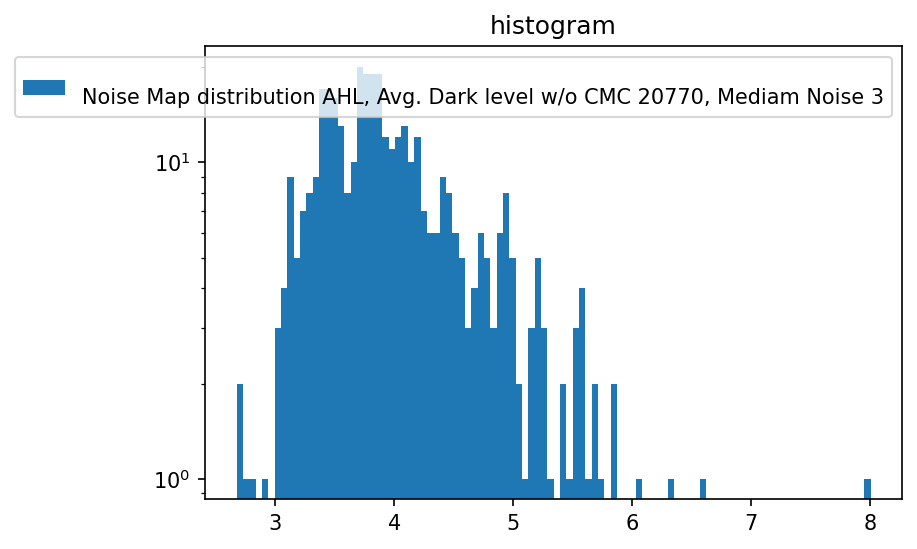


(145, 384)


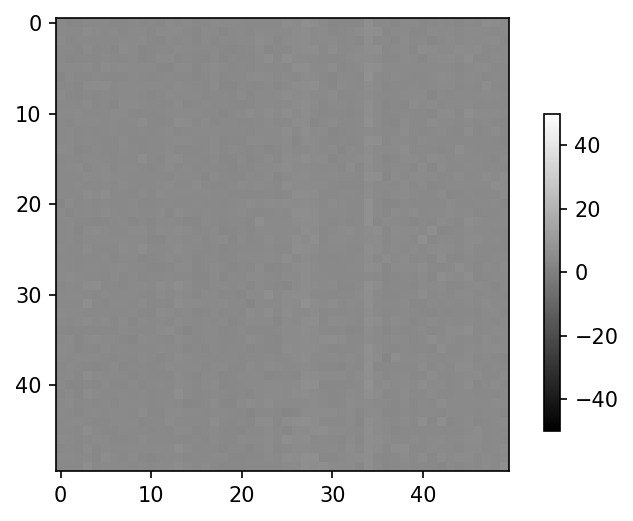

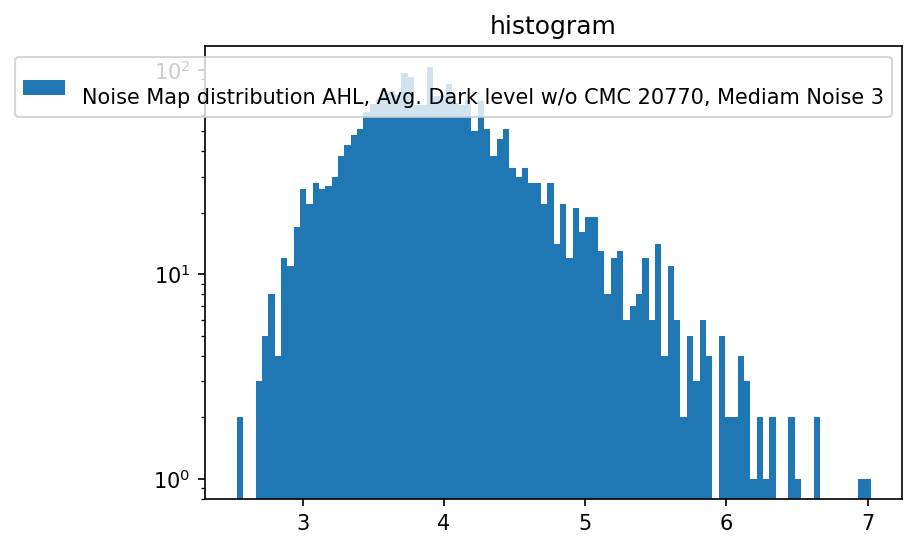


/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_5_Preamp_7_Vld1b_0_PixelCB_7_Filter_DAC_17_VRrefdac_58_DHg_1_RefGenB_2_RefGenC_3_peds_8_trbit_0_run1.dat
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 2
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 3
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 4
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 5
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 6
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get d

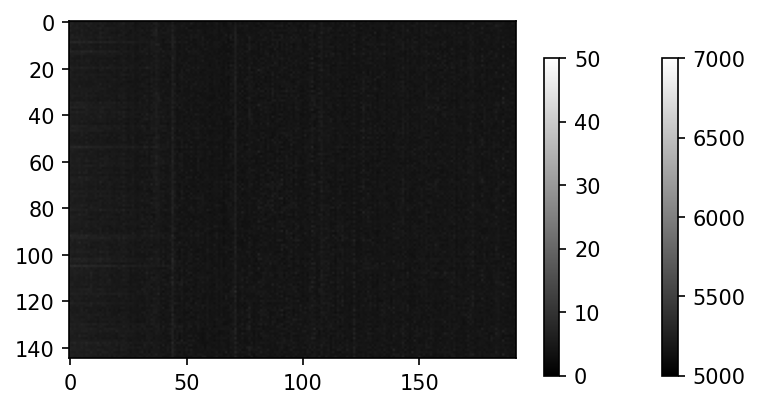

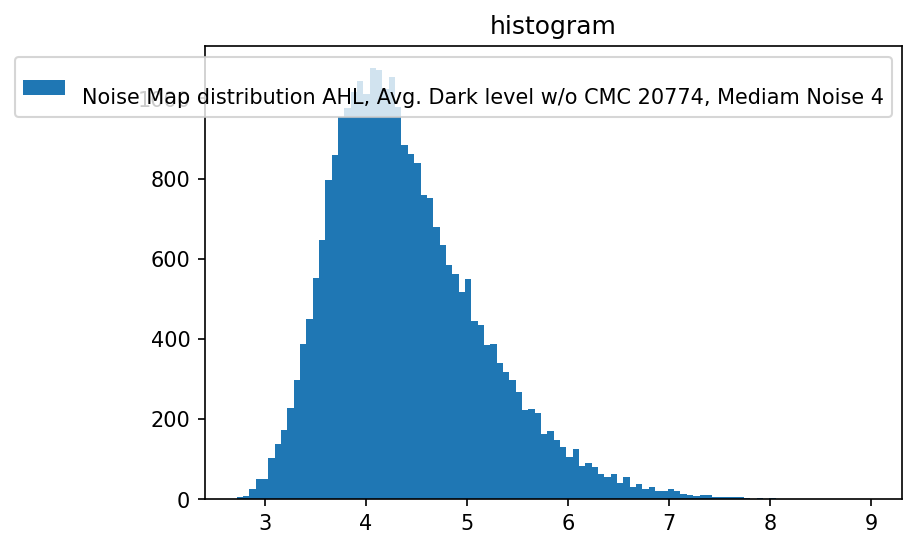

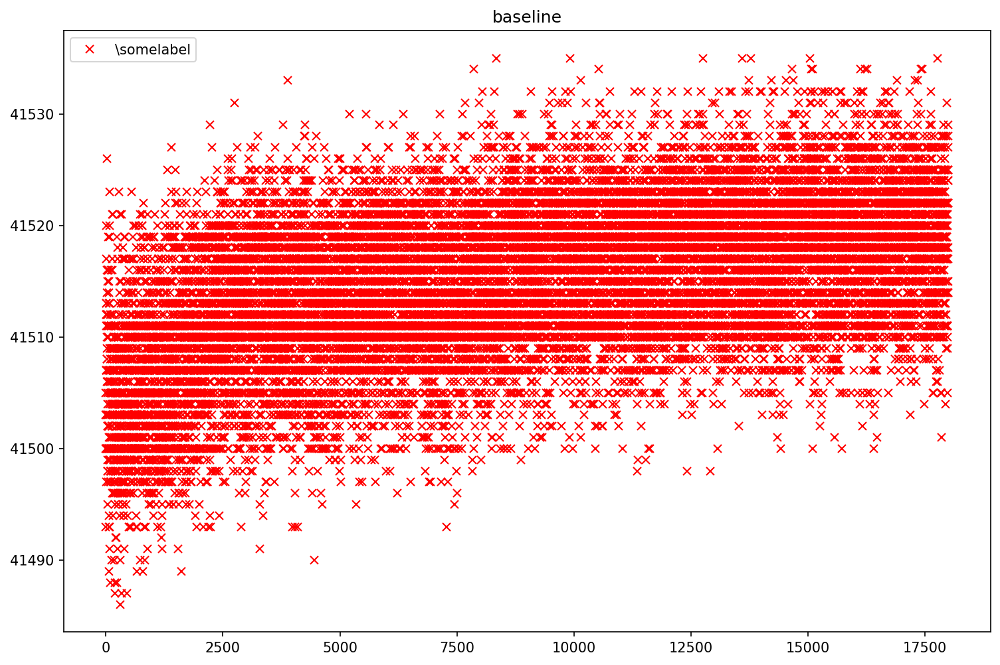

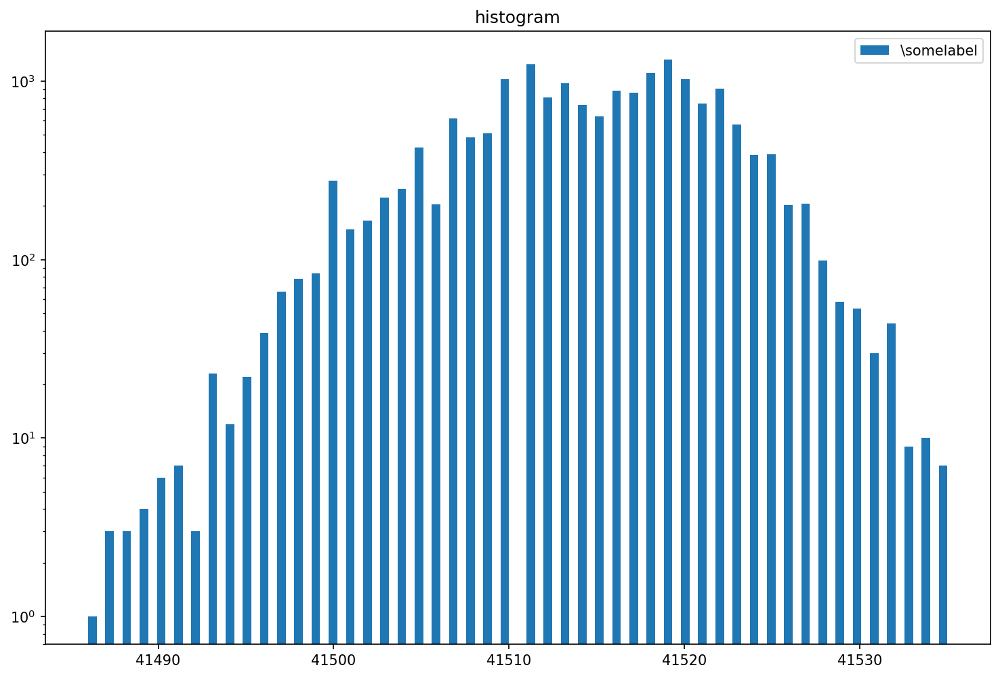

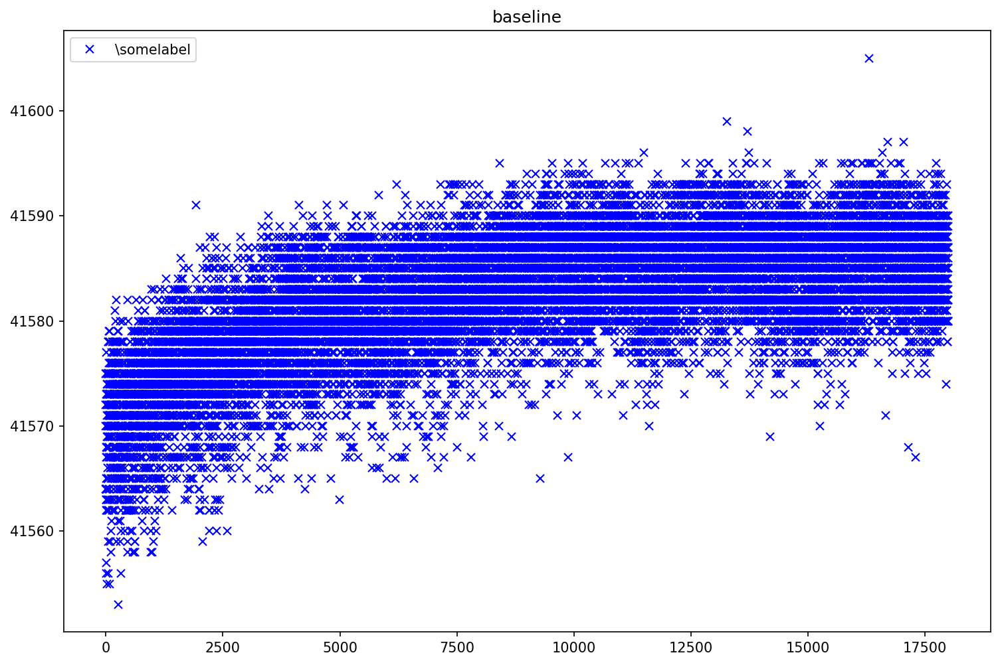

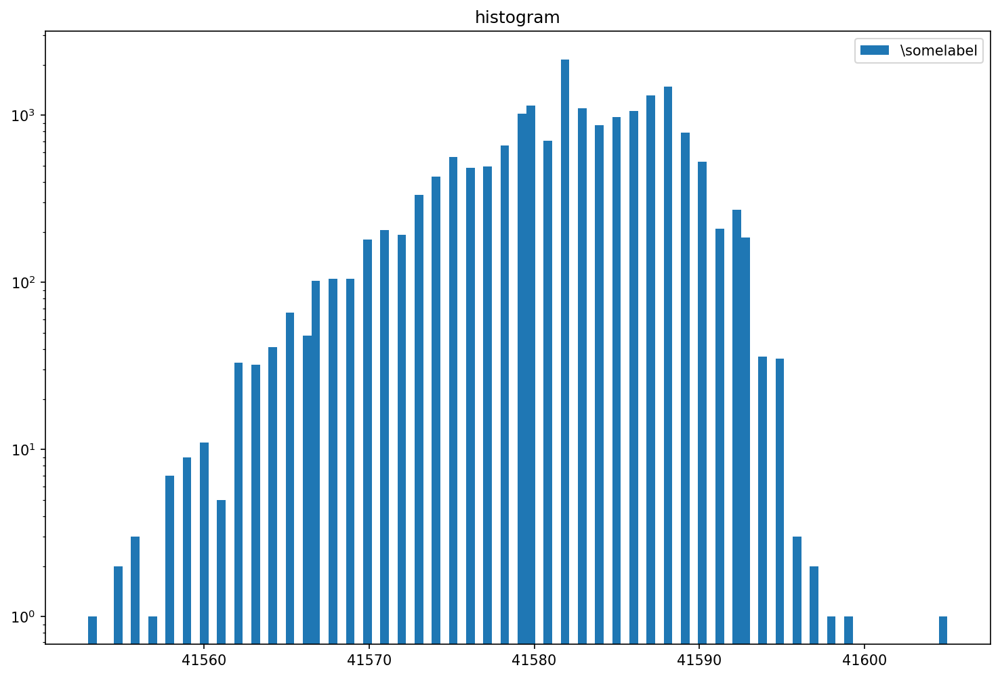

(145, 384)


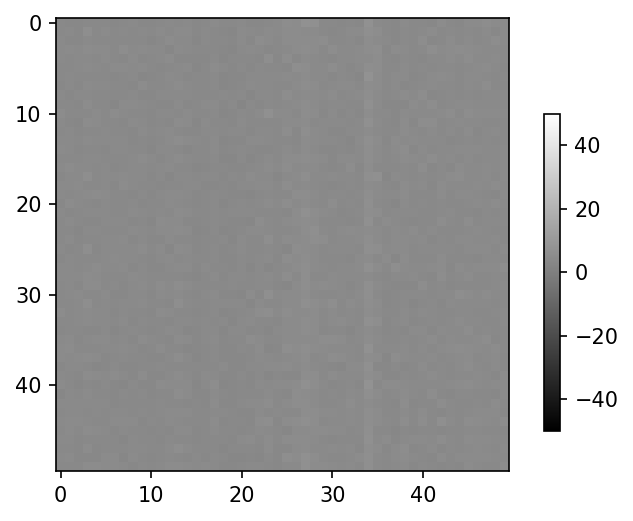

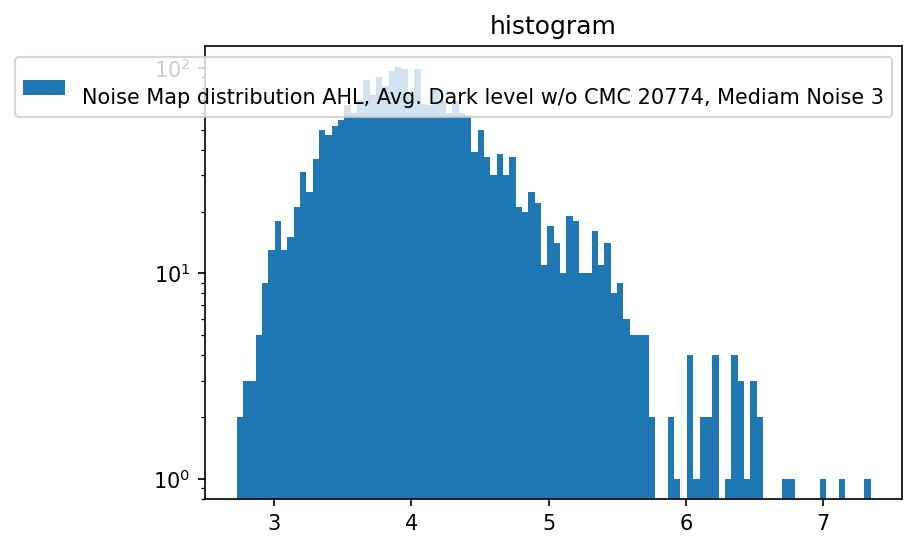


Camera  ePixHr10kTBatcher  selected.
Command executed :  <class 'pyrogue._Command.BaseCommand'> - ePixHr10kT.EpixHR.Hr10kTAsic2.ClearMatrix
The file does not exist
/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_5_Preamp_7_Vld1b_0_PixelCB_7_Filter_DAC_17_VRrefdac_58_DHg_1_RefGenB_2_RefGenC_3_peds_0_trbit_1_run1.dat
Aquisition Counter 4841316
DAQ Counter 4370936
Number of frames received: 50044
Number of frames received: 52046
Delta Aquisition Counter: 54048
Number of frames received: 54048
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 2
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56072)
(145, 384)


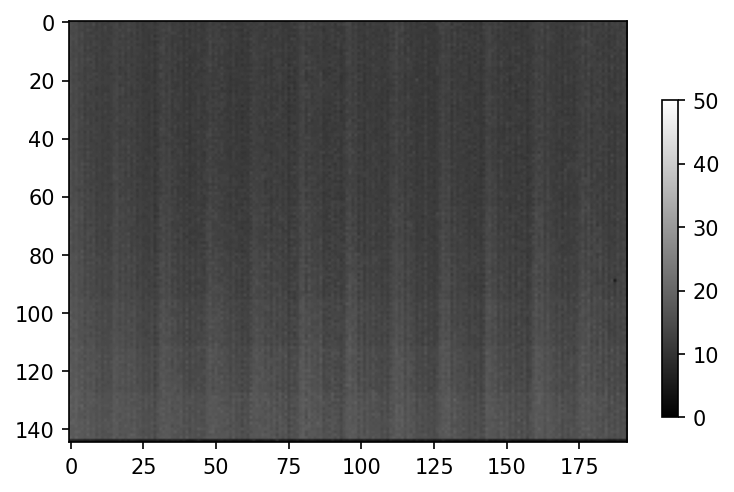

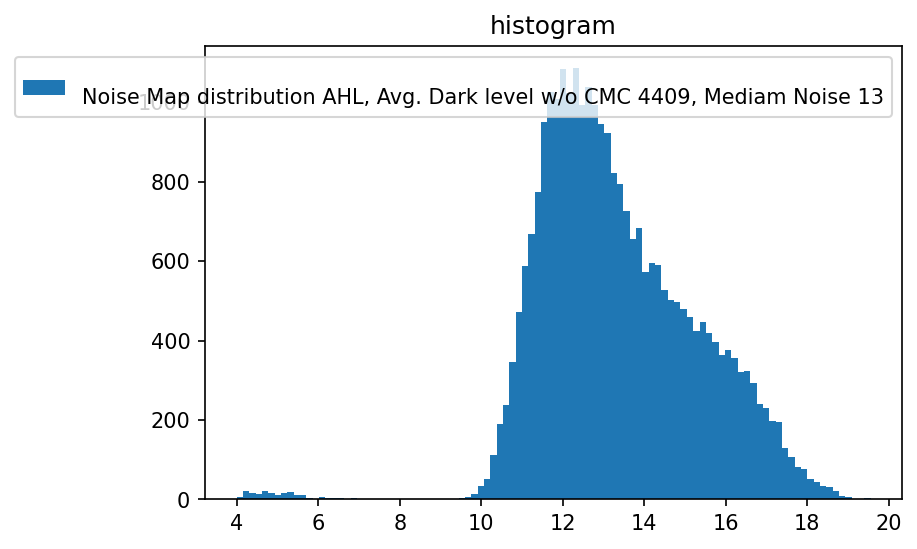

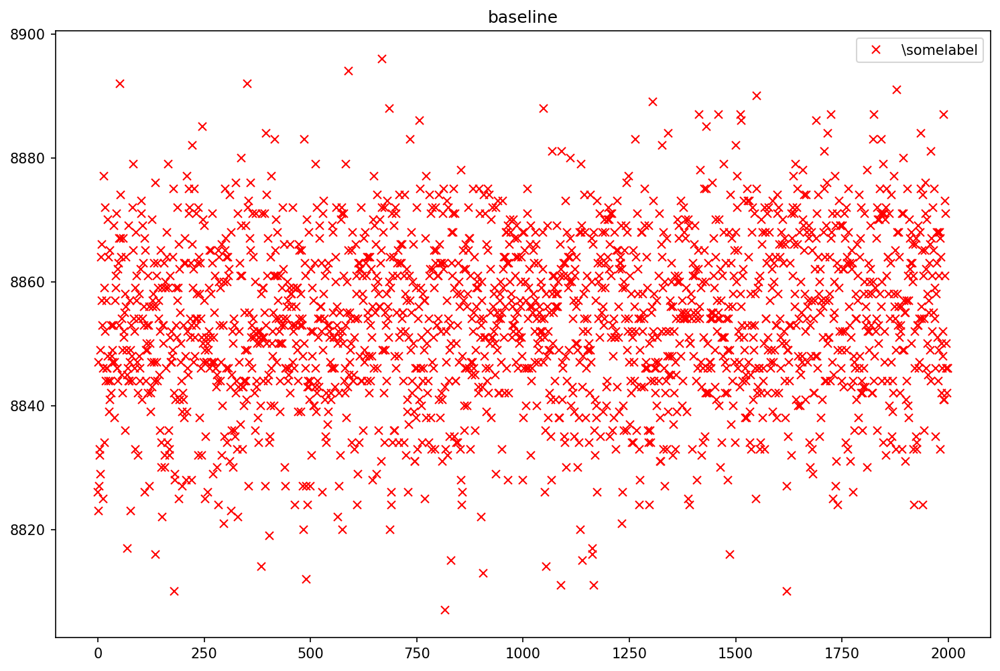

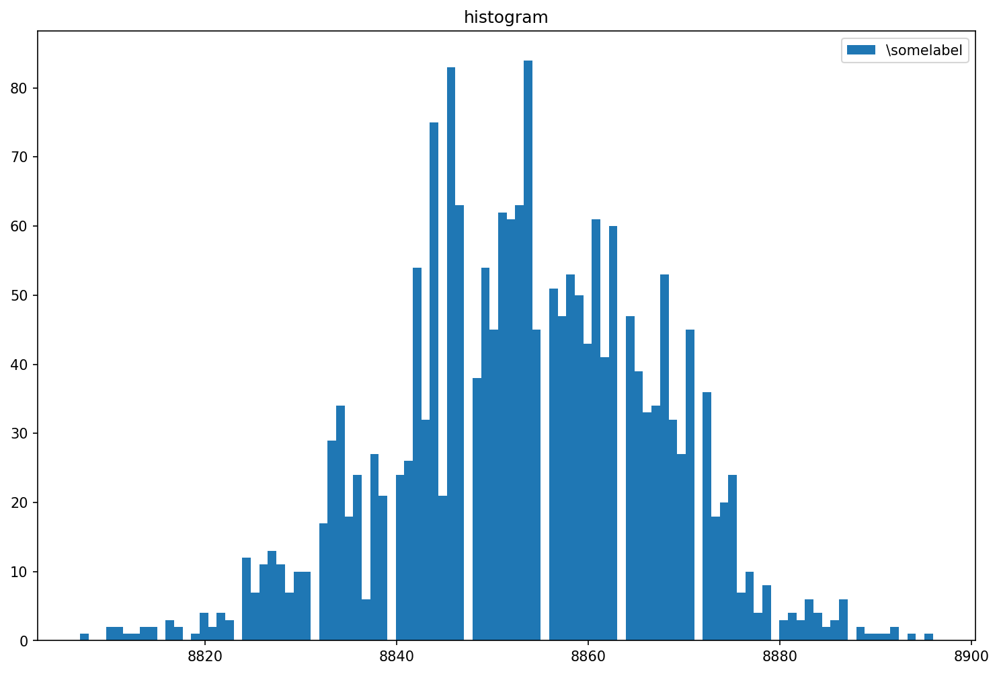

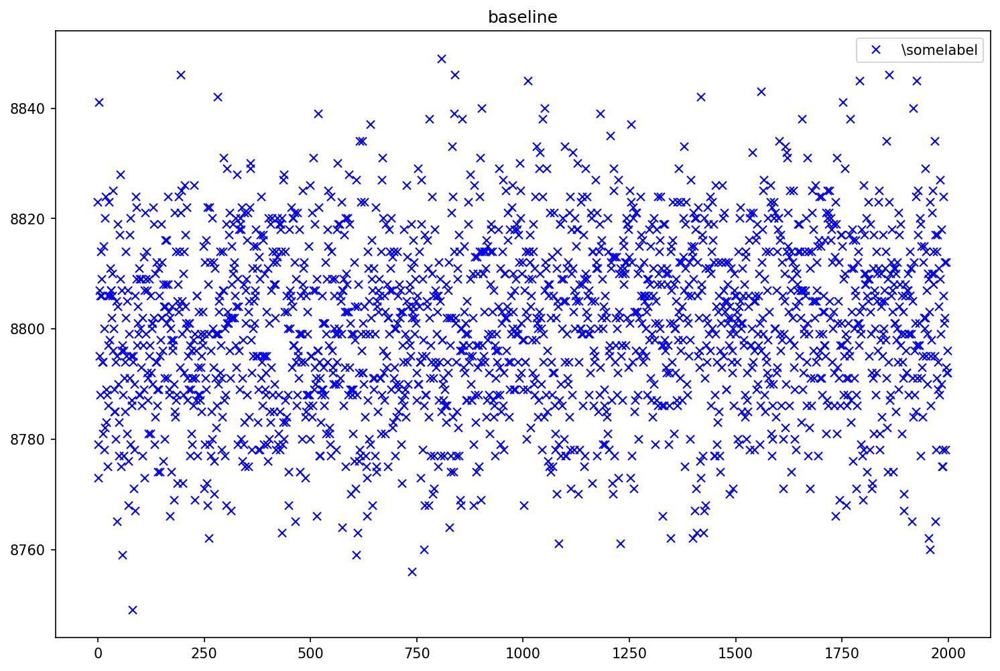

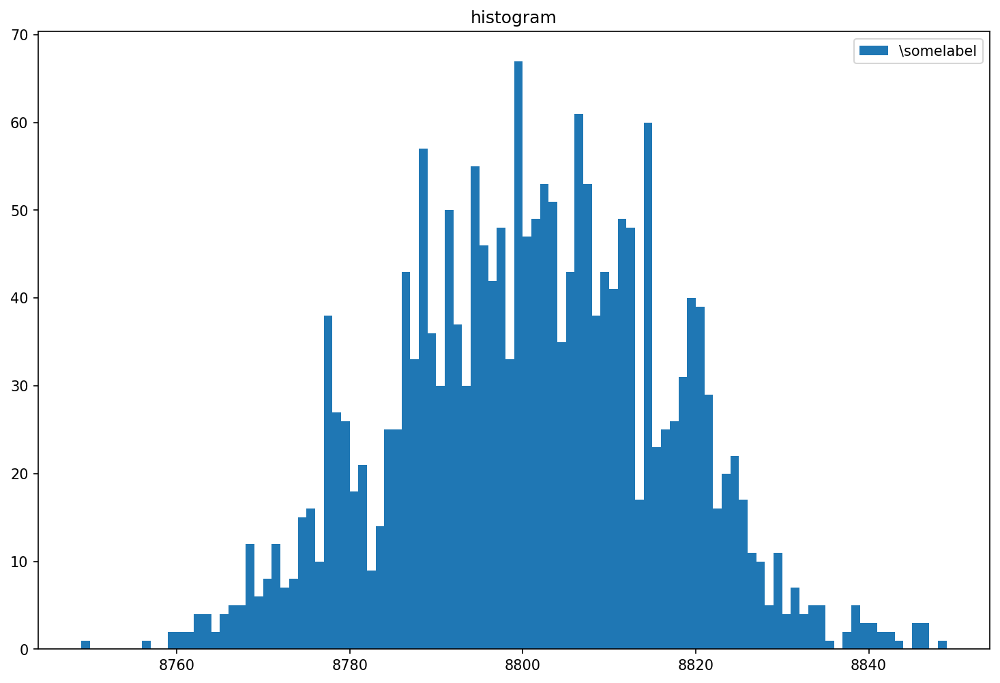

(145, 384)


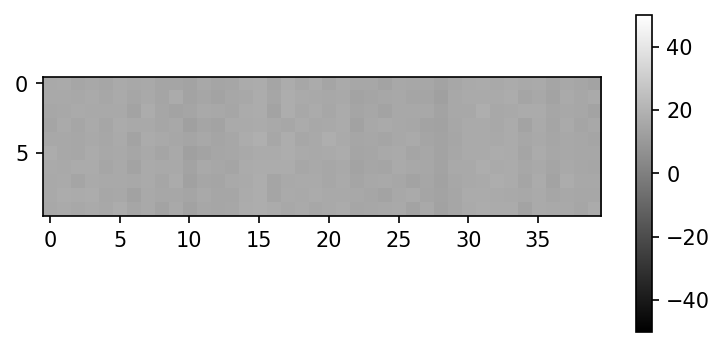

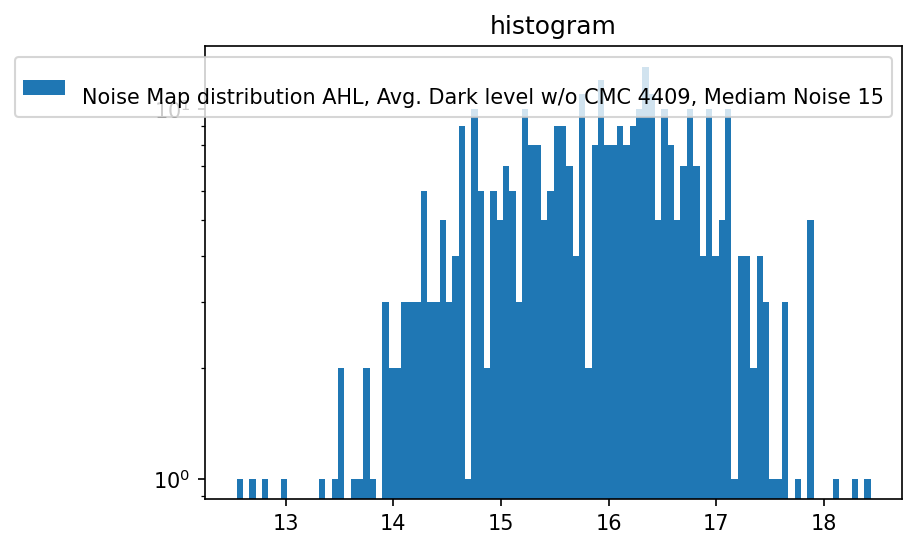


(145, 384)


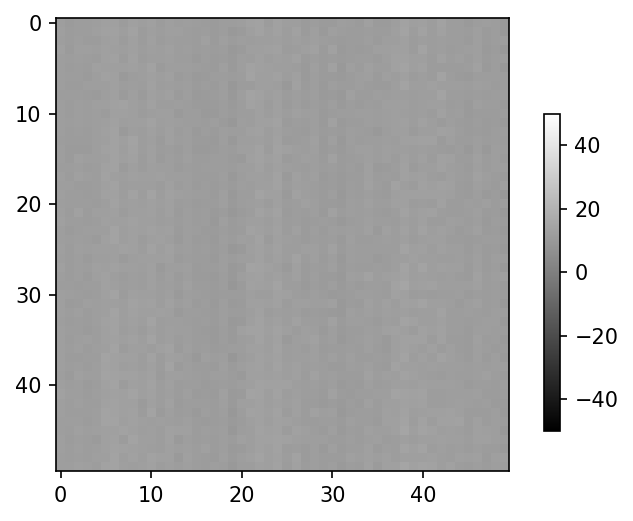

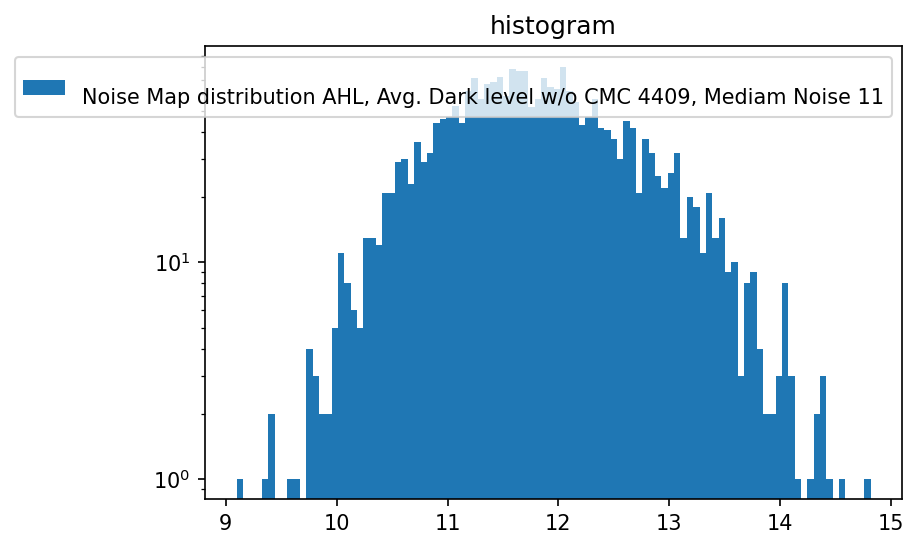


/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_5_Preamp_7_Vld1b_0_PixelCB_7_Filter_DAC_17_VRrefdac_58_DHg_1_RefGenB_2_RefGenC_3_peds_0_trbit_1_run1.dat
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 2
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 3
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 4
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 5
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 6
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get d

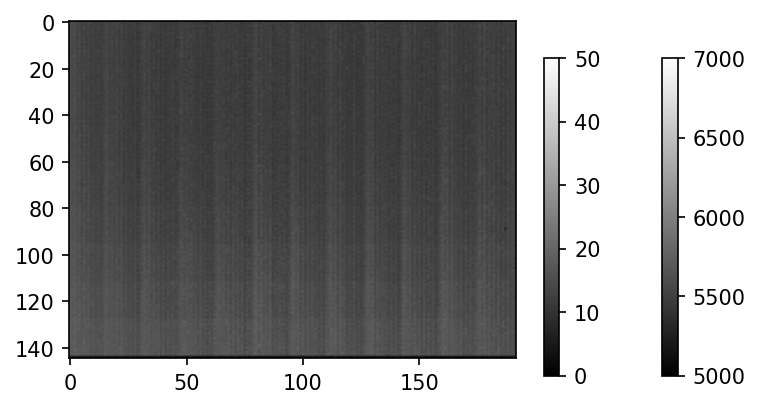

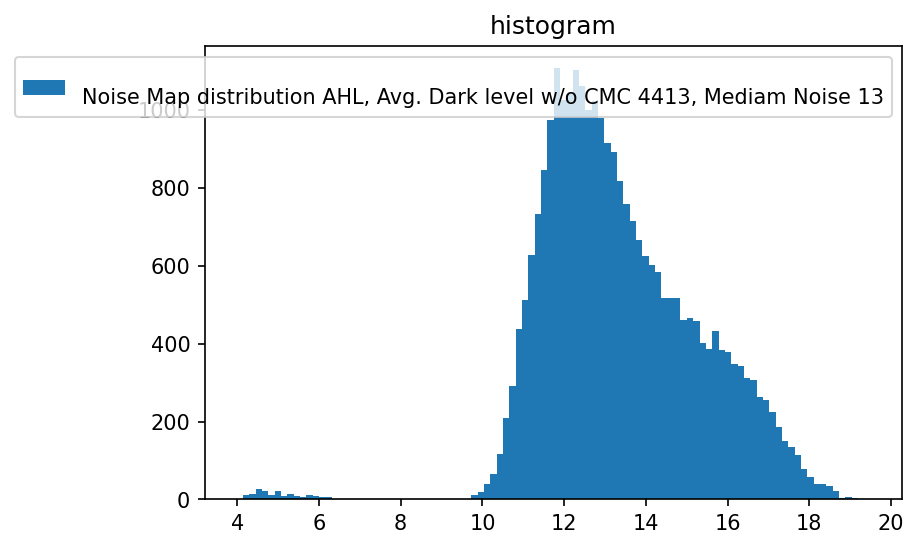

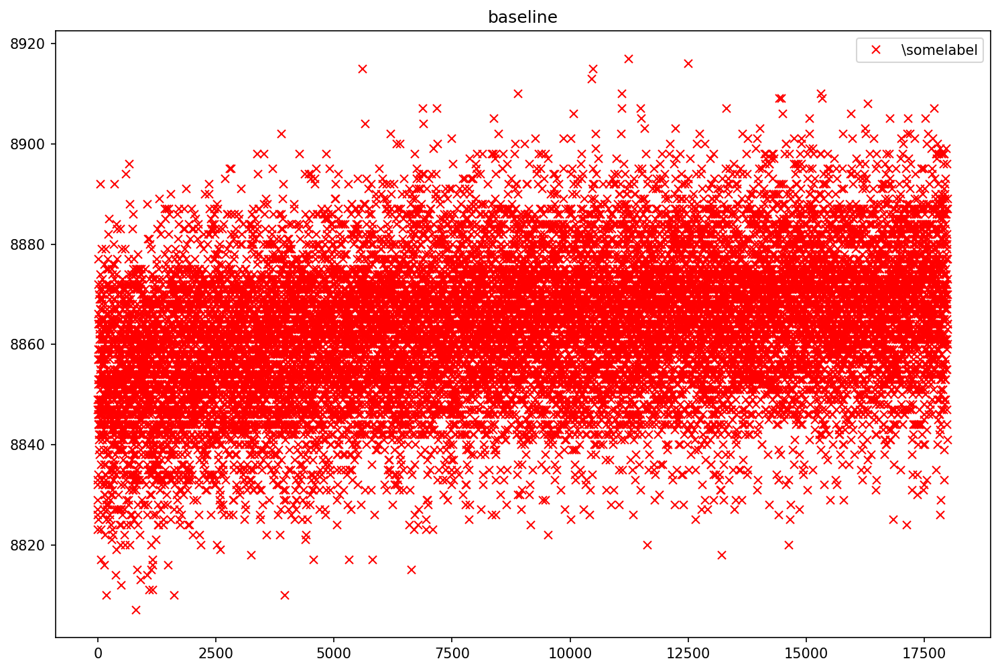

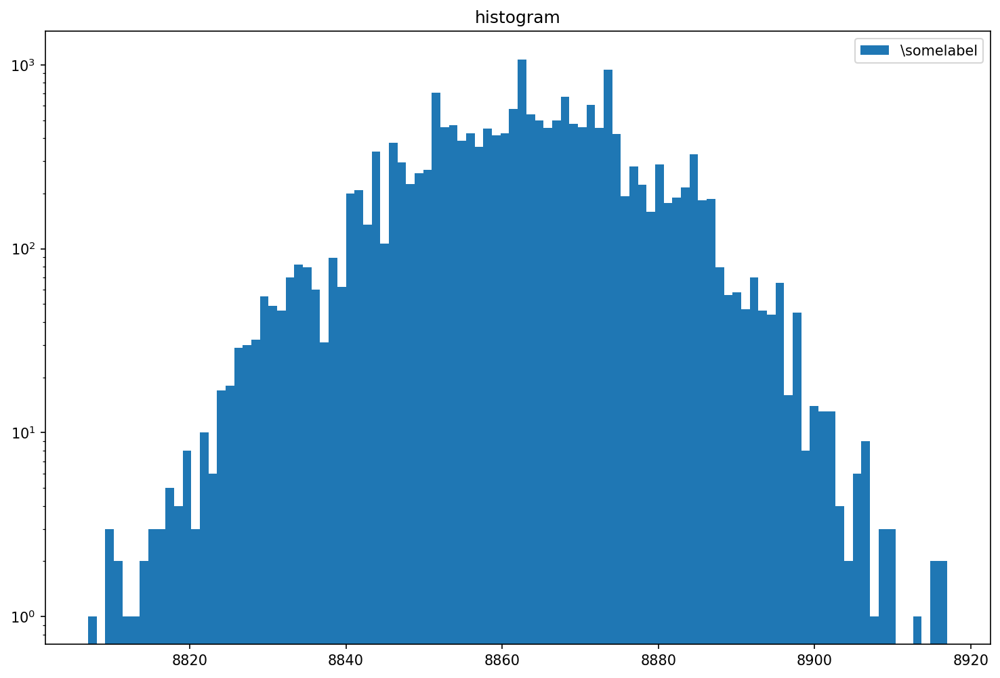

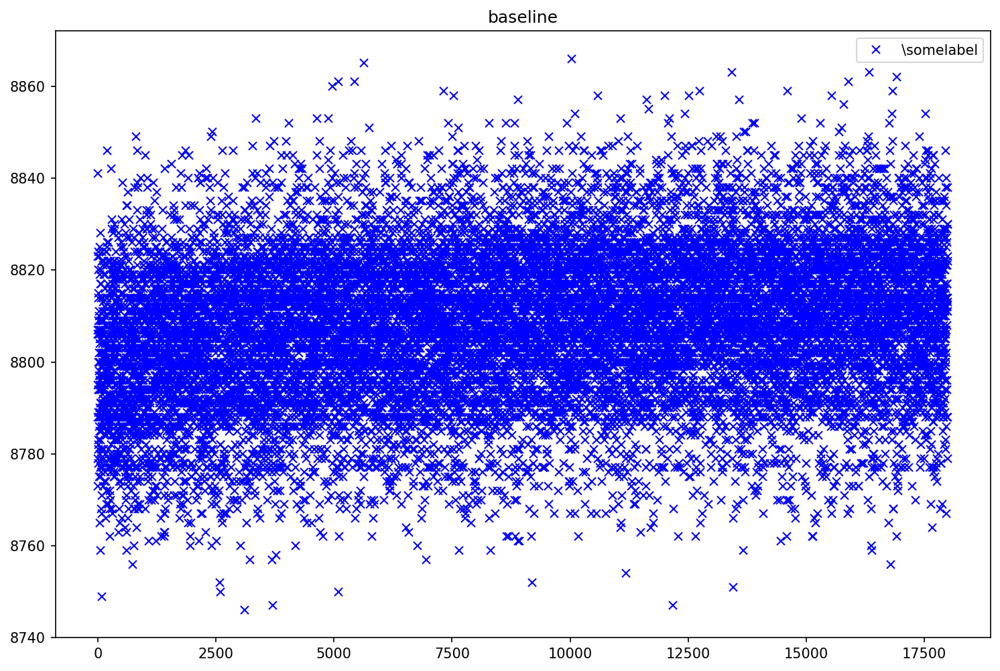

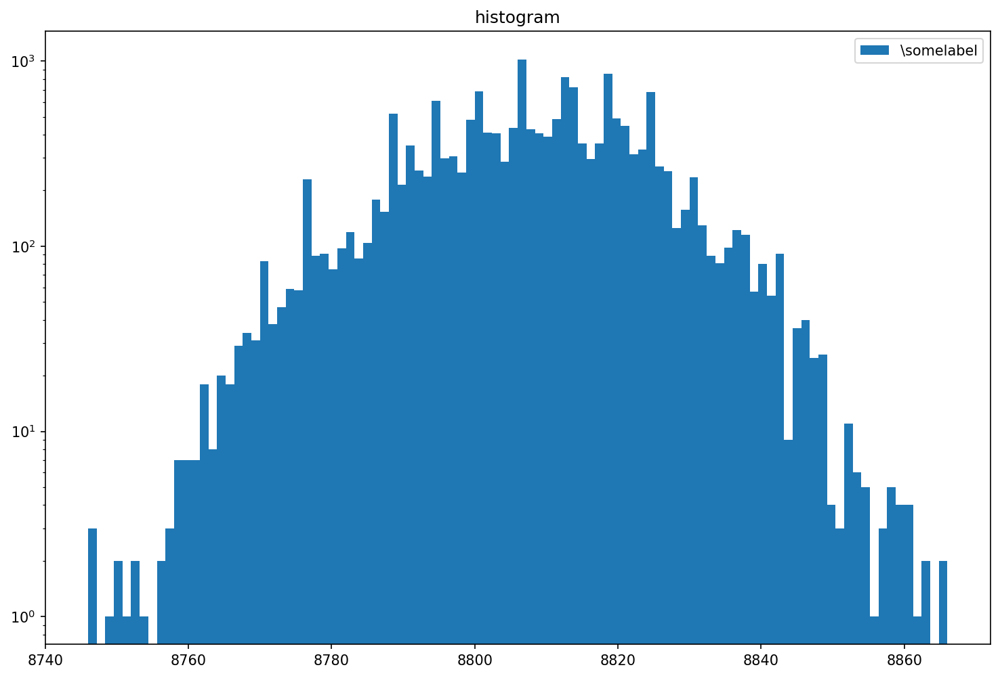

(145, 384)


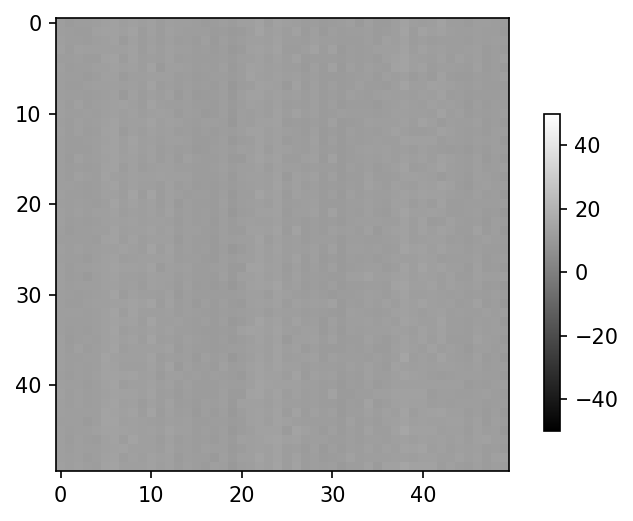

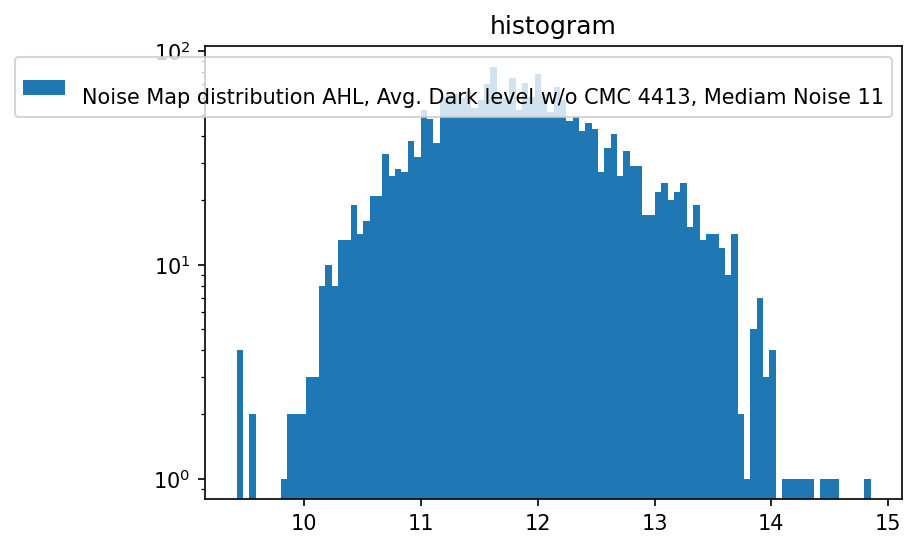


Camera  ePixHr10kTBatcher  selected.
Command executed :  <class 'pyrogue._Command.BaseCommand'> - ePixHr10kT.EpixHR.Hr10kTAsic2.ClearMatrix
The file does not exist
/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_5_Preamp_7_Vld1b_0_PixelCB_7_Filter_DAC_17_VRrefdac_58_DHg_1_RefGenB_2_RefGenC_3_peds_0_trbit_0_run1.dat
Aquisition Counter 4895364
DAQ Counter 4424984
Number of frames received: 50048
Number of frames received: 52050
Delta Aquisition Counter: 54053
Number of frames received: 54053
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 2
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
(1000, 56072)
(145, 384)


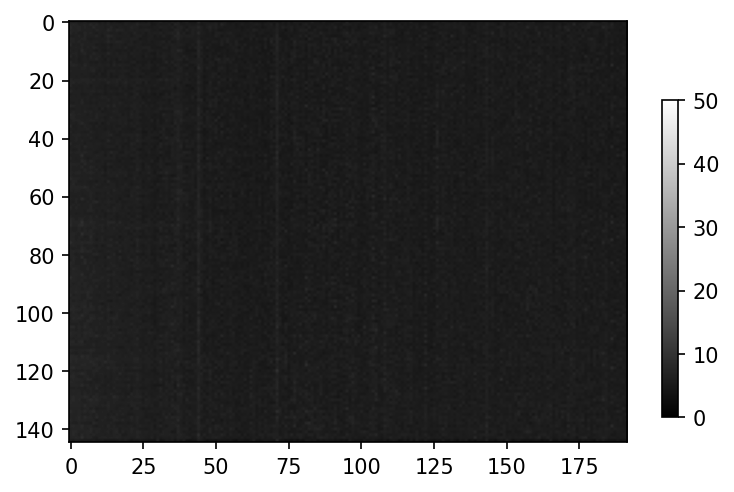

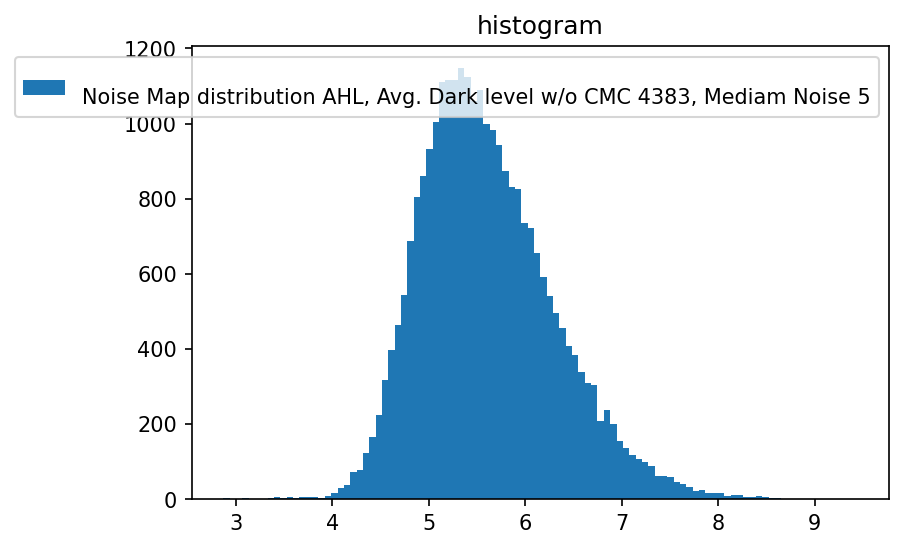

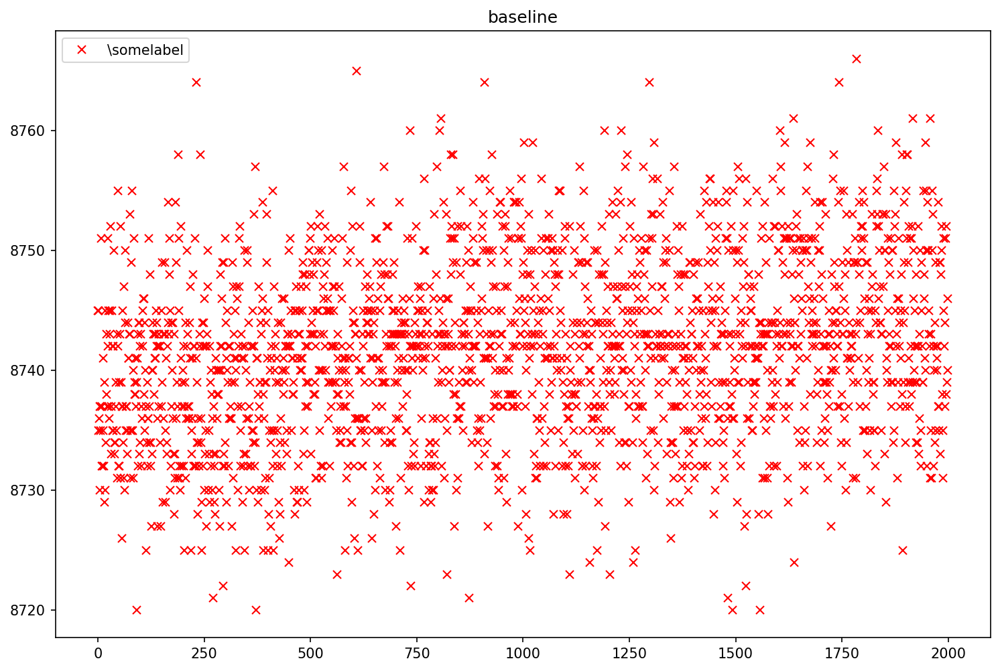

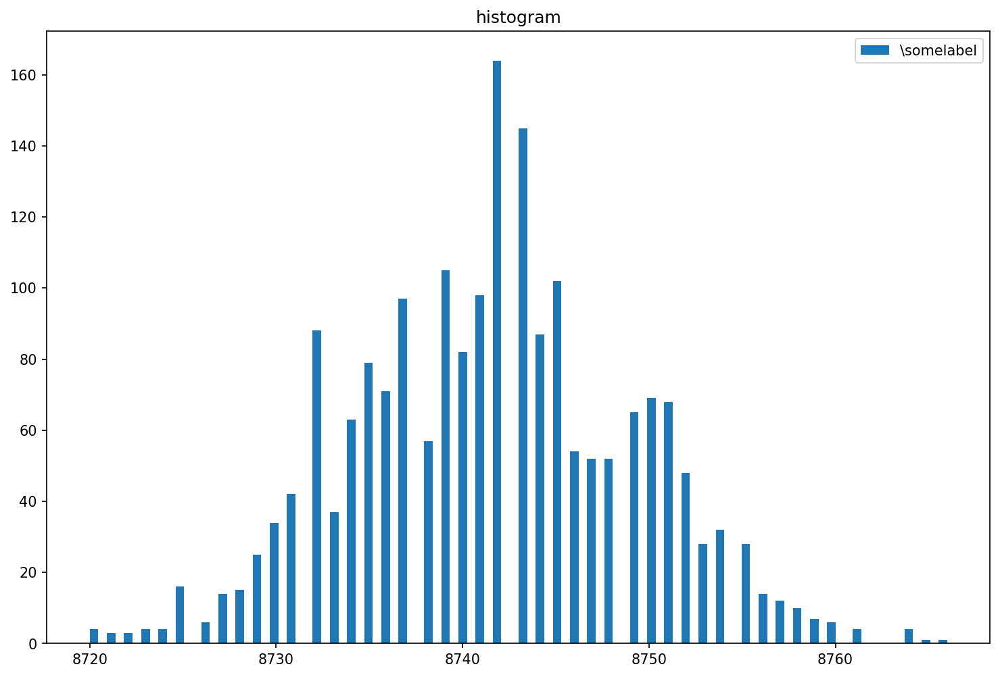

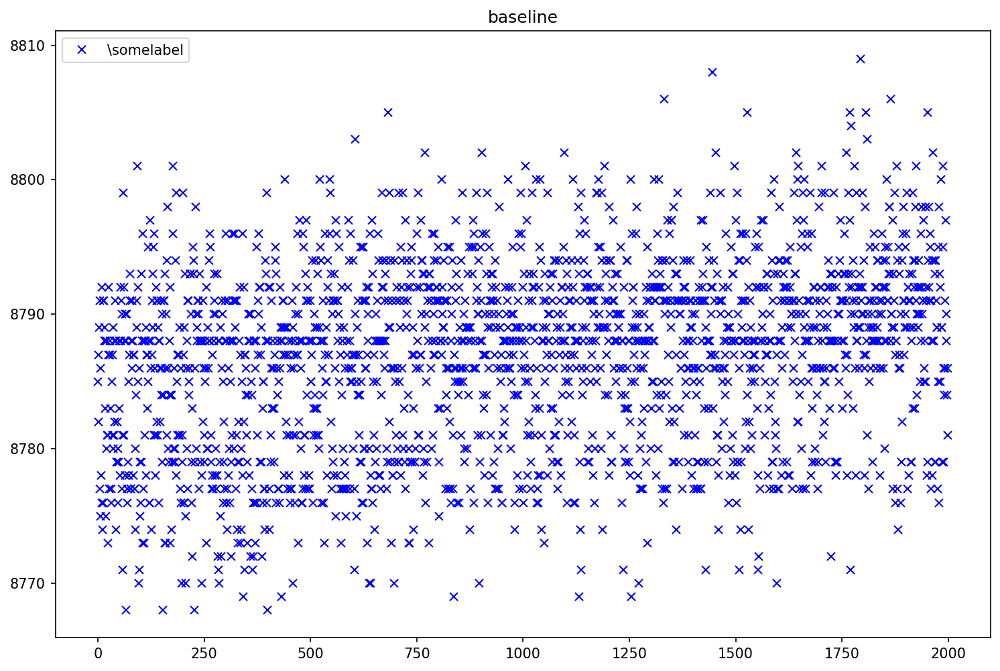

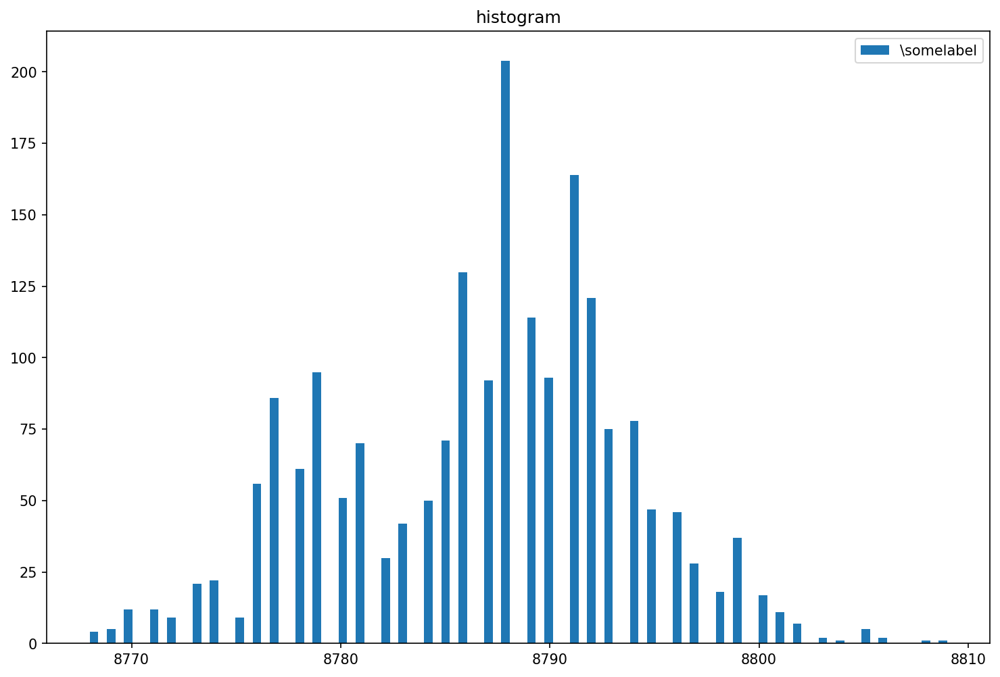

(145, 384)


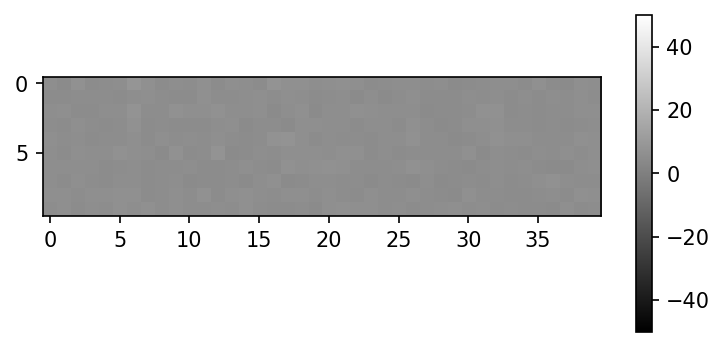

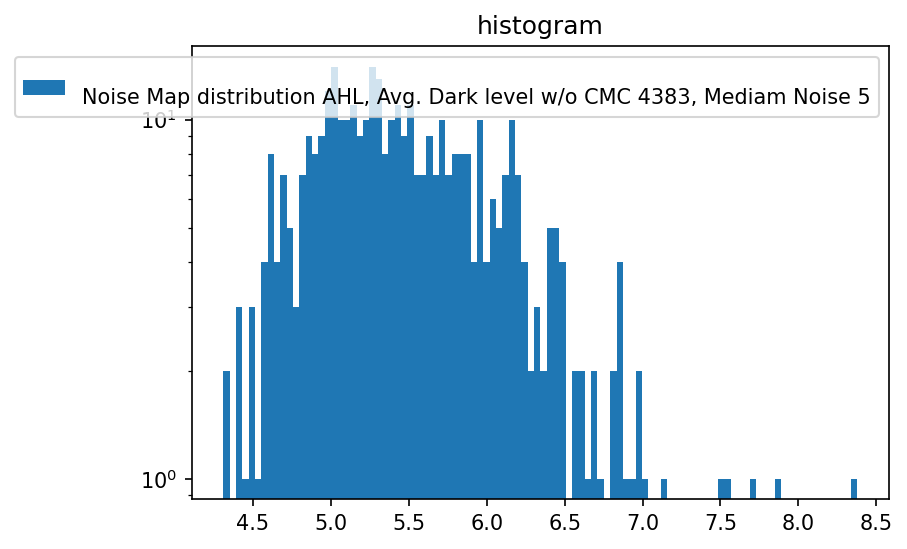


(145, 384)


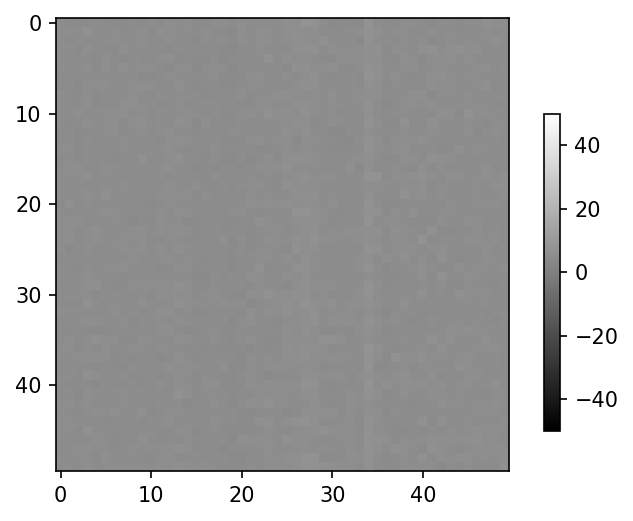

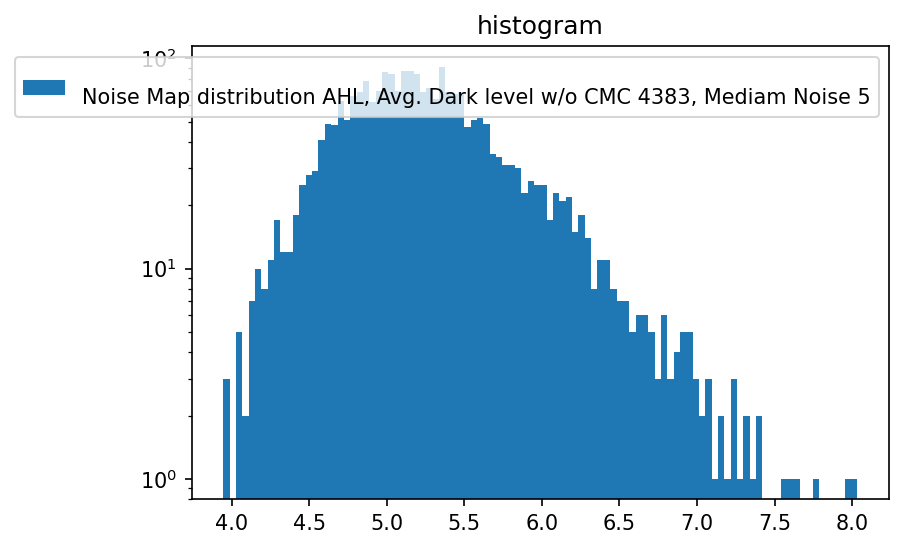


/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_5_Preamp_7_Vld1b_0_PixelCB_7_Filter_DAC_17_VRrefdac_58_DHg_1_RefGenB_2_RefGenC_3_peds_0_trbit_0_run1.dat
Starting to get data set 0
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 1
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 2
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 3
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 4
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 5
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get data set 6
Read 1000 frames
numberOfFrames in the 3D array:  1000
Starting descrambling images
Starting to get d

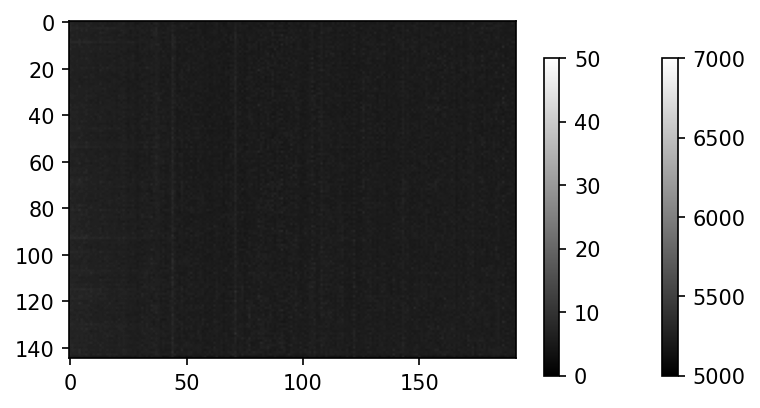

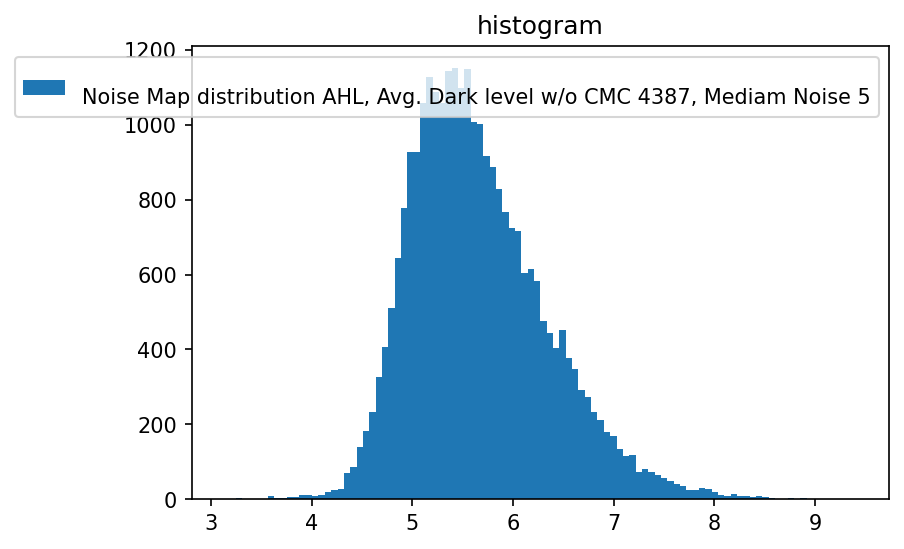

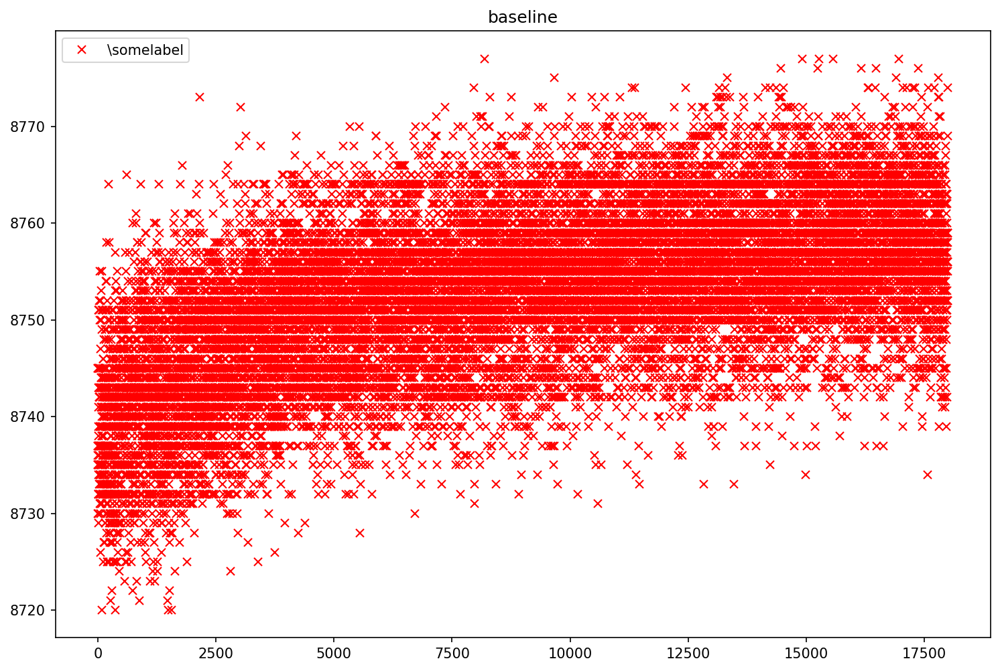

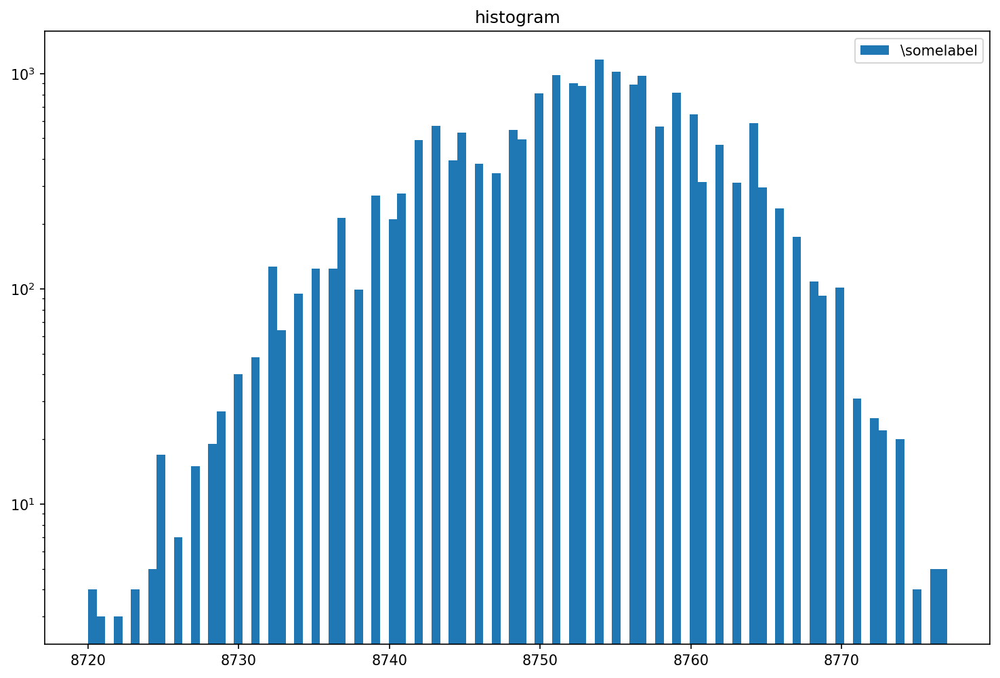

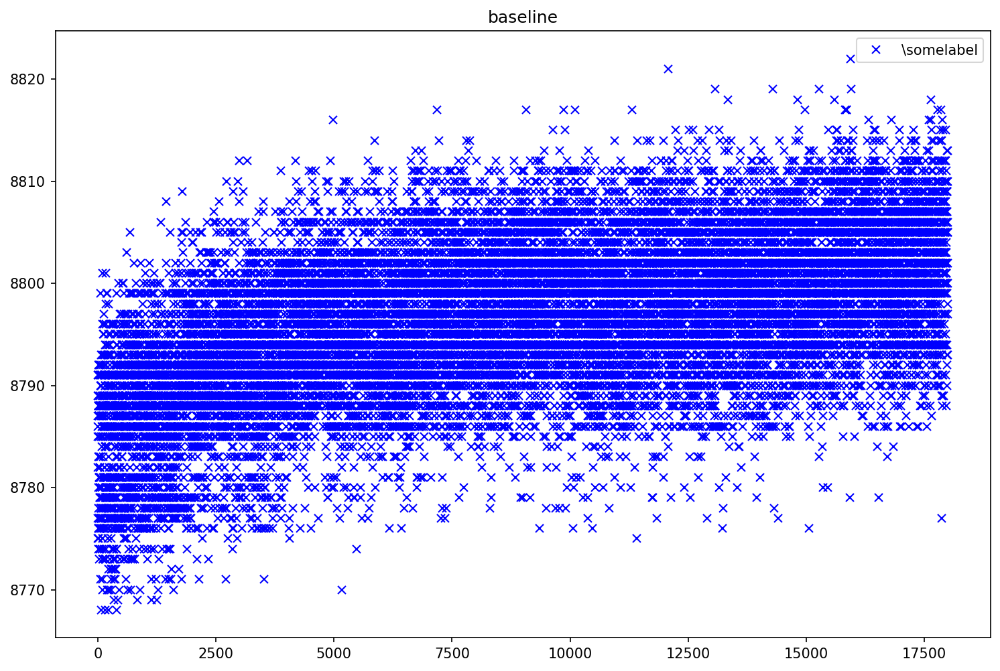

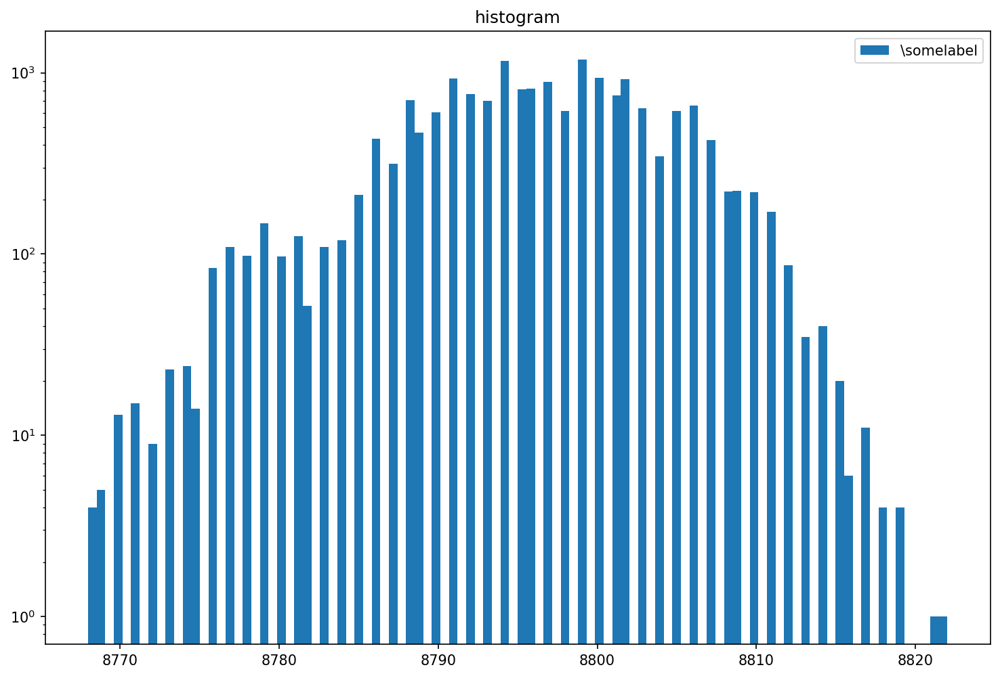

(145, 384)


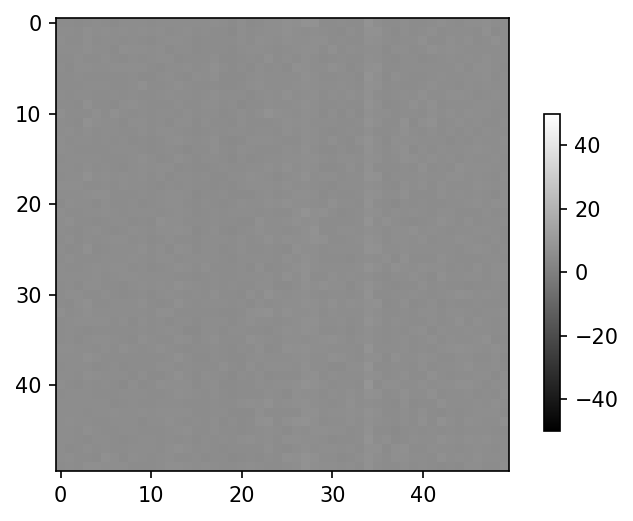

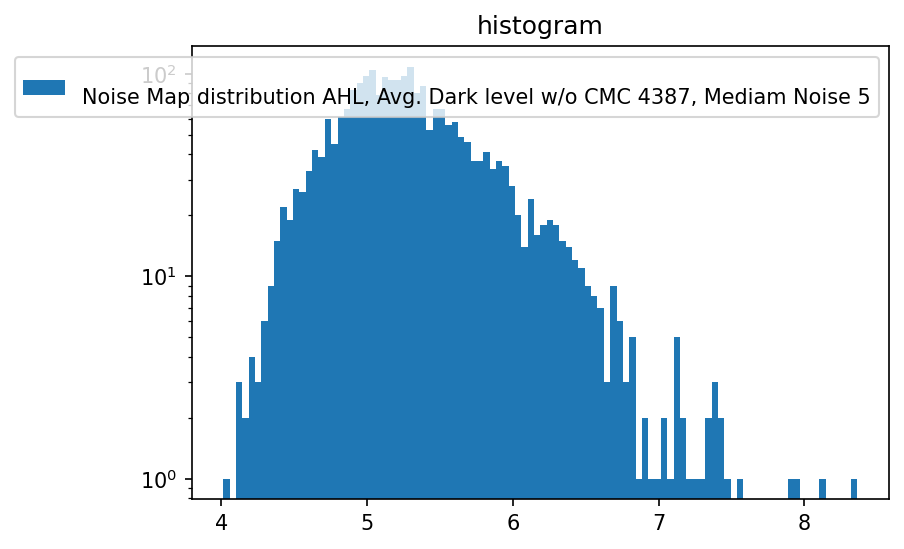


Camera  ePixHr10kTBatcher  selected.


In [23]:
#Makes sure triggers are off
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.2)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(True)
time.sleep(0.2)
root.EpixHR.TriggerRegisters.RunTriggerEnable.set(False)
time.sleep(0.2)

Preamp =  7 #4
Vld1_b =  0 #1
Pixel_CB=  7 #4
Filter_DAC=  17 #33
VRef_DAC =  58 #22

setPixel (Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC)

pedsList = [12,12,8,0,0]
trbitList = [True,0,0,True,0]

#########
index = 0
trbit = trbitList[index]
ASIC.trbit.set(trbit)
peds = pedsList[index]
ASIC.ClearMatrix(peds)
######################################################################################################################
# Remove previous dataset
filename = (f'/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_%d_Preamp_%d_Vld1b_%d_PixelCB_%d_Filter_DAC_%d_VRrefdac_%d_DHg_%d_RefGenB_%d_RefGenC_%d_peds_%d_trbit_%d_run1.dat' % (initSequence, Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC,DHg,RefGenB,RefGenC,peds,trbit))
######################################################################################################################
FH = complete_test(filename)
MAX_NUMBER_OF_FRAMES_PER_BATCH  = 1000
cameraType            = 'ePixHr10kTBatcher'
bitMask               = 0xffff
currentCam = cameras.Camera(cameraType = cameraType)
currentCam.bitMask = bitMask
#########

#########
index = 1
trbit = trbitList[index]
ASIC.trbit.set(trbit)
peds = pedsList[index]
ASIC.ClearMatrix(peds)
######################################################################################################################
# Remove previous dataset
filename = (f'/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_%d_Preamp_%d_Vld1b_%d_PixelCB_%d_Filter_DAC_%d_VRrefdac_%d_DHg_%d_RefGenB_%d_RefGenC_%d_peds_%d_trbit_%d_run1.dat' % (initSequence, Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC,DHg,RefGenB,RefGenC,peds,trbit))
######################################################################################################################
FM = complete_test(filename)
MAX_NUMBER_OF_FRAMES_PER_BATCH  = 1000
cameraType            = 'ePixHr10kTBatcher'
bitMask               = 0xffff
currentCam = cameras.Camera(cameraType = cameraType)
currentCam.bitMask = bitMask
#########

#########
index = 2
trbit = trbitList[index]
ASIC.trbit.set(trbit)
peds = pedsList[index]
ASIC.ClearMatrix(peds)
######################################################################################################################
# Remove previous dataset
filename = (f'/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_%d_Preamp_%d_Vld1b_%d_PixelCB_%d_Filter_DAC_%d_VRrefdac_%d_DHg_%d_RefGenB_%d_RefGenC_%d_peds_%d_trbit_%d_run1.dat' % (initSequence, Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC,DHg,RefGenB,RefGenC,peds,trbit))
######################################################################################################################
FL = complete_test(filename)
MAX_NUMBER_OF_FRAMES_PER_BATCH  = 1000
cameraType            = 'ePixHr10kTBatcher'
bitMask               = 0xffff
currentCam = cameras.Camera(cameraType = cameraType)
currentCam.bitMask = bitMask
#########

#########
index = 3
trbit = trbitList[index]
ASIC.trbit.set(trbit)
peds = pedsList[index]
ASIC.ClearMatrix(peds)
######################################################################################################################
# Remove previous dataset
filename = (f'/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_%d_Preamp_%d_Vld1b_%d_PixelCB_%d_Filter_DAC_%d_VRrefdac_%d_DHg_%d_RefGenB_%d_RefGenC_%d_peds_%d_trbit_%d_run1.dat' % (initSequence, Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC,DHg,RefGenB,RefGenC,peds,trbit))
######################################################################################################################
AHL = complete_test(filename)
MAX_NUMBER_OF_FRAMES_PER_BATCH  = 1000
cameraType            = 'ePixHr10kTBatcher'
bitMask               = 0xffff
currentCam = cameras.Camera(cameraType = cameraType)
currentCam.bitMask = bitMask
#########

#########
index = 4
trbit = trbitList[index]
ASIC.trbit.set(trbit)
peds = pedsList[index]
ASIC.ClearMatrix(peds)
######################################################################################################################
# Remove previous dataset
filename = (f'/u2/ddoering/ASIC_V4_ASIC2_SB/ePixHR10kTLCLSIITiming_ASICV4_ASIC2_clearMatrix_2_320MHz_initSequence_%d_Preamp_%d_Vld1b_%d_PixelCB_%d_Filter_DAC_%d_VRrefdac_%d_DHg_%d_RefGenB_%d_RefGenC_%d_peds_%d_trbit_%d_run1.dat' % (initSequence, Preamp, Vld1_b, Pixel_CB, Filter_DAC, VRef_DAC,DHg,RefGenB,RefGenC,peds,trbit))
######################################################################################################################
AML = complete_test(filename)
MAX_NUMBER_OF_FRAMES_PER_BATCH  = 1000
cameraType            = 'ePixHr10kTBatcher'
bitMask               = 0xffff
currentCam = cameras.Camera(cameraType = cameraType)
currentCam.bitMask = bitMask
#########







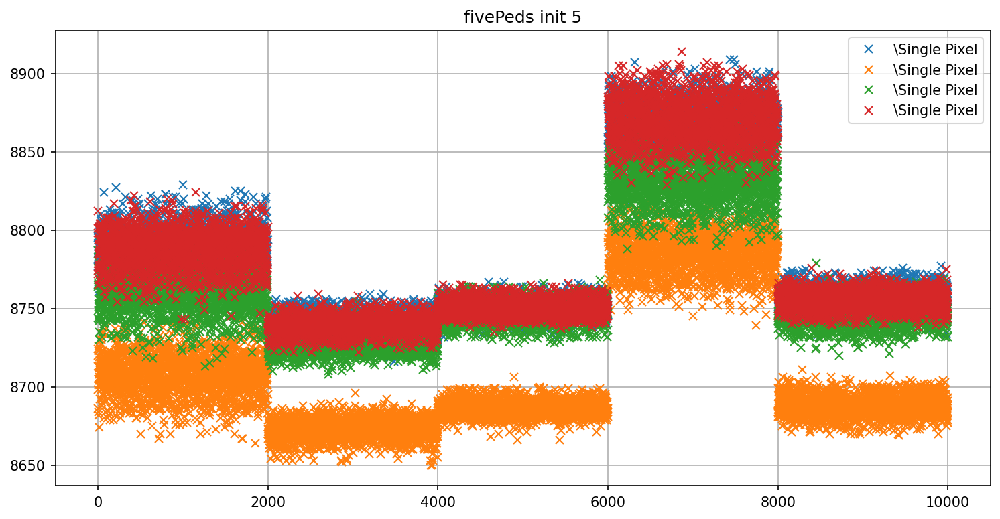

In [24]:
startIdx = 13000
stopIdx = 15000
mask = 0x3FFF
plt.figure(1,figsize=(12,6),dpi=150)
dataset = np.concatenate((FH[startIdx:stopIdx,10,10],FM[startIdx:stopIdx,10,10],np.bitwise_and(FL[startIdx:stopIdx,10,10], mask),AHL[startIdx:stopIdx,10,10],AML[startIdx:stopIdx,10,10]),0)           
plt.plot(dataset, 'x', label=f'\Single Pixel') 
dataset = np.concatenate((FH[startIdx:stopIdx,10+32,10+32],FM[startIdx:stopIdx,10+32,10+32],np.bitwise_and(FL[startIdx:stopIdx,10+32,10+32], mask),AHL[startIdx:stopIdx,10+32,10+32],AML[startIdx:stopIdx,10+32,10+32]),0) #
plt.plot(dataset, 'x', label=f'\Single Pixel') 
dataset = np.concatenate((FH[startIdx:stopIdx,10+32,10],FM[startIdx:stopIdx,10+32,10],np.bitwise_and(FL[startIdx:stopIdx,10+32,10], mask),AHL[startIdx:stopIdx,10+32,10],AML[startIdx:stopIdx,10+32,10]),0) #
plt.plot(dataset, 'x', label=f'\Single Pixel') 
dataset = np.concatenate((FH[startIdx:stopIdx,10,10+32],FM[startIdx:stopIdx,10,10+32],np.bitwise_and(FL[startIdx:stopIdx,10,10+32], mask),AHL[startIdx:stopIdx,10,10+32],AML[startIdx:stopIdx,10,10+32]),0) #
plt.plot(dataset, 'x', label=f'\Single Pixel') 

plt.title("fivePeds init %d" % (initSequence)) 
plt.grid()
plt.legend()
plt.show()